# Final project: Time-series data and application to stock markets {-}

This project aims at familiarizing you with time-series data analysis and its application to stock markets. Datasets you will be working on are Nasdaq and Vietnam stock datasets.

### Submission {-}
The structure of submission folder should be organized as follows:

- ./\<StudentID>-project-notebook.ipynb: Jupyter notebook containing source code.
- ./\<StudentID>-project-report.pdf: project report.

The submission folder is named DL4AI-\<StudentID>-project (e.g., DL4AI-2012345-project) and then compressed with the same name.
    
### Evaluation {-}
Project evaluation will be conducted on how you accomplish the assignment requirements. You can refer to the project instruction slide deck for details.

### Deadline {-}
Please visit Canvas for details.

In [1]:
# Load libraries
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import logging
from typing import Dict, List

from sklearn.linear_model import LinearRegression

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler

import tensorflow as tf
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, LSTM, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

In [2]:
def min_max_normalize(X, y, feature_choice_index, feature_len):
    X_norm = X.copy()
    y_norm = y.copy()
    
    for i in range(len(X_norm)):
        for feature_index in range(feature_len):
            min_feature = np.min(X[i][:, feature_index])  # Minimum for the specific feature
            max_feature = np.max(X[i][:, feature_index])  # Maximum for the specific feature
            
            # Check if max_feature is equal to min_feature to avoid division by zero
            if max_feature != min_feature:
                X_norm[i][:, feature_index] = (X[i][:, feature_index] - min_feature) / (max_feature - min_feature)
            else:
                # If all values are the same, set normalized values to 0 or any other constant
                X_norm[i][:, feature_index] = 0.0  # or np.zeros(X[i][:, feature_index].shape)

    for i in range(len(y_norm)):
        min_feature = np.min(X[i][:, feature_choice_index])  # Minimum for the specific feature
        max_feature = np.max(X[i][:, feature_choice_index])  # Maximum for the specific feature
        
        # Check if max_feature is equal to min_feature to avoid division by zero
        if max_feature != min_feature:
            y_norm[i] = (y[i] - min_feature) / (max_feature - min_feature)
        else:
            # If all values are the same, set normalized value to 0 or any other constant
            y_norm[i] = 0.0  # or 0.0 if you want to keep it consistent

    X_norm_t = tf.convert_to_tensor(X_norm, dtype=tf.float64)
    y_norm_t = tf.convert_to_tensor(y_norm, dtype=tf.float64)
    
    return X_norm, y_norm, X_norm_t, y_norm_t

In [3]:
def data_preparation(data_path, features, k_days = 1, feature_choice = 'Close',window_size = 30, test_size = 0.20, type = 0):
    # load data
    data = pd.read_csv(data_path)
    # Show some first data samples
    data.head()
    data.info()
    df = data
    # Split the dataset into time windows to get data samples.
    # Define the features to be used for prediction
    # get feature_choice index in features
    feature_choice_index = features.index(feature_choice)
    if feature_choice_index == -1:
        raise ValueError("Feature not found in features list")
    # Pre-allocate arrays for X_data and y_data
    match (type):
        case (0):
            num_samples = len(df) - window_size
        case (1): 
            num_samples = len(df) - window_size - k_days
        case (2):
            num_samples = len(df) - window_size - k_days + 1
    X_data = np.empty((num_samples, window_size, len(features)))
    if type == 2:
        y_data = np.empty((num_samples, k_days))
    else:
        y_data = np.empty((num_samples, 1))

    # Use NumPy array slicing for efficient data extraction
    for i in range(num_samples):
        # Use slicing to get the features for the window
        X_data[i] = df.iloc[i:i + window_size][features].values
        # Get the label for the next day's 'Close' price
        match (type):
            case (0):
                y_data[i] = df.iloc[i + window_size][feature_choice]
            case (1):
                y_data[i] = df.iloc[i + window_size + k_days - 1][feature_choice]
            case (2):
                y_data[i] = df.iloc[i + window_size:i + window_size + k_days][feature_choice]
        
    X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, test_size=test_size, shuffle=False)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=test_size, shuffle=False)

    # Convert from lists to Numpy arrays for reshaping purpose
    X_train = np.array(X_train)
    X_val = np.array(X_val)
    X_test = np.array(X_test)
    y_train = np.array(y_train)
    y_val = np.array(y_val)
    y_test = np.array(y_test)

    # Reshape the numpy array to fit the neural network input shape requirement
    X_train = X_train.reshape(X_train.shape[0], window_size, len(features))
    X_val = X_val.reshape(X_val.shape[0], window_size, len(features))
    X_test = X_test.reshape(X_test.shape[0], window_size, len(features))

    # Print shape of the training, validation and test set
    print("Shape of training set: ", X_train.shape)
    print("Shape of validation set: ", X_val.shape)
    print("Shape of test set: ", X_test.shape)
    
    X_train_norm, y_train_norm, X_train_norm_t, y_train_norm_t = min_max_normalize(X_train, y_train, feature_choice_index,len(features))
    X_val_norm, y_val_norm, X_val_norm_t, y_val_norm_t = min_max_normalize(X_val, y_val, feature_choice_index,len(features))
    X_test_norm, y_test_norm, X_test_norm_t, y_test_norm_t = min_max_normalize(X_test, y_test, feature_choice_index,len(features))
    
    return data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index

In [4]:
def data_visualization(df, X_train, X_val, X_test, features):
    # Visualize the training, validation and test set
    # df_plot = data_appl_test
    # df_plot = df_plot.reset_index(drop=False)
    # Get lengths of the three subsets
    size_train = X_train.shape[0]
    size_val = X_val.shape[0]
    size_test = X_test.shape[0]

    # Create a new DataFrame for plotting
    df_plot = df[features].copy()
    df_plot.reset_index(inplace=True)

    # Create subplots for each feature
    num_features = len(features)

    fig, axes = plt.subplots(num_features , 1, figsize=(8, 2 * num_features), sharex=True)

    # Plot each feature in its own subplot
    for i, feature in enumerate(features[:num_features]):
        # Plot Training Set
        axes[i].plot(df_plot.index[:size_train], df_plot.iloc[:size_train, df_plot.columns.get_loc(feature)], color='red', label='Training Set')
        
        # Plot Validation Set
        axes[i].plot(df_plot.index[size_train:size_train + size_val], df_plot.iloc[size_train:size_train + size_val, df_plot.columns.get_loc(feature)], color='blue', label='Validation Set')
        
        # Plot Test Set
        axes[i].plot(df_plot.index[size_train + size_val:], df_plot.iloc[size_train + size_val:, df_plot.columns.get_loc(feature)], color='green', label='Test Set')
        
        # Set titles and labels for each subplot
        axes[i].set_title(f"{feature} Trend of AAPL", fontsize=16)
        axes[i].set_ylabel(f'{feature} in $', fontsize=14)
        axes[i].legend(loc='upper left')
        axes[i].grid()
        
        # Set x-ticks to show row numbers
        axes[i].set_xticks(range(0, size_train + size_val + size_test, max(1, (size_train + size_val + size_test) // 10)))  # Adjust the step for x-ticks as needed
        axes[i].set_xticklabels(range(0, size_train + size_val + size_test, max(1, (size_train + size_val + size_test) // 10)))

    # Set common x-label (optional)
    plt.xlabel('Time (days)', fontsize=14)

    # Draw vertical lines to indicate the splits
    for ax in axes:
        ax.axvline(x=size_train, color='black', linestyle='--', label='Validation Start')
        ax.axvline(x=size_train + size_val, color='black', linestyle='--', label='Test Start')

    plt.tight_layout()
    plt.show()

In [5]:
def cnn_model(X_train_norm_t, 
                y_train_norm_t, 
                X_val_norm_t, 
                y_val_norm_t, 
                window_size, 
                n_dense=1,
                monitor="val_loss",
                learning_rate=0.01,
                epochs=50, 
                batch_size=512,
                min_lr=0.005,
                lr_patience=2,
                es_patience=5,
                feature_len = 6,
                checkpoint_header = '1dcnn'):
    lower_lr = ReduceLROnPlateau(monitor=monitor, factor=0.8, patience=lr_patience, verbose=1,min_lr=min_lr) # add reduce learning rate value to (maybe) solve the problems above
    earlystopping = EarlyStopping(monitor=monitor, patience=es_patience, verbose=1)
    # checkpoint to check the best model snapshot
    checkpoint = ModelCheckpoint(filepath = f'{checkpoint_header}.keras',
                                verbose=1,
                                save_best_only=True,mode='min')
    ### Create and train the model

    # Build the model architecture
    conv1d = tf.keras.Sequential()
    conv1d.add(Conv1D(64, kernel_size=3, activation='relu', input_shape=(window_size, feature_len), padding='same'))
    conv1d.add(MaxPooling1D(pool_size=2))
    conv1d.add(Conv1D(128, kernel_size=3, activation='relu', padding='same'))
    conv1d.add(MaxPooling1D(2))
    conv1d.add(Conv1D(64, kernel_size=3, activation='relu', padding='same'))
    conv1d.add(MaxPooling1D(2))
    conv1d.add(Flatten())
    conv1d.add(Dense(100, activation='relu'))
    conv1d.add(Dense(n_dense)) # By default: activation='linear', i.e., passing through f(x) = x

    # Compile and train the conv1d with Mean Squared Error loss function
    conv1d.summary()
    conv1d.compile(optimizer= tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='mse', metrics=['mse'])
    history = conv1d.fit(X_train_norm_t, y_train_norm_t, validation_data=(X_val_norm_t,y_val_norm_t), epochs=epochs, batch_size=batch_size, callbacks=[lower_lr, earlystopping,checkpoint])
    return conv1d, history
    # Calculate the number of parameters of each layer
    # Conv1D_1: (3*1 + 1 bias each filter)*64 = 256 params.
    # Conv1D_2: (3*64 + 1 bias each filter)*128 = 24,704 params.
    # Conv1D_3: (3*128 + 1 bias each filter)*64 = 24,640 params.
    # Dense_1: (192+1)*100 = 19,300 params.
    # Dense_2: (100+1)*1 = 101 params.

In [6]:
def cnn_test(conv1d, X_test_norm_t, y_test_norm, X_test, y_test, feature_choice_index):
    # Get prediction on the test data
    conv1d_y_pred_norm = conv1d.predict(X_test_norm_t)
    print("MSE on the test set: ", mean_squared_error(conv1d_y_pred_norm, y_test_norm))
    # Assuming y_test is the true Open prices corresponding to the test set
    # Convert the result back to stock price (i.e., de-normalization) for visualization purpose
    conv1d_y_pred_denorm = conv1d_y_pred_norm  # Create a copy for denormalization

    # Use the min and max values for the 'Open' prices from the dataset for denormalization

    # Denormalization of predicted values
    for i in range(0, len(conv1d_y_pred_denorm)):
        min_close = np.min(X_test[i][:,feature_choice_index]) 
        max_close = np.max(X_test[i][:,feature_choice_index]) 
        conv1d_y_pred_denorm[i] = conv1d_y_pred_norm[i] * (max_close - min_close) + min_close
    # Visualize predicted stock price versus real stock price
    plt.figure(figsize=(16, 8), dpi=300)
    plt.plot(conv1d_y_pred_denorm, label='Predicted price', color='blue')
    plt.plot(y_test, label='Real price', color='orange')  # Use denormalized y_test for comparison
    plt.title('Stock Trend Prediction', fontsize=16)
    plt.xlabel('Time (days)', fontsize=14)
    plt.ylabel('Close Price in $', fontsize=14)
    plt.grid()  # Add grid
    plt.legend()  # Add legend
    plt.show()

In [7]:
def lstm_model(X_train_norm_t, 
                y_train_norm_t, 
                X_val_norm_t, 
                y_val_norm_t, 
                window_size, 
                n_dense=1,
                monitor="val_loss",
                learning_rate=0.01,
                epochs=50, 
                batch_size=512,
                min_lr=0.005,
                lr_patience=2,
                es_patience=5,
                feature_len = 6,
                checkpoint_header = 'lstm'):
    lower_lr = ReduceLROnPlateau(monitor=monitor, factor=0.8, patience=lr_patience, verbose=1,min_lr=min_lr) # add reduce learning rate value to (maybe) solve the problems above
    earlystopping = EarlyStopping(monitor=monitor, patience=es_patience, verbose=1)
    # checkpoint to check the best model snapshot
    checkpoint = ModelCheckpoint(filepath = f'{checkpoint_header}.keras',
                                verbose=1,
                                save_best_only=True,mode='min')
    
    ### Create and train the model

    # Build the model architecture
    lstm = tf.keras.Sequential()
    lstm.add(LSTM(units=32, return_sequences=True, input_shape=(window_size,feature_len)))
    lstm.add(LSTM(units=64))
    lstm.add(Dense(100, activation='relu'))
    lstm.add(Dense(n_dense)) # By default: activation='linear', i.e., passing through f(x) = x

    # Compile and train the lstm with Mean Squared Error loss function
    lstm.summary()
    lstm.compile(optimizer= tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='mse', metrics=['mse'])
    history = lstm.fit(X_train_norm_t, y_train_norm_t, validation_data=(X_val_norm_t,y_val_norm_t), epochs=epochs, batch_size=batch_size, callbacks=[lower_lr, earlystopping,checkpoint])
    
    return lstm, history
    # Calculate the number of parameters of each layer
    # LSTM_1: input_dim = 1, output_dim = 32 --> 4*(1*32+32*32+32) = 4,352 params.
    # LSTM_2: input_dim = 32, output_dim = 64 --> 4*(32*64+64*64+64) = 24,832 params
    # Dense(100) = (64+1)*100 = 6,500 params.
    # Dense(1) = (100+1)*1 = 101 params.


In [8]:
def lstm_test(lstm, X_test_norm_t, y_test_norm, X_test, y_test,feature_choice_index):
    # Get prediction on the test data
    lstm_y_pred_norm = lstm.predict(X_test_norm_t)
    print("MSE on the test set: ", mean_squared_error(lstm_y_pred_norm, y_test_norm))
    # Assuming y_test is the true Open prices corresponding to the test set
    # Convert the result back to stock price (i.e., de-normalization) for visualization purpose
    lstm_y_pred_denorm = lstm_y_pred_norm.copy()  # Create a copy for denormalization


    # Denormalization of predicted values
    for i in range(len(lstm_y_pred_denorm)):
        min_feature = np.min(X_test[i,:,feature_choice_index])
        max_feature = np.max(X_test[i,:,feature_choice_index])
        lstm_y_pred_denorm[i] = lstm_y_pred_norm[i] * (max_feature - min_feature) + min_feature
    # Visualize predicted stock price versus real stock price
    plt.figure(figsize=(16, 8), dpi=300)
    plt.plot(lstm_y_pred_denorm, label='Predicted price', color='blue')
    plt.plot(y_test, label='Real price', color='orange')  # Use denormalized y_test for comparison
    plt.title('Stock Trend Prediction', fontsize=16)
    plt.xlabel('Time (days)', fontsize=14)
    plt.ylabel('Close Price in $', fontsize=14)
    plt.grid()  # Add grid
    plt.legend()  # Add legend
    plt.show()

# Task 1

## Task 1.1

In [9]:
window_size = 30
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']

In [10]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-nasdaq/AAPL.csv',
    features=features,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type=0
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10590 entries, 0 to 10589
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            10590 non-null  object 
 1   Low             10590 non-null  float64
 2   Open            10590 non-null  float64
 3   Volume          10590 non-null  int64  
 4   High            10590 non-null  float64
 5   Close           10590 non-null  float64
 6   Adjusted Close  10590 non-null  float64
dtypes: float64(5), int64(1), object(1)
memory usage: 579.3+ KB


Shape of training set:  (6758, 30, 6)
Shape of validation set:  (1690, 30, 6)
Shape of test set:  (2112, 30, 6)


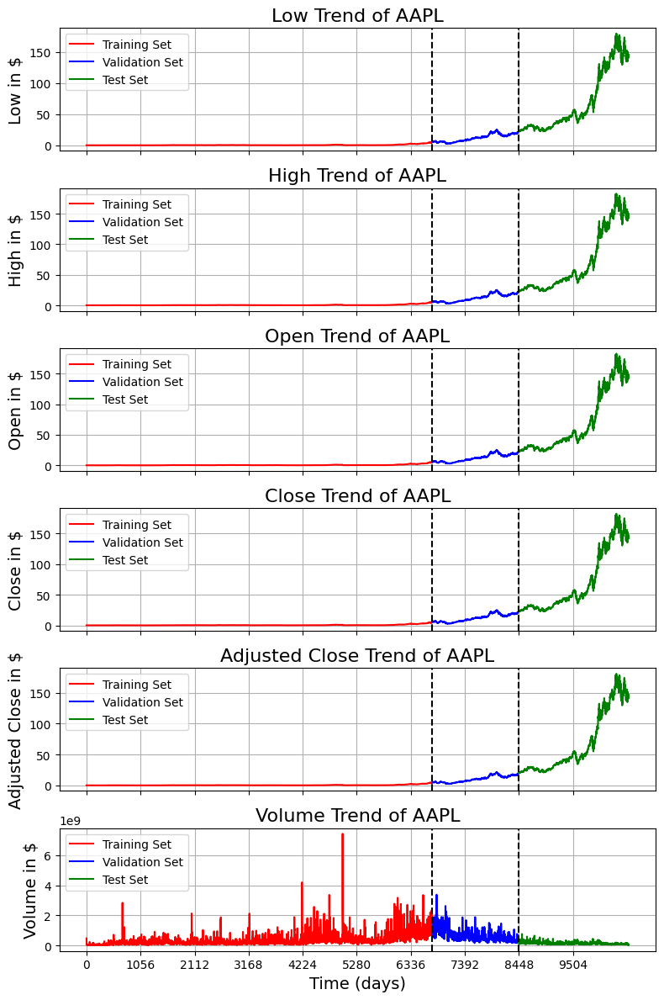

In [11]:
data_visualization(data, X_train, X_val, X_test, features=features)

### 1D Convolutional Neural Network

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                 │ (None, 30, 64)         │         1,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d (MaxPooling1D)    │ (None, 15, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 15, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_1 (MaxPooling1D)  │ (None, 7, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_2 (Conv1D)               │ (None, 7, 64)          │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_2 (MaxPooling1D)  │ (None, 3, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │        19,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 69,961 (273.29 KB)

 Trainable params: 69,961 (273.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.1391 - mse: 4.1391
Epoch 1: val_loss improved from inf to 0.23107, saving model to 1dcnn_norm.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - loss: 3.9784 - mse: 3.9784 - val_loss: 0.2311 - val_mse: 0.2311 - learning_rate: 0.0100
Epoch 2/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.2044 - mse: 0.2044
Epoch 2: val_loss improved from 0.23107 to 0.19369, saving model to 1dcnn_norm.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.2028 - mse: 0.2028 - val_loss: 0.1937 - val_mse: 0.1937 - learning_rate: 0.0100
Epoch 3/50
4/7 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.1755 - mse: 0.1755
Epoch 3: val_loss improved from 0.19369 to 0.13546, saving model to 1dcnn_norm.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.1693 - mse: 0.1693 - val_loss: 0.1355 - val_mse: 0.1355 - learning_rate: 0.0100
Epoch 4/50
4/7 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.1549 - mse: 0.1549
Epoch 4: val_loss improved from 0.13546 to 0.12872, s

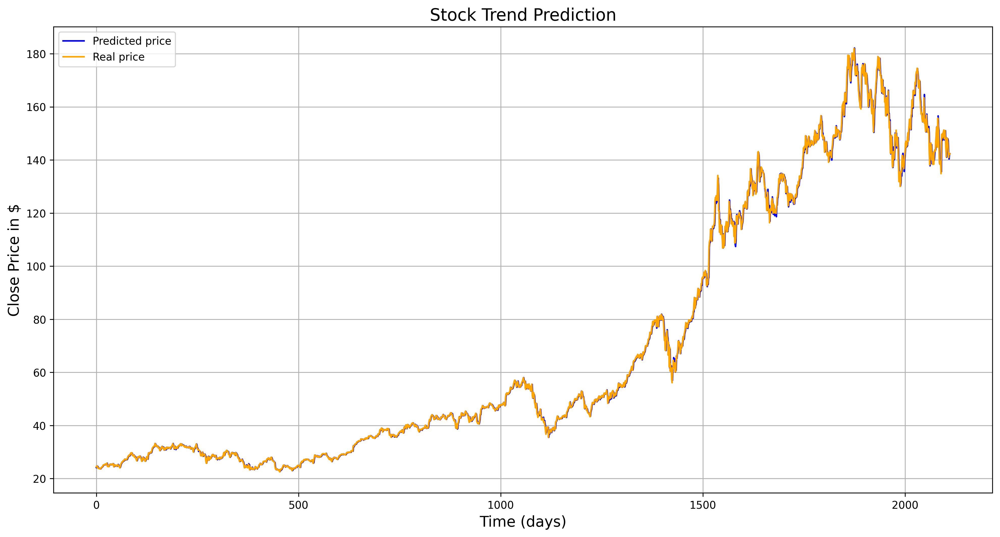

In [12]:
conv1d_1, conv1d_1_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=5,feature_len=len(features),checkpoint_header='1dcnn_norm')
cnn_test(conv1d_1, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 30, 32)         │         4,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,425 (142.29 KB)

 Trainable params: 36,425 (142.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.3069 - mse: 0.3069
Epoch 1: val_loss improved from inf to 0.13474, saving model to lstm_nor.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 135ms/step - loss: 0.2987 - mse: 0.2987 - val_loss: 0.1347 - val_mse: 0.1347 - learning_rate: 0.0100
Epoch 2/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.1036 - mse: 0.1036
Epoch 2: val_loss improved from 0.13474 to 0.07686, saving model to lstm_nor.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - loss: 0.1026 - mse: 0.1026 - val_loss: 0.0769 - val_mse: 0.0769 - learning_rate: 0.0100
Epoch 3/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0669 - mse: 0.0669
Epoch 3: val_loss improved from 0.07686 to 0.05493, saving model to lstm_nor.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - loss: 0.0664 - mse: 0.0664 - val_loss: 0.0549 - val_mse: 0.0549 - learning_rate: 0.0100
Epoch 4/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0548 - mse: 0.0548
Epoch 4: val_loss improved from 0.05493 to 0.04408, saving

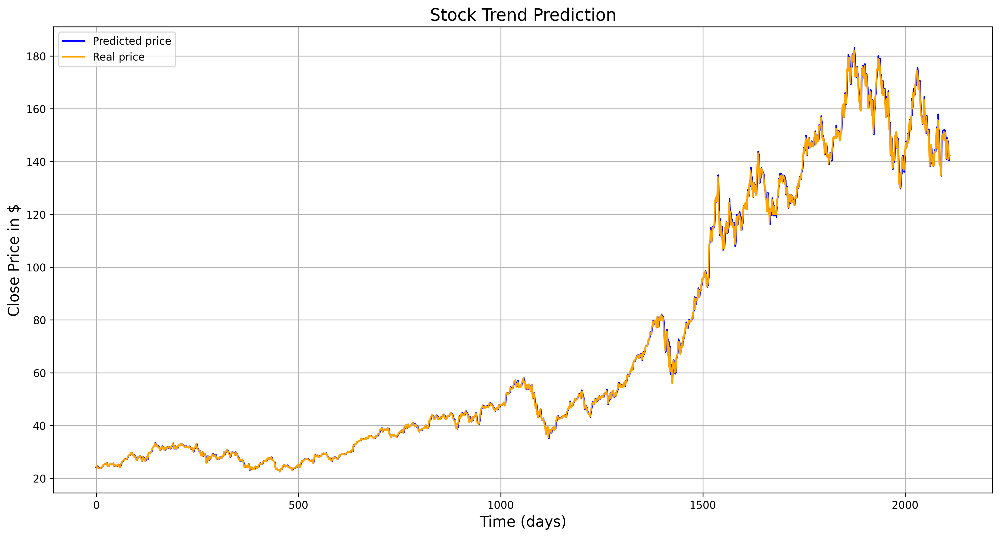

In [13]:
lstm_1, lstm_1_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=5,feature_len=len(features),checkpoint_header='lstm_nor')
lstm_test(lstm_1, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

## Task 1.2

In [14]:
# Parameters
window_size = 60  # Time window for data feature (size of 'number of days').
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']
k_days = 1  # Number of days to predict in the future

In [15]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-nasdaq/AAPL.csv',
    features=features,
    k_days=1,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type = 1
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10590 entries, 0 to 10589
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            10590 non-null  object 
 1   Low             10590 non-null  float64
 2   Open            10590 non-null  float64
 3   Volume          10590 non-null  int64  
 4   High            10590 non-null  float64
 5   Close           10590 non-null  float64
 6   Adjusted Close  10590 non-null  float64
dtypes: float64(5), int64(1), object(1)
memory usage: 579.3+ KB
Shape of training set:  (6738, 60, 6)
Shape of validation set:  (1685, 60, 6)
Shape of test set:  (2106, 60, 6)


### 1D Convolutional Neural Network

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_3 (Conv1D)               │ (None, 60, 64)         │         1,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_3 (MaxPooling1D)  │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_4 (Conv1D)               │ (None, 30, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_4 (MaxPooling1D)  │ (None, 15, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_5 (Conv1D)               │ (None, 15, 64)         │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_5 (MaxPooling1D)  │ (None, 7, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 448)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 100)            │        44,900 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 95,561 (373.29 KB)

 Trainable params: 95,561 (373.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 3.7550 - mse: 3.7550
Epoch 1: val_loss improved from inf to 0.17301, saving model to 1dcnn_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - loss: 3.4978 - mse: 3.4978 - val_loss: 0.1730 - val_mse: 0.1730 - learning_rate: 0.0100
Epoch 2/50
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.1225 - mse: 0.1225
Epoch 2: val_loss improved from 0.17301 to 0.05595, saving model to 1dcnn_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.1202 - mse: 0.1202 - val_loss: 0.0559 - val_mse: 0.0559 - learning_rate: 0.0100
Epoch 3/50
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0579 - mse: 0.0579
Epoch 3: val_loss improved from 0.05595 to 0.02920, saving model to 1dcnn_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0571 - mse: 0.0571 - val_loss: 0.0292 - val_mse: 0.0292 - learning_rate: 0.0100
Epoch 4/50
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0331 - mse: 0.0331
Epoch 4: val_loss did not improve from 0.0

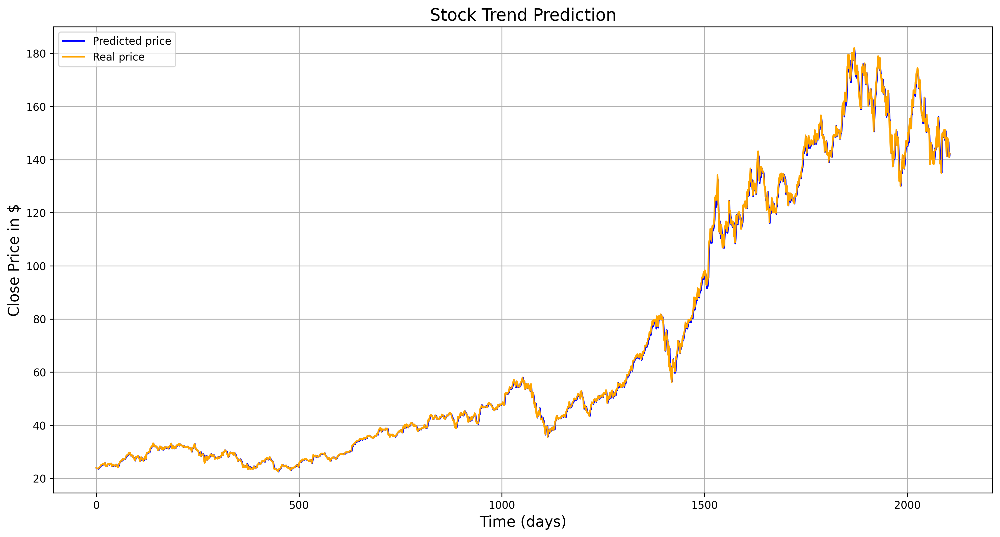

In [16]:
conv1d_2, conv1d_2_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=512,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='1dcnn_day')
cnn_test(conv1d_2, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                   │ (None, 60, 32)         │         4,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_3 (LSTM)                   │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,425 (142.29 KB)

 Trainable params: 36,425 (142.29 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/40
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.2645 - mse: 0.2645
Epoch 1: val_loss improved from inf to 0.05009, saving model to lstm_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 4s 123ms/step - loss: 0.2512 - mse: 0.2512 - val_loss: 0.0501 - val_mse: 0.0501 - learning_rate: 0.0100
Epoch 2/40
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - loss: 0.0444 - mse: 0.0444
Epoch 2: val_loss improved from 0.05009 to 0.03105, saving model to lstm_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - loss: 0.0437 - mse: 0.0437 - val_loss: 0.0310 - val_mse: 0.0310 - learning_rate: 0.0100
Epoch 3/40
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0274 - mse: 0.0274
Epoch 3: val_loss improved from 0.03105 to 0.02016, saving model to lstm_day.keras
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - loss: 0.0272 - mse: 0.0272 - val_loss: 0.0202 - val_mse: 0.0202 - learning_rate: 0.0100
Epoch 4/40
13/14 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - loss: 0.0214 - mse: 0.0214
Epoch 4: val_loss improved from 0.02016 to 

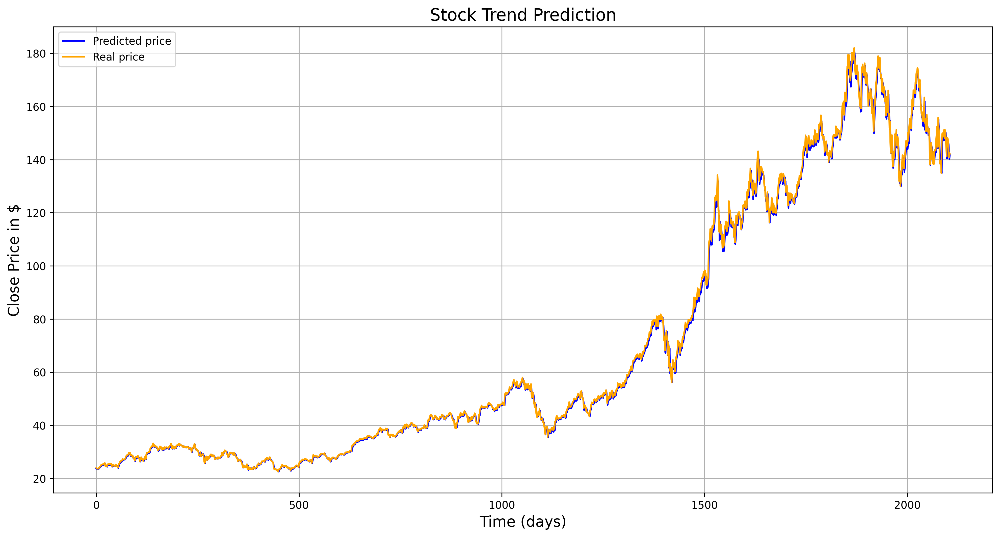

In [17]:
lstm_2, lstm_2_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size,learning_rate=0.01,epochs=40, batch_size=512,min_lr=0.005,lr_patience=2,es_patience=8,checkpoint_header='lstm_day')
lstm_test(lstm_2, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

## Task 1.3

In [18]:
# Parameters
window_size = 75  # Time window for data feature (size of 'number of days').
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']
k_days = 2  # Number of days to predict in the future

In [19]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-nasdaq/AAPL.csv',
    features=features,
    k_days=k_days,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type=2
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10590 entries, 0 to 10589
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            10590 non-null  object 
 1   Low             10590 non-null  float64
 2   Open            10590 non-null  float64
 3   Volume          10590 non-null  int64  
 4   High            10590 non-null  float64
 5   Close           10590 non-null  float64
 6   Adjusted Close  10590 non-null  float64
dtypes: float64(5), int64(1), object(1)
memory usage: 579.3+ KB
Shape of training set:  (6728, 75, 6)
Shape of validation set:  (1683, 75, 6)
Shape of test set:  (2103, 75, 6)


### 1D Convolutional Neural Network

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_6 (Conv1D)               │ (None, 75, 64)         │         1,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_6 (MaxPooling1D)  │ (None, 37, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_7 (Conv1D)               │ (None, 37, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_7 (MaxPooling1D)  │ (None, 18, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_8 (Conv1D)               │ (None, 18, 64)         │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_8 (MaxPooling1D)  │ (None, 9, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 576)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 100)            │        57,700 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │           202 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 108,462 (423.68 KB)

 Trainable params: 108,462 (423.68 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
6/7 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.9575 - mse: 0.9575
Epoch 1: val_loss improved from inf to 0.26790, saving model to 1dcnn_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 100ms/step - loss: 0.8966 - mse: 0.8966 - val_loss: 0.2679 - val_mse: 0.2679 - learning_rate: 0.0100
Epoch 2/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.1782 - mse: 0.1782
Epoch 2: val_loss improved from 0.26790 to 0.14388, saving model to 1dcnn_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.1767 - mse: 0.1767 - val_loss: 0.1439 - val_mse: 0.1439 - learning_rate: 0.0100
Epoch 3/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 0.1345 - mse: 0.1345
Epoch 3: val_loss improved from 0.14388 to 0.12906, saving model to 1dcnn_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1347 - mse: 0.1347 - val_loss: 0.1291 - val_mse: 0.1291 - learning_rate: 0.0100
Epoch 4/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.1325 - mse: 0.1325
Epoch 4: val_loss did not improve from 0

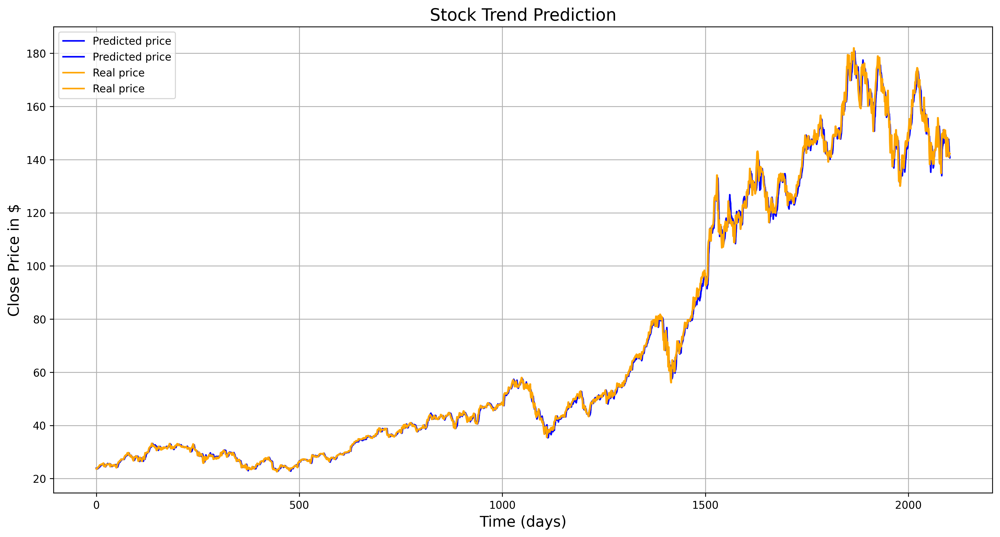

In [20]:
conv1d_3, conv1d_3_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=k_days,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='1dcnn_dayrange')
cnn_test(conv1d_3, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\Documents\Files\F\2024 - 2025 Fall\dl\Final Prj\venv\lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                   │ (None, 75, 32)         │         4,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_5 (LSTM)                   │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │           202 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,526 (142.68 KB)

 Trainable params: 36,526 (142.68 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - loss: 0.5939 - mse: 0.5939
Epoch 1: val_loss improved from inf to 0.17736, saving model to lstm_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 227ms/step - loss: 0.5892 - mse: 0.5892 - val_loss: 0.1774 - val_mse: 0.1774 - learning_rate: 0.0100
Epoch 2/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - loss: 0.1046 - mse: 0.1046
Epoch 2: val_loss improved from 0.17736 to 0.08404, saving model to lstm_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 183ms/step - loss: 0.1025 - mse: 0.1025 - val_loss: 0.0840 - val_mse: 0.0840 - learning_rate: 0.0100
Epoch 3/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step - loss: 0.0624 - mse: 0.0624
Epoch 3: val_loss improved from 0.08404 to 0.03707, saving model to lstm_dayrange.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 183ms/step - loss: 0.0615 - mse: 0.0615 - val_loss: 0.0371 - val_mse: 0.0371 - learning_rate: 0.0100
Epoch 4/50
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - loss: 0.0371 - mse: 0.0371
Epoch 4: val_loss improved from 0.037

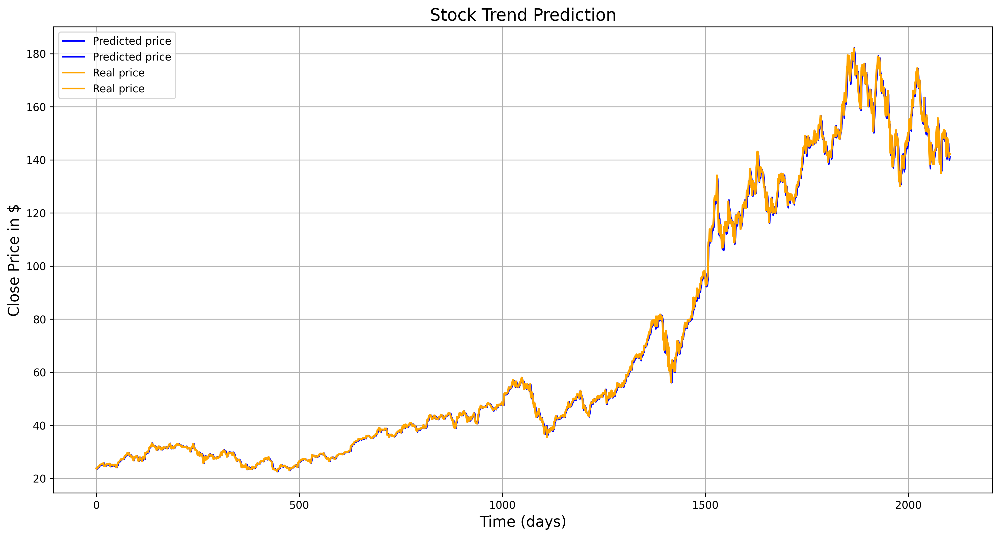

In [21]:
lstm_3, lstm_3_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=k_days,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='lstm_dayrange')
lstm_test(lstm_3, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

## Task 1 Model Testing

In [39]:
def load_test_data(data_path, features, k_days=1, feature_choice='Close', window_size=30, type=0):
    # Load data and parse dates with dayfirst=True
    df = pd.read_csv(data_path)  # Adjust 'Date' to your actual date column name
    # df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')  # Ensure correct date format if necessary

    # Convert DataFrame to NumPy array, excluding non-numeric columns
    df_values = df[features].values  # Only take the specified features
    feature_choice_index = features.index(feature_choice)
    
    if feature_choice_index == -1:
        raise ValueError("Feature not found in features list")
    
    if type == 2:
        num_samples = len(df_values) - window_size - (k_days - 1)
    elif type == 1:
        num_samples = len(df_values) - window_size - k_days
    else:
        num_samples = len(df_values) - window_size

    X_data = np.empty((num_samples, window_size, len(features)))
    if type == 2:
        y_data = np.empty((num_samples, k_days))
    else:
        y_data = np.empty((num_samples, 1))

    # Efficiently fill X_data and y_data
    for i in range(num_samples):
        X_data[i] = df_values[i:i + window_size]  # Use the filtered numeric values
        if type == 0:
            y_data[i] = df_values[i + window_size, feature_choice_index]
        elif type == 1:
            y_data[i] = df_values[i + window_size + k_days - 1, feature_choice_index]
        elif type == 2:
            y_data[i] = df_values[i + window_size:i + window_size + k_days, feature_choice_index]

    # Normalize and handle NaN values
    X_data_norm, y_data_norm, _, _ = min_max_normalize(X_data, y_data, feature_choice_index, len(features))

    # Replace NaN with column mean
    X_data_norm = np.where(np.isnan(X_data_norm), np.nanmean(X_data_norm, axis=0), X_data_norm)
    y_data_norm = np.where(np.isnan(y_data_norm), np.nanmean(y_data_norm, axis=0), y_data_norm)

    # Clip values
    X_data_norm = np.clip(X_data_norm, np.finfo(np.float32).min, np.finfo(np.float32).max)
    y_data_norm = np.clip(y_data_norm, np.finfo(np.float32).min, np.finfo(np.float32).max)

    X_data_norm_t = tf.convert_to_tensor(X_data_norm, dtype=tf.float32)
    y_data_norm_t = tf.convert_to_tensor(y_data_norm, dtype=tf.float32)

    return df, X_data, y_data, X_data_norm, y_data_norm, X_data_norm_t, y_data_norm_t, feature_choice_index

In [40]:
def load_test_data_2(data_path, features, k_days=1, feature_choice='Close', window_size=30, type=0):
    # Load data
    data = pd.read_csv(data_path)
    # Show some first data samples
    # data.head()
    # data.info()
    df = data
    # print(f'Pre-fill NaN values: {df.shape}')
    # df.fillna(method='ffill', inplace=True)
    # print(f'Post-fill NaN values: {df.shape}')
    
    # Get feature_choice index in features
    feature_choice_index = features.index(feature_choice)
    if feature_choice_index == -1:
        raise ValueError("Feature not found in features list")
    
    # Pre-allocate arrays for X_data and y_data
    match (type):
        case (0):
            num_samples = len(df) - window_size
        case (1): 
            num_samples = len(df) - window_size - k_days
        case (2):
            num_samples = len(df) - window_size - k_days + 1
    
    X_data = np.empty((num_samples, window_size, len(features)))
    y_data = np.empty((num_samples, k_days) if type == 2 else (num_samples, 1))

    # Use NumPy array slicing for efficient data extraction
    for i in range(num_samples):
        # Use slicing to get the features for the window
        X_data[i] = df.iloc[i:i + window_size][features].values
        # Get the label for the next day's 'Close' price
        match (type):
            case (0):
                y_data[i] = df.iloc[i + window_size][feature_choice]
            case (1):
                y_data[i] = df.iloc[i + window_size + k_days - 1][feature_choice]
            case (2):
                y_data[i] = df.iloc[i + window_size:i + window_size + k_days][feature_choice]
    
    # Convert from lists to Numpy arrays for reshaping purpose
    X_data = np.array(X_data)
    y_data = np.array(y_data)

    # Reshape the numpy array to fit the neural network input shape requirement
    X_data = X_data.reshape(X_data.shape[0], window_size, len(features))

    # Print shape of the training, validation and test set
    # print("Shape of data: ", X_data.shape)
    # print("Shape of data: ", y_data.shape)
    
    X_data_norm, y_data_norm, X_data_norm_t, y_data_norm_t = min_max_normalize(X_data, y_data, feature_choice_index, len(features))
    
    # Handle potential infinities
    X_data_norm = np.where(np.isinf(X_data_norm), np.nan, X_data_norm)
    y_data_norm = np.where(np.isinf(y_data_norm), np.nan, y_data_norm)
    
    # Replace NaN with column mean using NumPy
    if np.isnan(X_data_norm).any():
        mean_value = np.nanmean(X_data_norm, axis=0)
        indices = np.where(np.isnan(X_data_norm))
        X_data_norm[indices] = np.take(mean_value, indices[1])
    
    if np.isnan(y_data_norm).any():
        mean_value = np.nanmean(y_data_norm, axis=0)
        indices = np.where(np.isnan(y_data_norm))
        y_data_norm[indices] = np.take(mean_value, indices[1])
    
    # Clip values to be within the range of float32
    X_data_norm = np.clip(X_data_norm, np.finfo(np.float32).min, np.finfo(np.float32).max)
    y_data_norm = np.clip(y_data_norm, np.finfo(np.float32).min, np.finfo(np.float32).max)
    
    X_data_norm_t = tf.convert_to_tensor(X_data_norm, dtype=tf.float64)
    y_data_norm_t = tf.convert_to_tensor(y_data_norm, dtype=tf.float64)
        
    return data, X_data, y_data, X_data_norm, y_data_norm, X_data_norm_t, y_data_norm_t, feature_choice_index

In [45]:
def model_test(model, X_data_norm_t, y_data_norm_t, X_test, y_data, feature_choice_index, stock_name=None):
    # Get prediction on the test data
    model_y_pred_norm = model.predict(X_data_norm_t)
    print("MSE on the test set: ", mean_squared_error(model_y_pred_norm, y_data_norm_t))
    
    # Create a copy for denormalization
    model_y_pred_denorm = model_y_pred_norm.copy()

    # Denormalization of predicted values
    for i in range(len(model_y_pred_denorm)):
        min_close = np.min(X_test[i][:,feature_choice_index]) 
        max_close = np.max(X_test[i][:,feature_choice_index]) 
        model_y_pred_denorm[i] = model_y_pred_norm[i] * (max_close - min_close) + min_close
    # print(model_y_pred_denorm.shape, y_data.shape)
    # Plot 1: Predicted vs Real Prices
    plt.plot(model_y_pred_denorm, label='Predicted price', color='blue')
    plt.plot(y_data, label='Real price', color='orange')
    plt.title(f'Stock Trend Prediction {stock_name if stock_name else ""}', fontsize=16)
    plt.xlabel('Time (days)', fontsize=14)
    plt.ylabel('Close Price in $', fontsize=14)
    plt.grid()
    plt.legend()

    plt.tight_layout()
    plt.show()
    plt.close()  # Close the figure to free up memory

In [42]:
def load_all_data(nasqad100, features, window_size=30, k_days=1, feature_choice='Close', type=0):
    all_X_data = {}
    all_y_data = {}
    all_X_data_norm = {}
    all_y_data_norm = {}
    all_X_data_norm_t = {}
    all_y_data_norm_t = {}
    all_feature_choice_indices = {}

    for stock in nasqad100:
        data_path = f'./data-nasdaq/{stock}.csv'
        if not os.path.exists(data_path):
            continue

        try:
            # Load data for each stock
            data, X_data, y_data, X_data_norm, y_data_norm, X_data_norm_t, y_data_norm_t, feature_choice_index = load_test_data(
                data_path=data_path,
                features=features,
                k_days=k_days,
                feature_choice=feature_choice,
                window_size=window_size,
                type=type
            )

            # Store data for each stock
            all_X_data[stock] = X_data
            all_y_data[stock] = y_data
            all_X_data_norm[stock] = X_data_norm
            all_y_data_norm[stock] = y_data_norm
            all_X_data_norm_t[stock] = X_data_norm_t
            all_y_data_norm_t[stock] = y_data_norm_t
            all_feature_choice_indices[stock] = feature_choice_index

        except Exception as e:
            print(f"Error processing {stock}: {e}")
            continue

    return (all_X_data, all_y_data, 
            all_X_data_norm, all_y_data_norm, 
            all_X_data_norm_t, all_y_data_norm_t, 
            all_feature_choice_indices)

In [26]:
# nasqad100 list
nasqad100 = ['ADBE','AMD','ABNB','GOOGL','GOOG','AMZN','AEP','AMGN','ADI','ANSS','AAPL','AMAT','APP','ARM','ASML','AZN','TEAM','ADSK','ADP','BKR','BIIB','BKNG','AVGO','CDNS','CDW','CHTR','CTAS','CSCO','CCEP','CTSH','CMCSA','CEG','CPRT','CSGP','COST','CRWD','CSX','DDOG','DXCM','FANG','DASH','EA','EXC','FAST','FTNT','GEHC','GILD','GFS','HON','IDXX','ILMN','INTC','INTU','ISRG','KDP','KLAC','KHC','LRCX','LIN','LULU','MAR','MRVL','MELI','META','MCHP','MU','MSFT','MRNA','MDLZ','MDB','MNST','NFLX','NVDA','NXPI','ORLY','ODFL','ON','PCAR','PANW','PAYX','PYPL','PDD','PEP','QCOM','REGN','ROP','ROST','SBUX','SMCI','SNPS','TTWO','TMUS','TSLA','TXN','TTD','VRSK','VRTX','WBD','WDAY','XEL','ZS']
window_size = 30
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']

### Task 1.1

#### 1D Convolutional Neural Network

286/286 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.029411359
(9128, 1) (9128, 1)


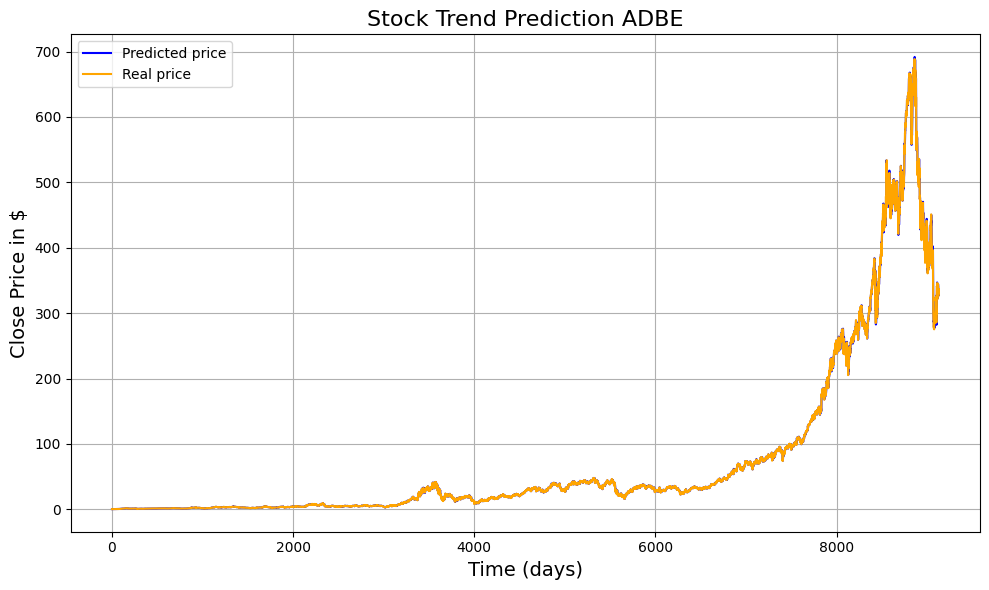

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.028748723
(10748, 1) (10748, 1)


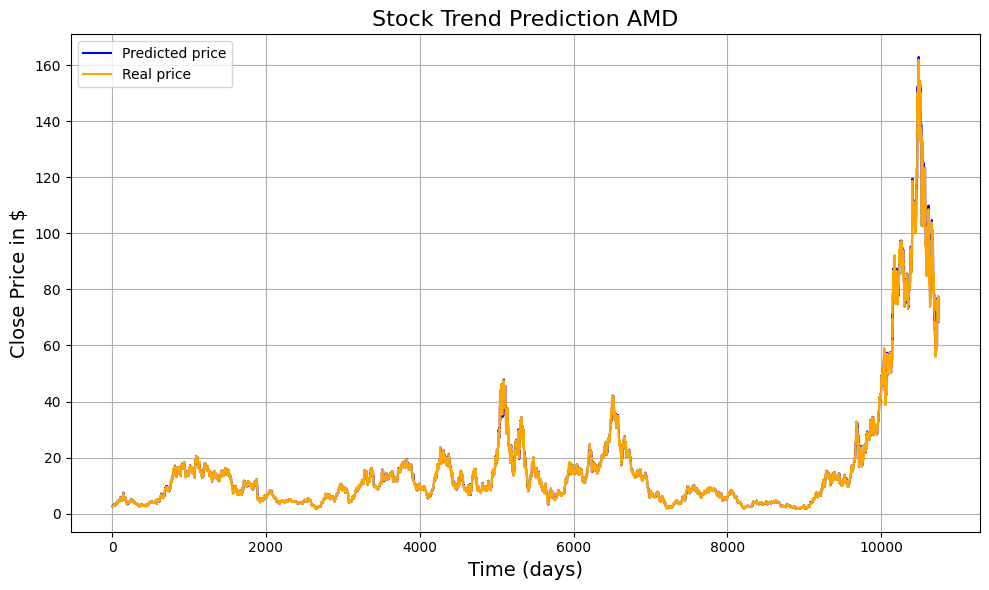

201/201 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031710442
(6408, 1) (6408, 1)


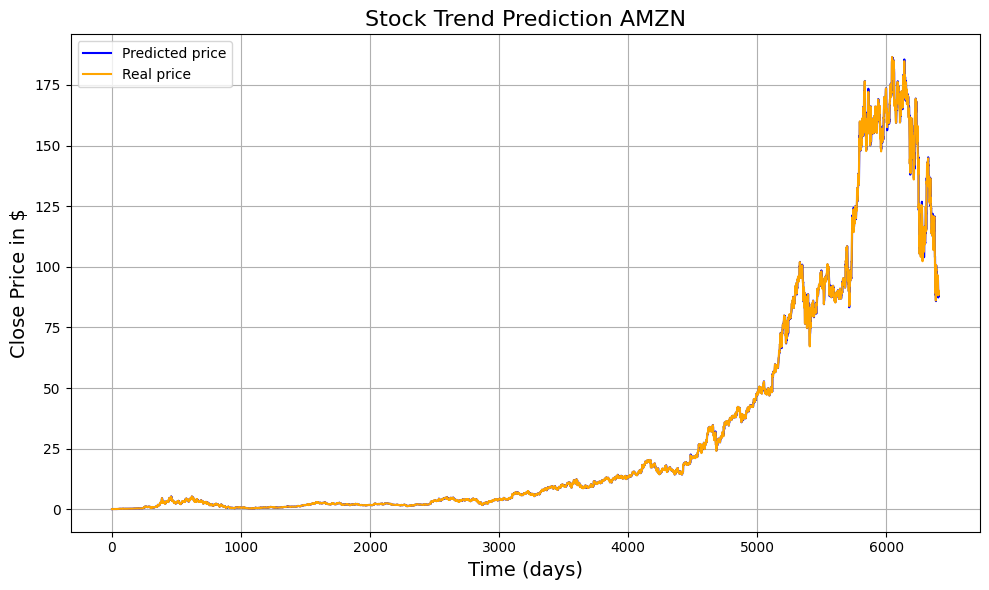

311/311 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.029450487
(9925, 1) (9925, 1)


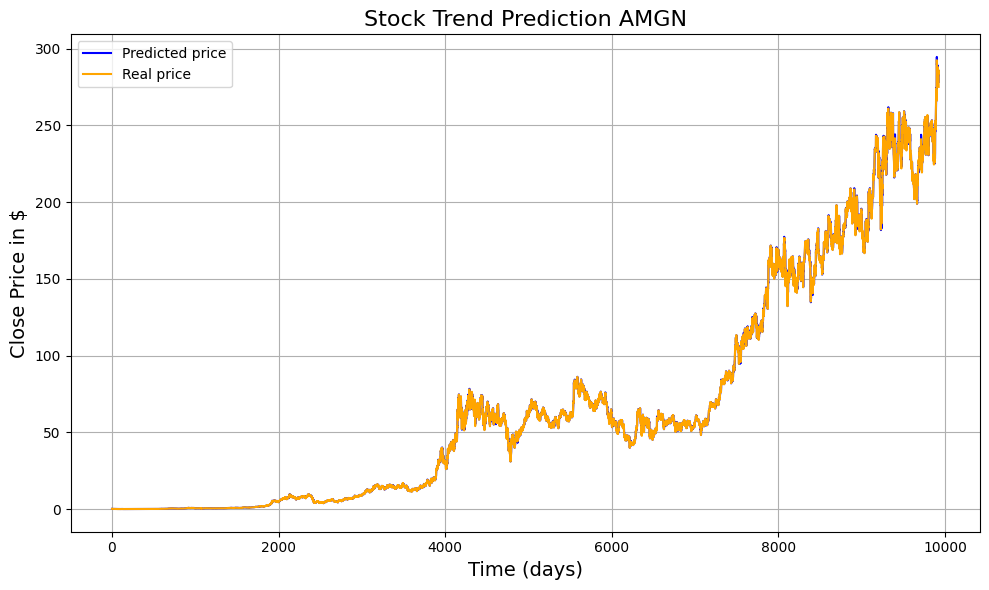

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031174947
(10748, 1) (10748, 1)


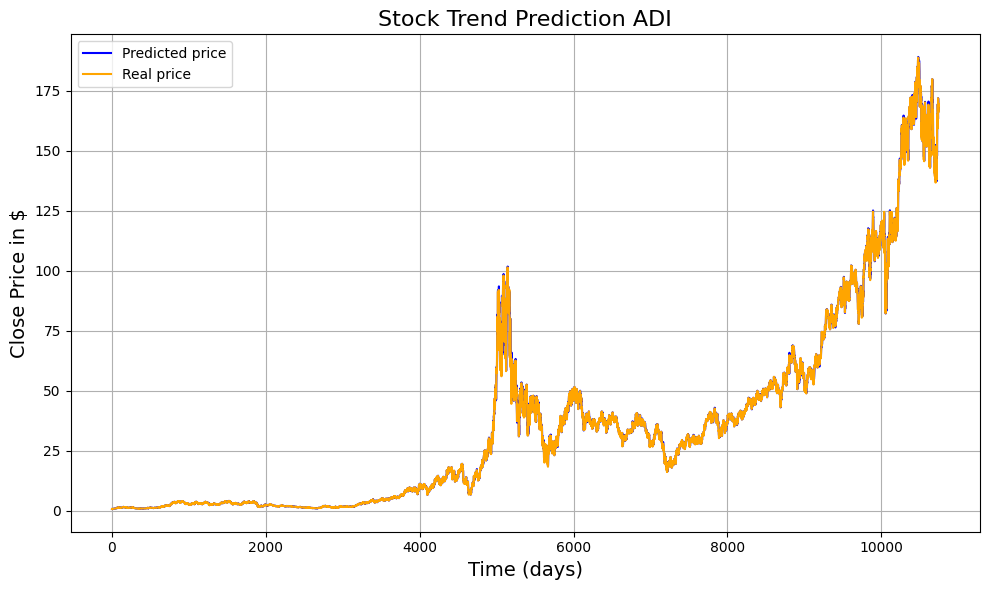

330/330 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.025807029
(10560, 1) (10560, 1)


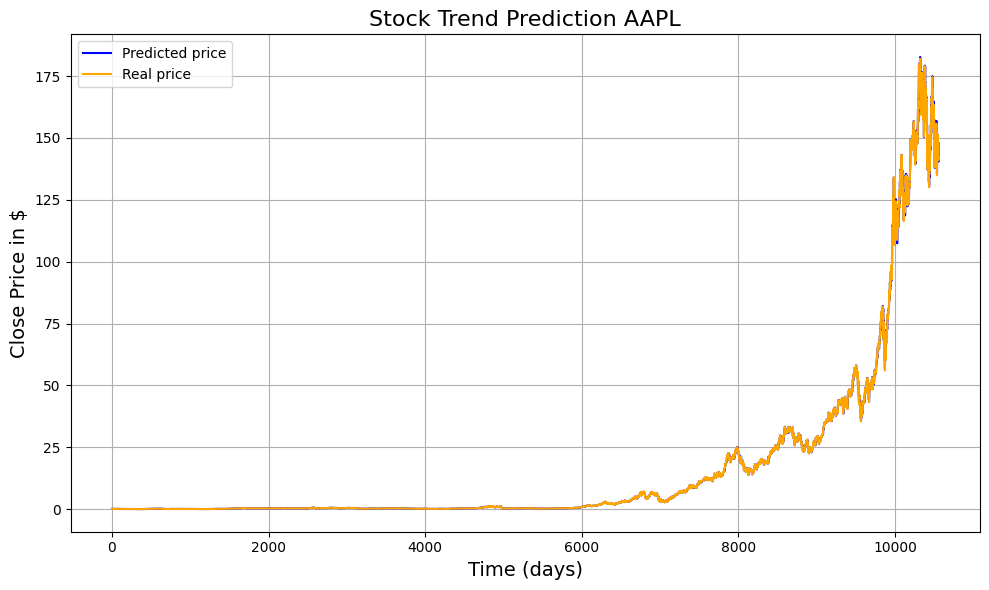

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.026676679
(10748, 1) (10748, 1)


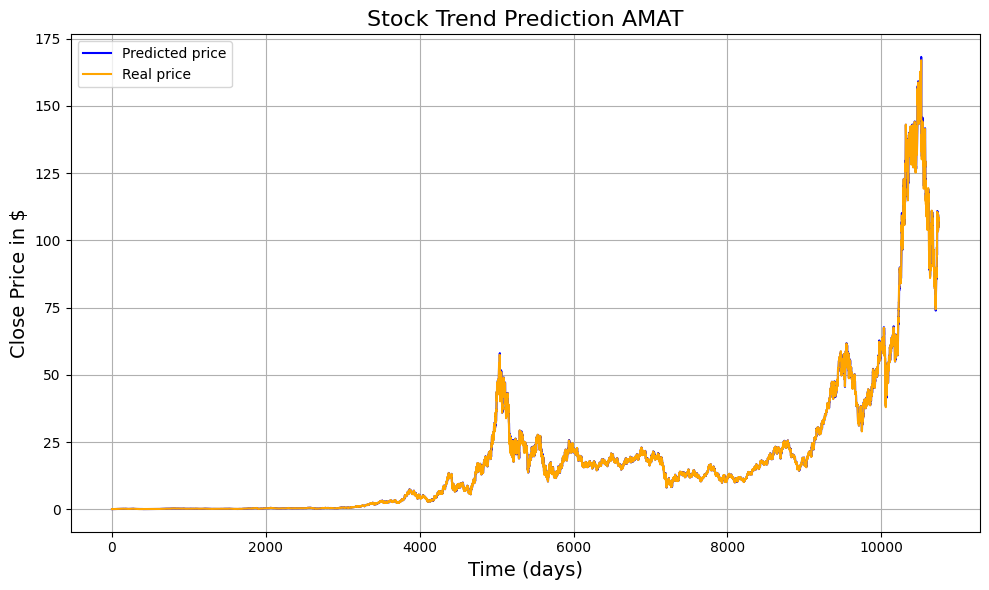

218/218 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.02702759
(6957, 1) (6957, 1)


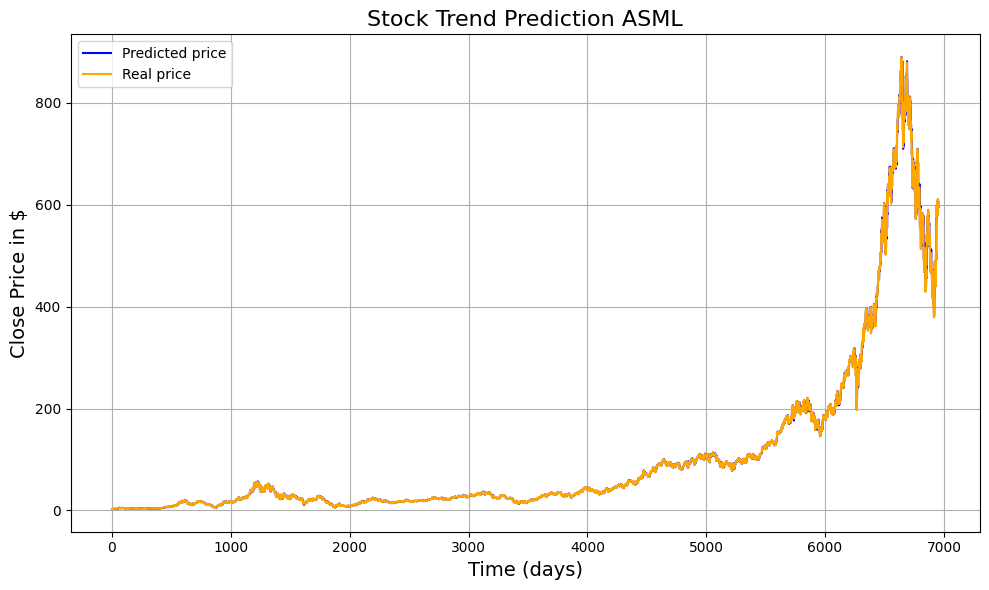

295/295 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.029523592
(9411, 1) (9411, 1)


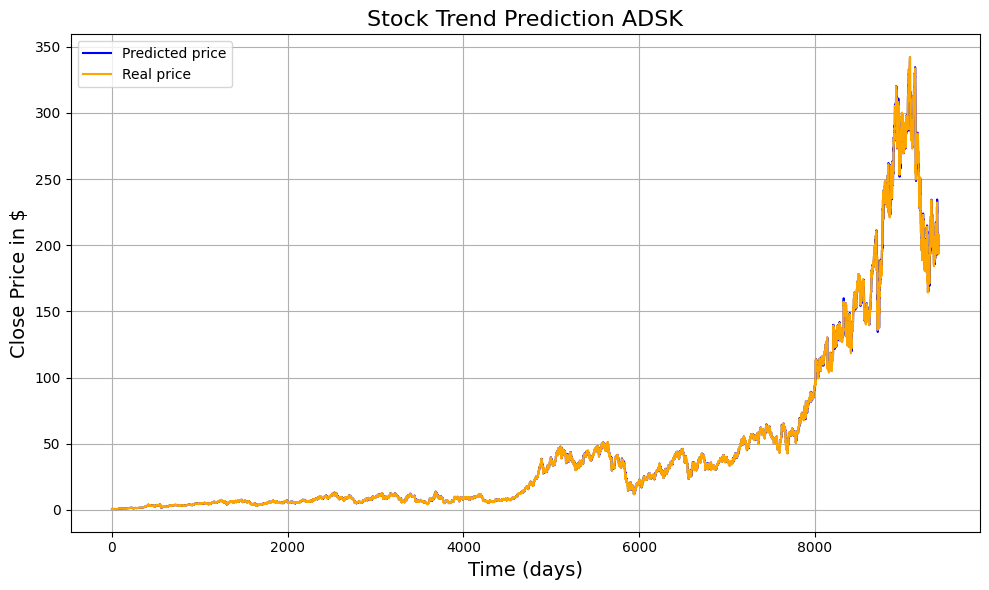

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.030693807
(10748, 1) (10748, 1)


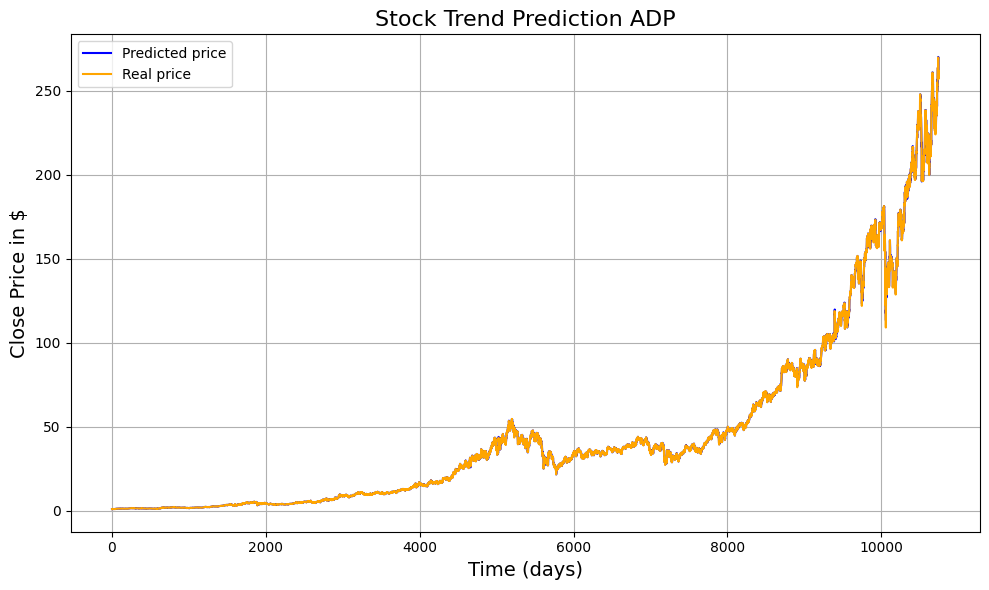

245/245 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.043486975
(7840, 1) (7840, 1)


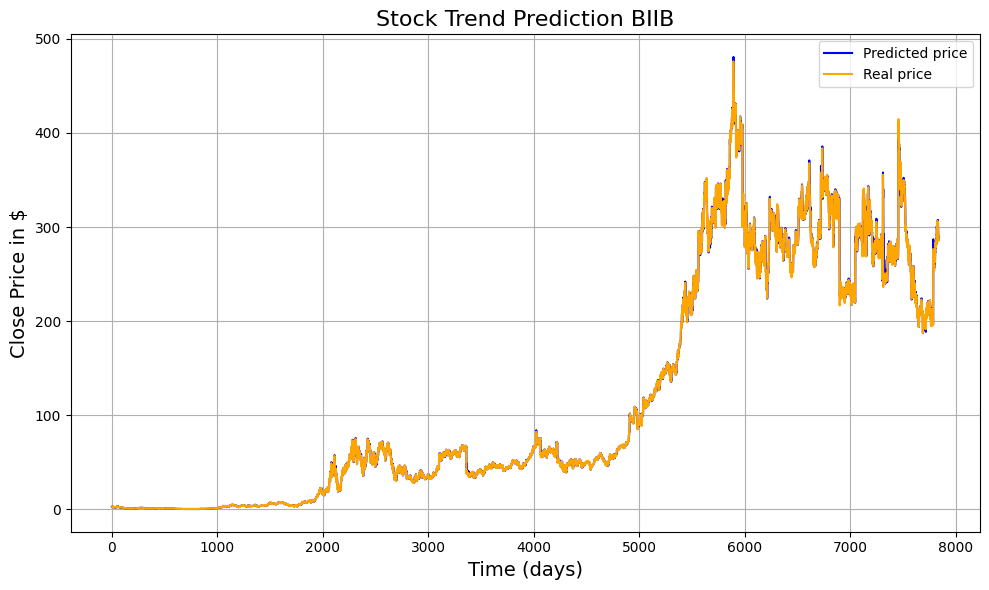

279/279 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.030503158
(8920, 1) (8920, 1)


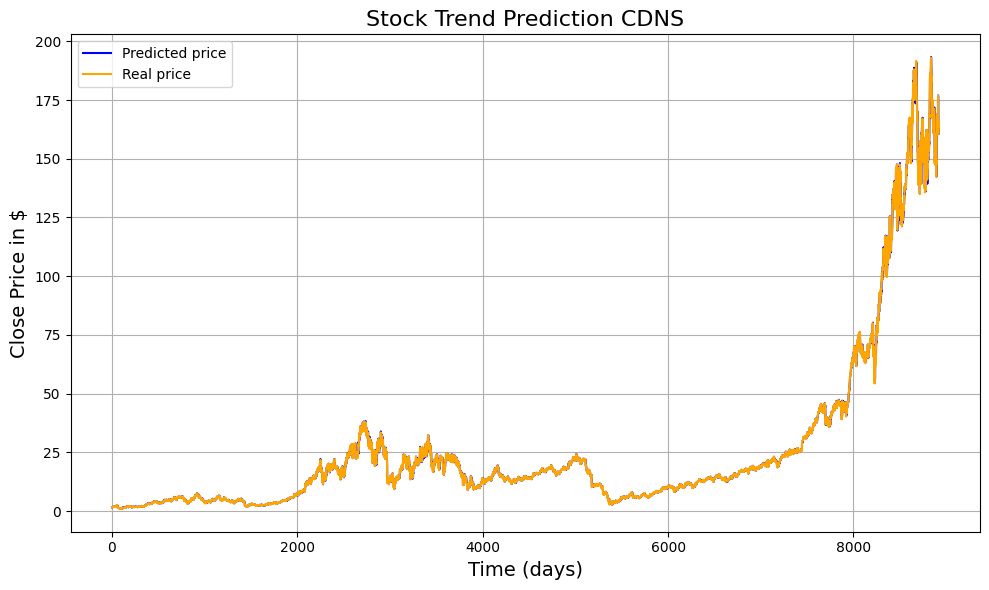

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.02904232
(2353, 1) (2353, 1)


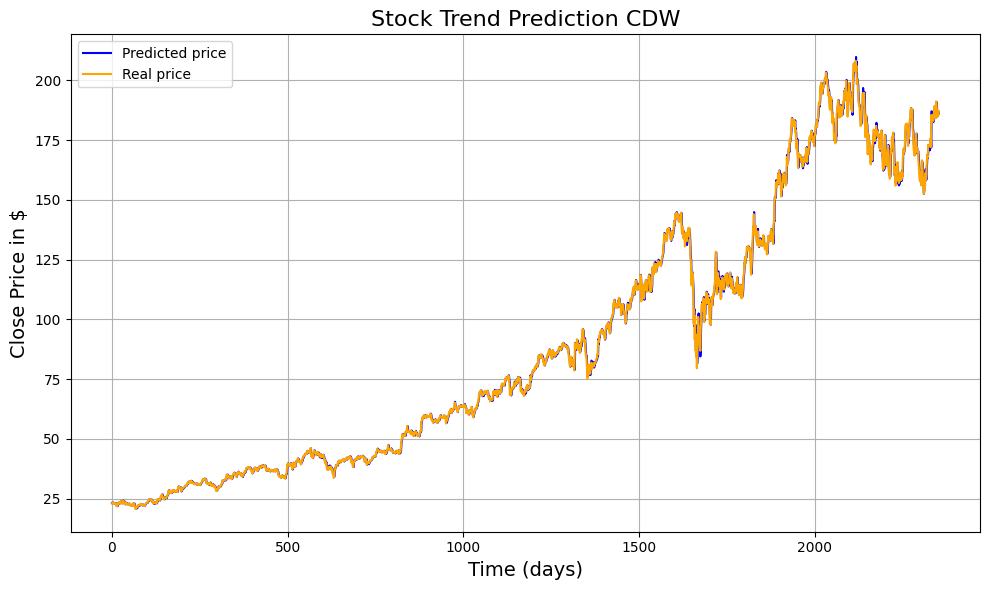

101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.029546466
(3228, 1) (3228, 1)


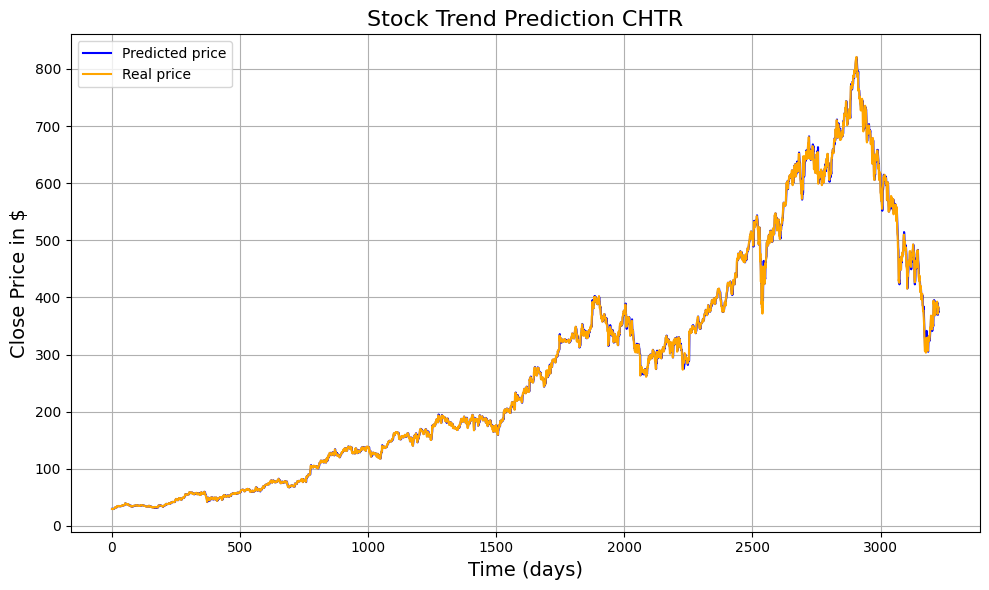

309/309 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.034844685
(9881, 1) (9881, 1)


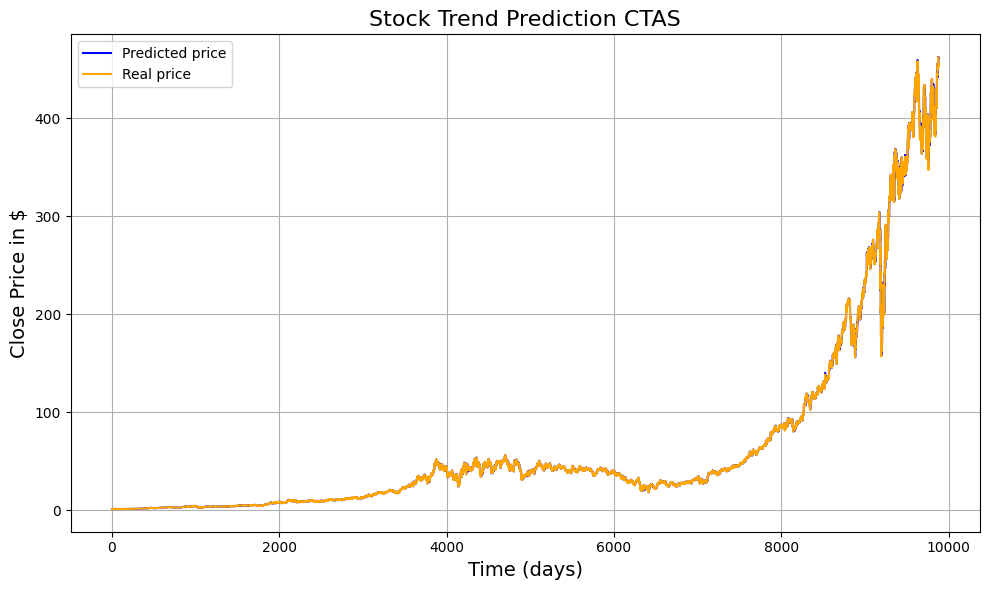

258/258 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.030336497
(8239, 1) (8239, 1)


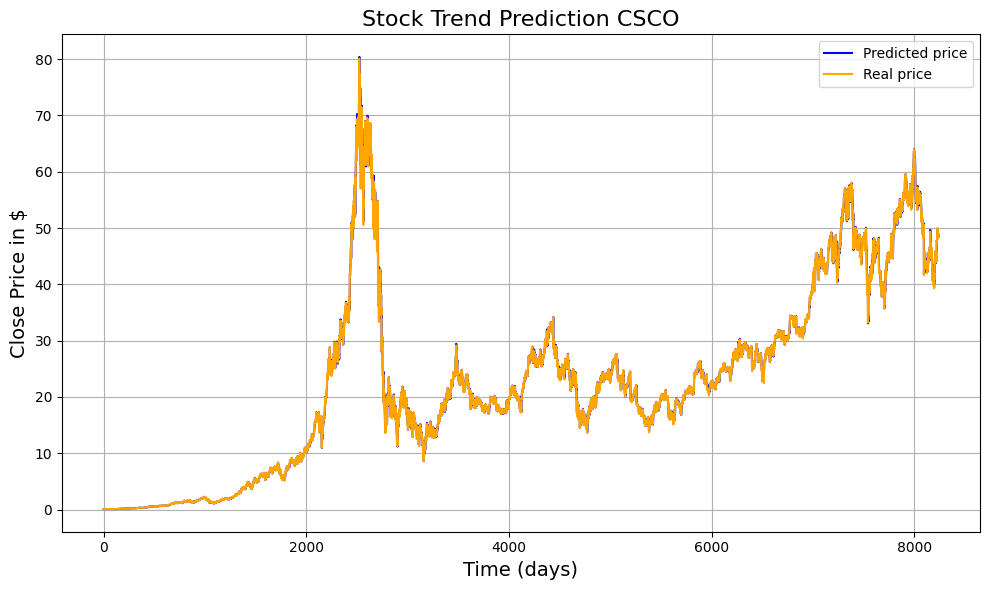

192/192 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.034541983
(6132, 1) (6132, 1)


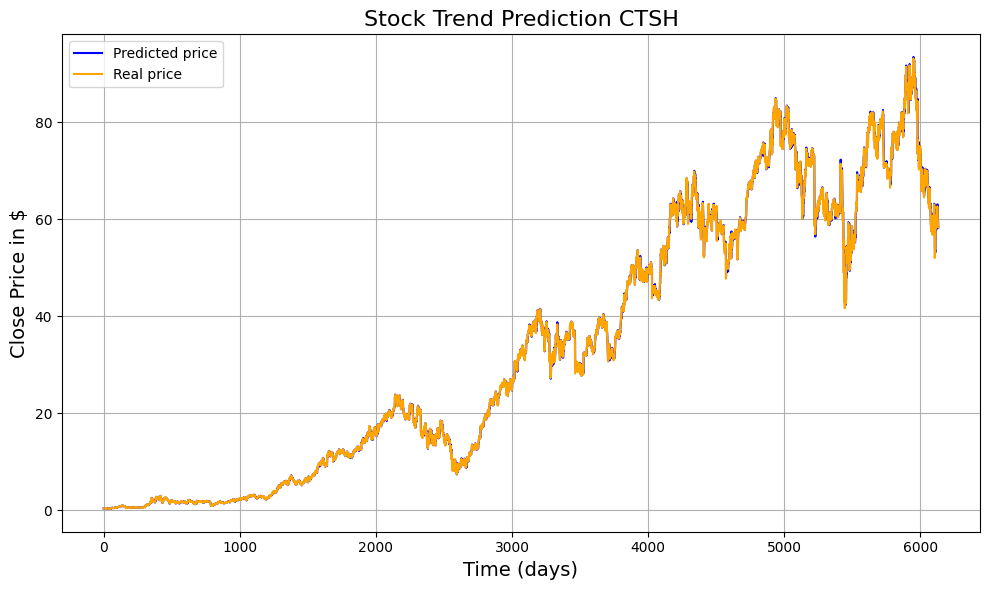

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.029145395
(10748, 1) (10748, 1)


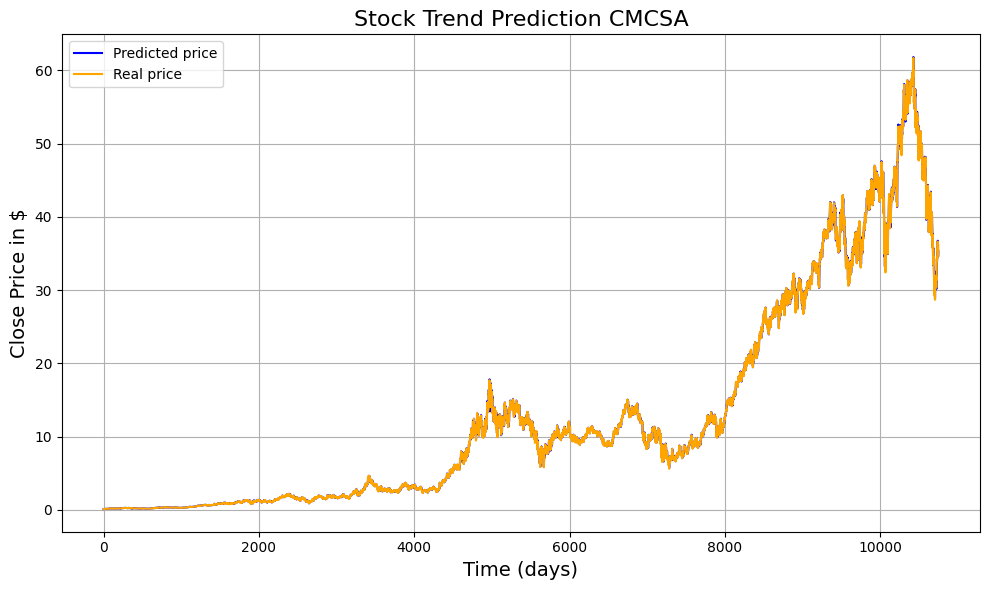

226/226 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.035902377
(7207, 1) (7207, 1)


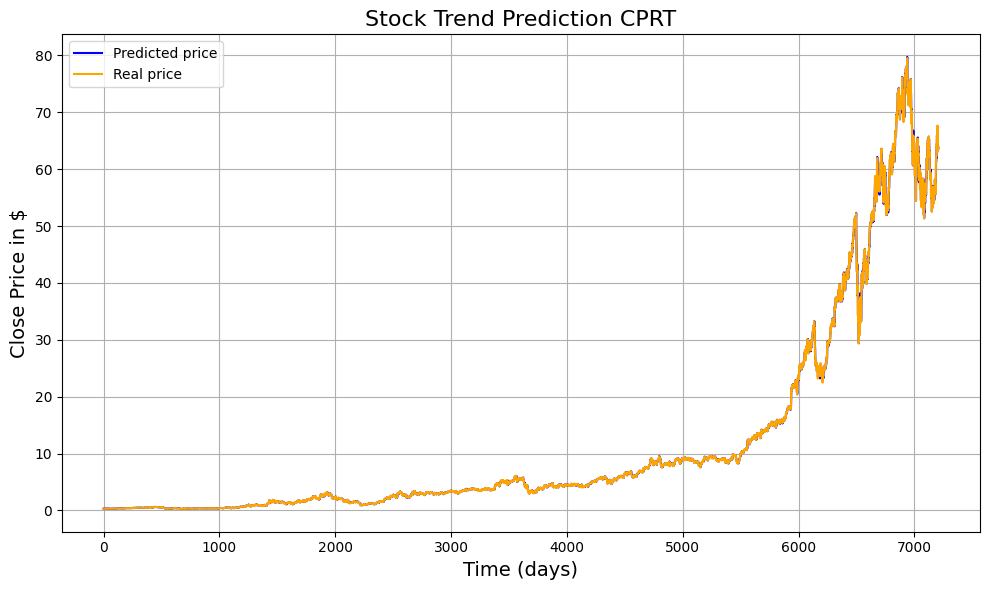

192/192 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031101752
(6124, 1) (6124, 1)


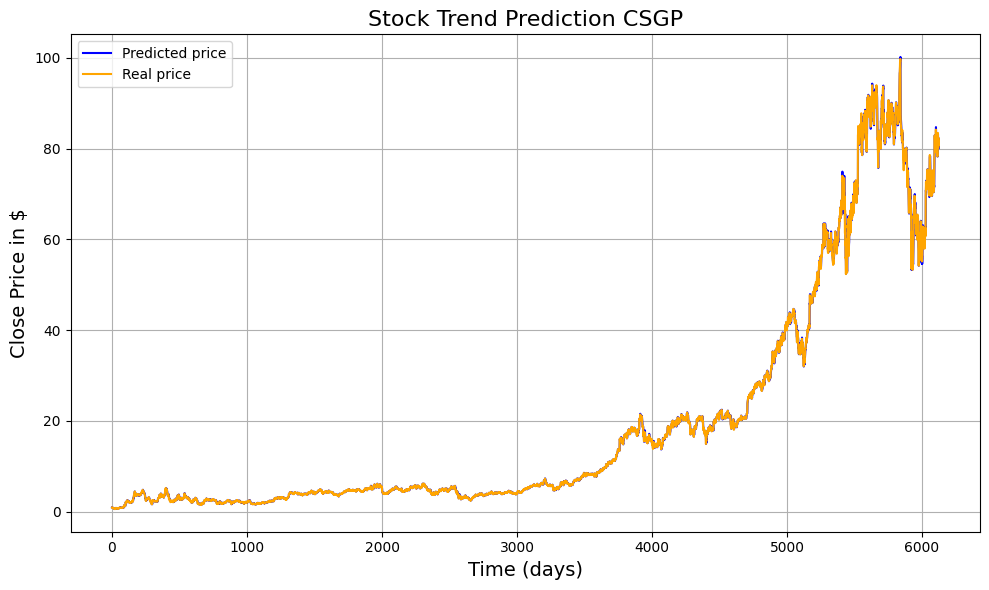

287/287 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.032952048
(9153, 1) (9153, 1)


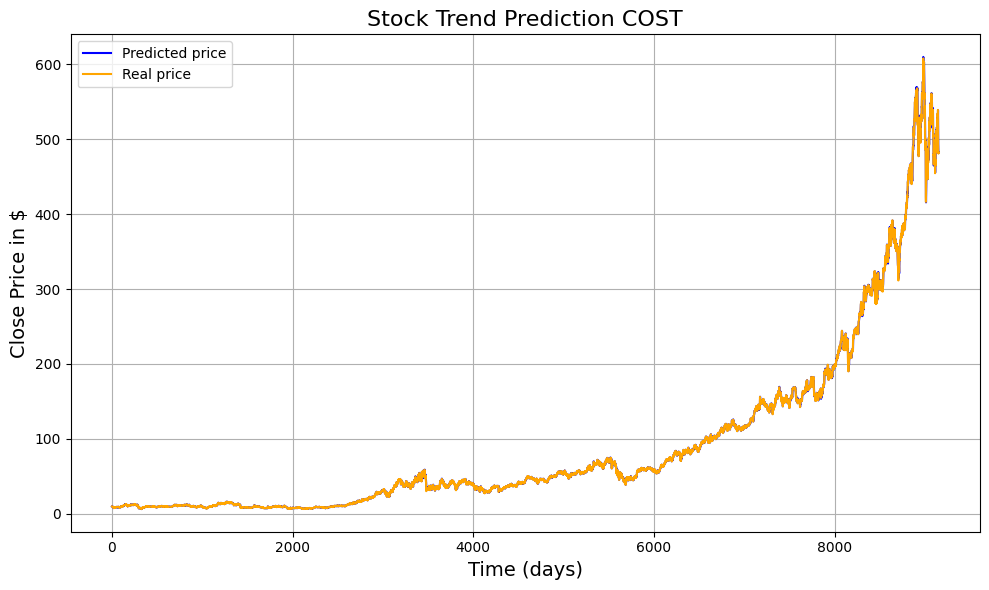

139/139 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.036321238
(4418, 1) (4418, 1)


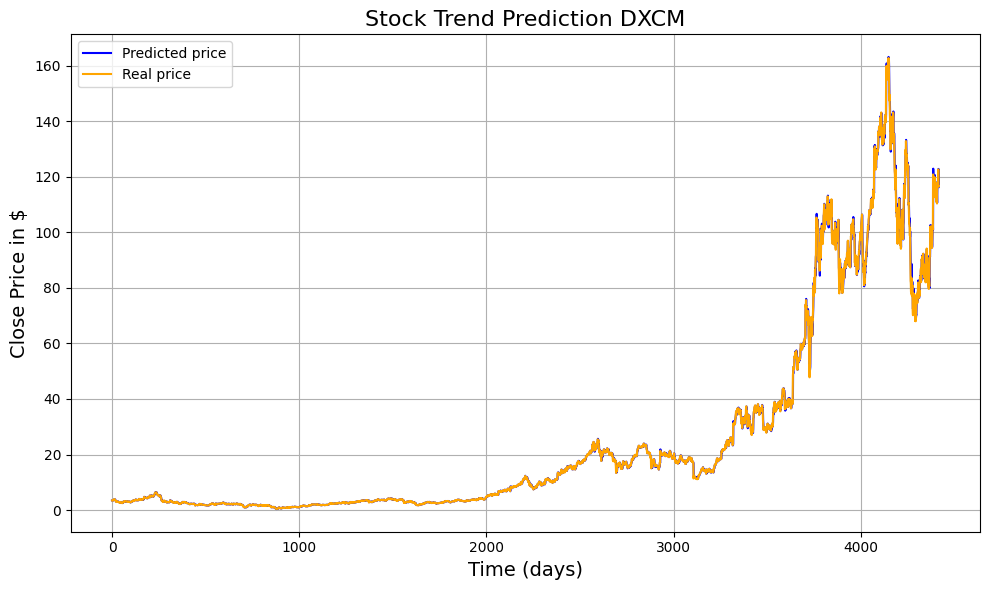

79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.032443244
(2528, 1) (2528, 1)


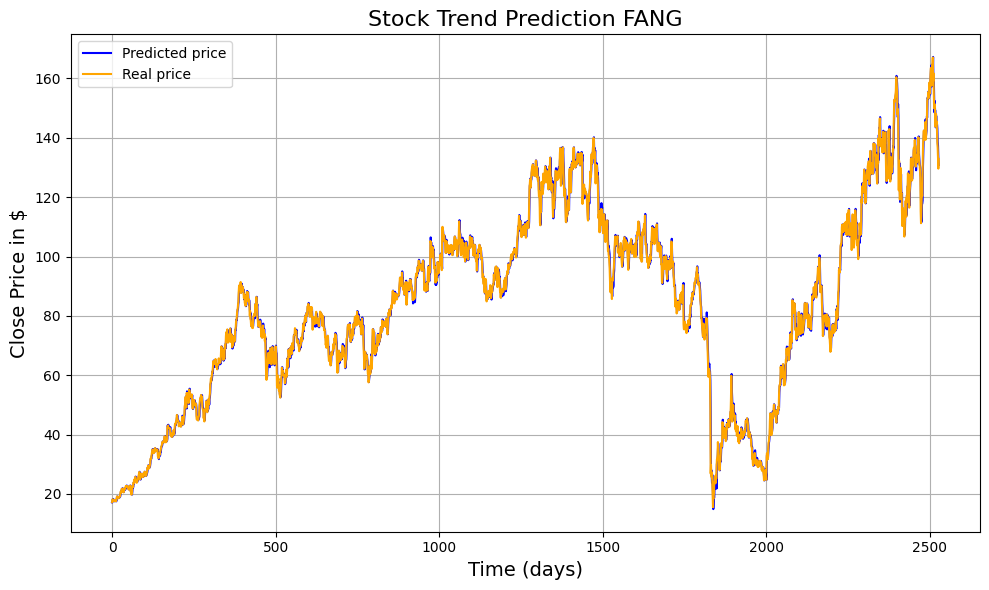

261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033441927
(8343, 1) (8343, 1)


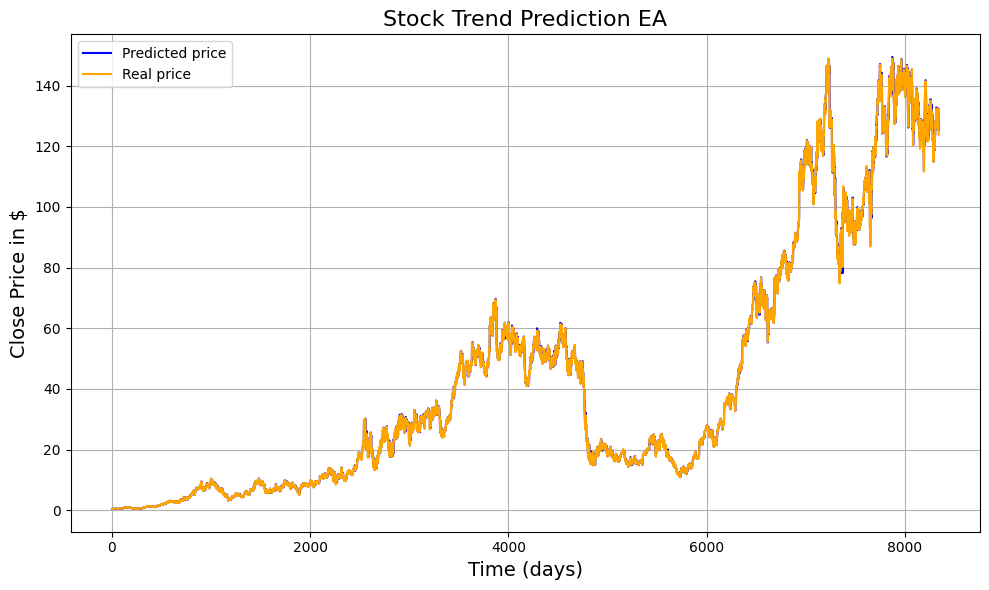

278/278 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03055608
(8870, 1) (8870, 1)


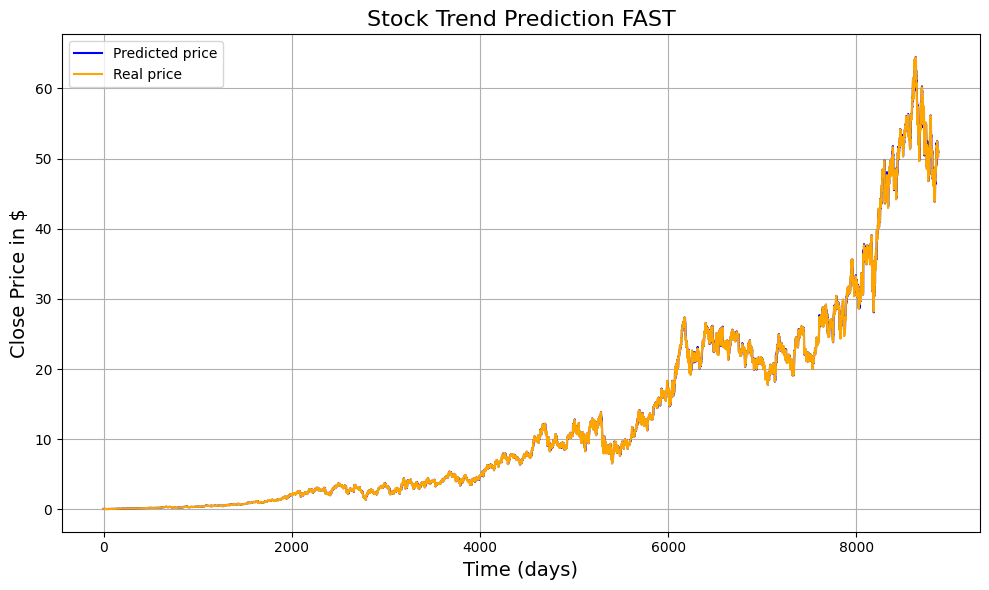

102/102 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.036850087
(3259, 1) (3259, 1)


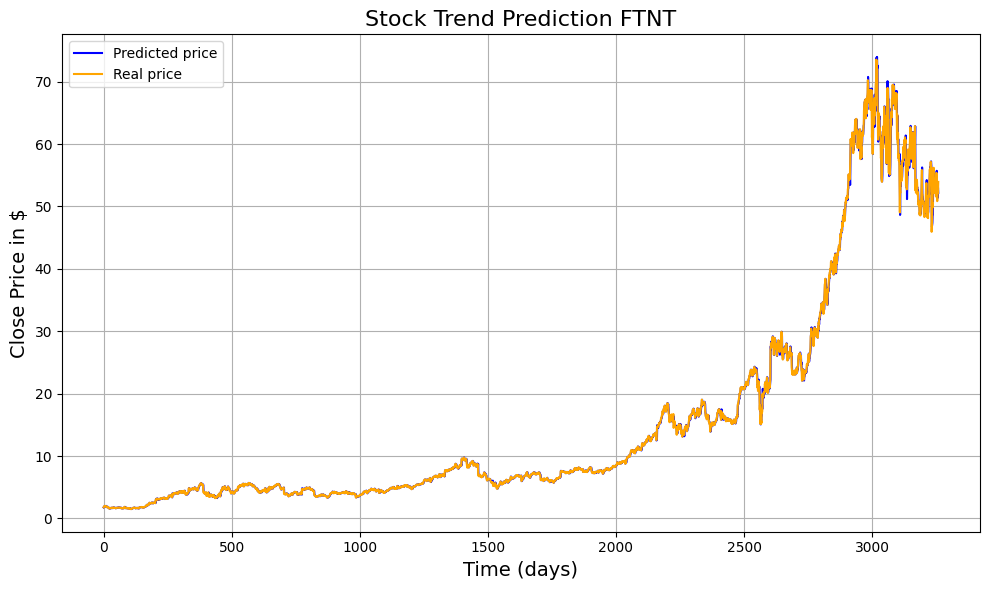

243/243 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.032366347
(7752, 1) (7752, 1)


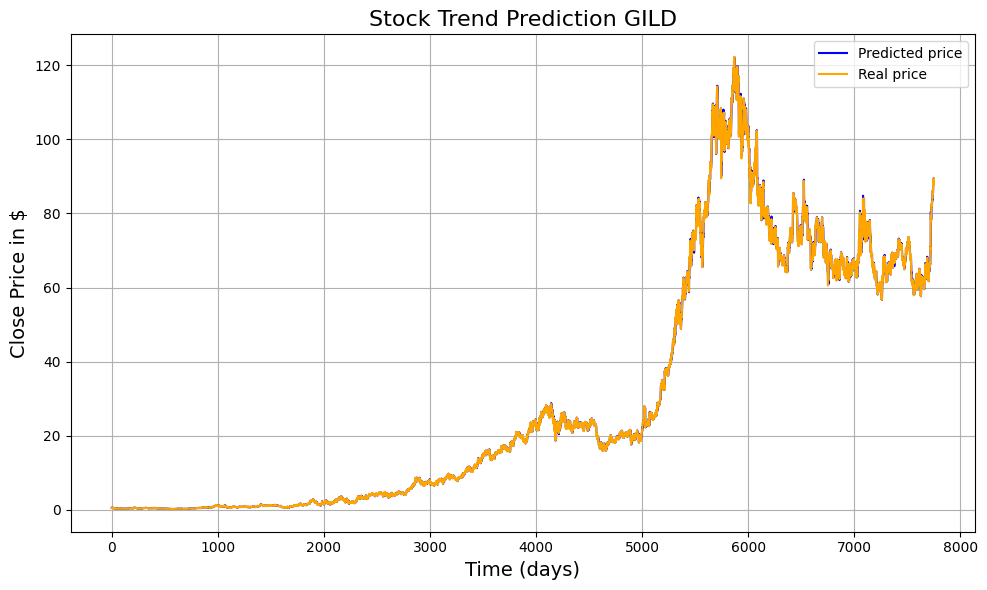

247/247 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033936173
(7900, 1) (7900, 1)


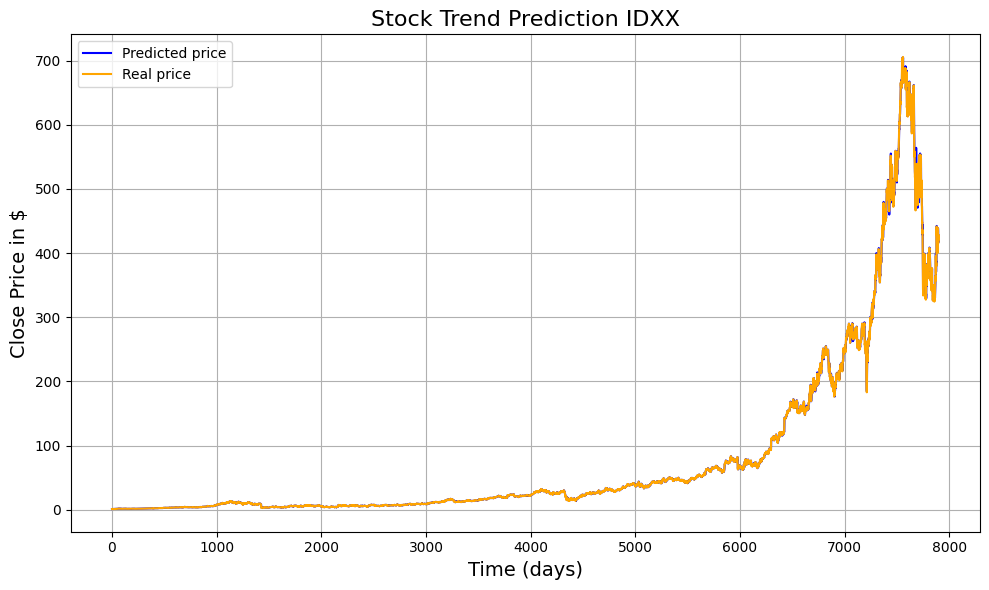

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03195201
(5600, 1) (5600, 1)


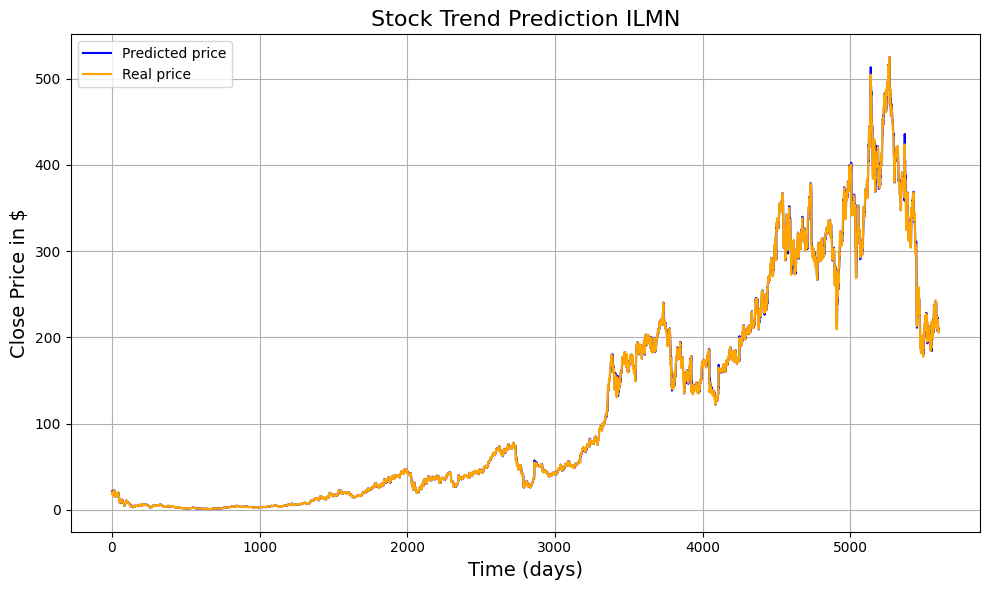

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.027019363
(10748, 1) (10748, 1)


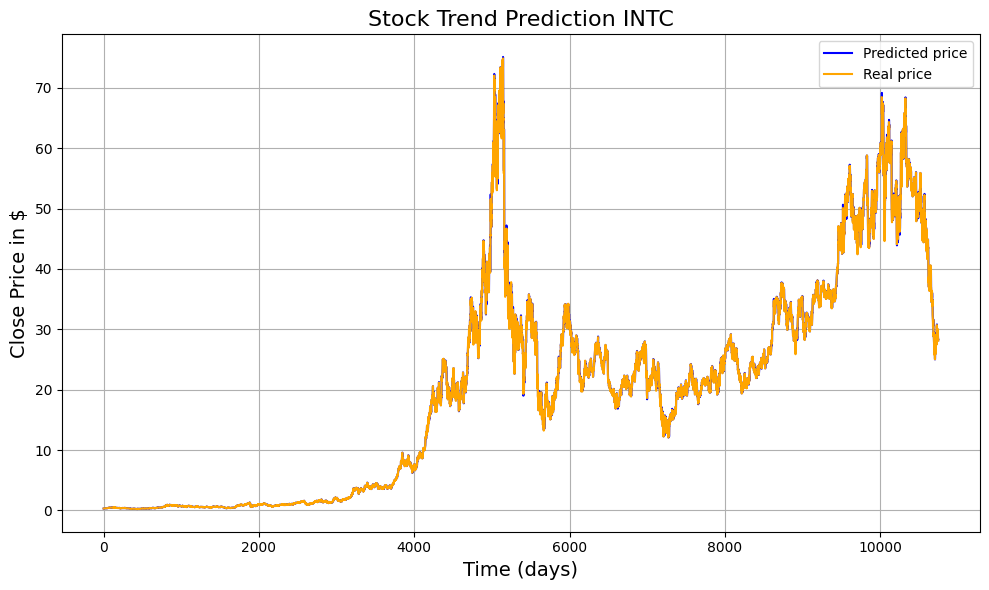

234/234 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033072
(7464, 1) (7464, 1)


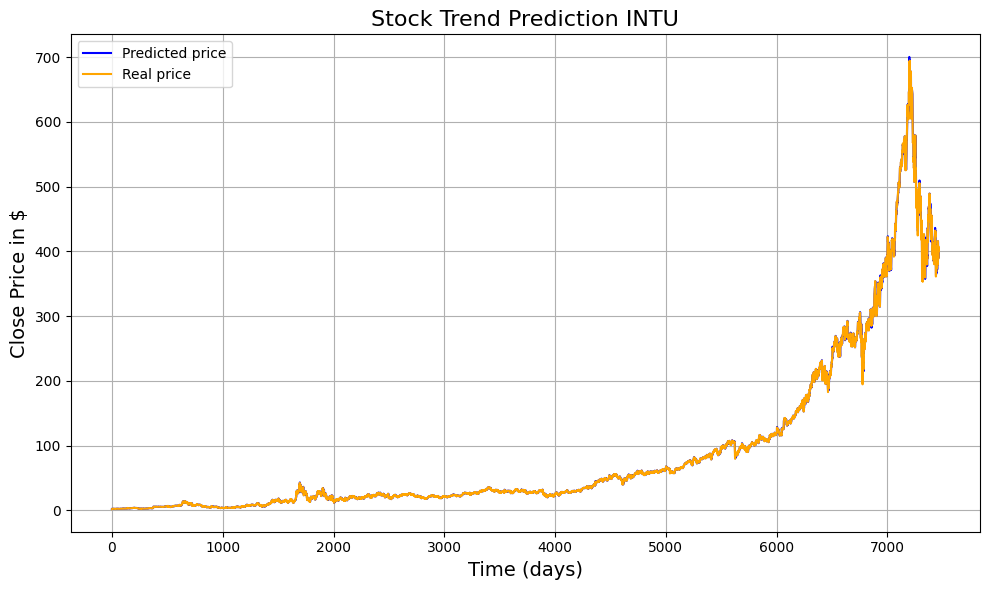

176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.037728157
(5629, 1) (5629, 1)


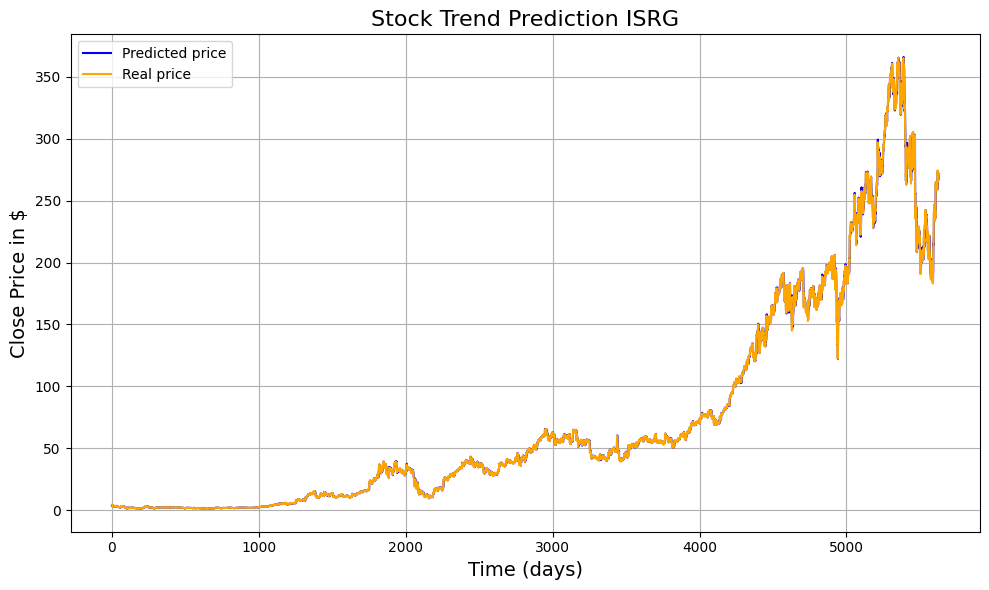

304/304 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03103298
(9703, 1) (9703, 1)


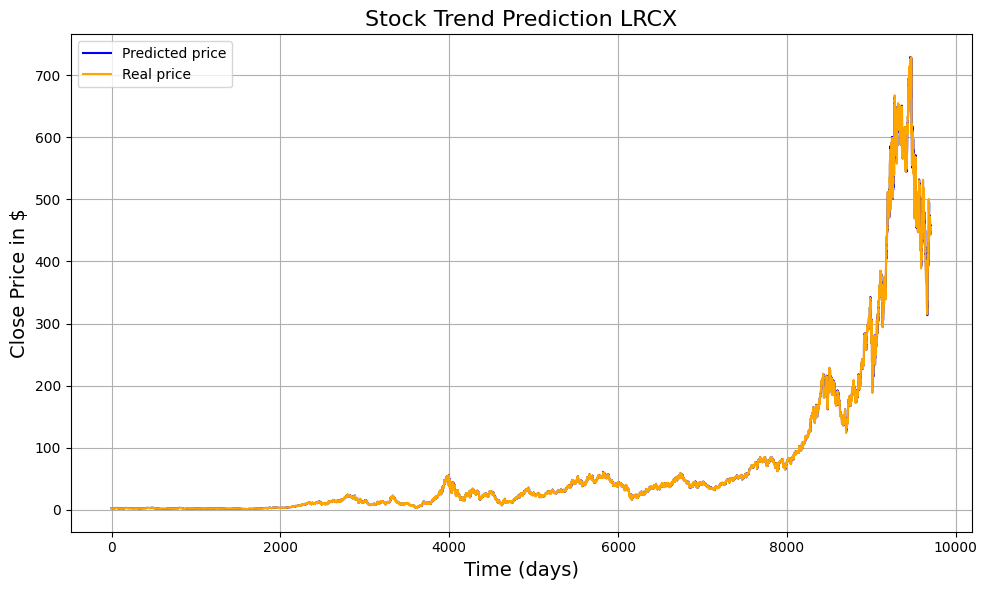

121/121 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.037110336
(3843, 1) (3843, 1)


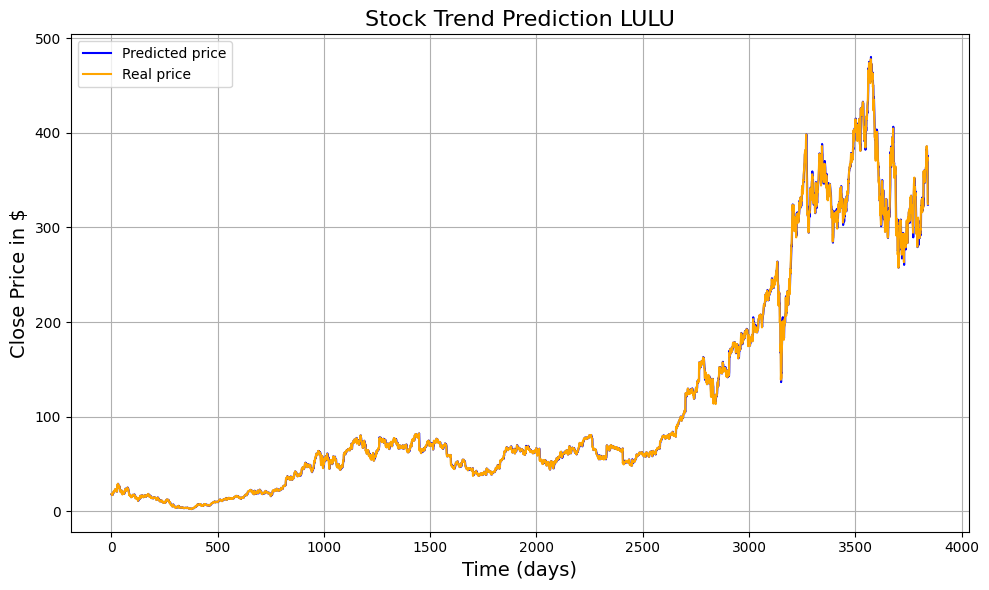

194/194 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.0290045
(6194, 1) (6194, 1)


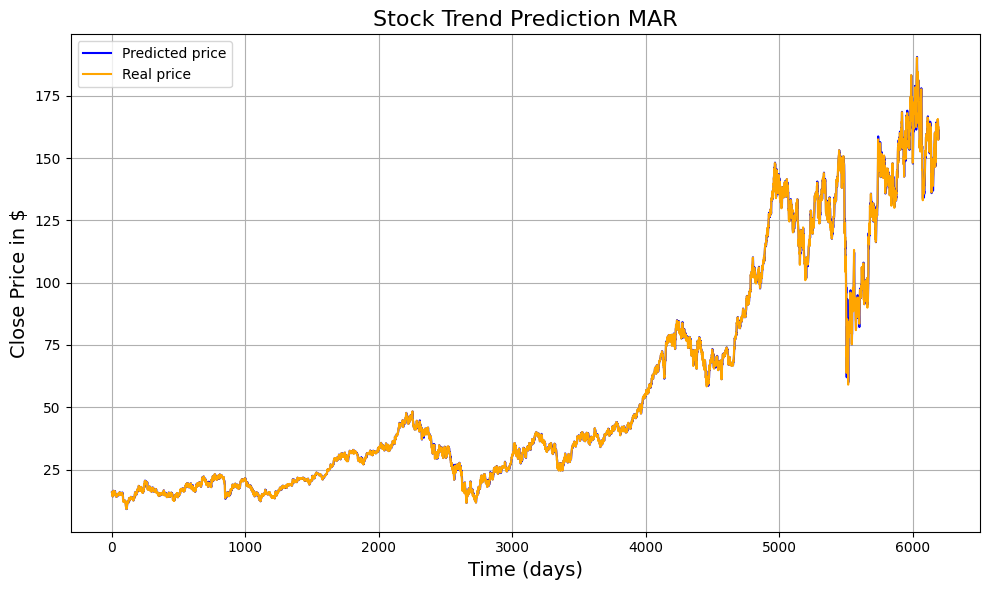

176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.028491829
(5619, 1) (5619, 1)


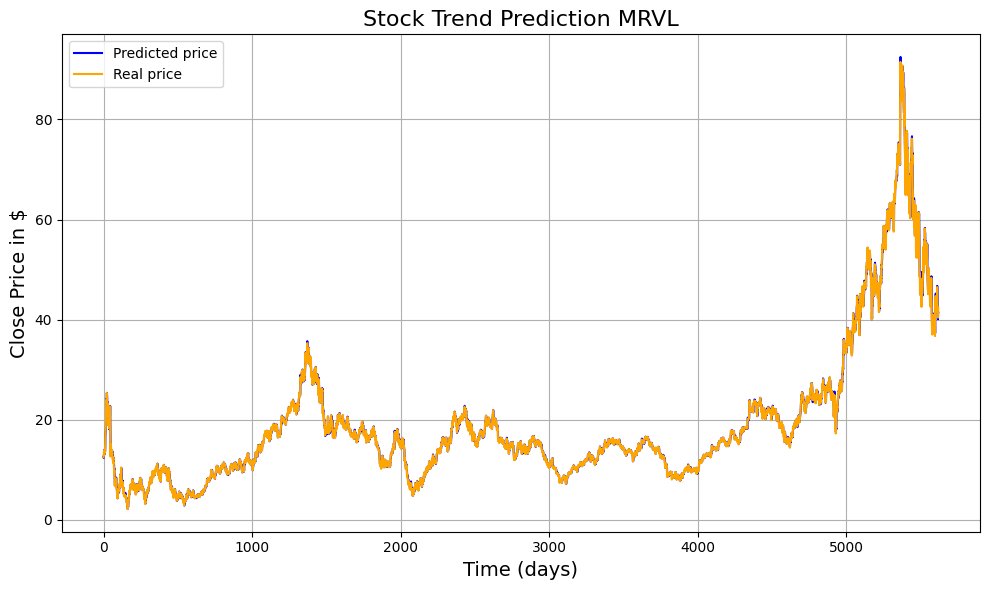

120/120 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031014912
(3833, 1) (3833, 1)


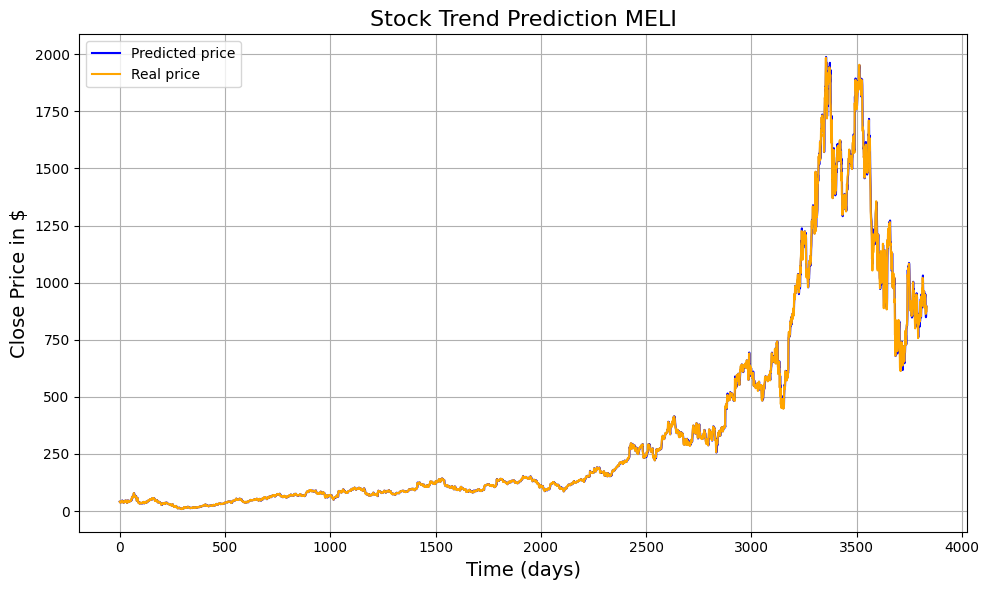

234/234 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031163322
(7459, 1) (7459, 1)


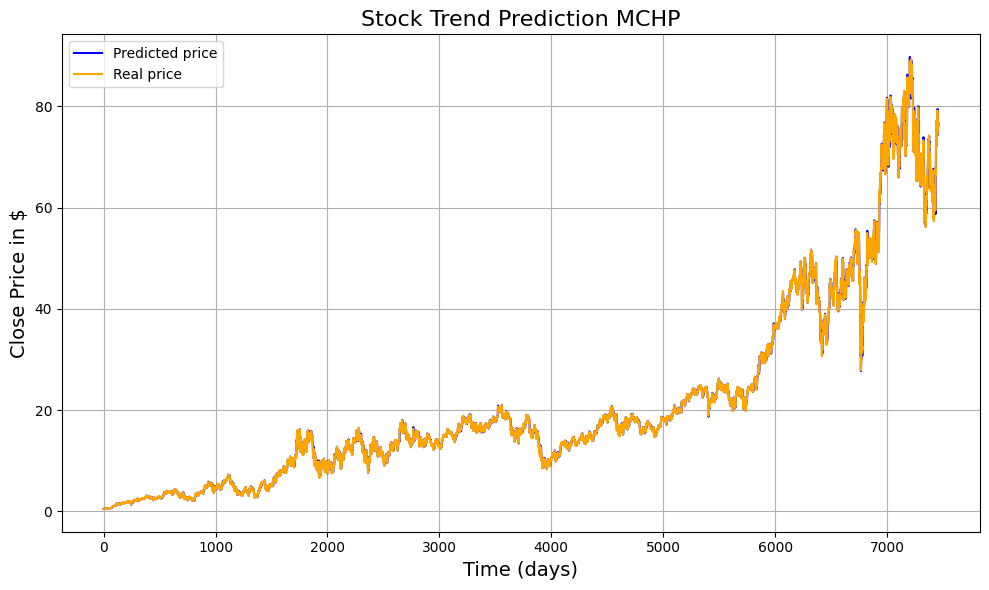

303/303 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.025054766
(9683, 1) (9683, 1)


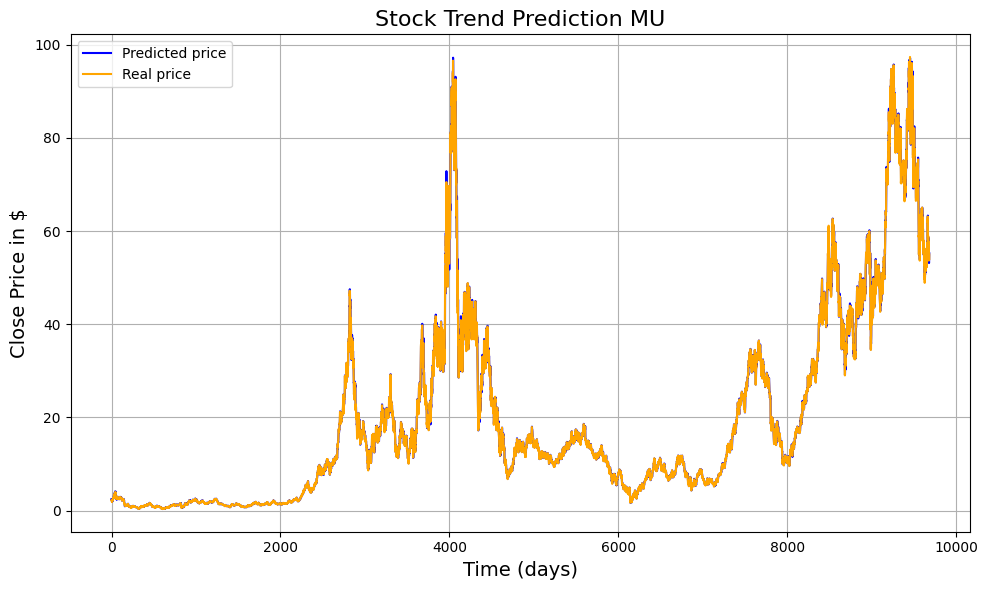

289/289 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.028853733
(9234, 1) (9234, 1)


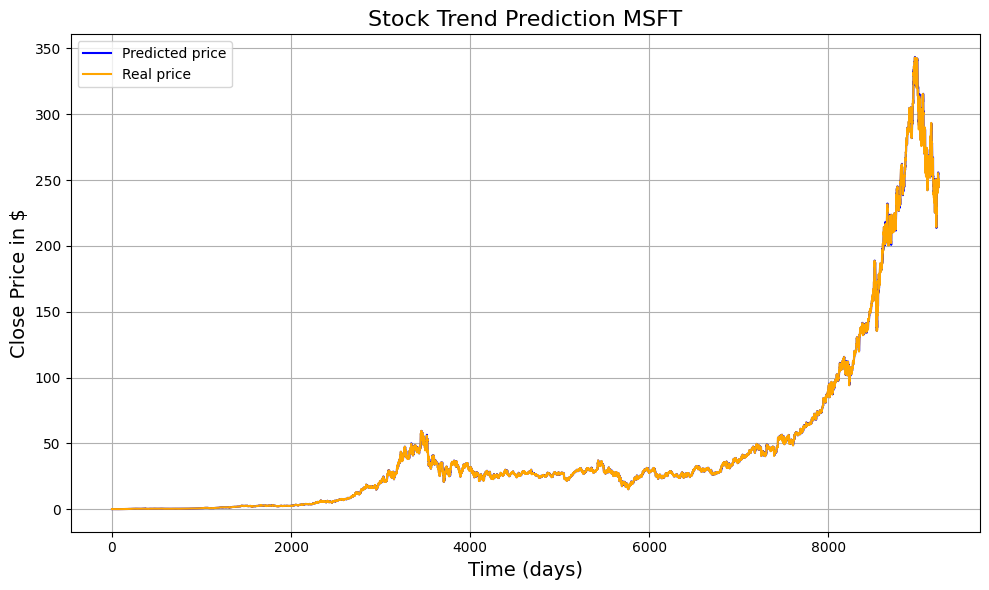

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.038467128
(5380, 1) (5380, 1)


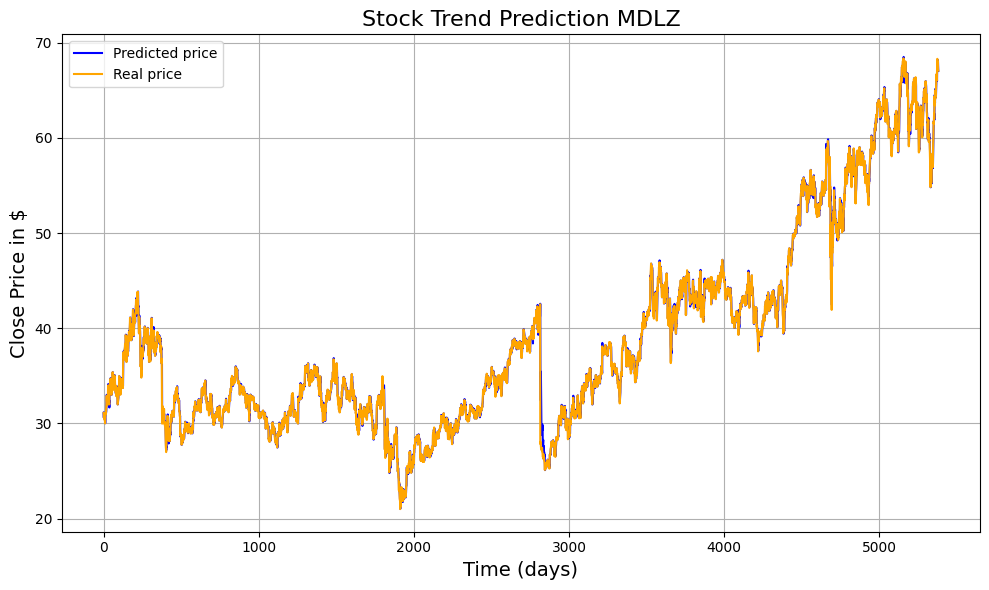

291/291 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.05510932
(9299, 1) (9299, 1)


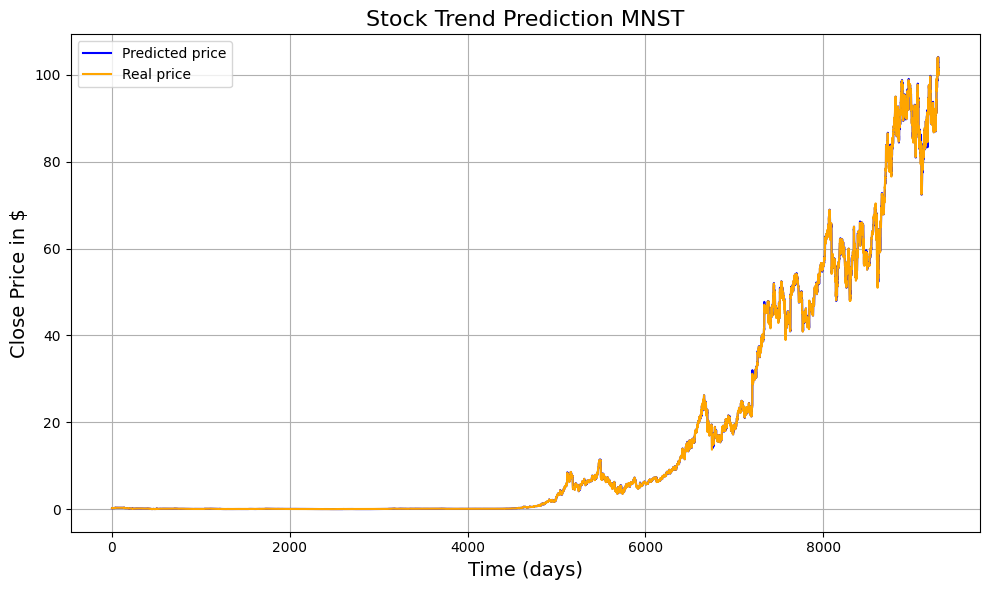

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03469957
(5146, 1) (5146, 1)


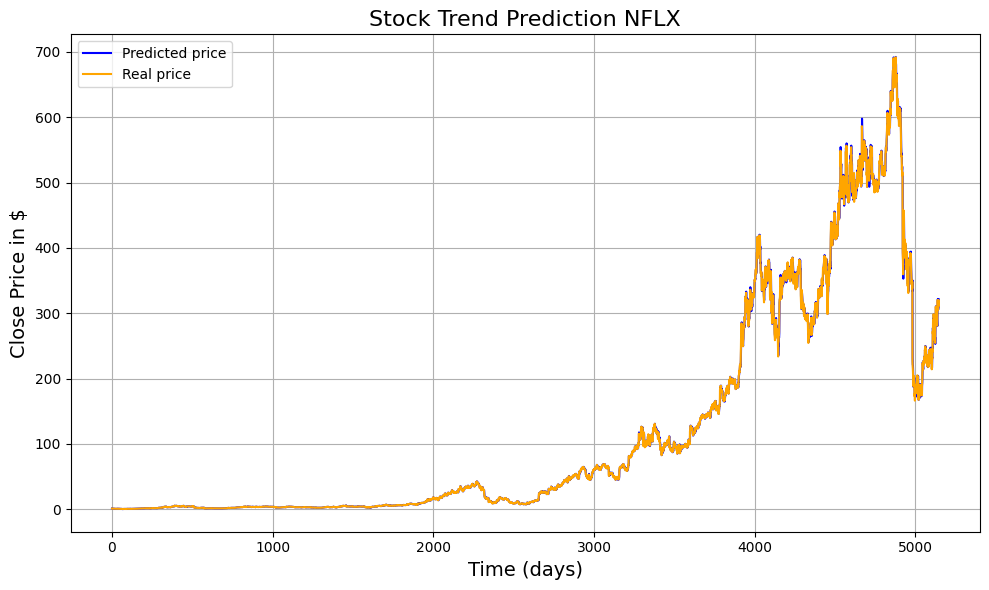

187/187 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.028954932
(5983, 1) (5983, 1)


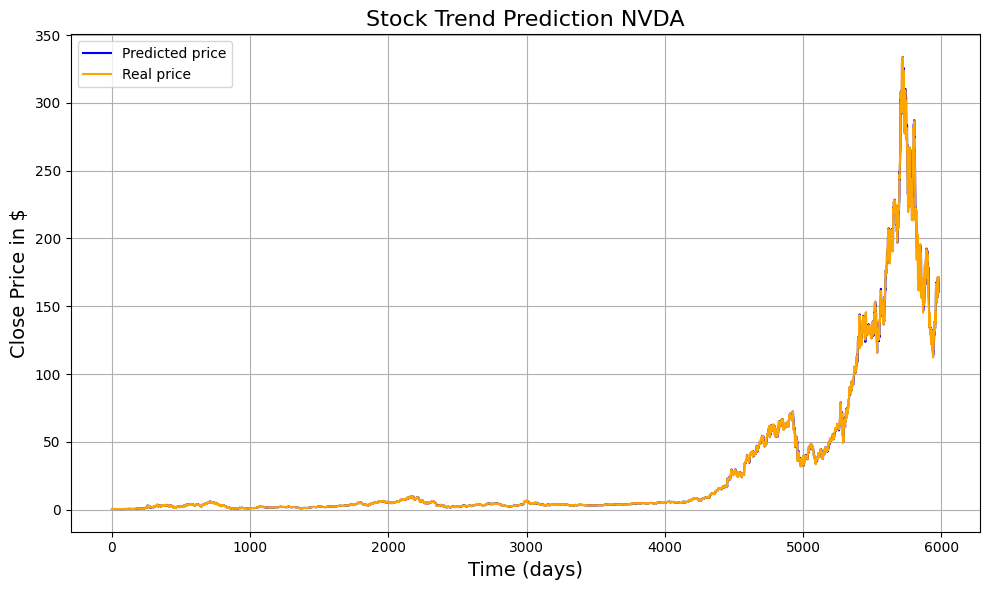

97/97 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.030848173
(3080, 1) (3080, 1)


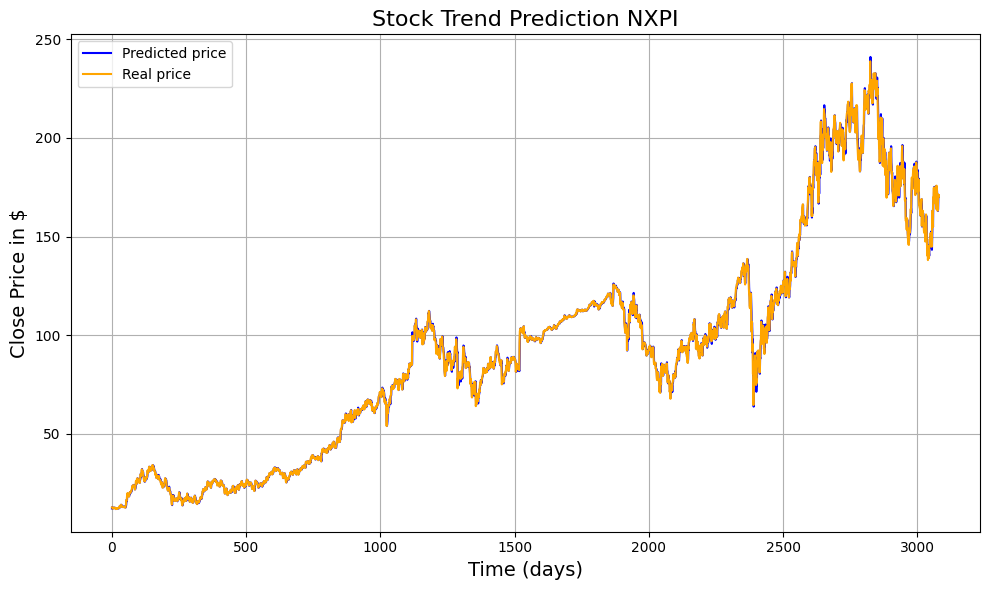

233/233 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033916846
(7435, 1) (7435, 1)


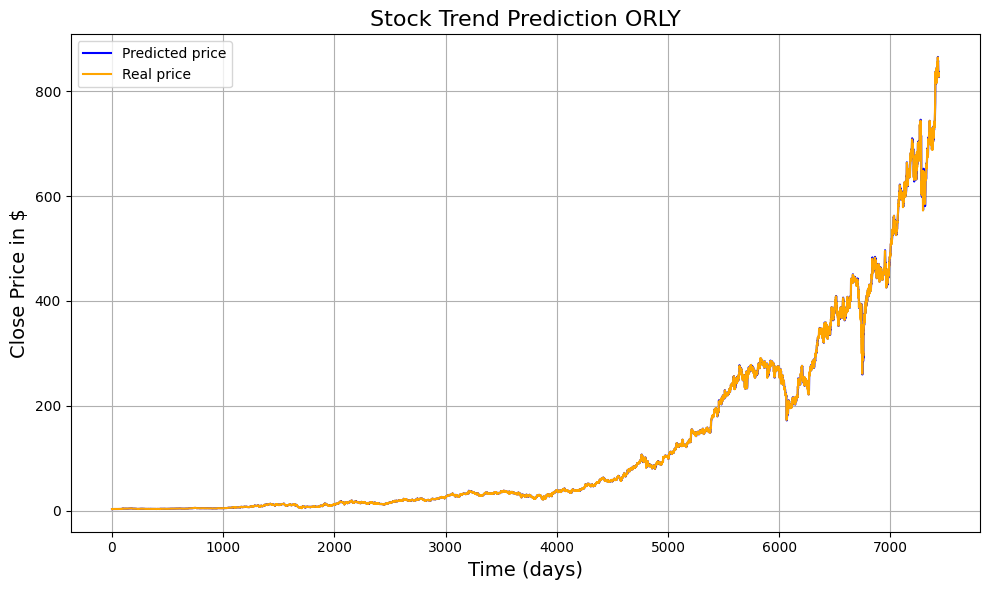

245/245 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.043519497
(7813, 1) (7813, 1)


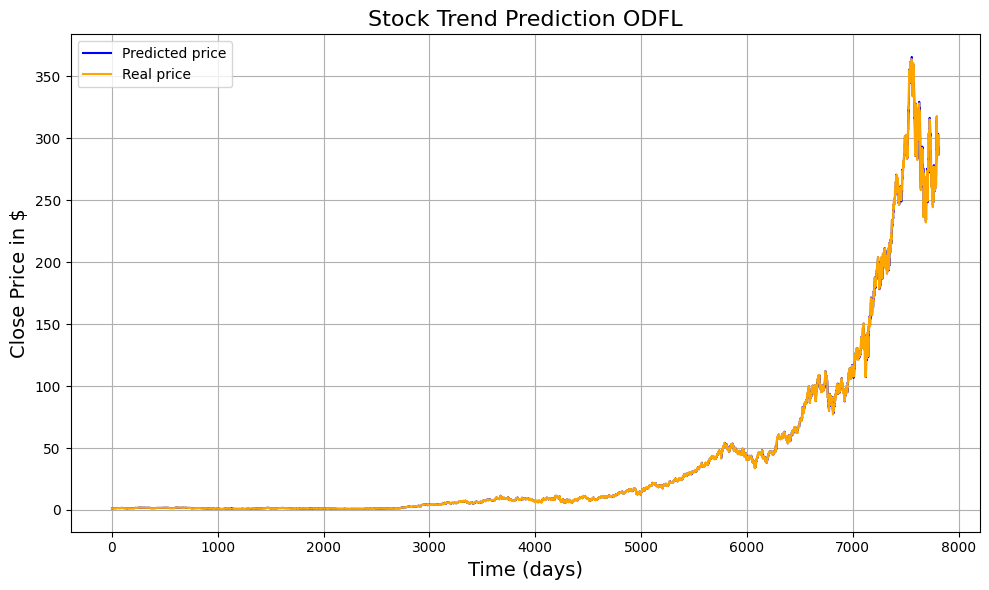

177/177 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.02826494
(5661, 1) (5661, 1)


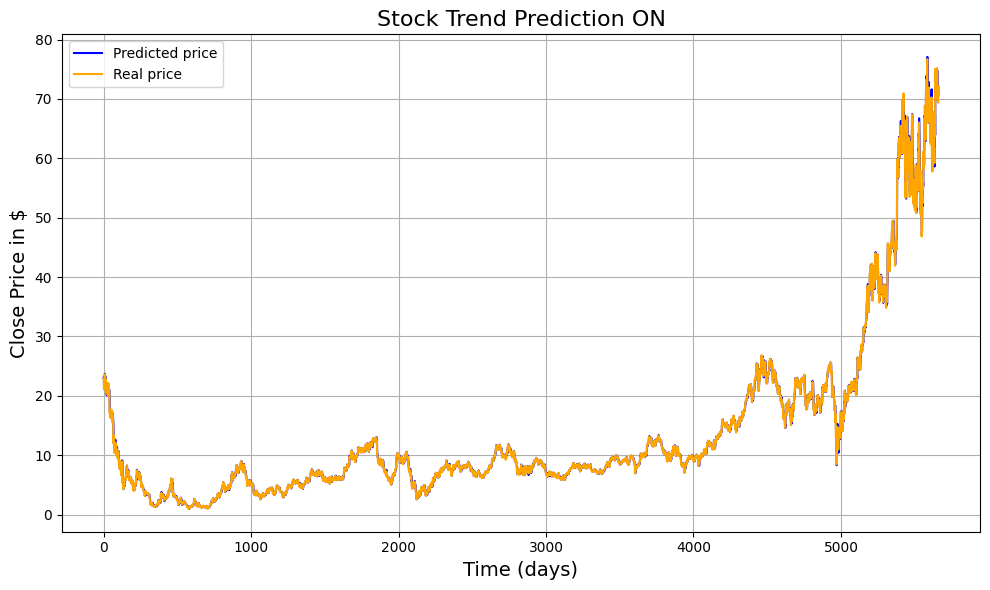

336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.030254556
(10748, 1) (10748, 1)


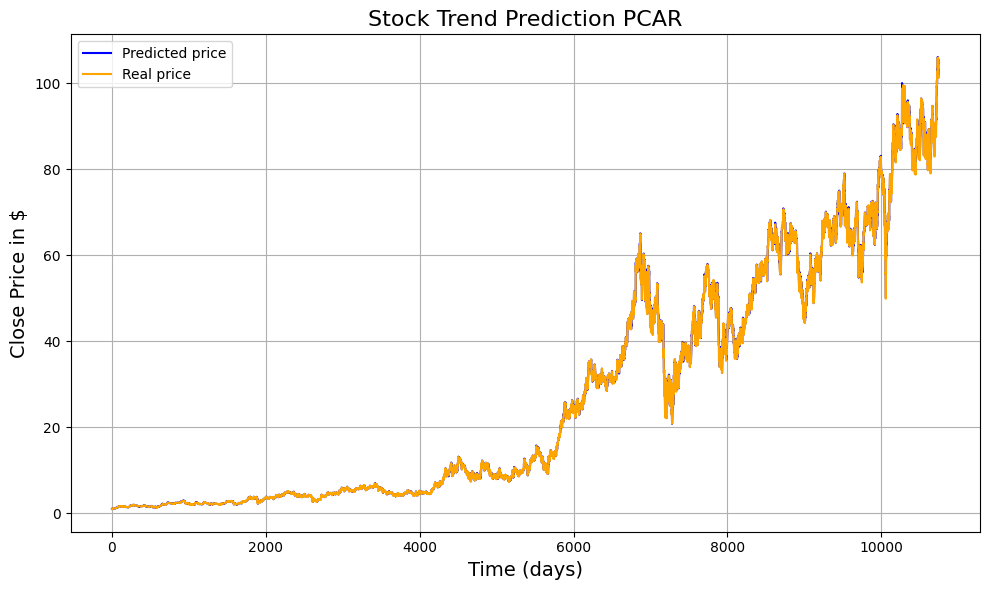

309/309 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033281203
(9876, 1) (9876, 1)


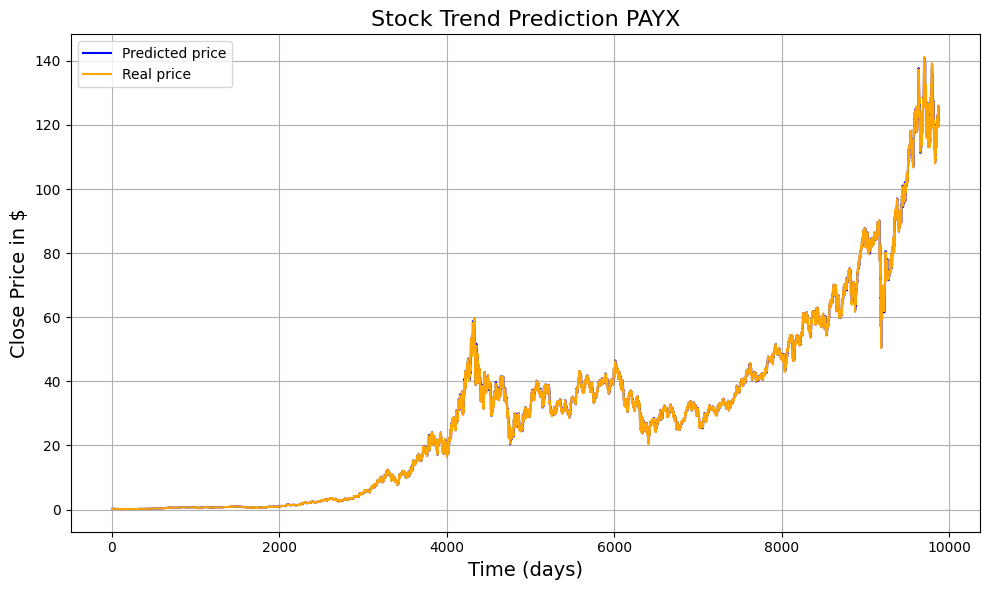

244/244 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.032644097
(7778, 1) (7778, 1)


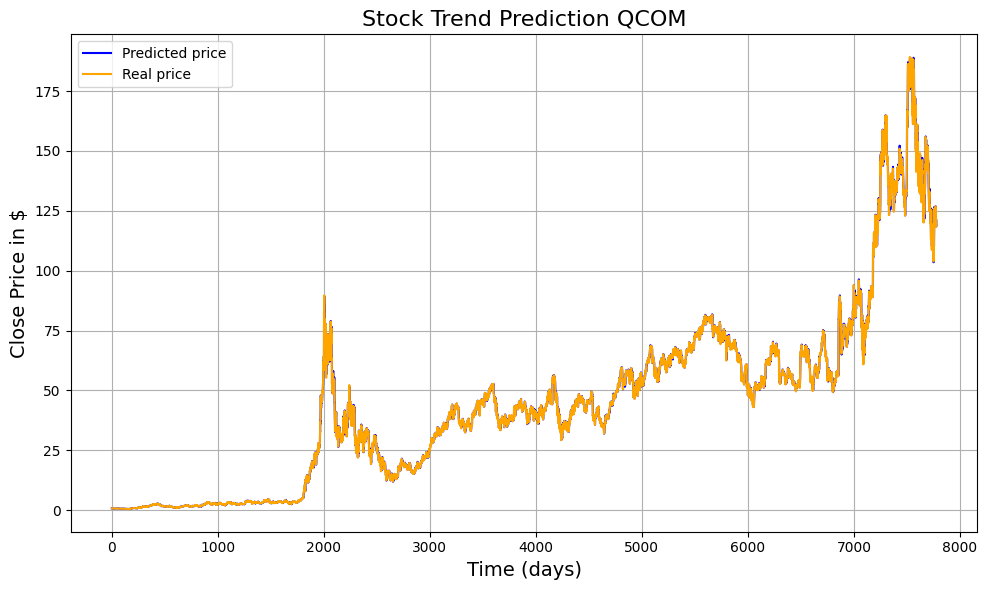

249/249 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03286583
(7957, 1) (7957, 1)


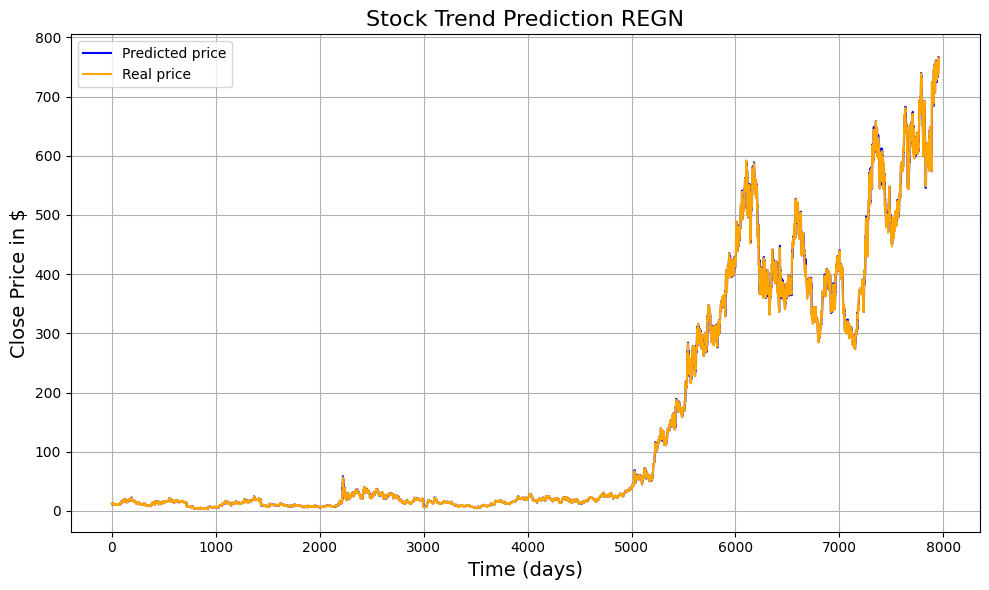

294/294 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.031833056
(9383, 1) (9383, 1)


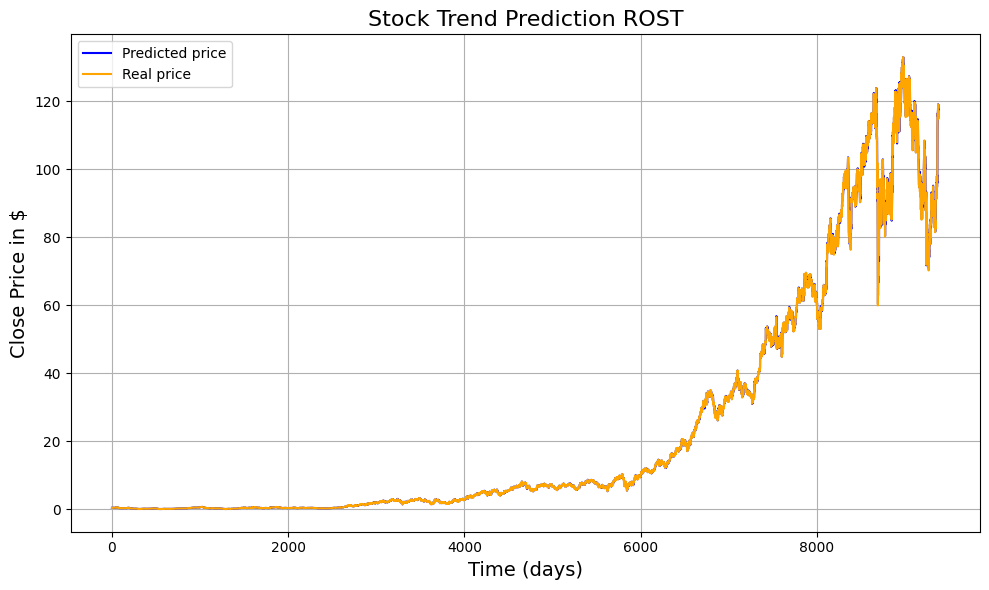

239/239 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.0324667
(7643, 1) (7643, 1)


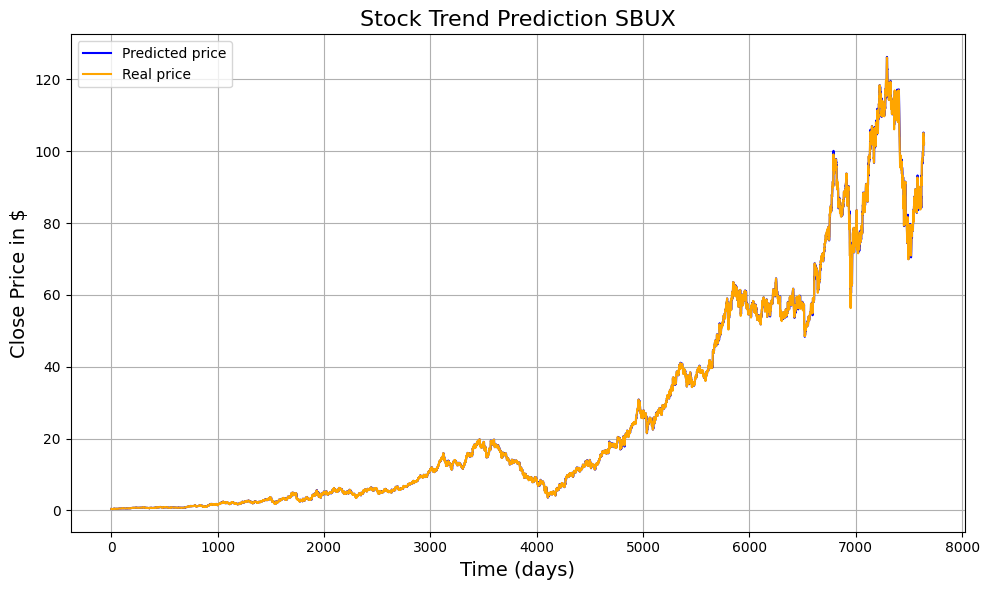

123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.03921858
(3926, 1) (3926, 1)


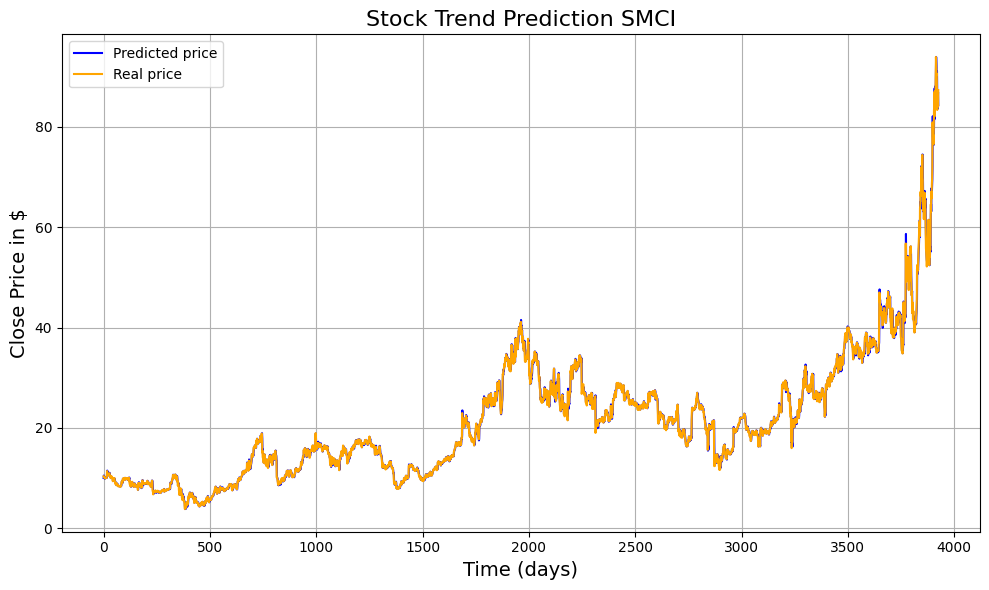

242/242 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.033004694
(7728, 1) (7728, 1)


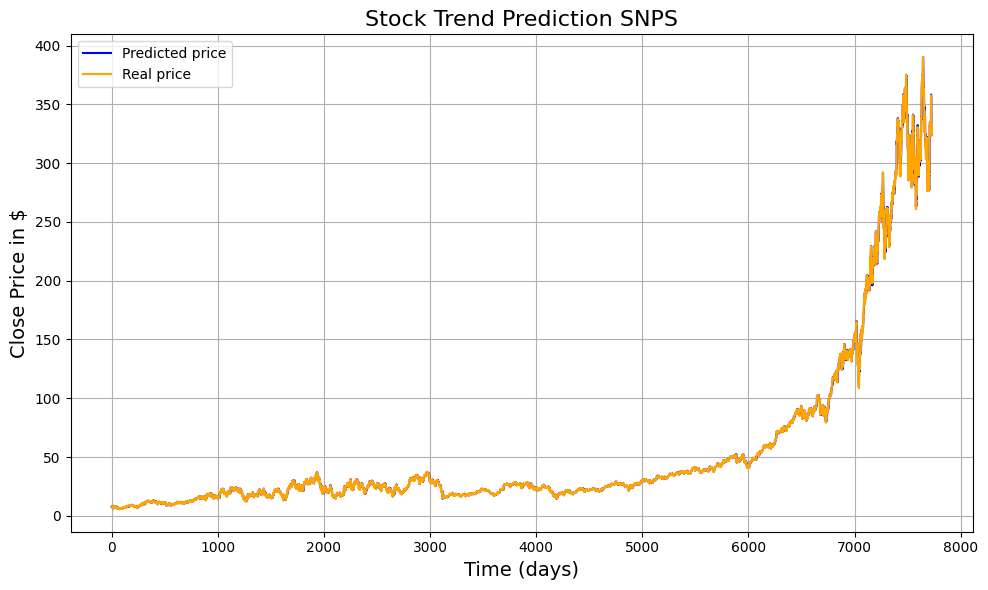

398/398 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
MSE on the test set:  0.027894793
(12714, 1) (12714, 1)


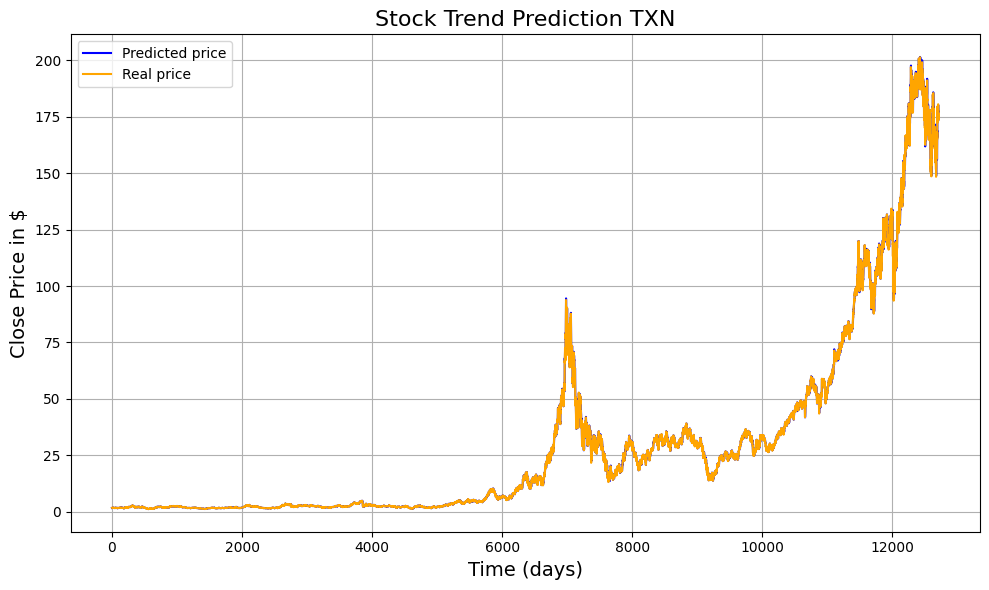

103/103 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.03424954
(3289, 1) (3289, 1)


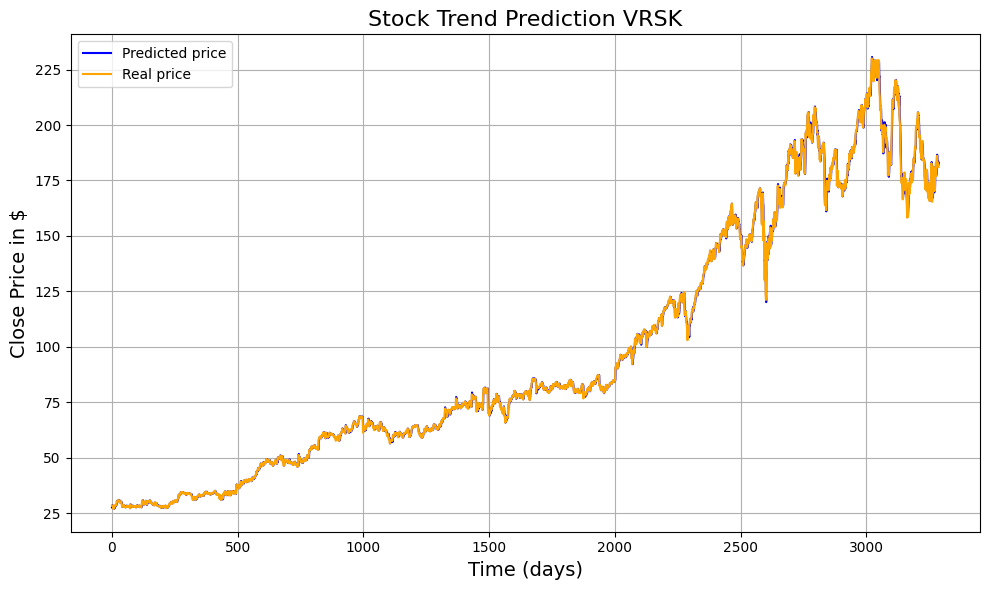

247/247 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.041245673
(7878, 1) (7878, 1)


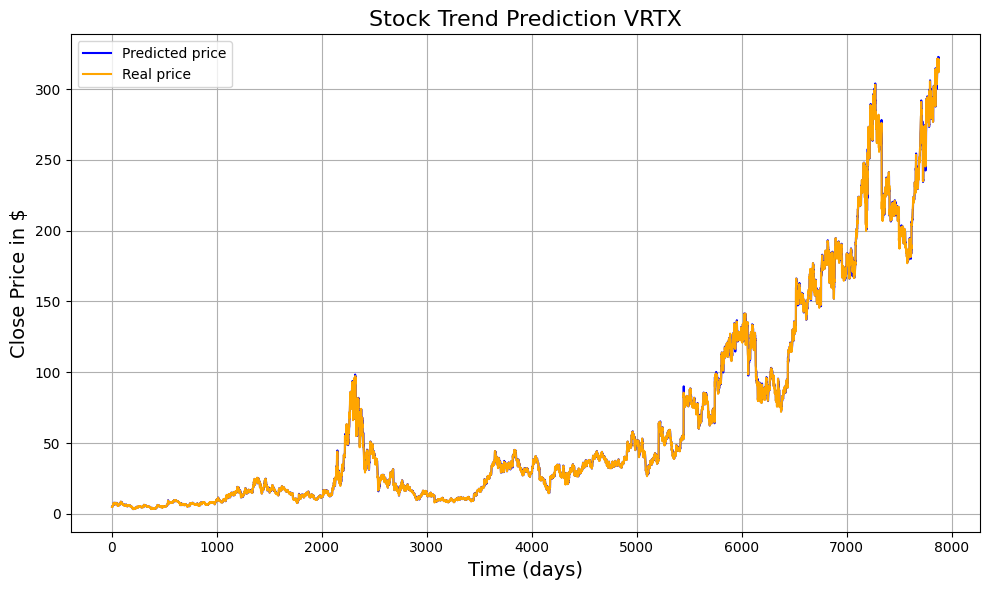

In [27]:
# Load model
conv1d_test_1 = tf.keras.models.load_model('1dcnn_norm.keras')

# Load all data first
(all_X_data, all_y_data, 
all_X_data_norm, all_y_data_norm, 
all_X_data_norm_t, all_y_data_norm_t, 
all_feature_choice_indices) = load_all_data(
    nasqad100, 
    features, 
    window_size=window_size, 
    k_days=1, 
    feature_choice='Close', 
    type=0
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        conv1d_test_1, 
        all_X_data_norm_t[stock], 
        all_y_data_norm_t[stock], 
        all_X_data[stock], 
        all_y_data[stock], 
        all_feature_choice_indices[stock], 
        stock
    ) 

#### LSTM

286/286 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
MSE on the test set:  0.028918542
(9128, 1) (9128, 1)


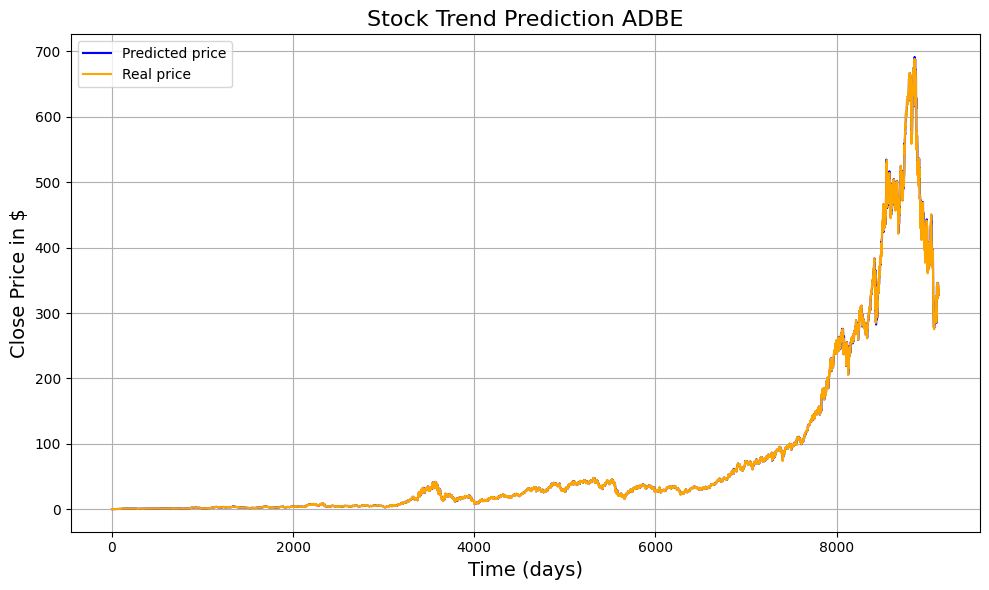

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.028040336
(10748, 1) (10748, 1)


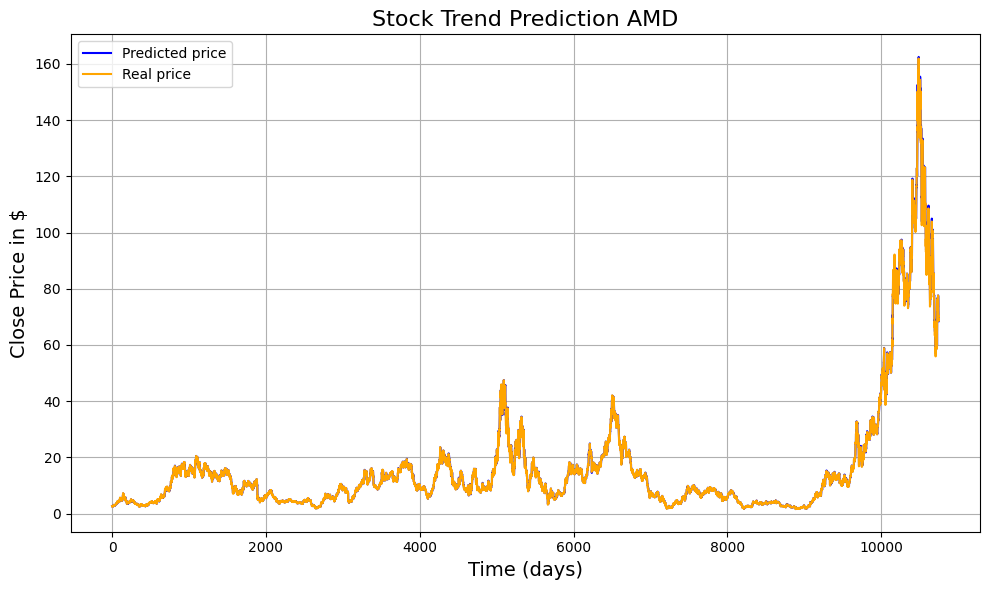

201/201 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.031004142
(6408, 1) (6408, 1)


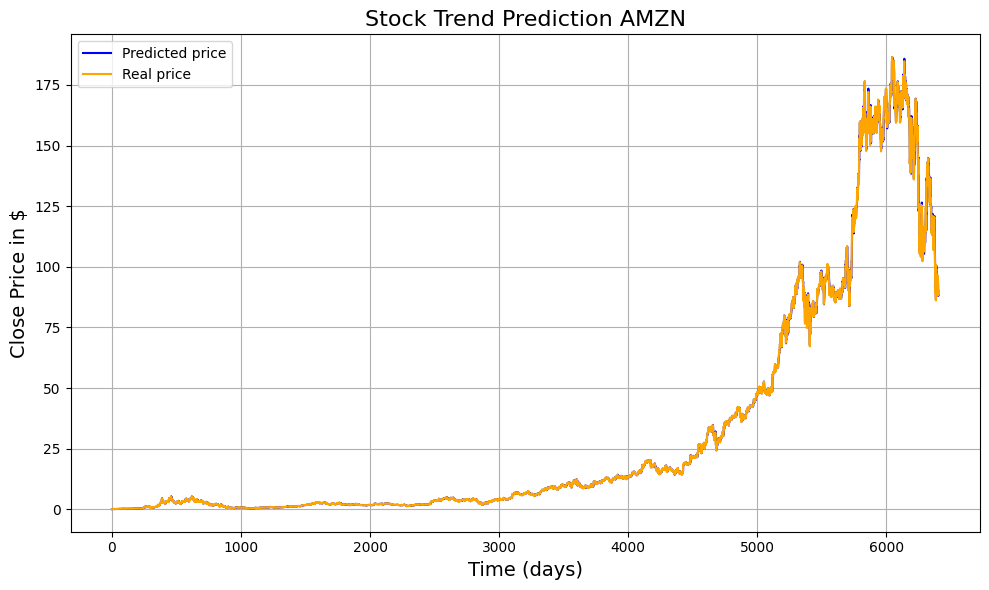

311/311 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.028687535
(9925, 1) (9925, 1)


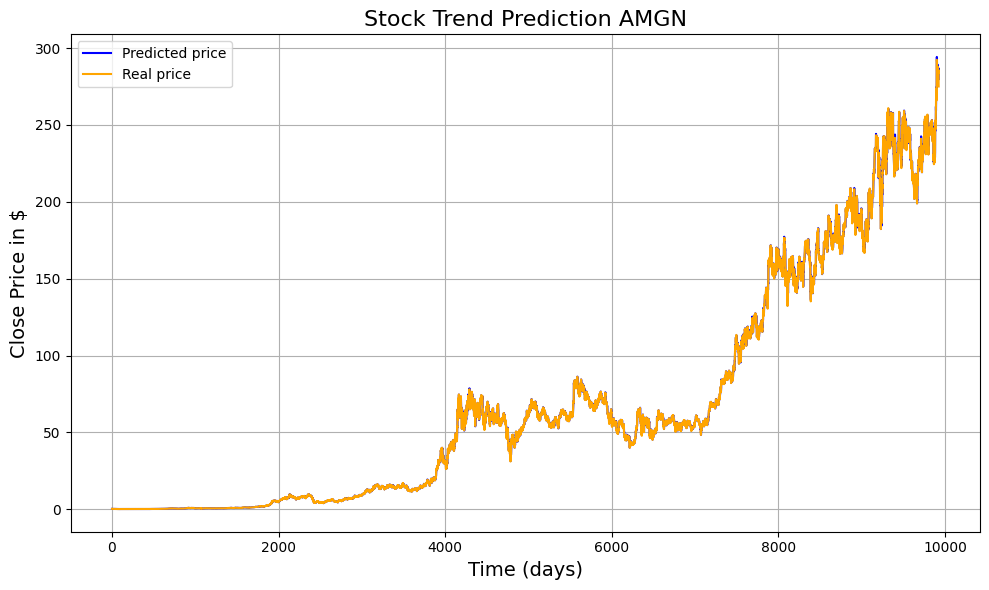

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.02984618
(10748, 1) (10748, 1)


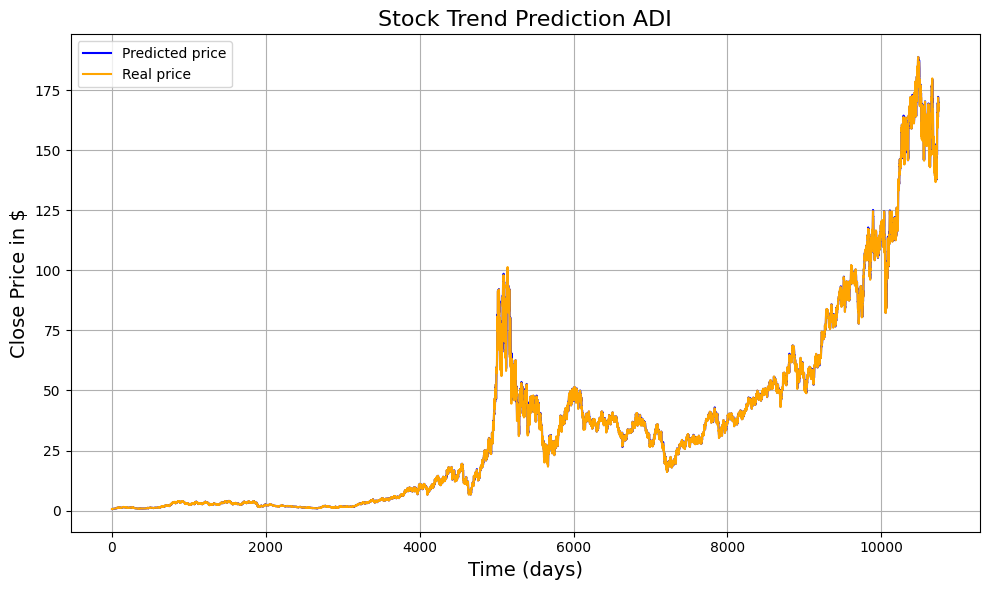

330/330 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.025614493
(10560, 1) (10560, 1)


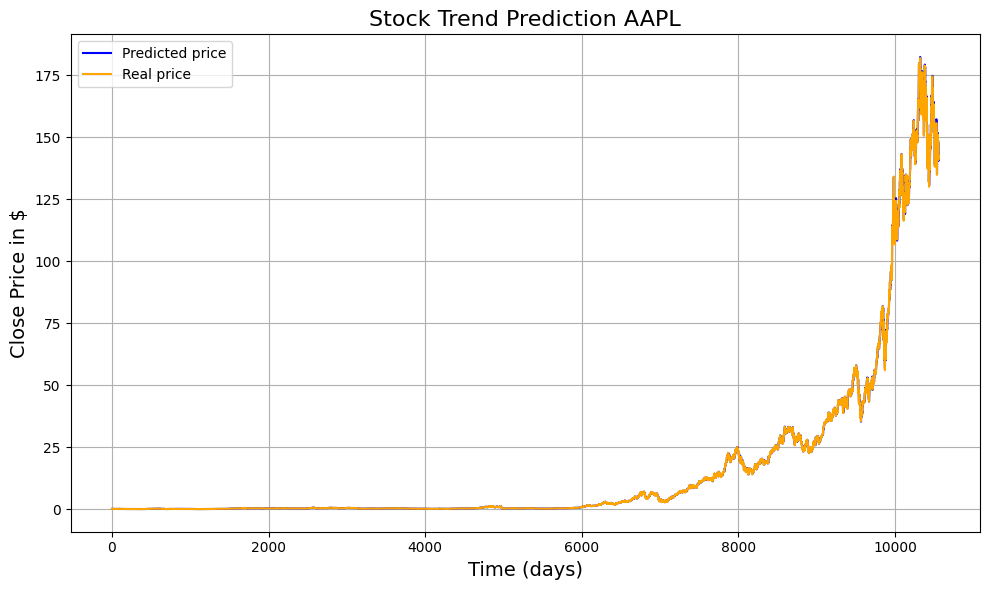

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.02597879
(10748, 1) (10748, 1)


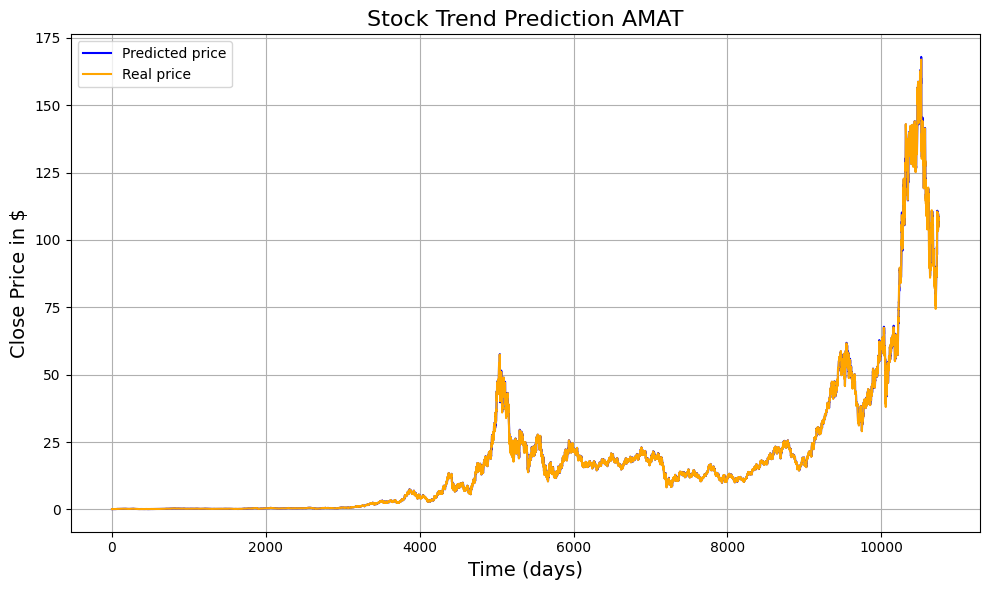

218/218 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.026601138
(6957, 1) (6957, 1)


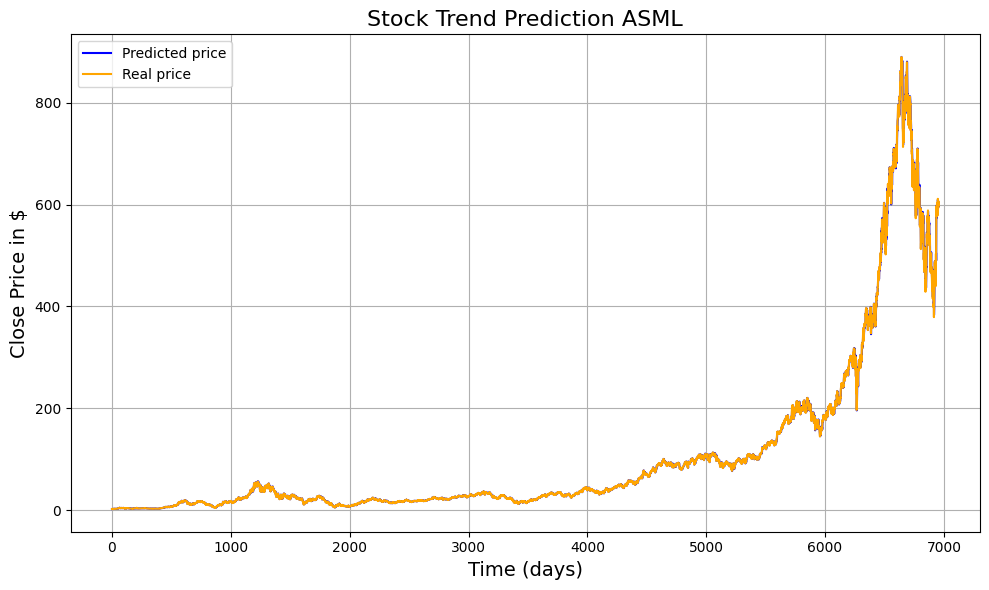

295/295 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.028705876
(9411, 1) (9411, 1)


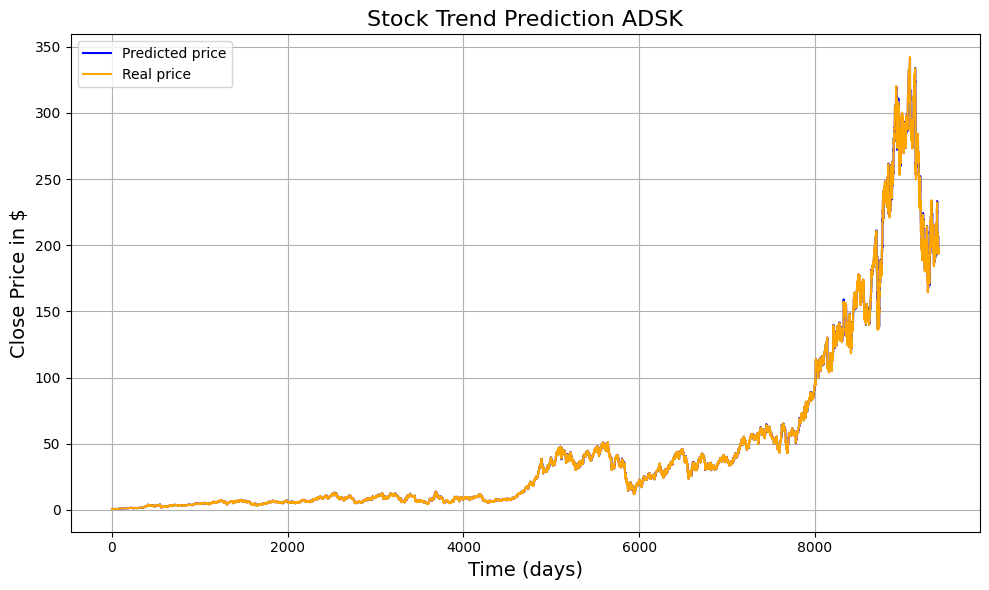

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.029887408
(10748, 1) (10748, 1)


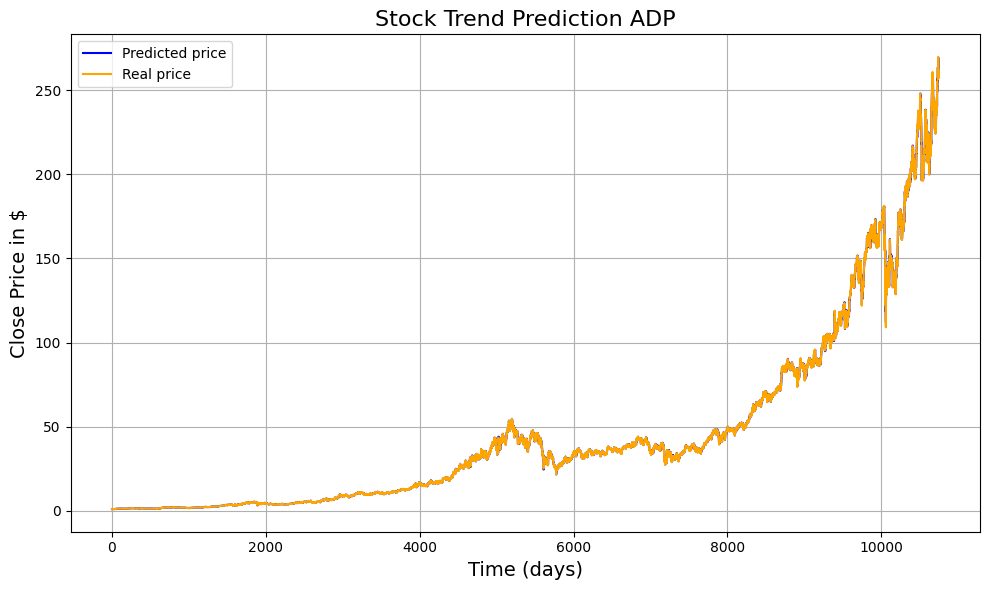

245/245 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.04232219
(7840, 1) (7840, 1)


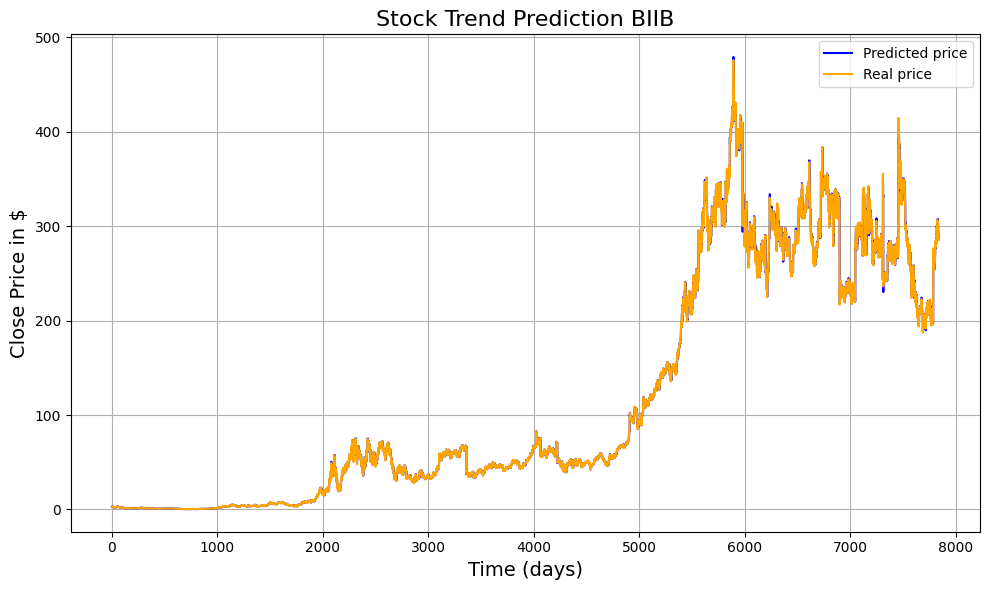

279/279 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.029549312
(8920, 1) (8920, 1)


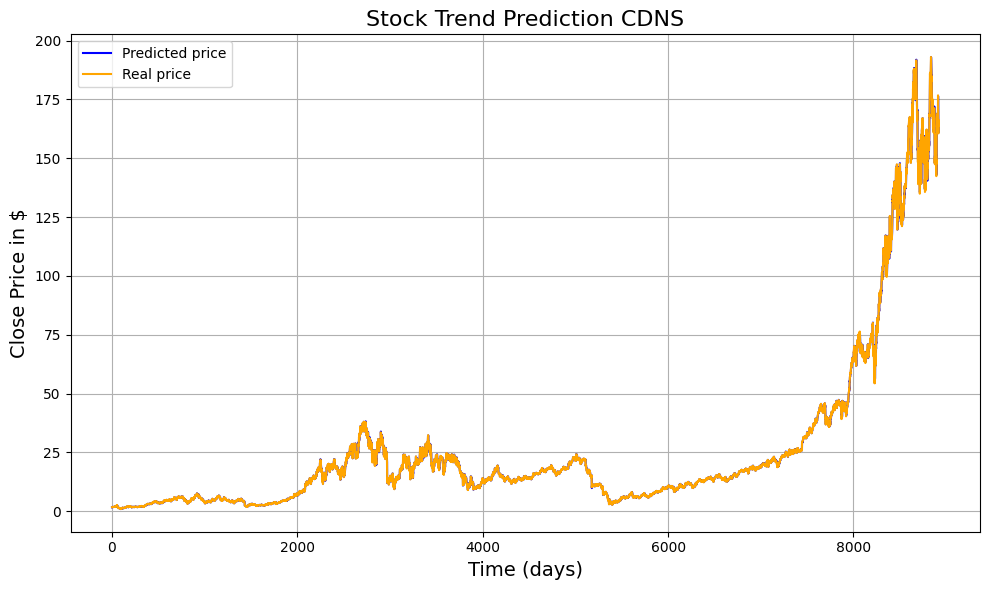

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.028399907
(2353, 1) (2353, 1)


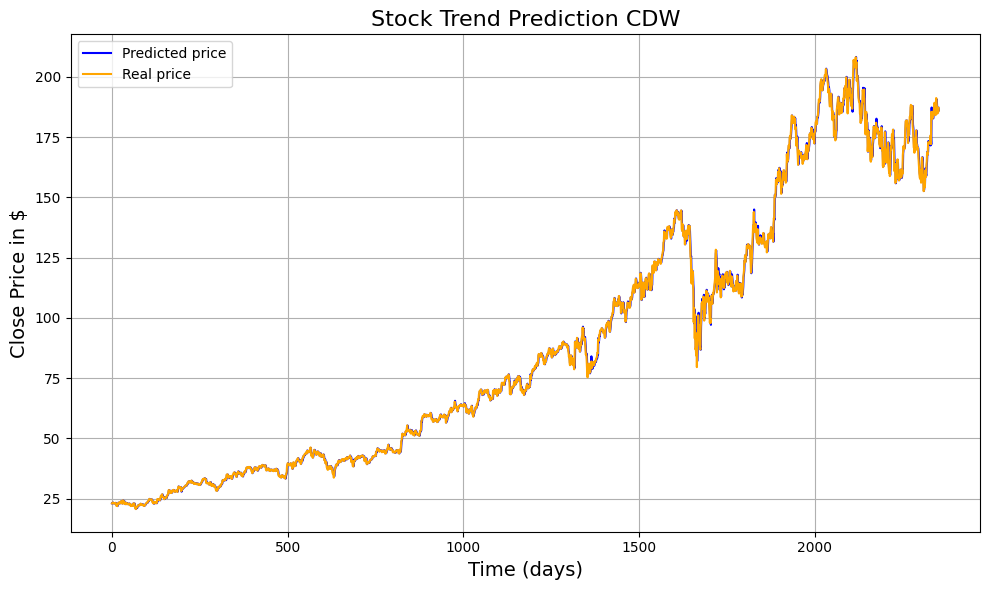

101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.029077996
(3228, 1) (3228, 1)


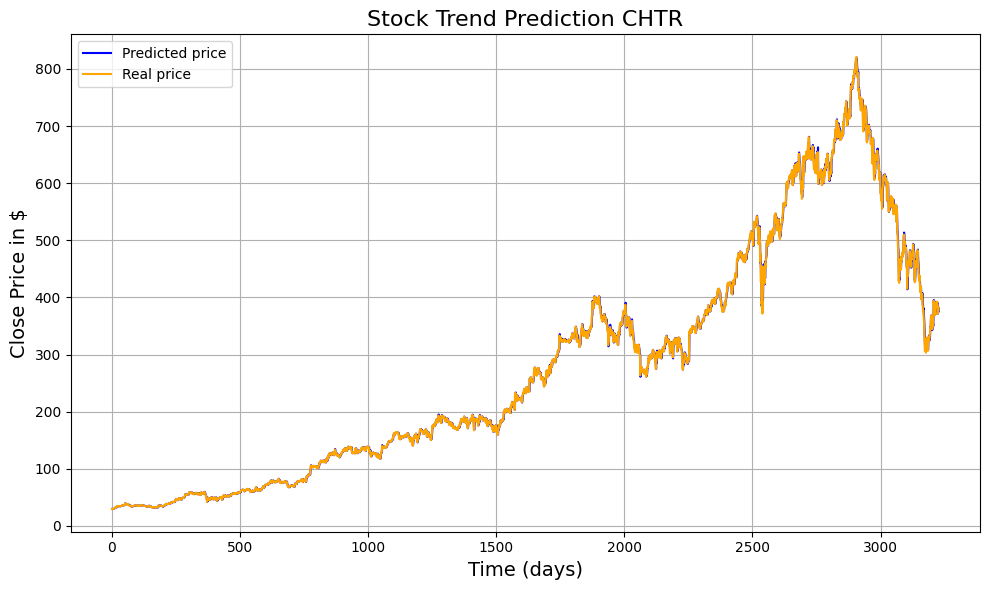

309/309 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03325734
(9881, 1) (9881, 1)


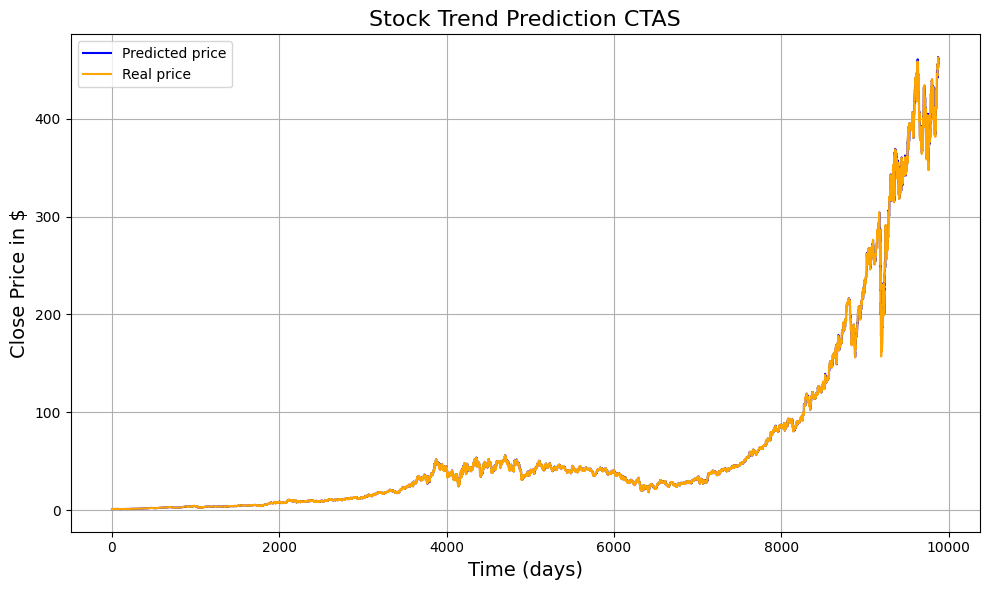

258/258 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.029589863
(8239, 1) (8239, 1)


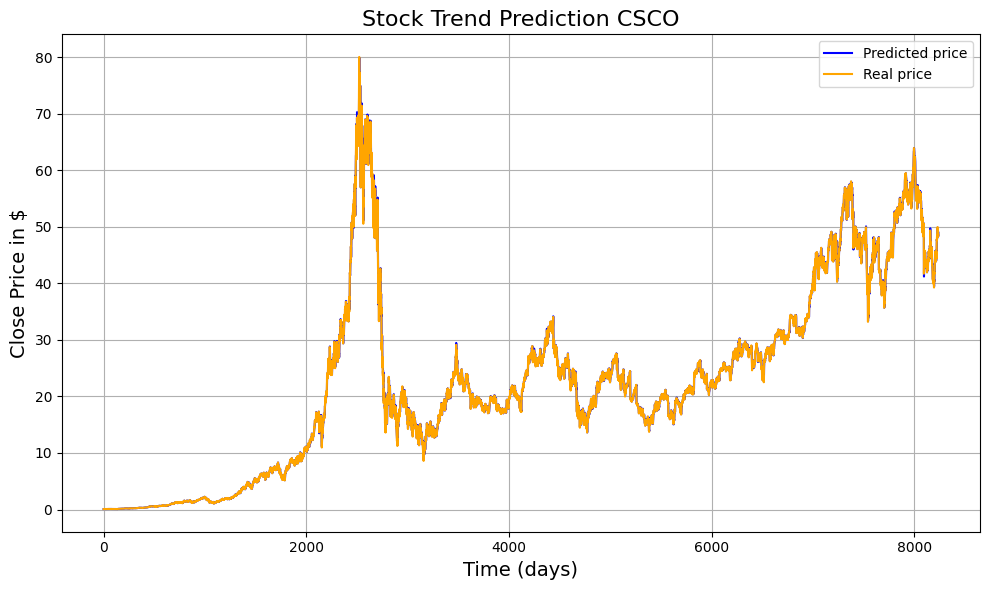

192/192 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.03337207
(6132, 1) (6132, 1)


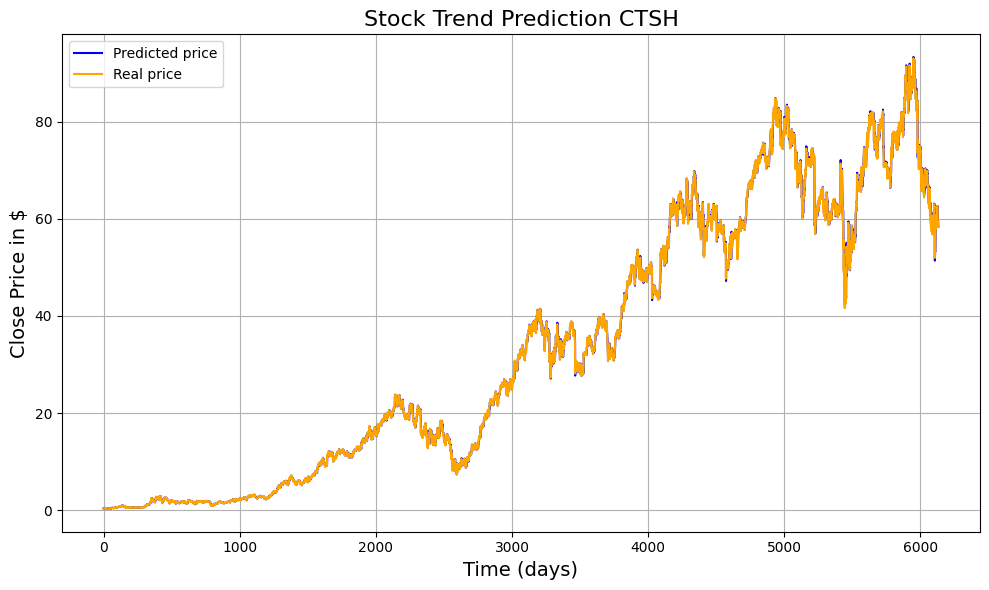

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.028093532
(10748, 1) (10748, 1)


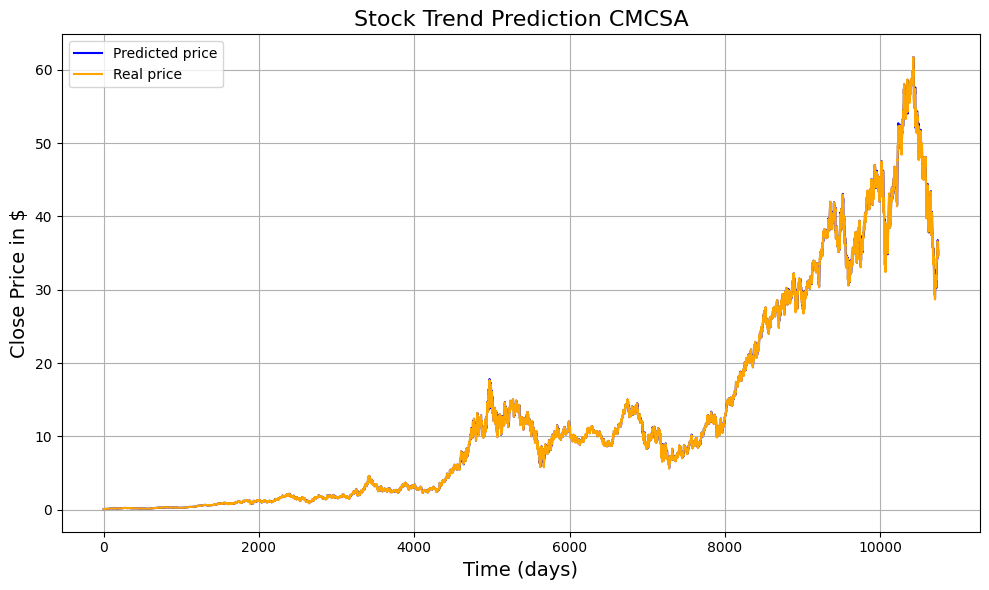

226/226 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.034688905
(7207, 1) (7207, 1)


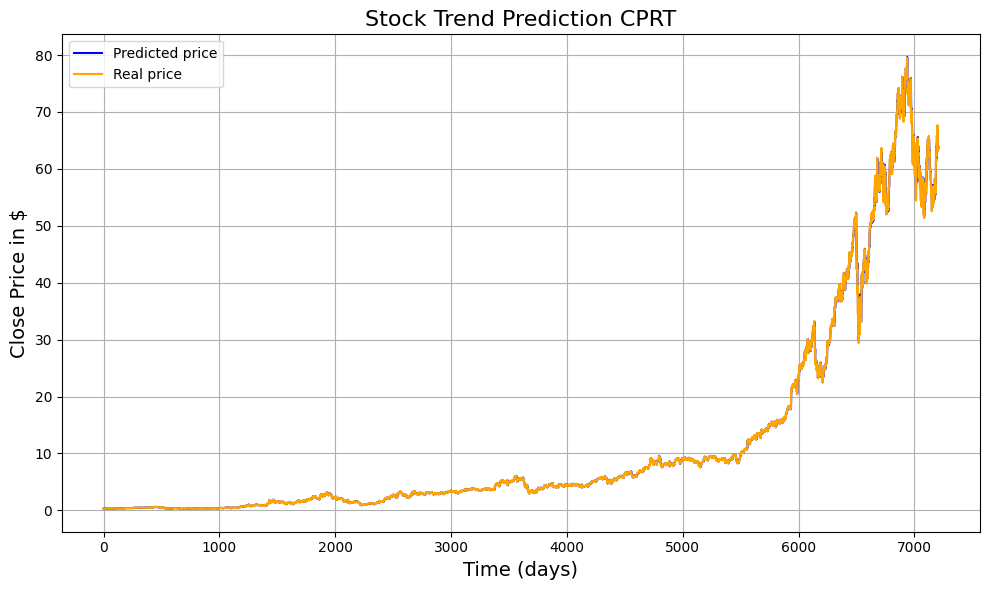

192/192 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.030179745
(6124, 1) (6124, 1)


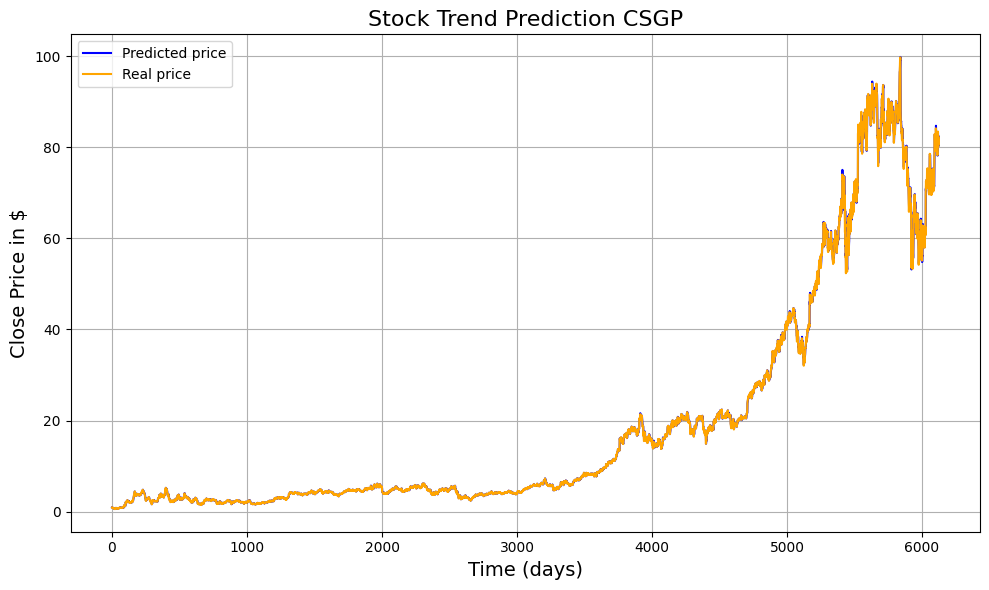

287/287 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03255087
(9153, 1) (9153, 1)


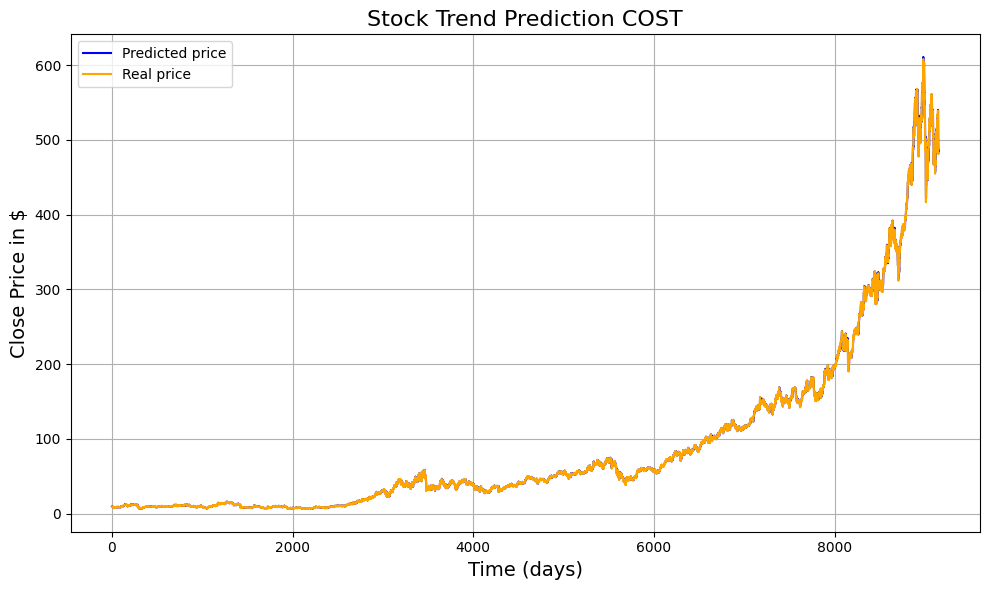

139/139 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.035500992
(4418, 1) (4418, 1)


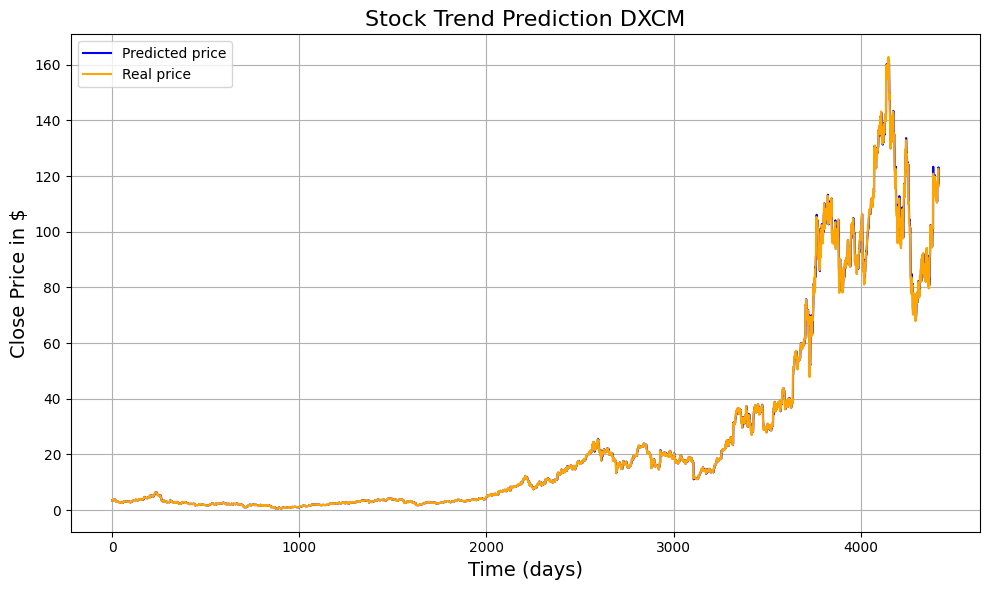

79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.03190848
(2528, 1) (2528, 1)


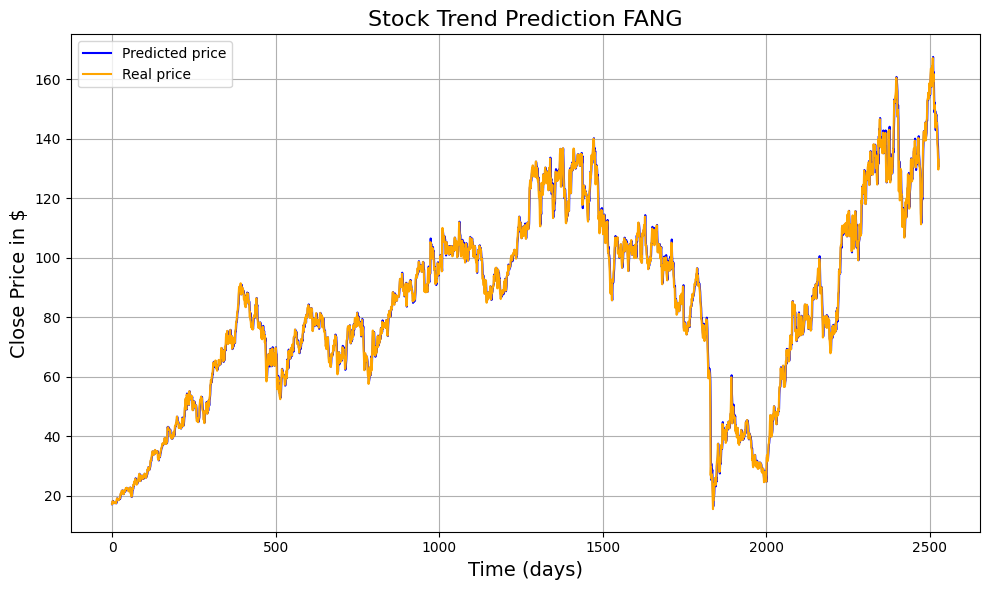

261/261 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.032552473
(8343, 1) (8343, 1)


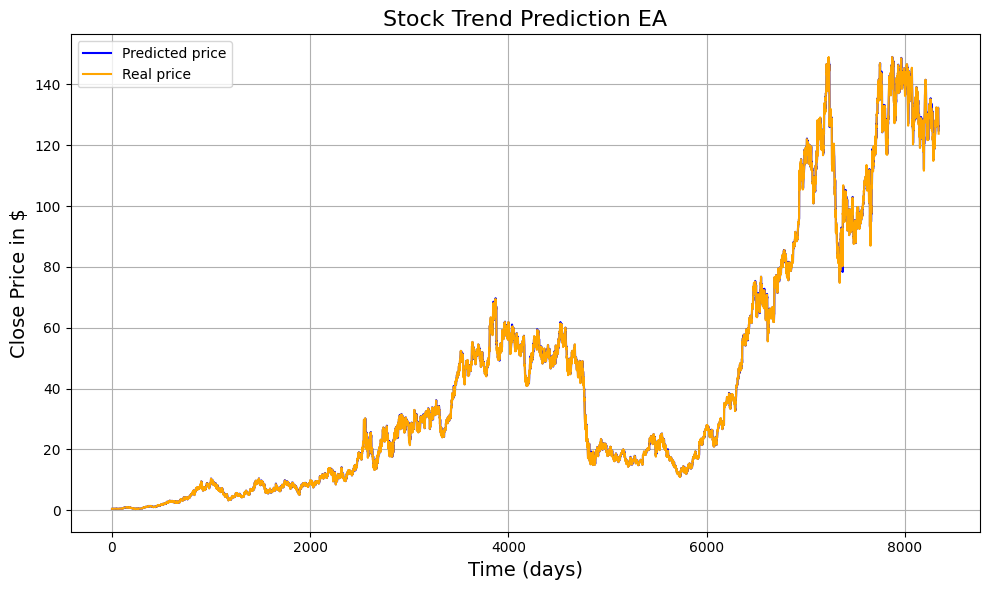

278/278 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.029955944
(8870, 1) (8870, 1)


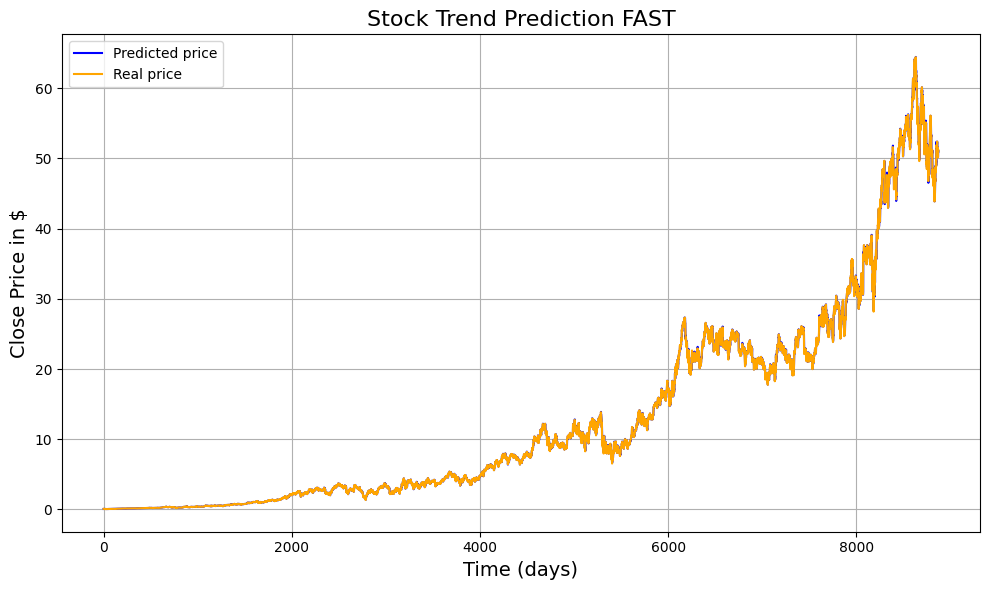

102/102 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.035728678
(3259, 1) (3259, 1)


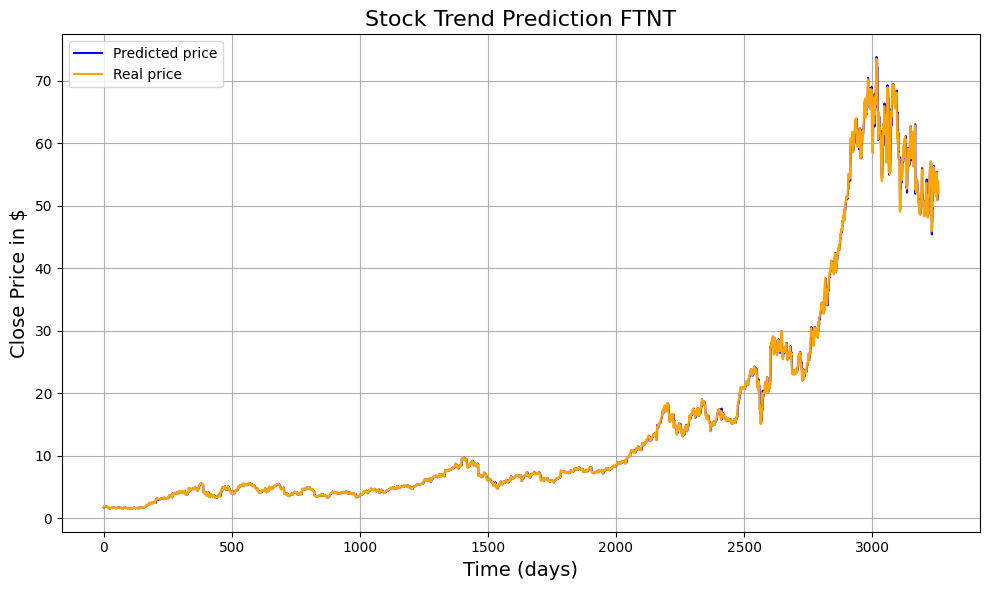

243/243 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.03151054
(7752, 1) (7752, 1)


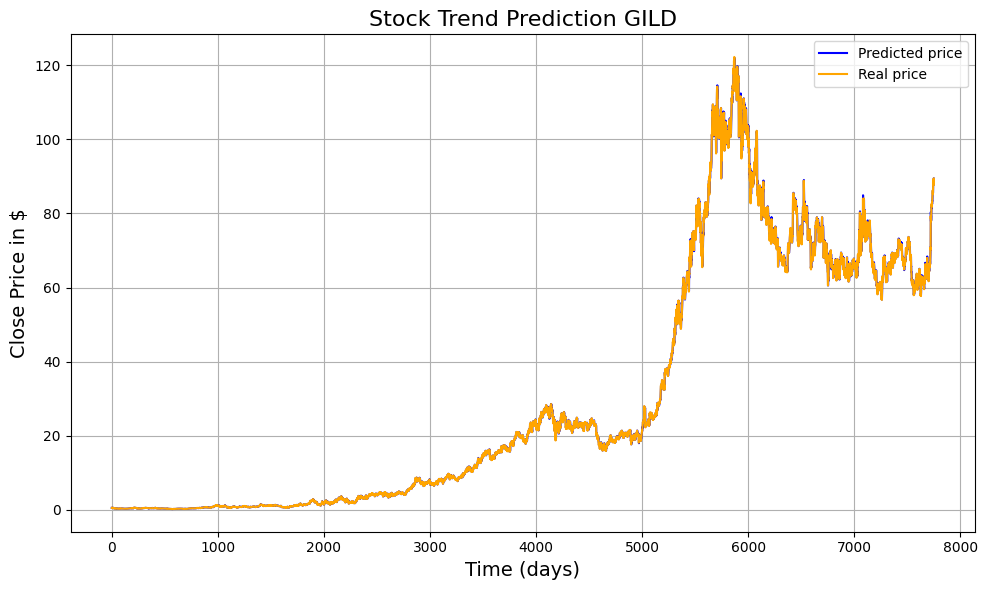

247/247 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.033004165
(7900, 1) (7900, 1)


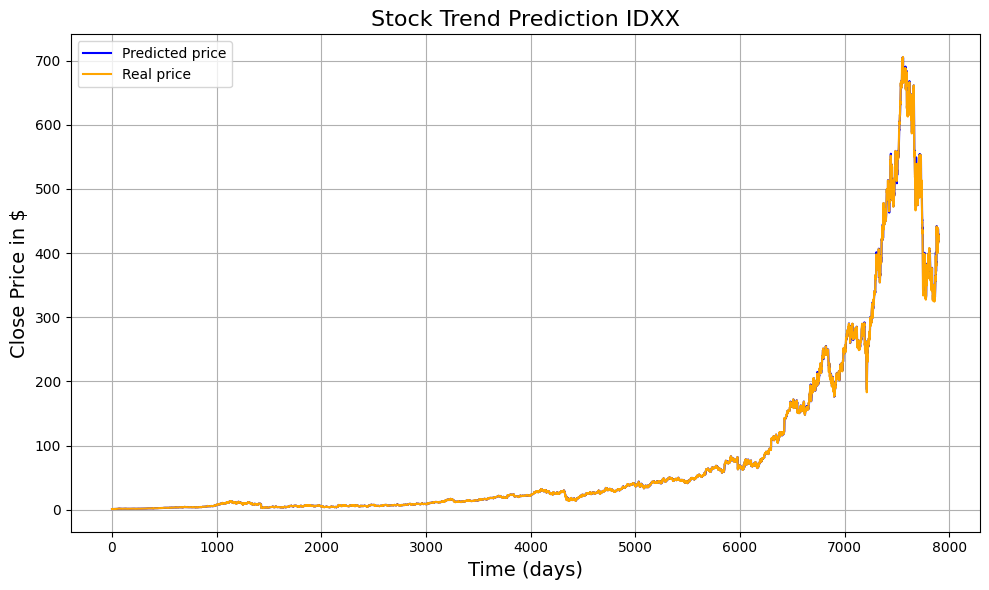

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03090807
(5600, 1) (5600, 1)


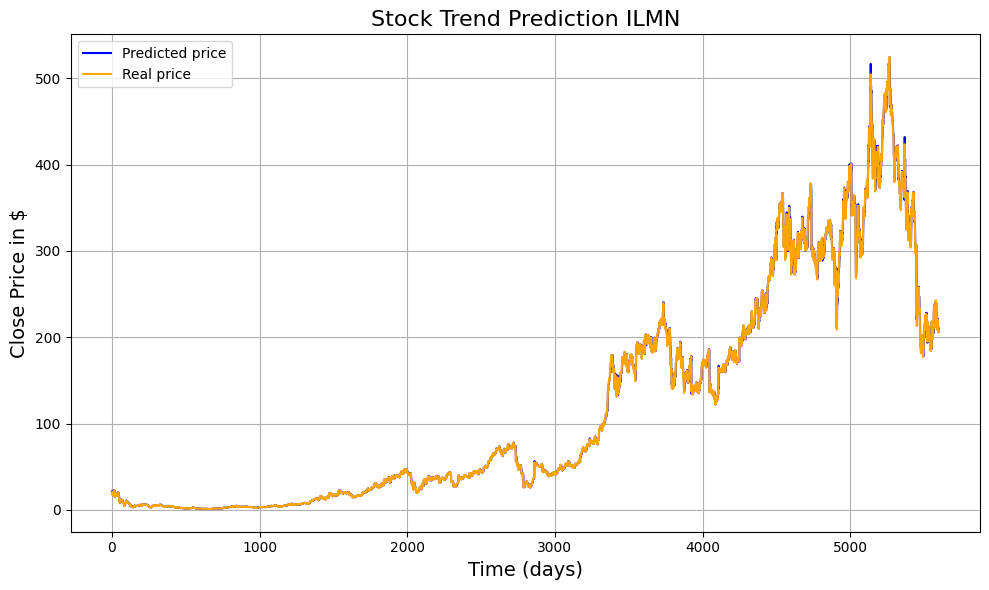

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.026464235
(10748, 1) (10748, 1)


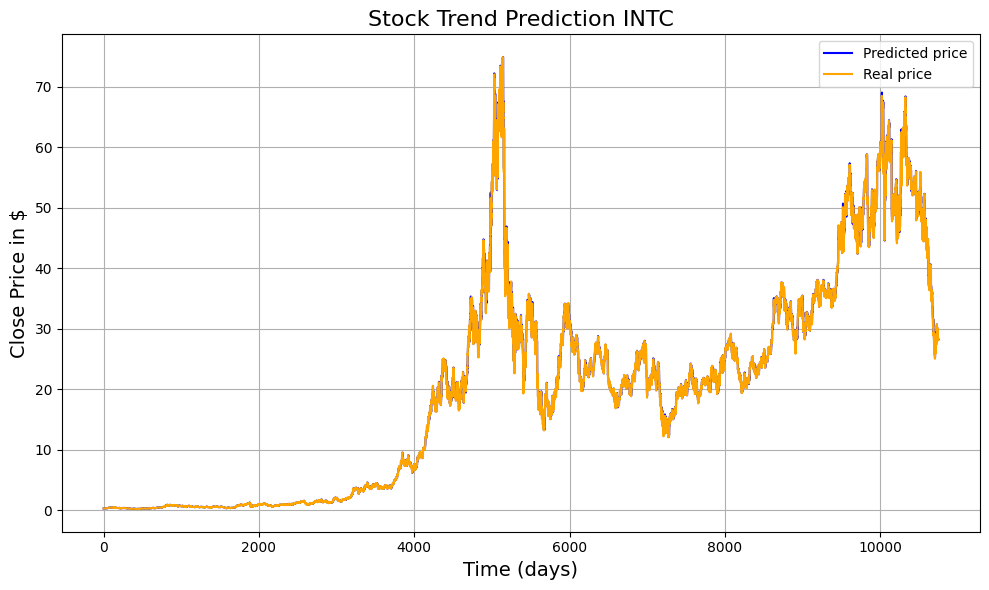

234/234 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.032203224
(7464, 1) (7464, 1)


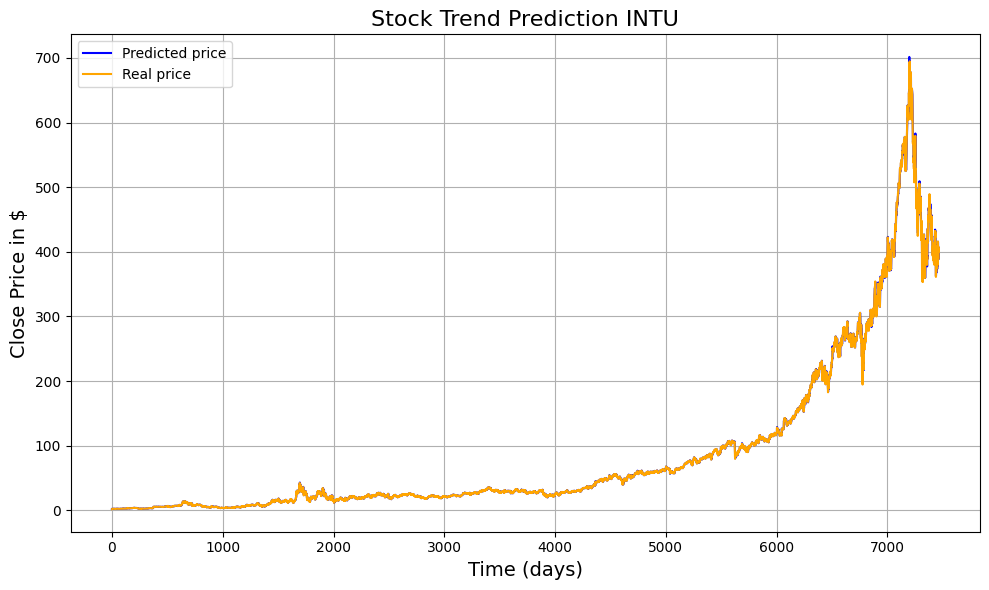

176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03691471
(5629, 1) (5629, 1)


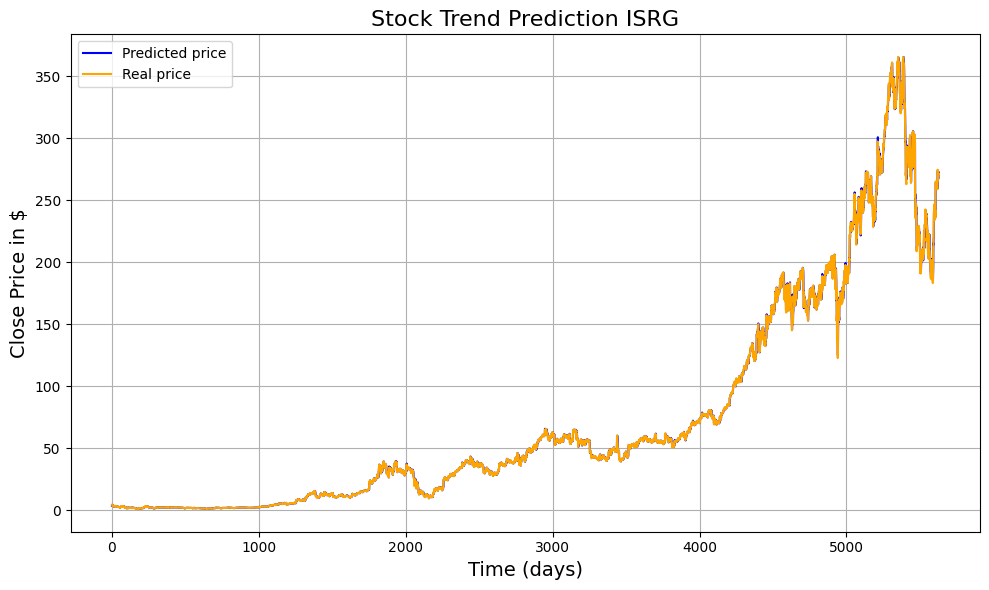

304/304 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.029592628
(9703, 1) (9703, 1)


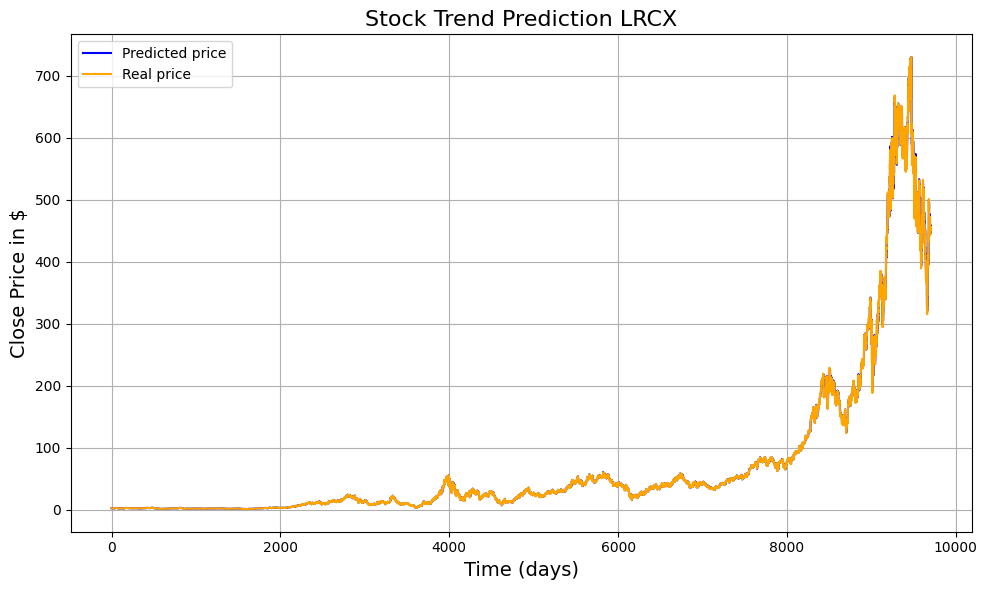

121/121 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.03651831
(3843, 1) (3843, 1)


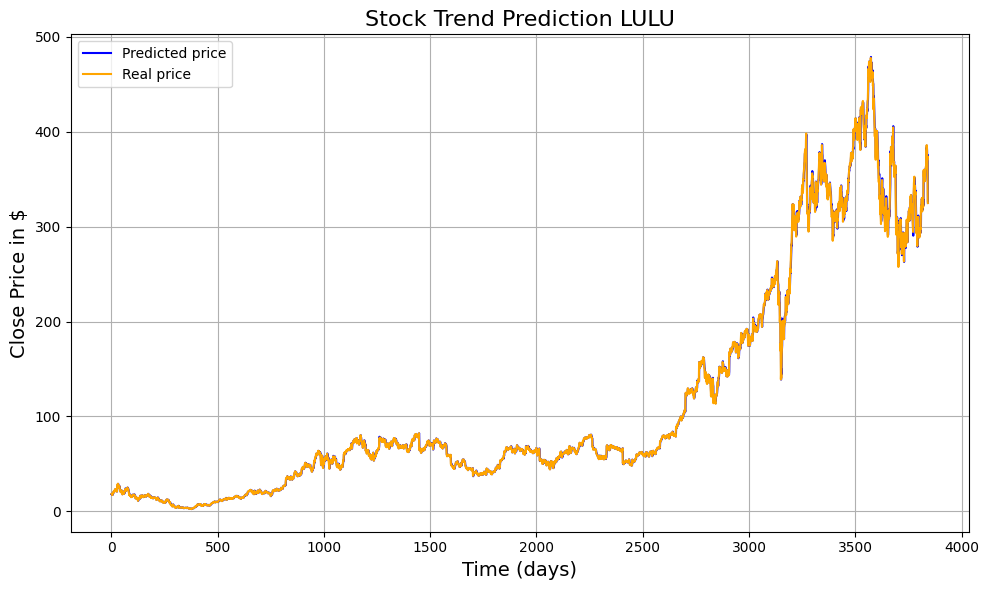

194/194 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.028177394
(6194, 1) (6194, 1)


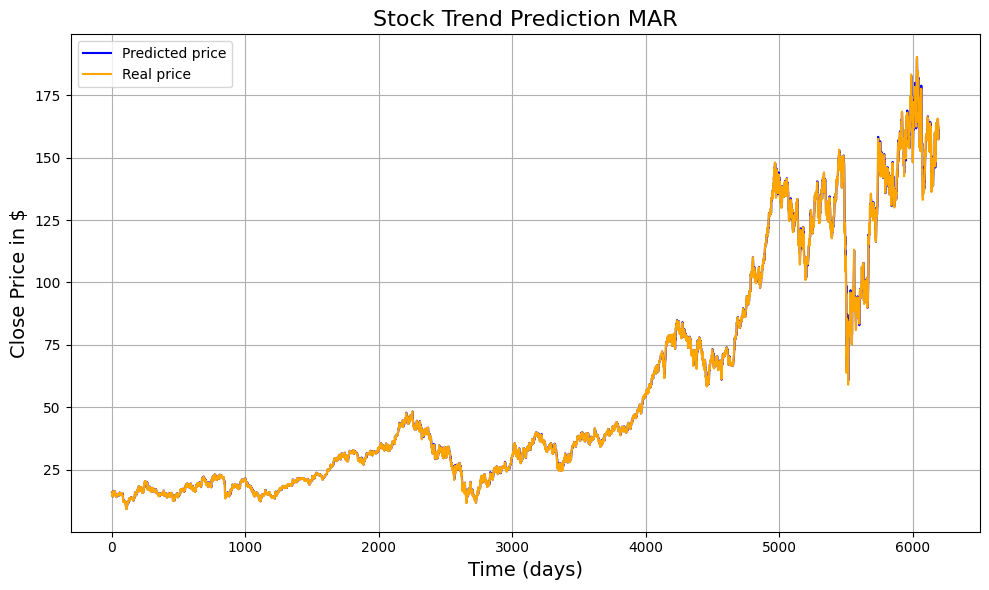

176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.02773369
(5619, 1) (5619, 1)


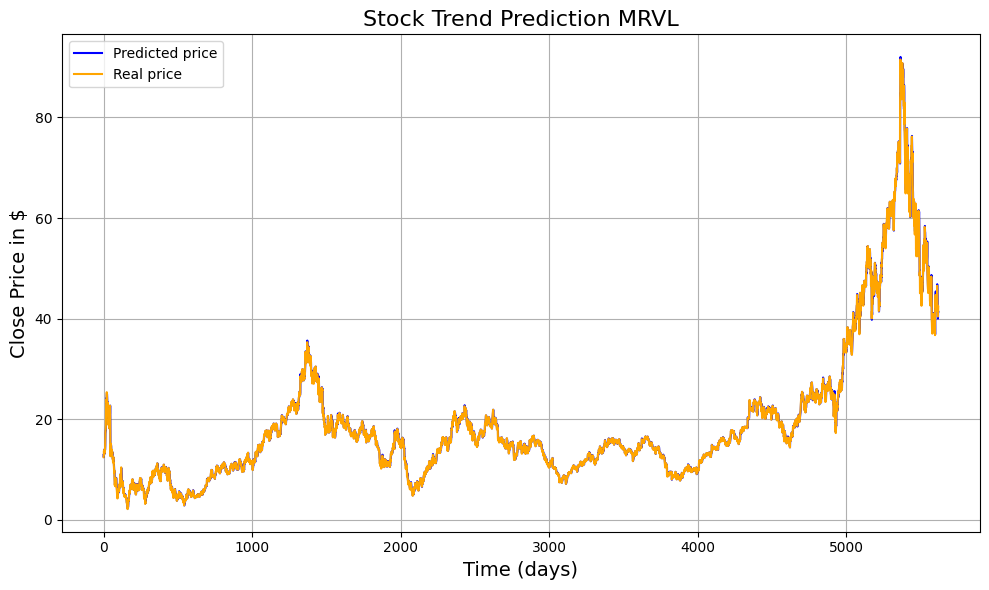

120/120 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
MSE on the test set:  0.030381532
(3833, 1) (3833, 1)


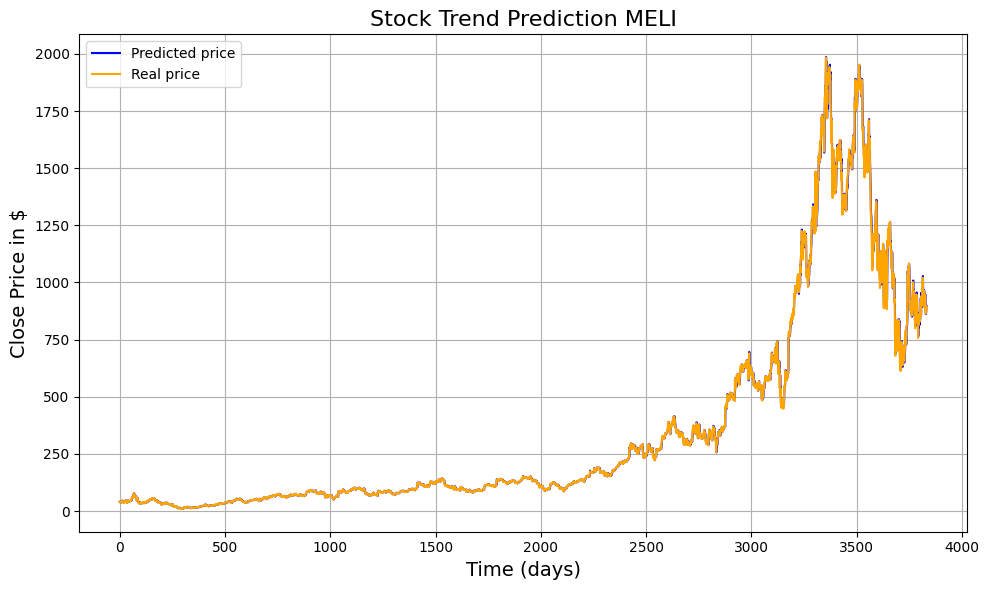

234/234 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.03045707
(7459, 1) (7459, 1)


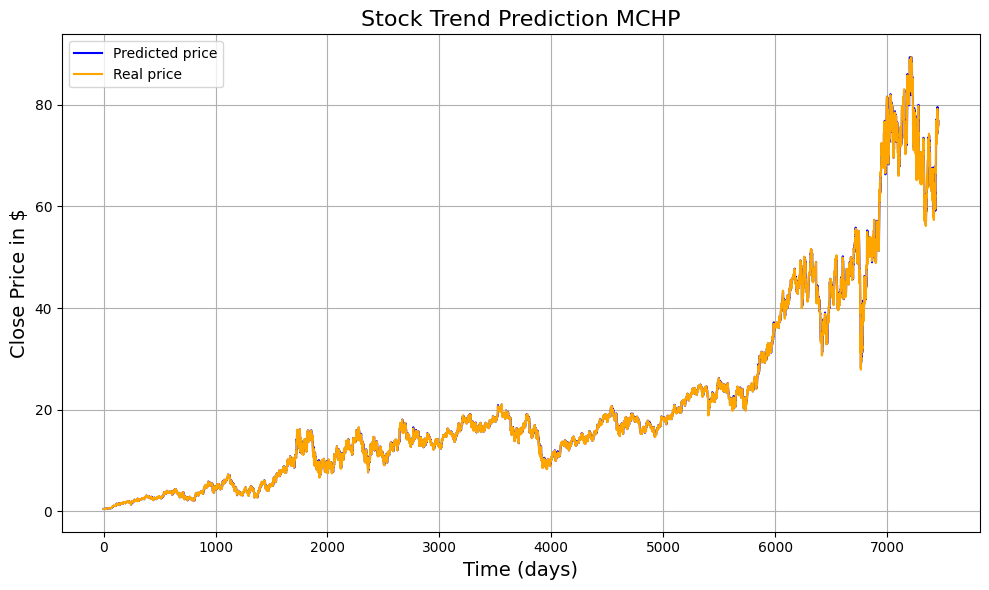

303/303 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.024377268
(9683, 1) (9683, 1)


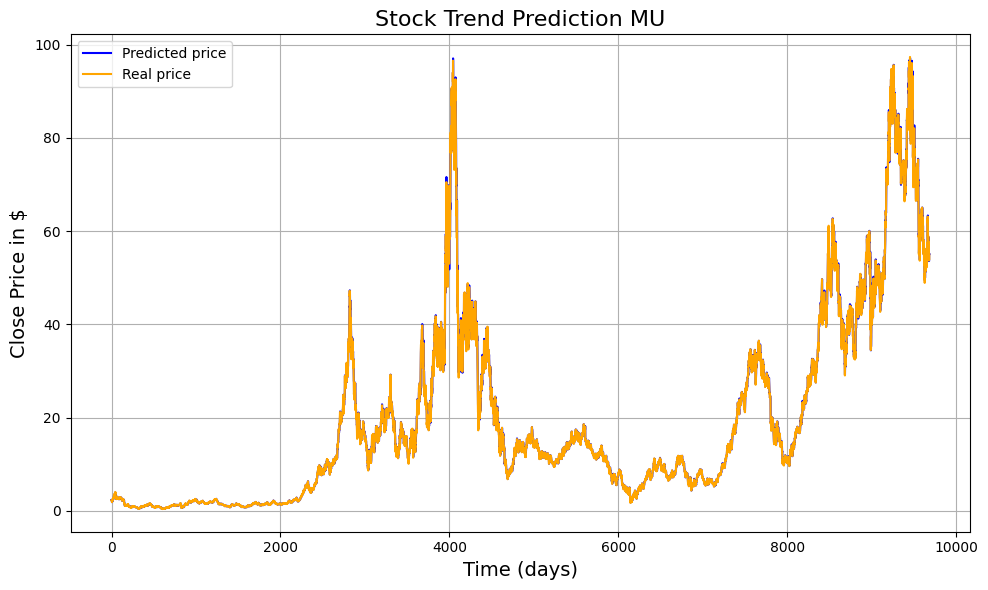

289/289 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.028576335
(9234, 1) (9234, 1)


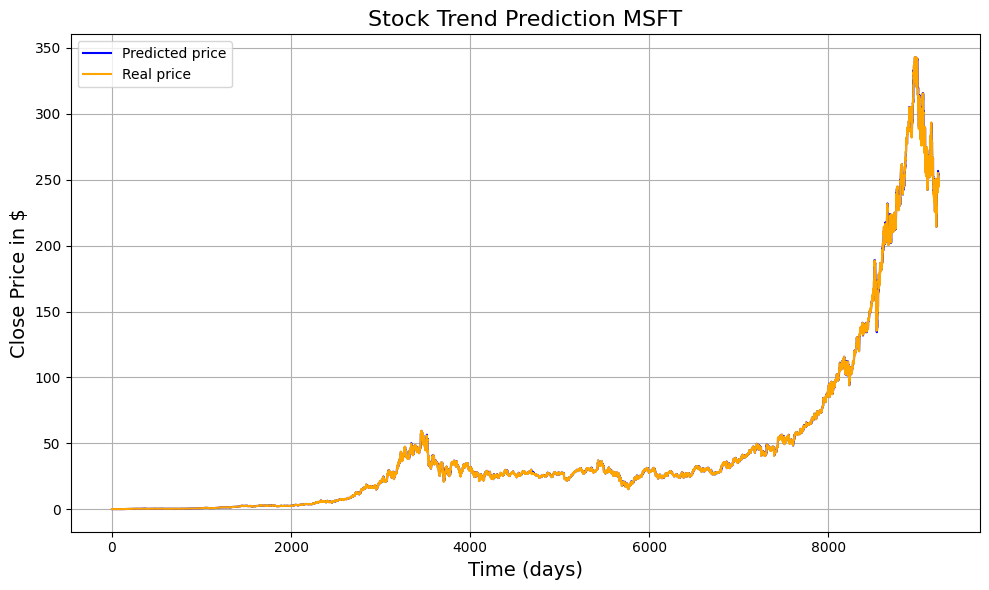

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.03811084
(5380, 1) (5380, 1)


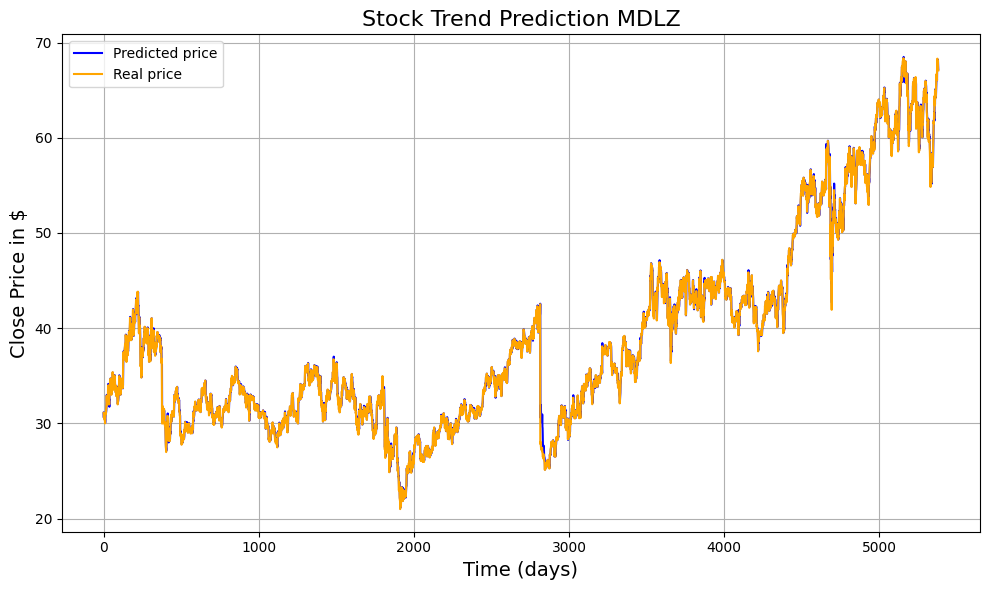

291/291 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.04888854
(9299, 1) (9299, 1)


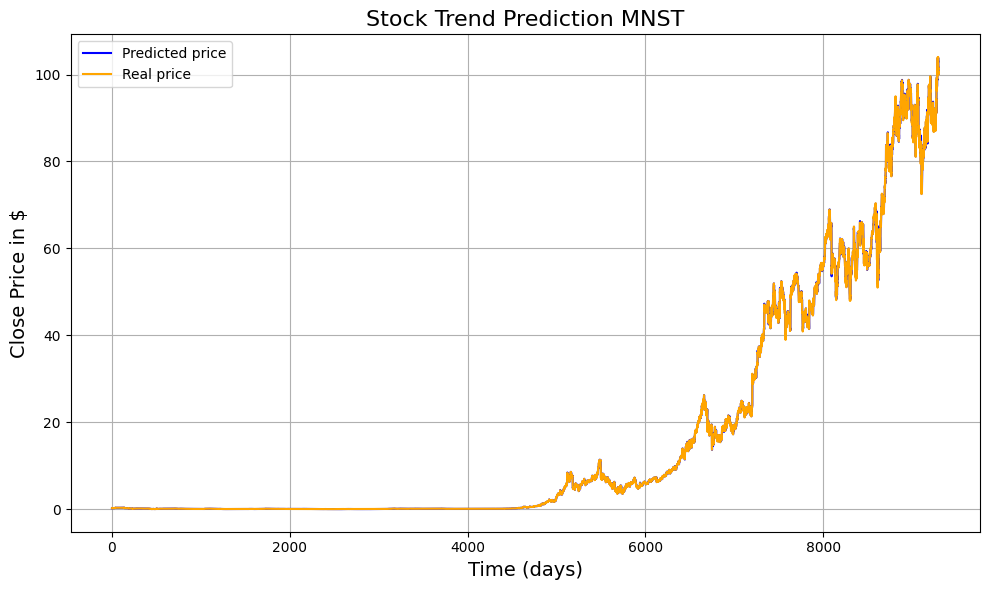

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.034151495
(5146, 1) (5146, 1)


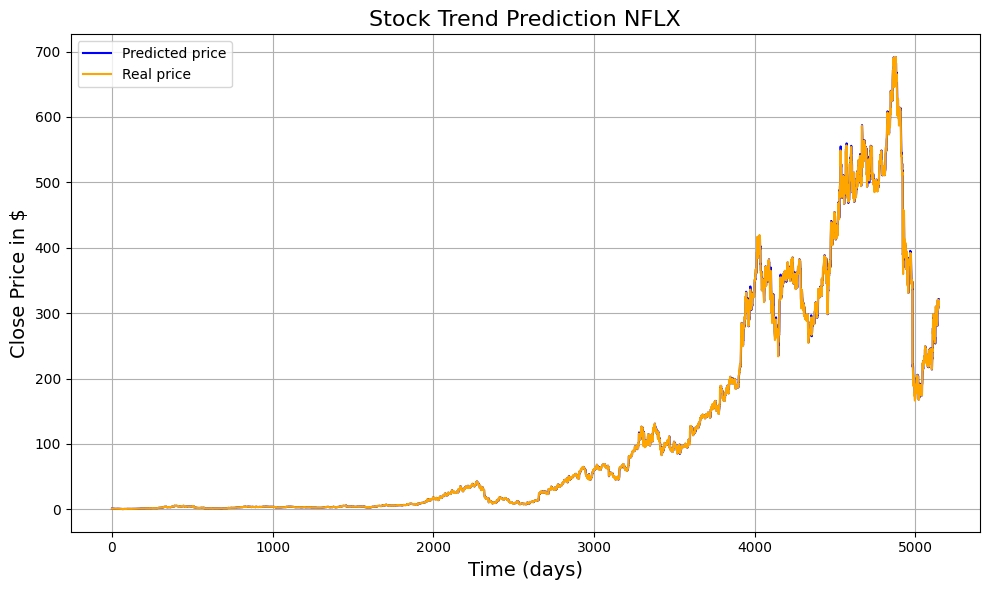

187/187 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.028462801
(5983, 1) (5983, 1)


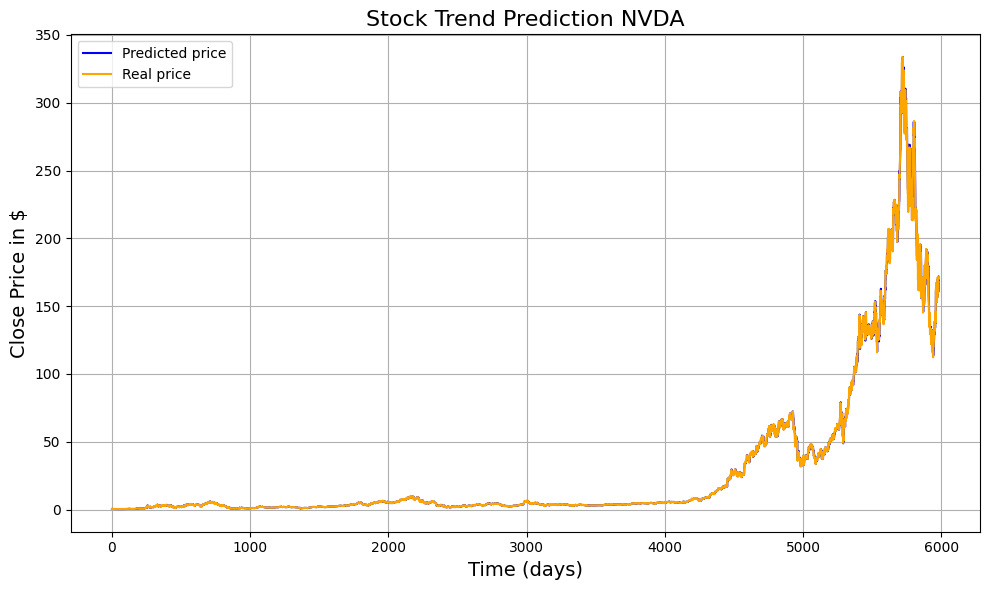

97/97 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
MSE on the test set:  0.03013608
(3080, 1) (3080, 1)


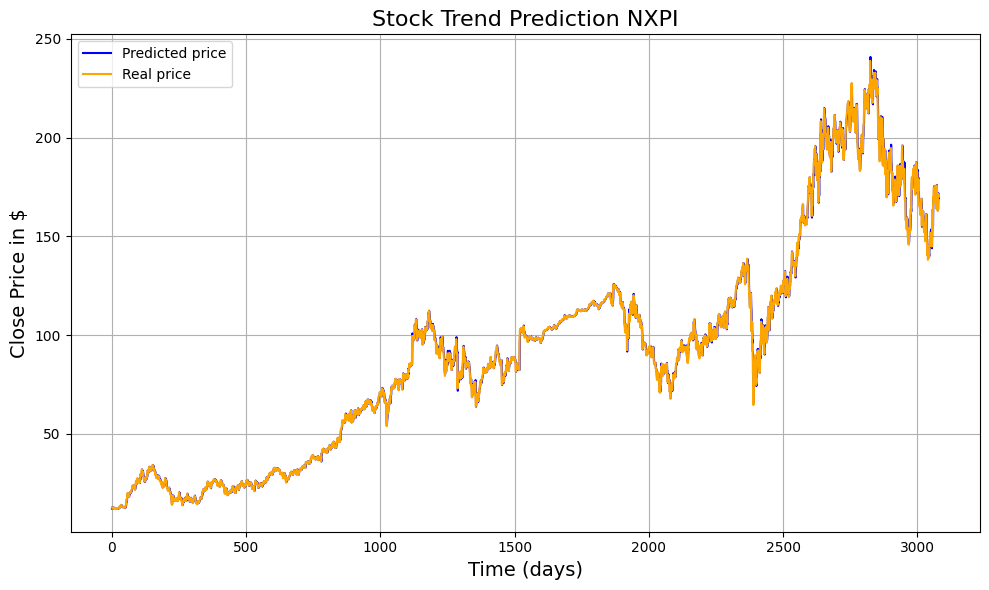

233/233 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.032764703
(7435, 1) (7435, 1)


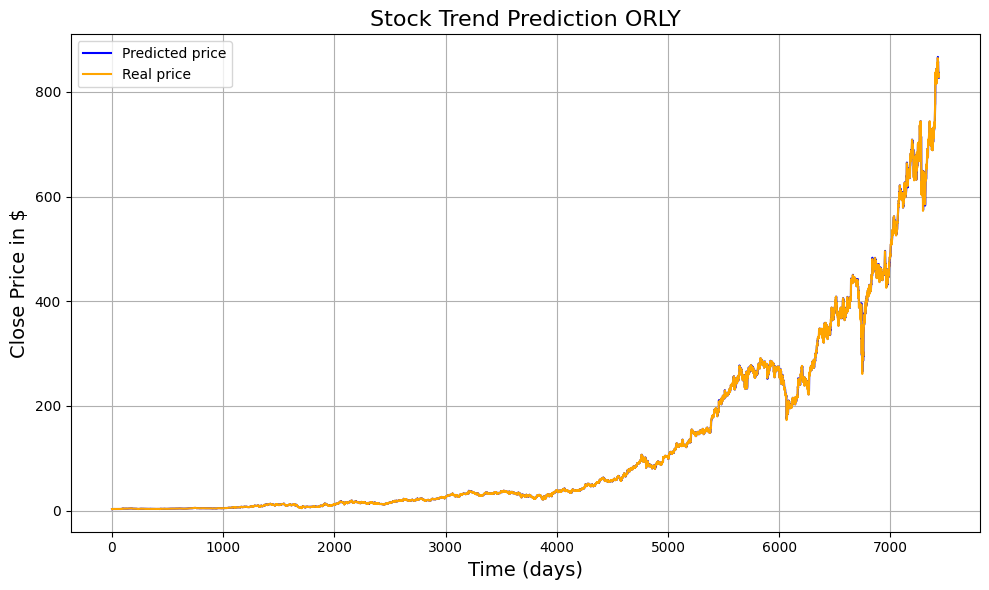

245/245 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.041120213
(7813, 1) (7813, 1)


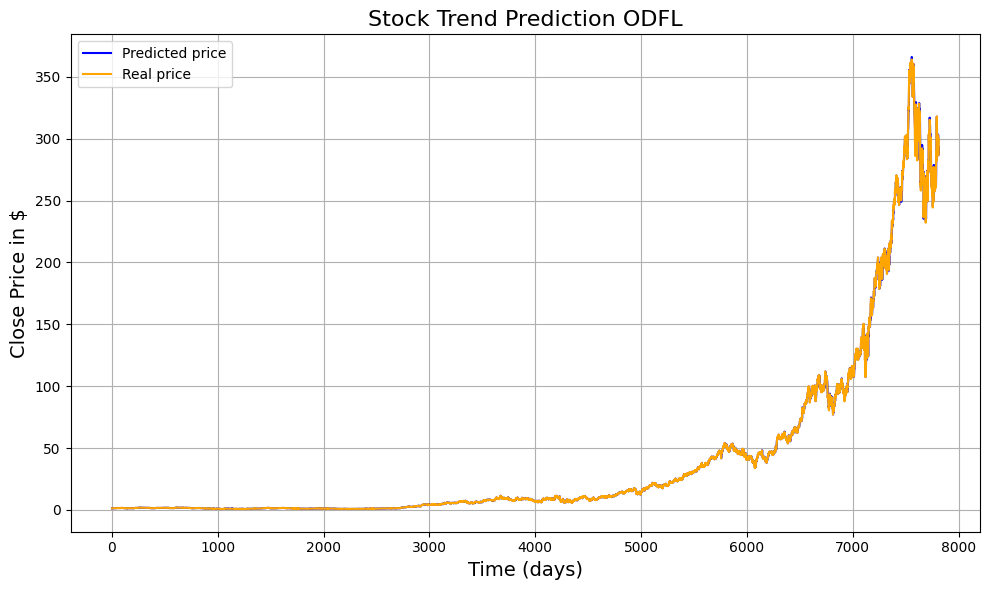

177/177 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.027502036
(5661, 1) (5661, 1)


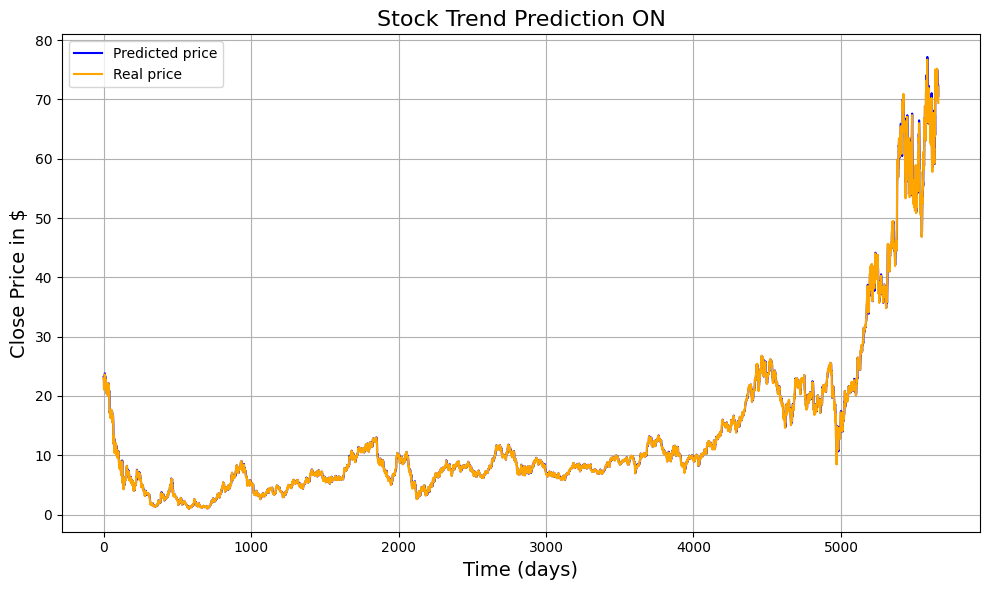

336/336 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.02876232
(10748, 1) (10748, 1)


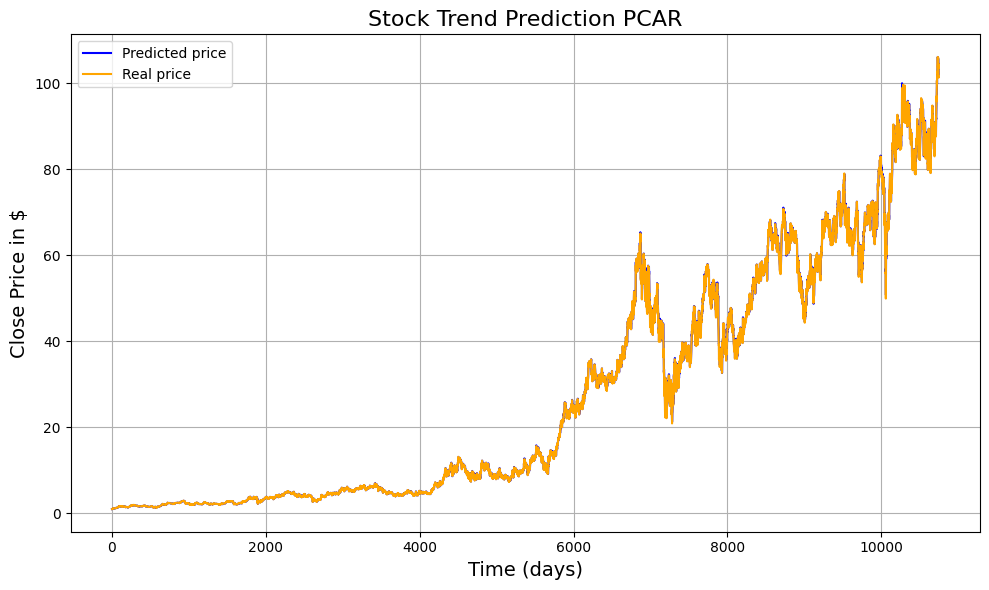

309/309 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.031315576
(9876, 1) (9876, 1)


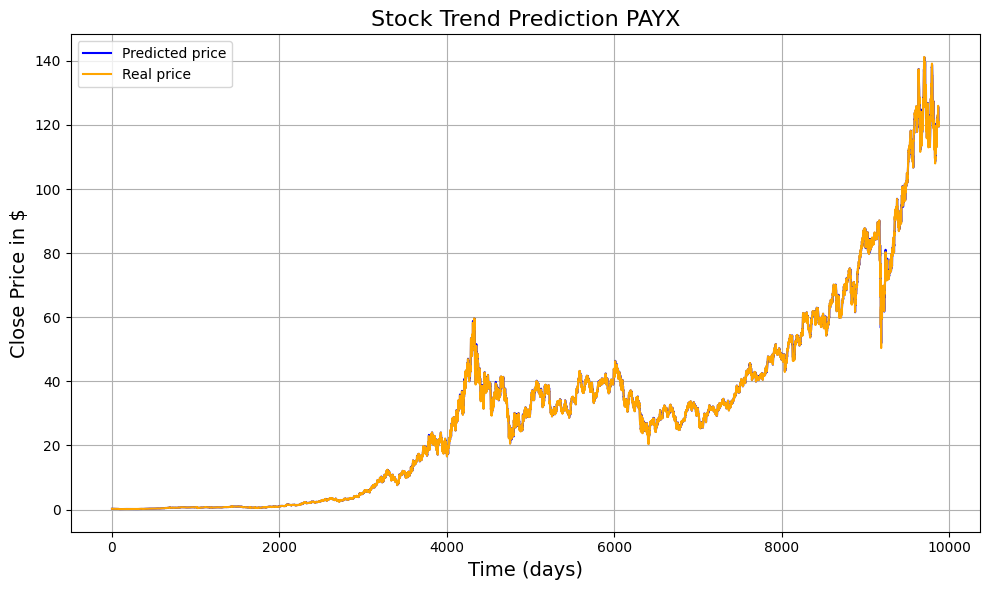

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.032126445
(7778, 1) (7778, 1)


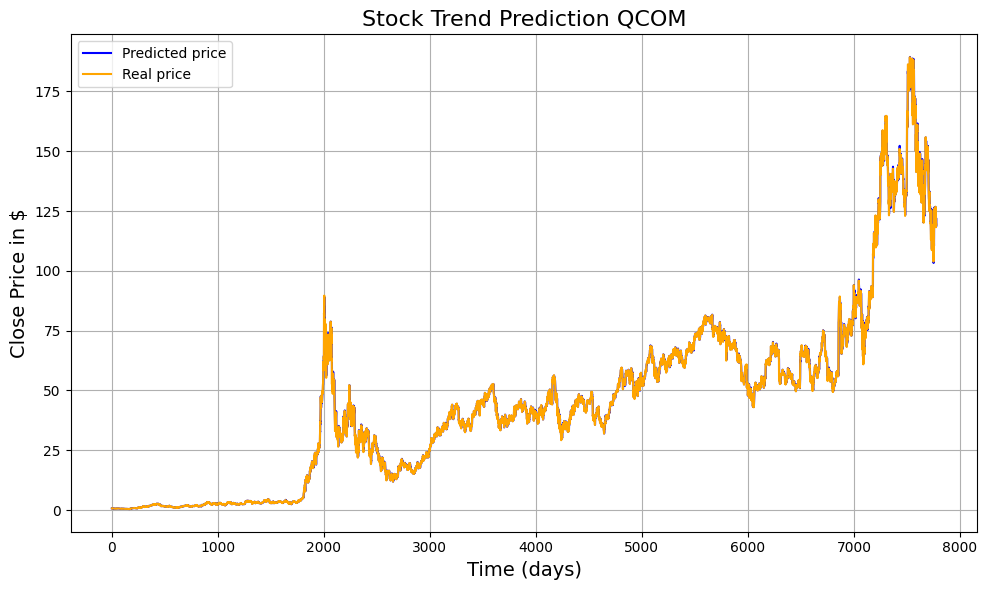

249/249 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
MSE on the test set:  0.032218453
(7957, 1) (7957, 1)


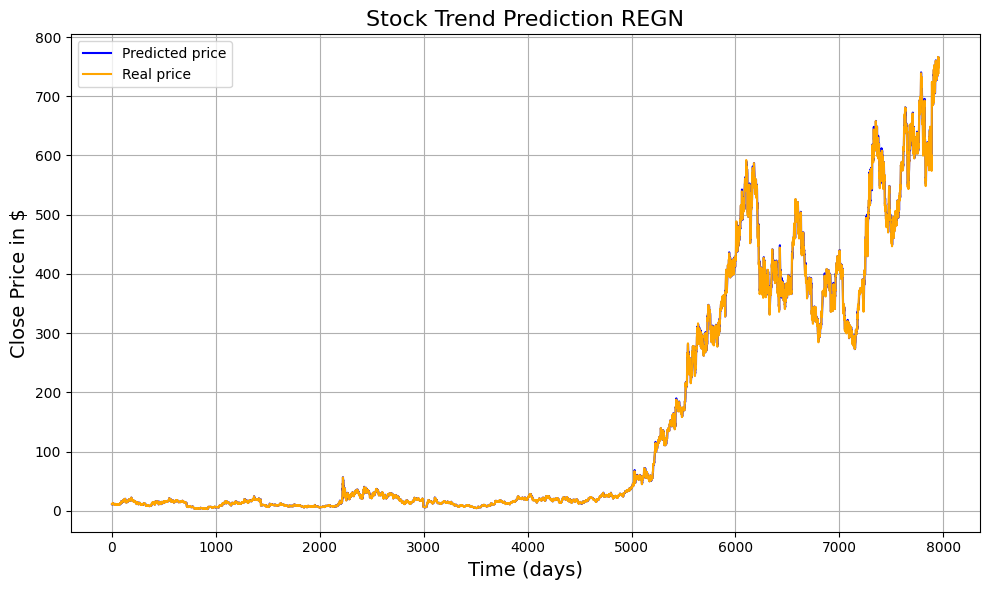

294/294 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03081452
(9383, 1) (9383, 1)


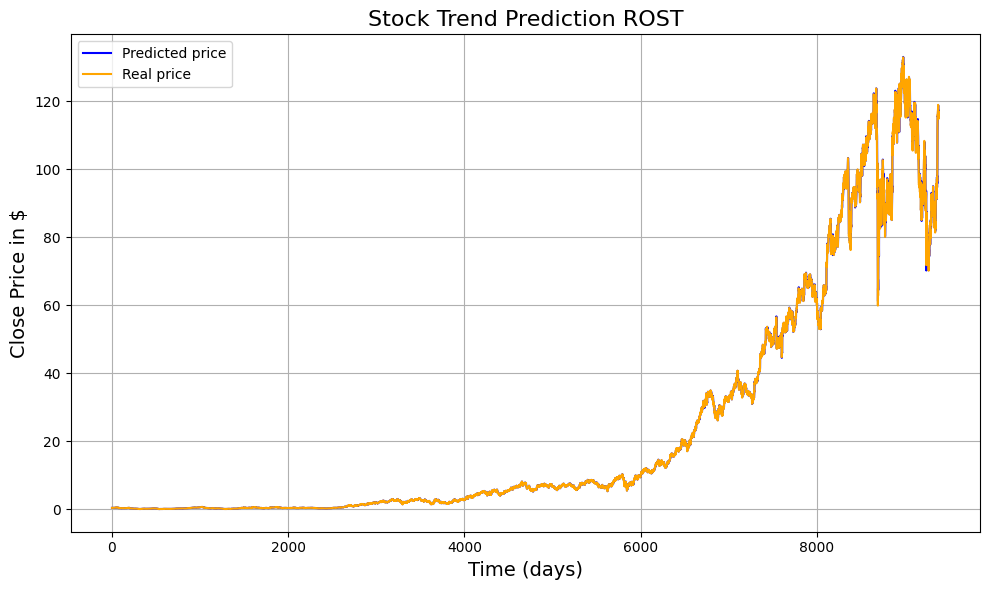

239/239 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.031743992
(7643, 1) (7643, 1)


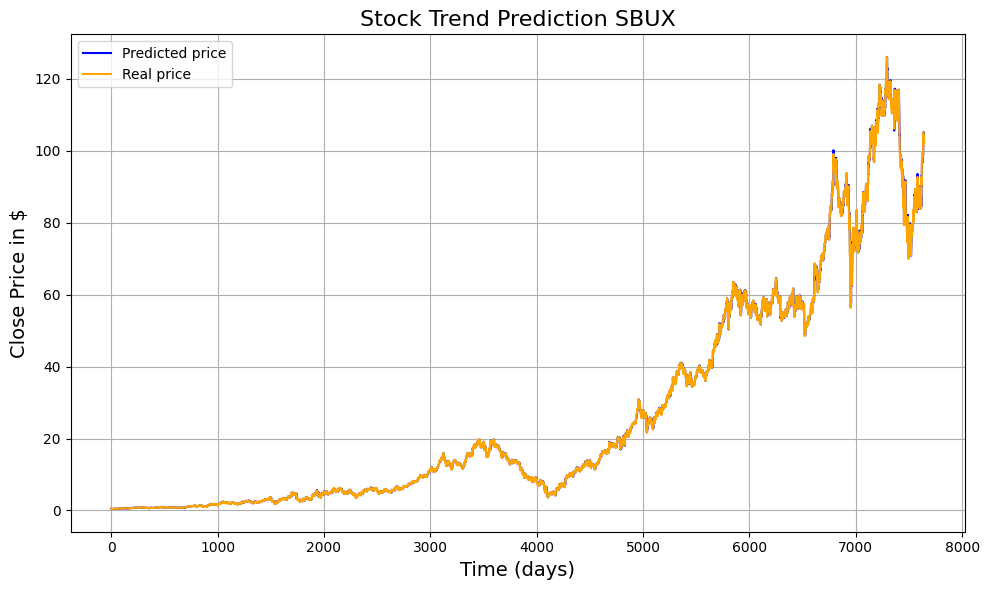

123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
MSE on the test set:  0.03823328
(3926, 1) (3926, 1)


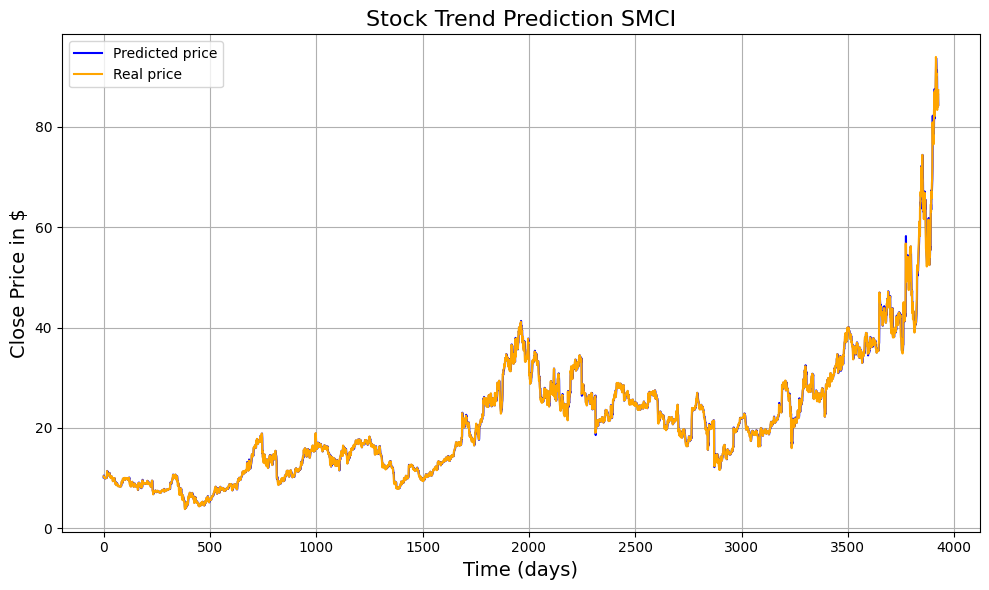

242/242 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.03224455
(7728, 1) (7728, 1)


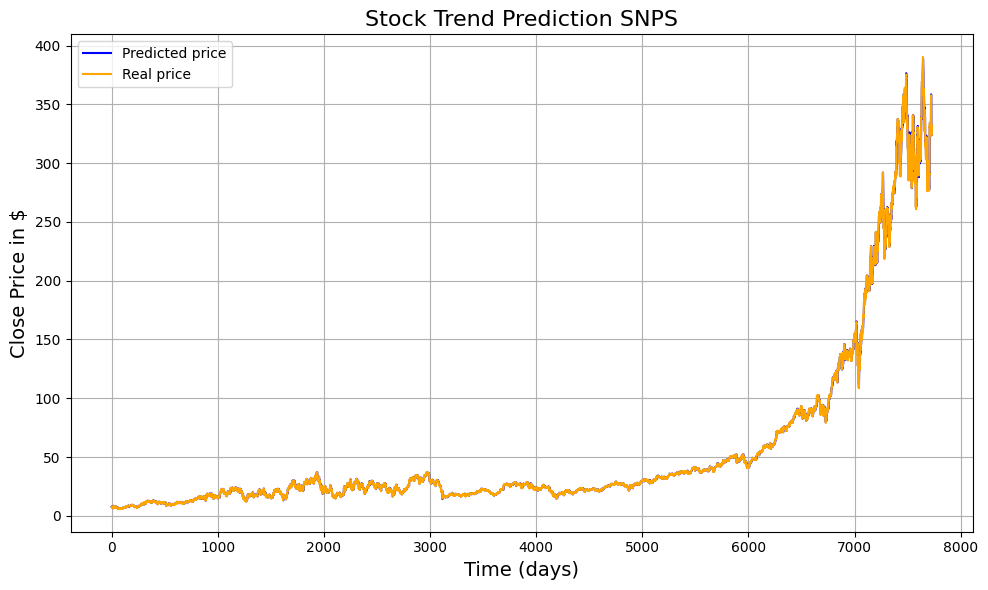

398/398 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.027238144
(12714, 1) (12714, 1)


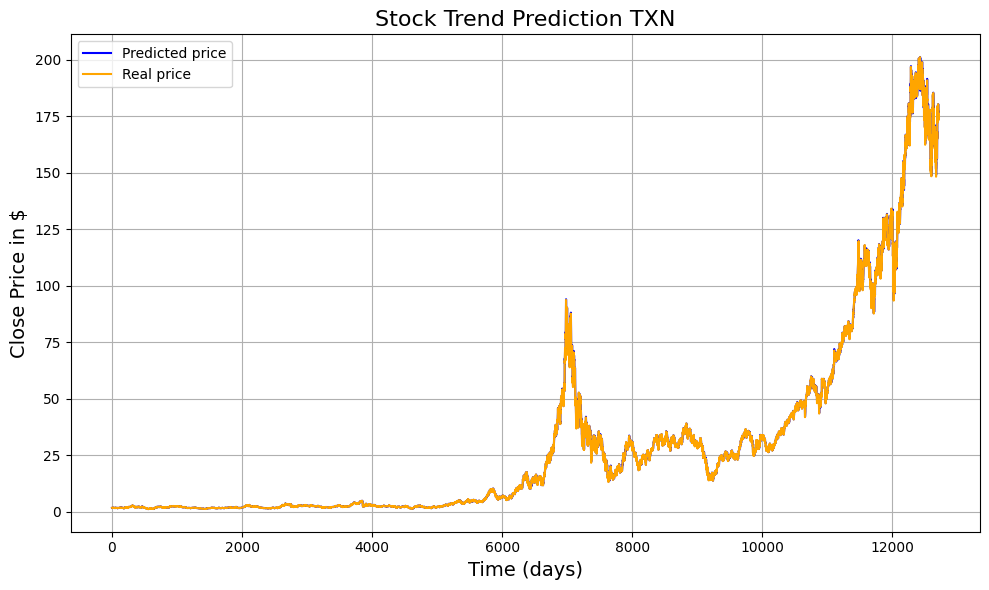

103/103 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
MSE on the test set:  0.03398667
(3289, 1) (3289, 1)


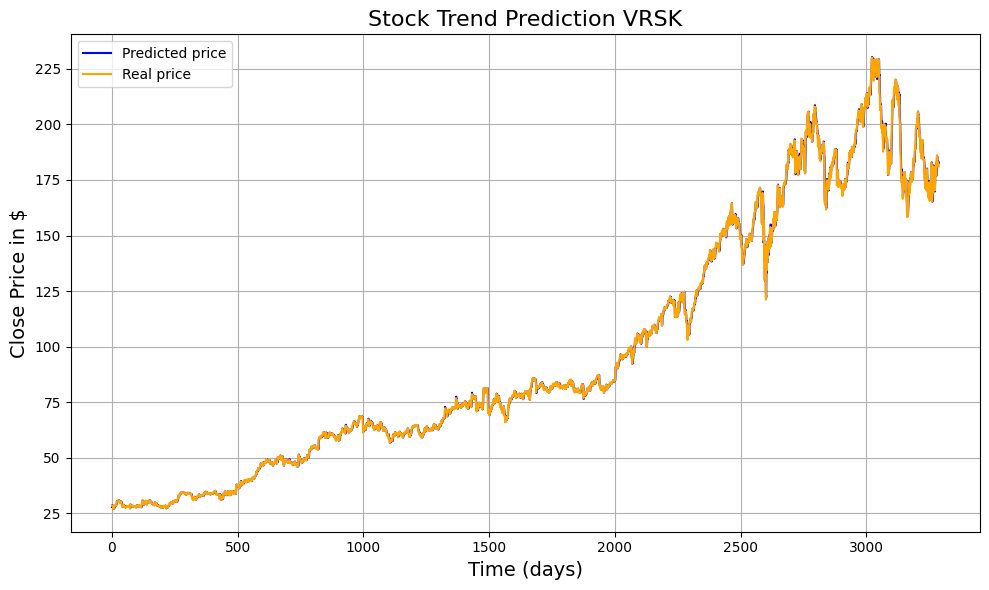

247/247 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MSE on the test set:  0.040618975
(7878, 1) (7878, 1)


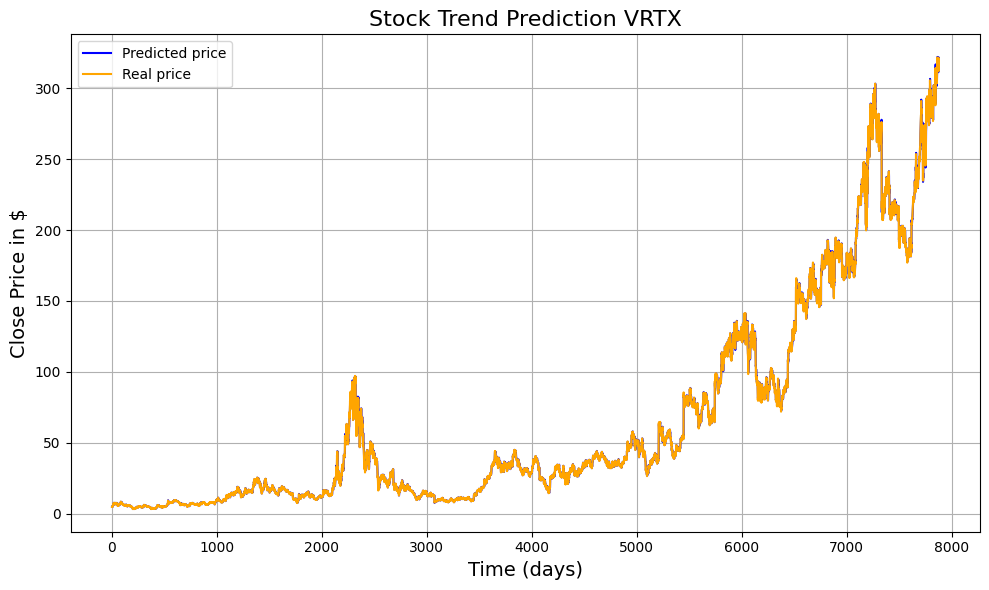

In [28]:
# Load model
lstm_test_1 = tf.keras.models.load_model('lstm_nor.keras')

# Load all data first
(all_X_data, all_y_data, 
all_X_data_norm, all_y_data_norm, 
all_X_data_norm_t, all_y_data_norm_t, 
all_feature_choice_indices) = load_all_data(
    nasqad100, 
    features, 
    window_size=window_size, 
    k_days=1, 
    feature_choice='Close', 
    type=0
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        lstm_test_1, 
        all_X_data_norm_t[stock], 
        all_y_data_norm_t[stock], 
        all_X_data[stock], 
        all_y_data[stock], 
        all_feature_choice_indices[stock], 
        stock
    )

### Task 1.2 

#### 1D Convolutional Neural Network

In [43]:
# nasqad100 list
nasqad100 = ['ADBE','AMD','ABNB','GOOGL','GOOG','AMZN','AEP','AMGN','ADI','ANSS','AAPL','AMAT','APP','ARM','ASML','AZN','TEAM','ADSK','ADP','BKR','BIIB','BKNG','AVGO','CDNS','CDW','CHTR','CTAS','CSCO','CCEP','CTSH','CMCSA','CEG','CPRT','CSGP','COST','CRWD','CSX','DDOG','DXCM','FANG','DASH','EA','EXC','FAST','FTNT','GEHC','GILD','GFS','HON','IDXX','ILMN','INTC','INTU','ISRG','KDP','KLAC','KHC','LRCX','LIN','LULU','MAR','MRVL','MELI','META','MCHP','MU','MSFT','MRNA','MDLZ','MDB','MNST','NFLX','NVDA','NXPI','ORLY','ODFL','ON','PCAR','PANW','PAYX','PYPL','PDD','PEP','QCOM','REGN','ROP','ROST','SBUX','SMCI','SNPS','TTWO','TMUS','TSLA','TXN','TTD','VRSK','VRTX','WBD','WDAY','XEL','ZS']
window_size = 60
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']

285/285 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.01277876732052132
(9097, 1) (9097, 1)


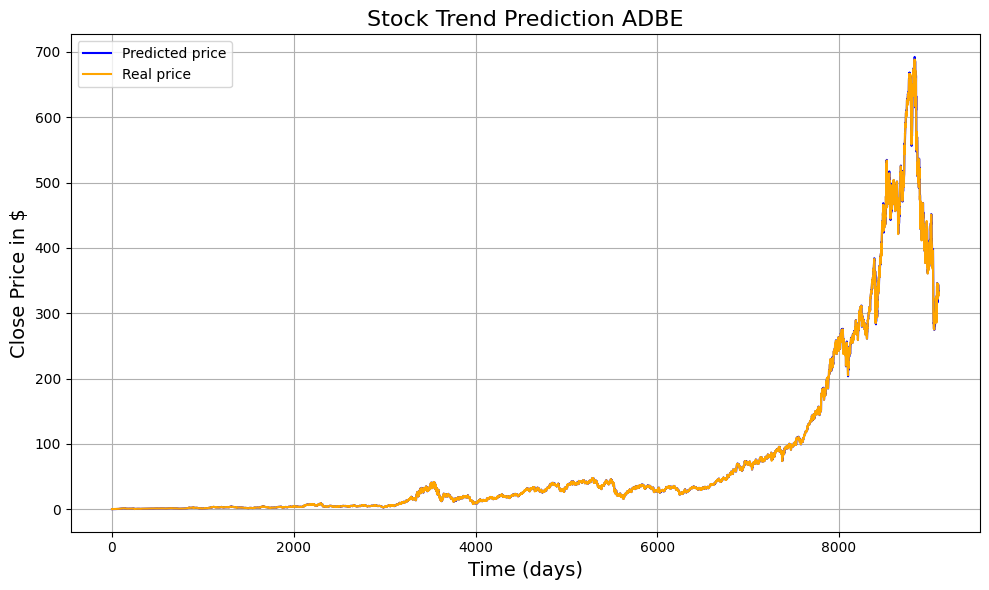

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.011175813900644245
(10717, 1) (10717, 1)


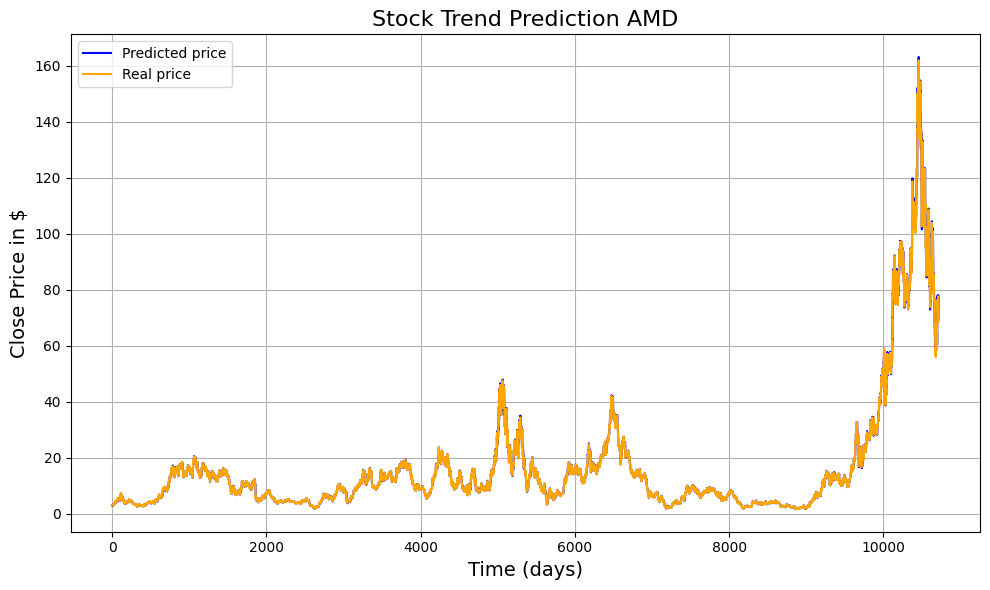

200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.013174801828918453
(6377, 1) (6377, 1)


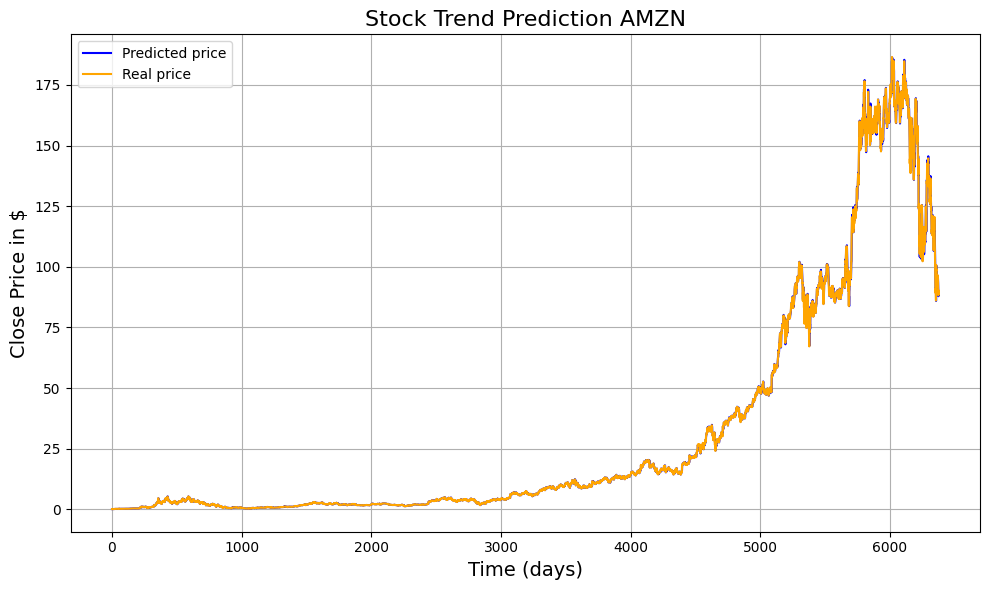

310/310 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.012251502533356122
(9894, 1) (9894, 1)


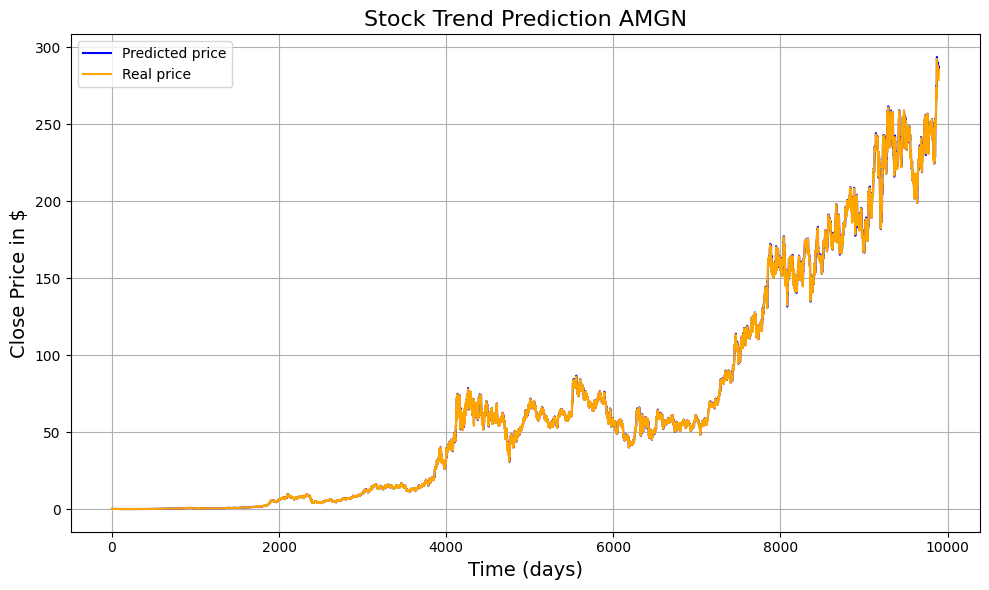

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
MSE on the test set:  0.01342279513663106
(10717, 1) (10717, 1)


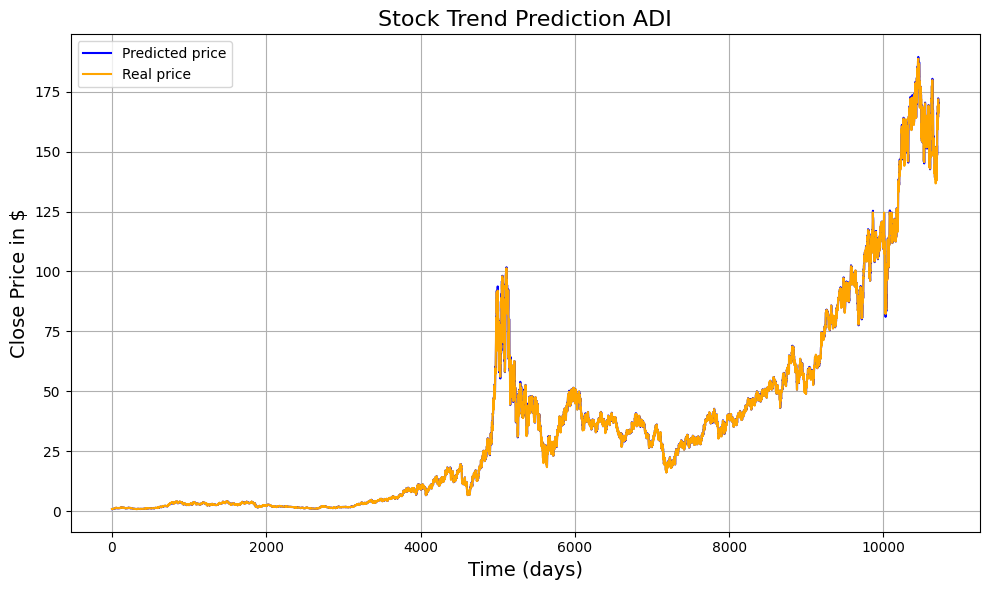

330/330 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.010540233326151316
(10529, 1) (10529, 1)


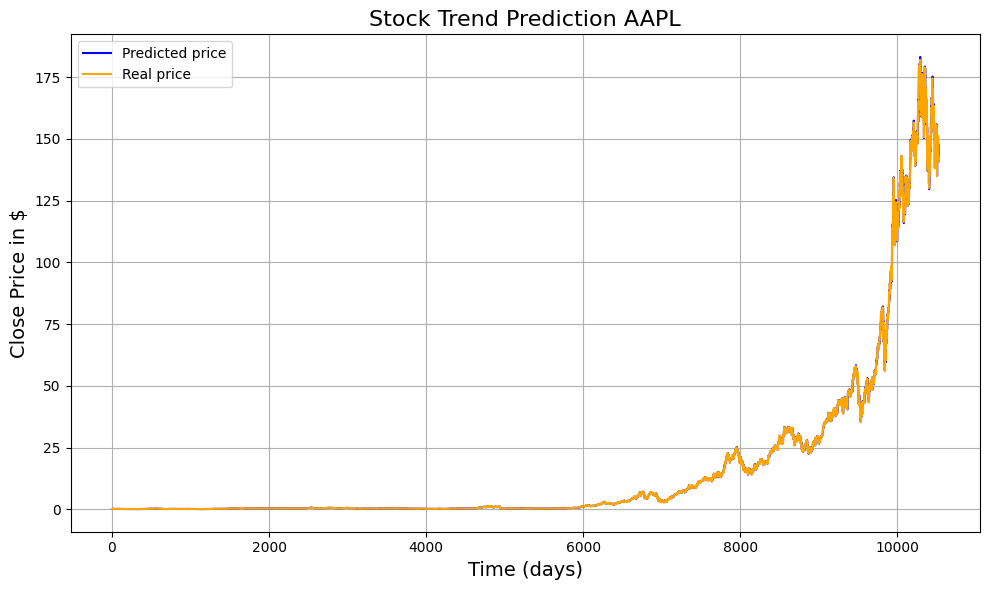

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.011587143679829036
(10717, 1) (10717, 1)


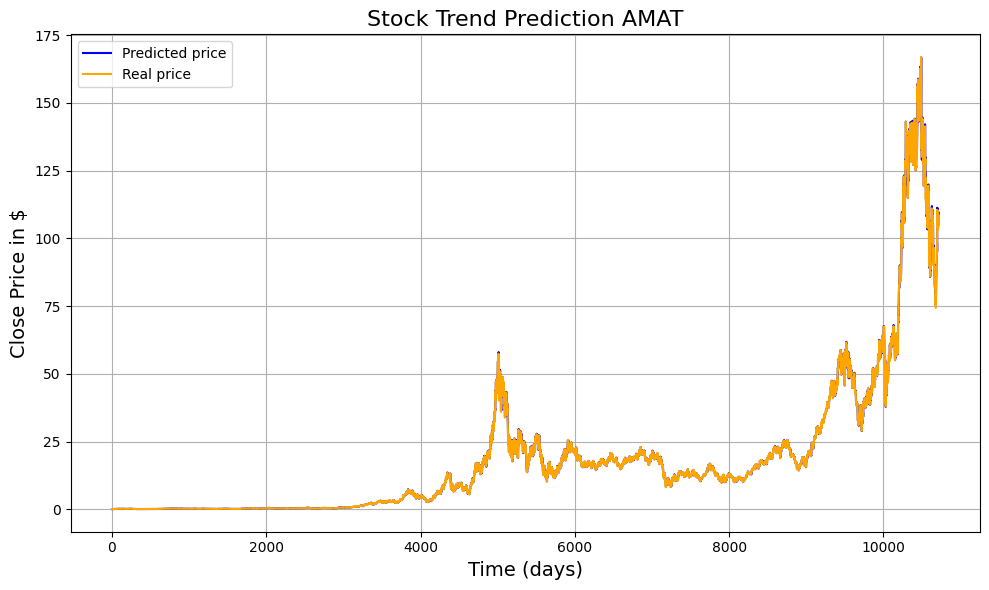

217/217 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01159673901811304
(6926, 1) (6926, 1)


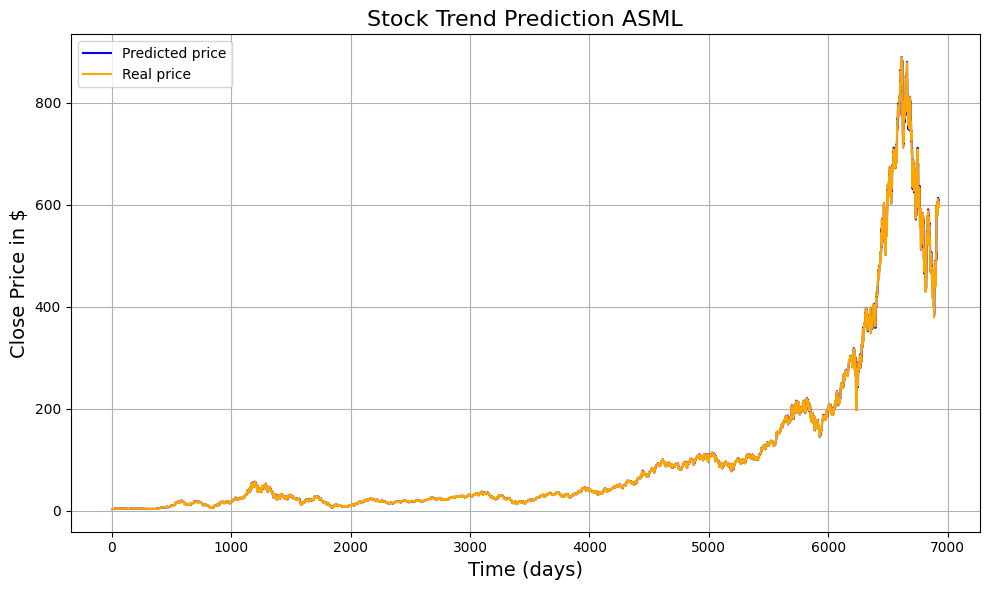

294/294 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.0123754039870325
(9380, 1) (9380, 1)


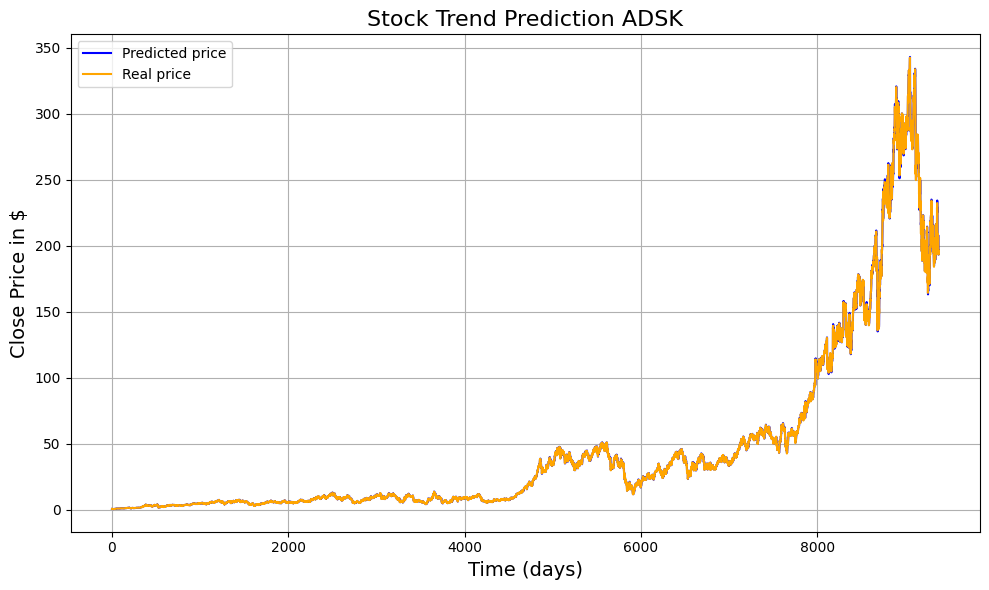

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.013076504097924616
(10717, 1) (10717, 1)


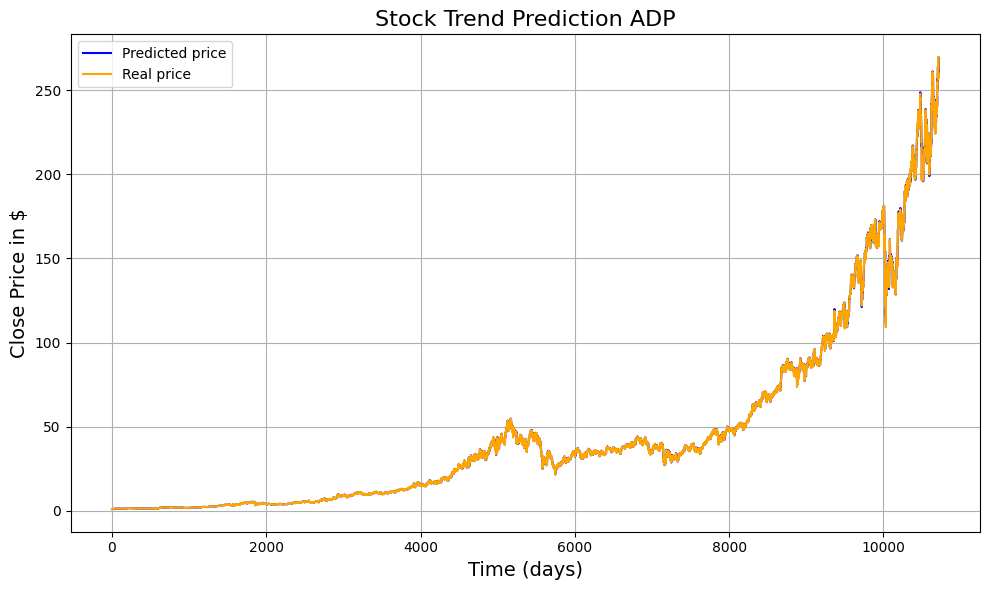

245/245 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020215348044278547
(7809, 1) (7809, 1)


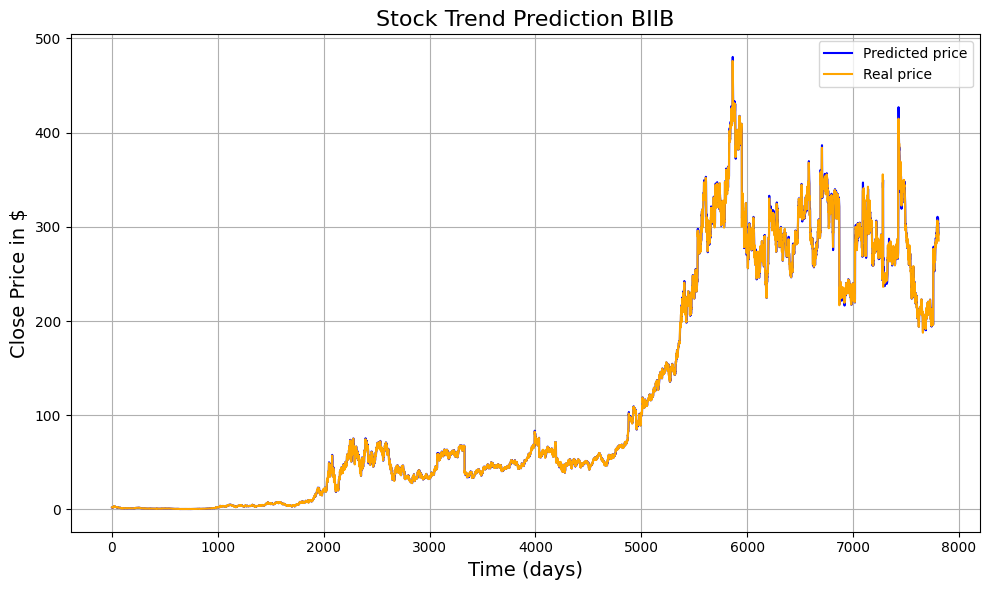

278/278 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012959013850455942
(8889, 1) (8889, 1)


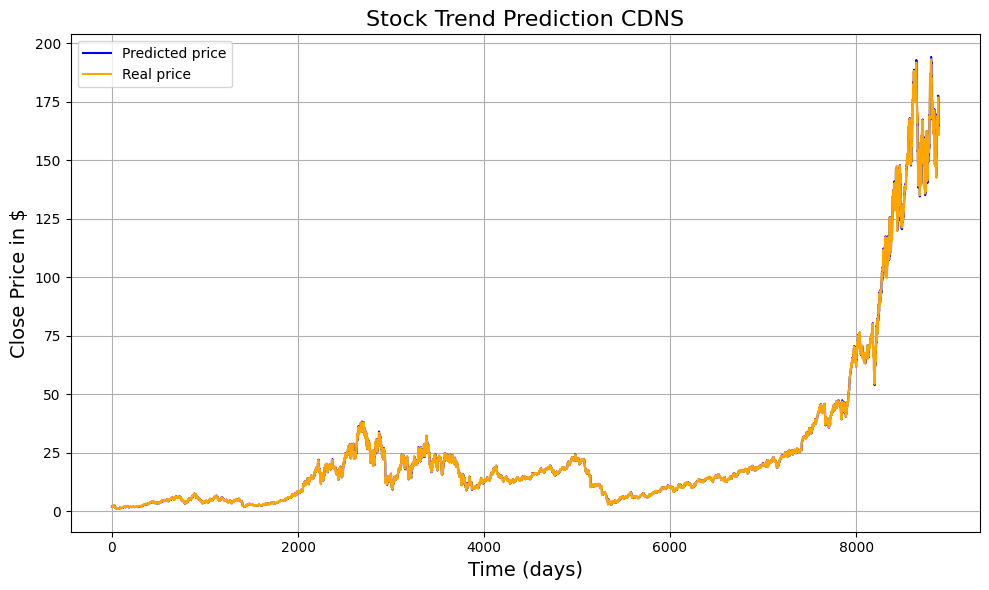

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012384033105354035
(2322, 1) (2322, 1)


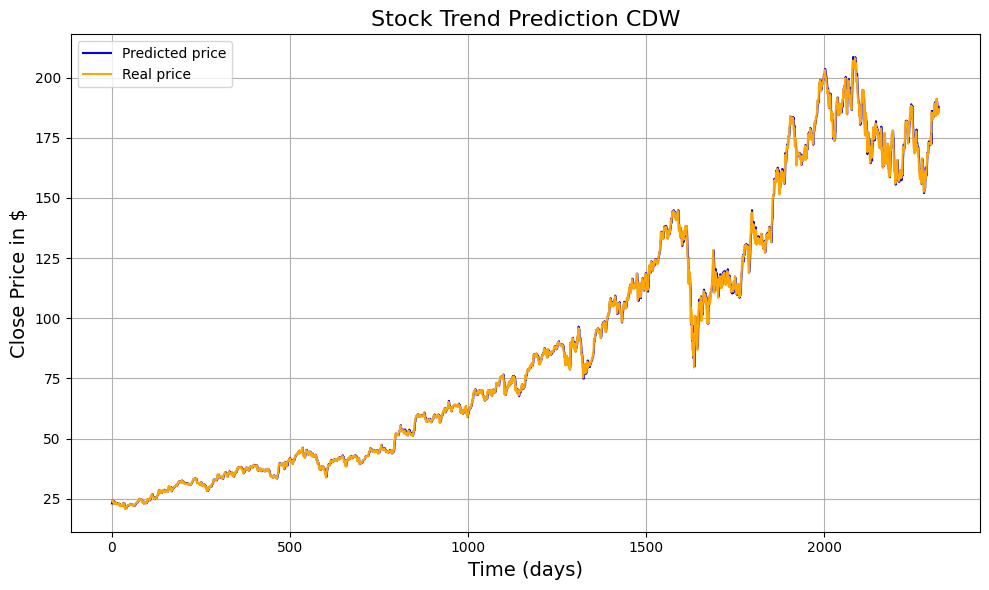

100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012257036729037923
(3197, 1) (3197, 1)


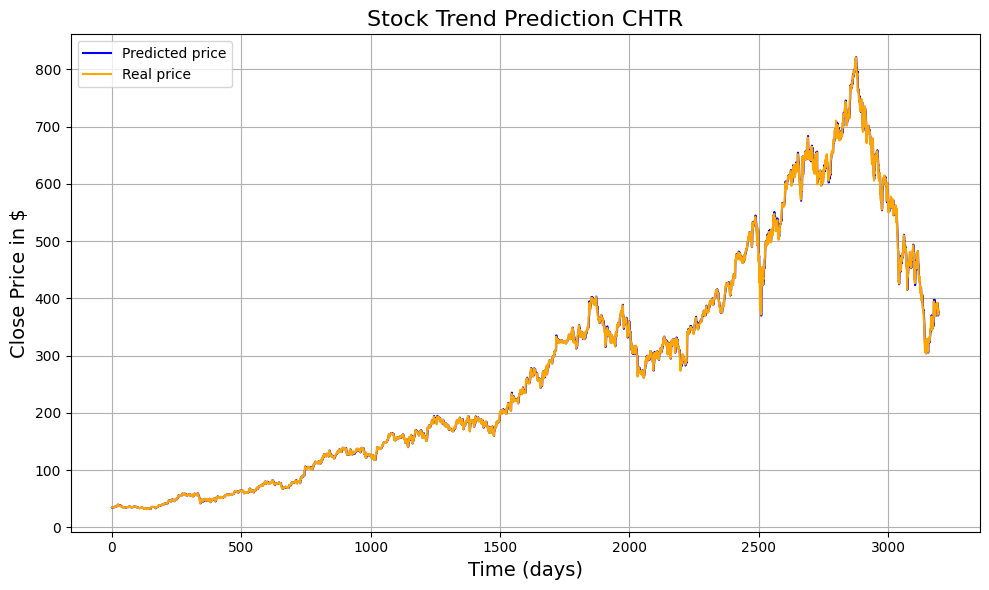

308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.014410657483772455
(9850, 1) (9850, 1)


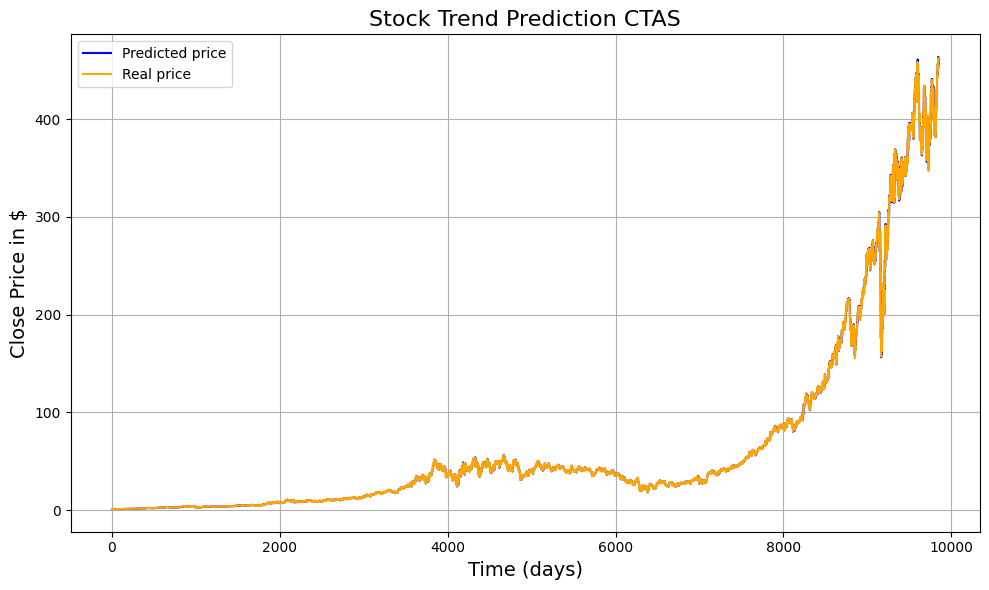

257/257 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013433556684469312
(8208, 1) (8208, 1)


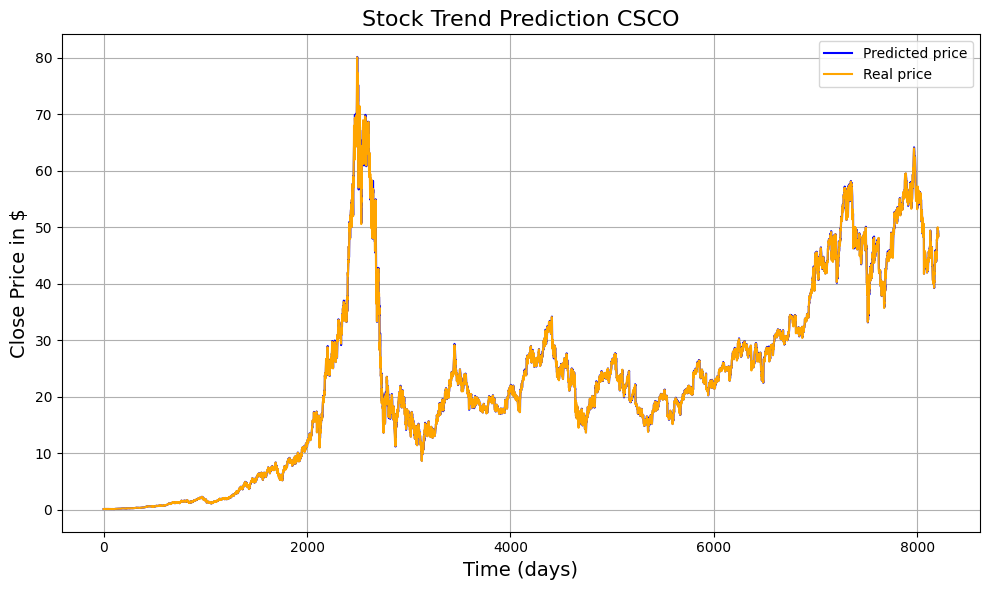

191/191 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014274337981164916
(6101, 1) (6101, 1)


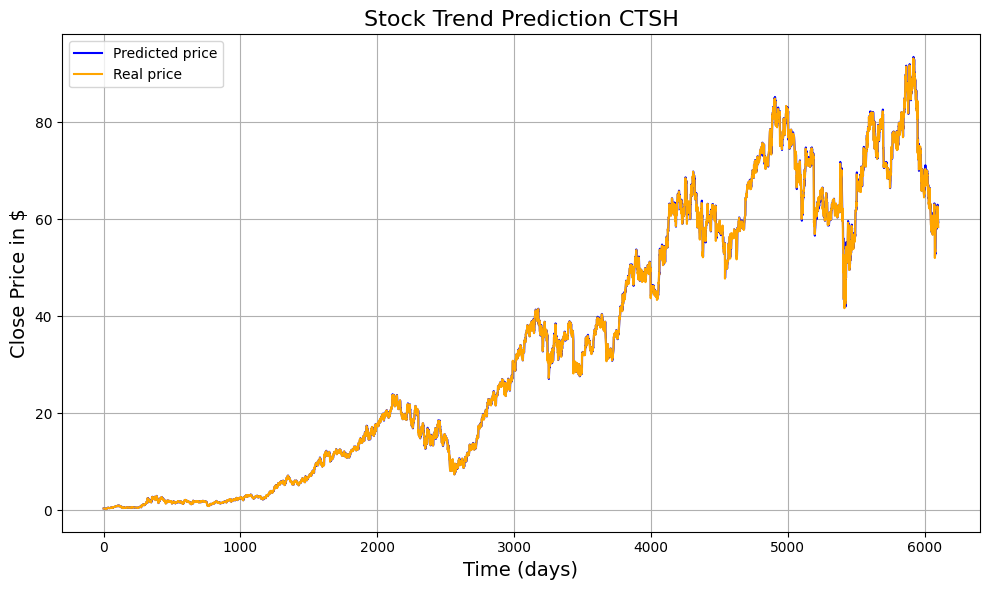

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.012376435451857912
(10717, 1) (10717, 1)


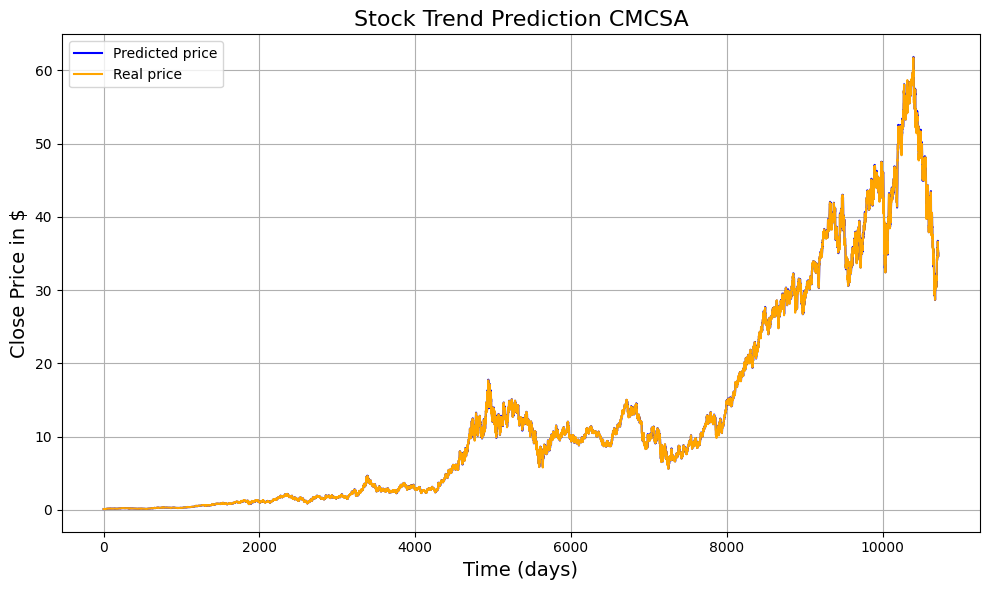

225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013284895843431371
(7176, 1) (7176, 1)


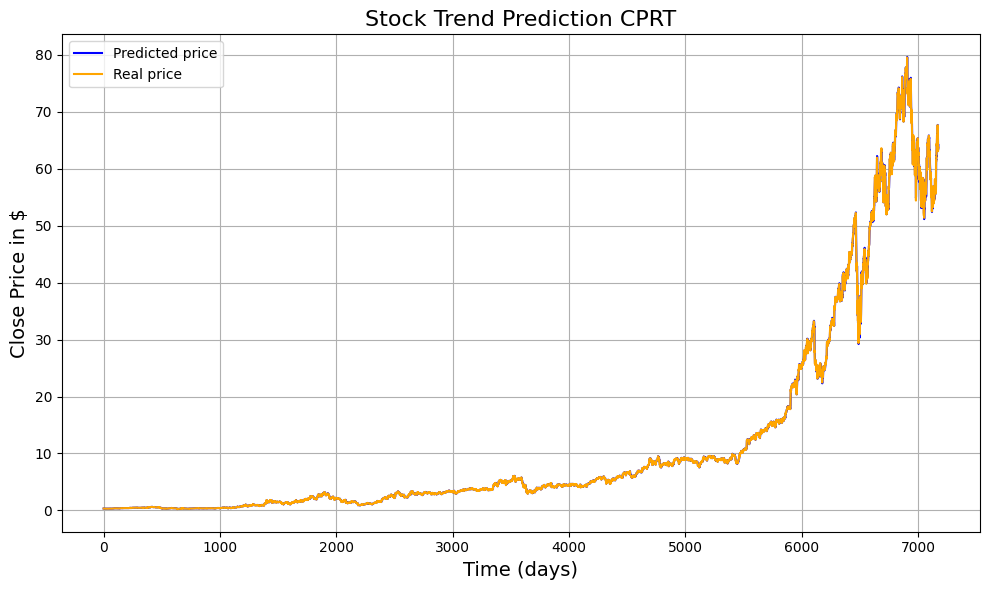

191/191 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01248850954852916
(6093, 1) (6093, 1)


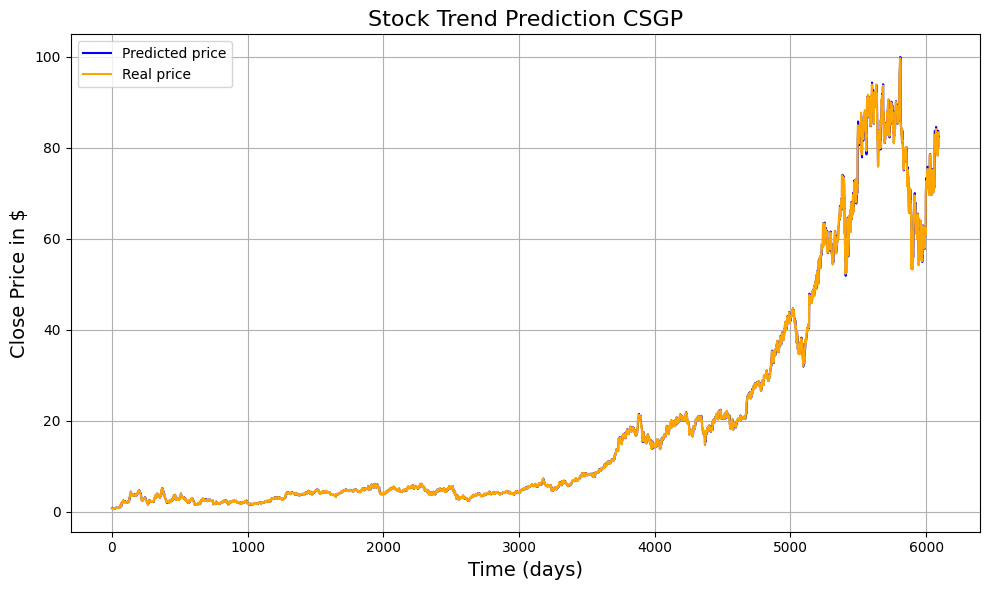

286/286 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.014024770865710566
(9122, 1) (9122, 1)


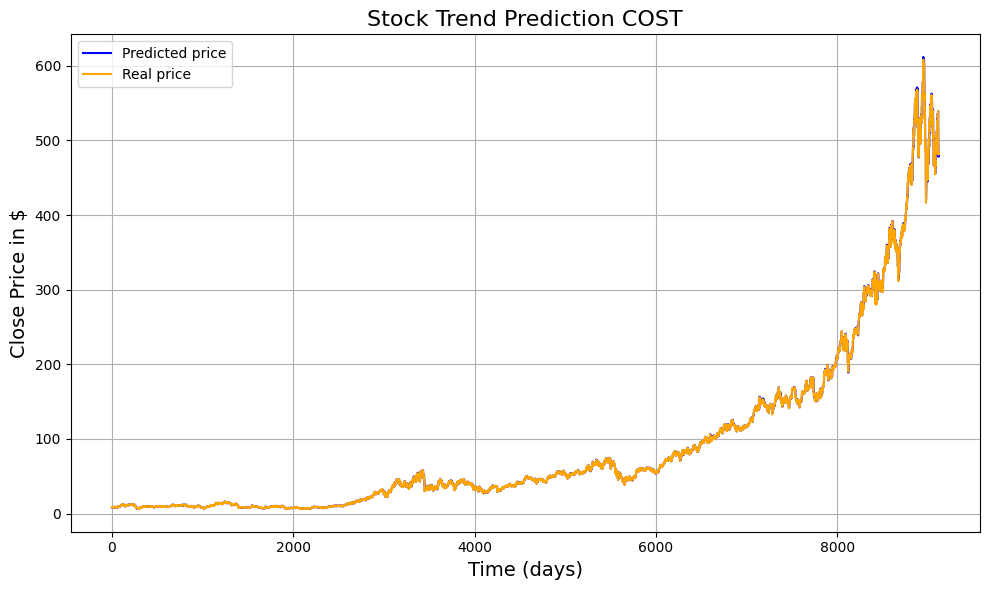

138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014107121538858656
(4387, 1) (4387, 1)


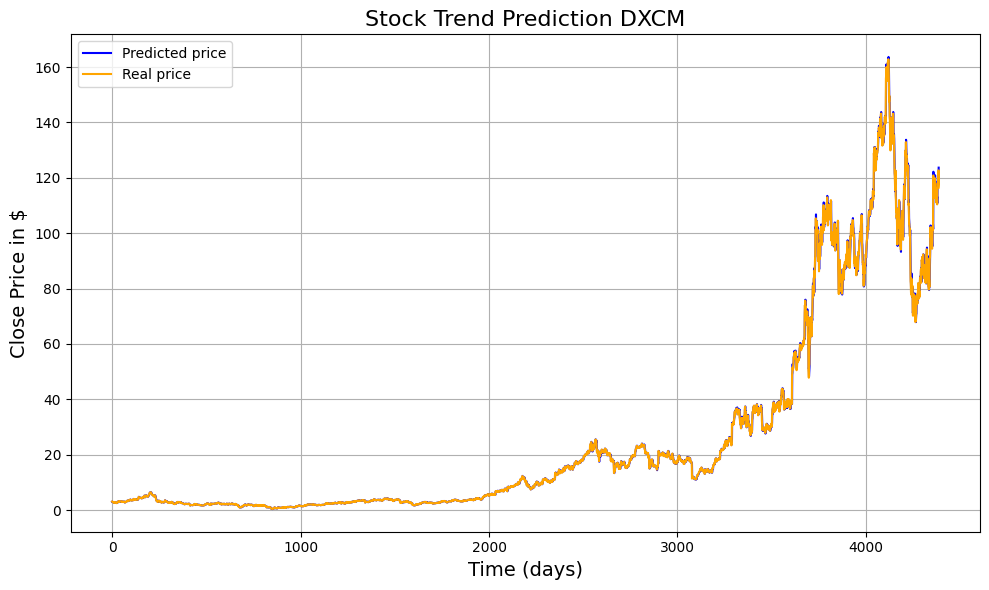

79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012617852992224924
(2497, 1) (2497, 1)


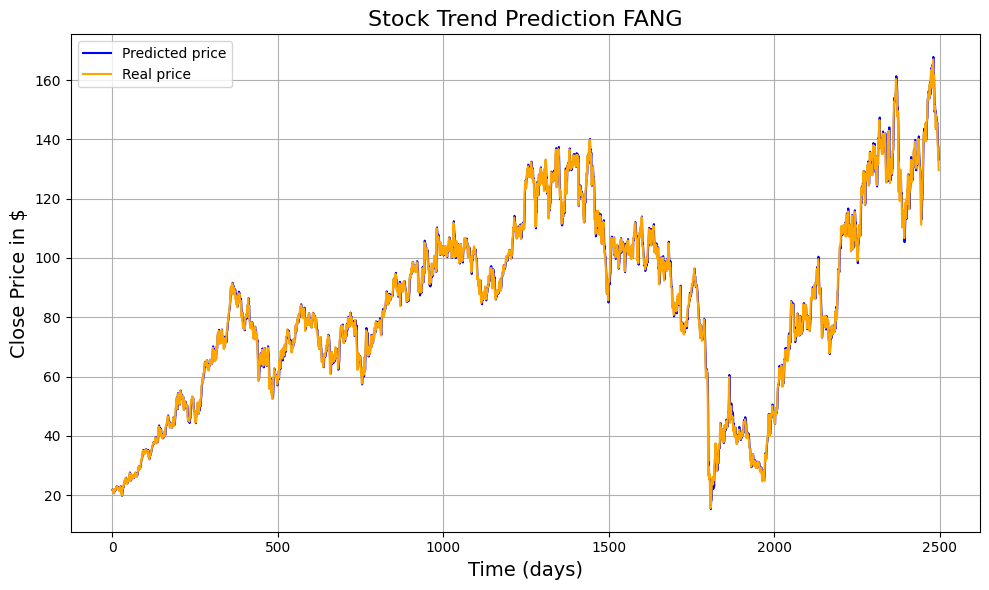

260/260 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014003051043954834
(8312, 1) (8312, 1)


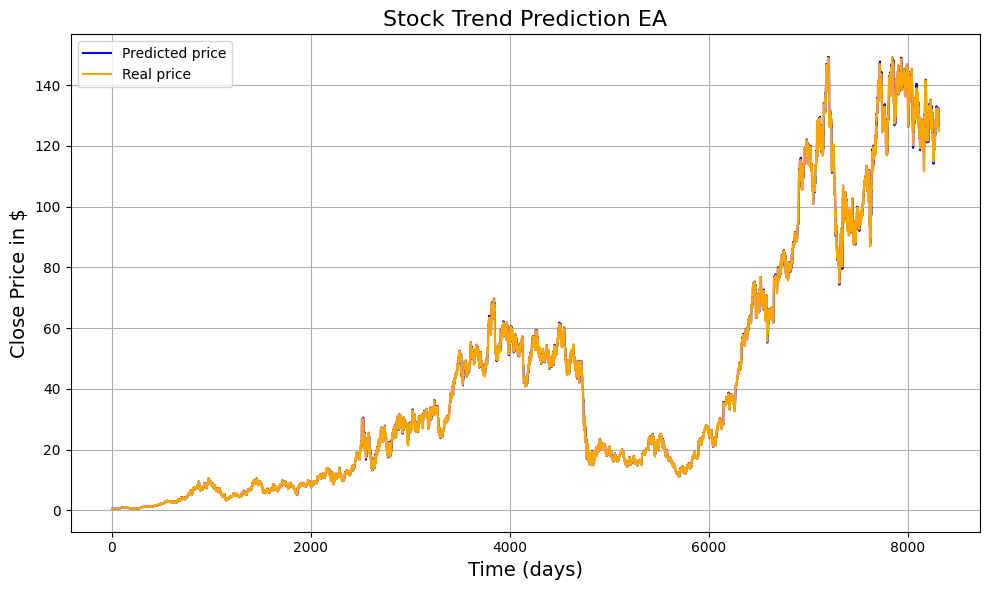

277/277 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013123726693302858
(8839, 1) (8839, 1)


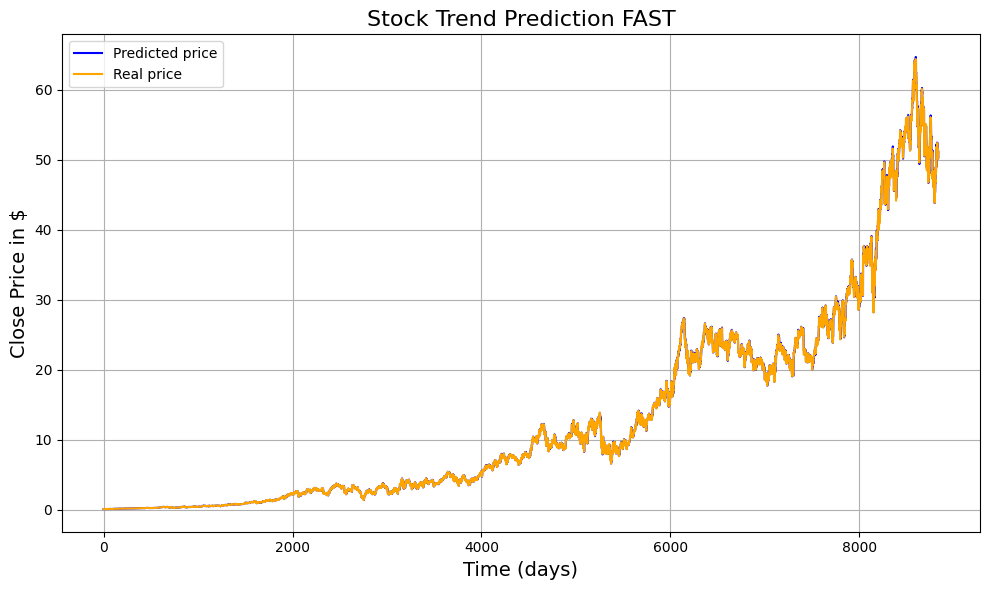

101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014016828542300588
(3228, 1) (3228, 1)


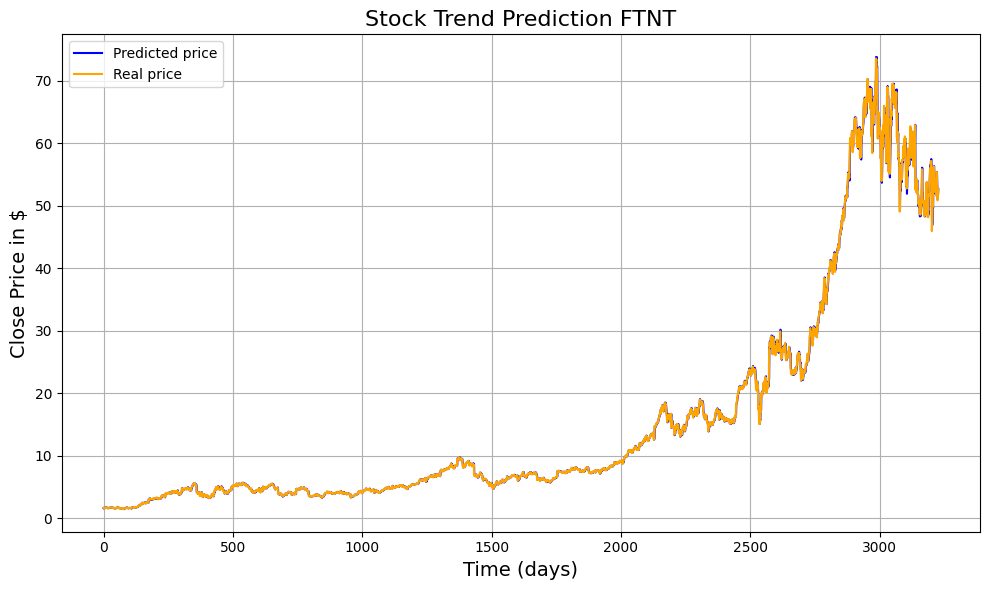

242/242 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.013682226709084437
(7721, 1) (7721, 1)


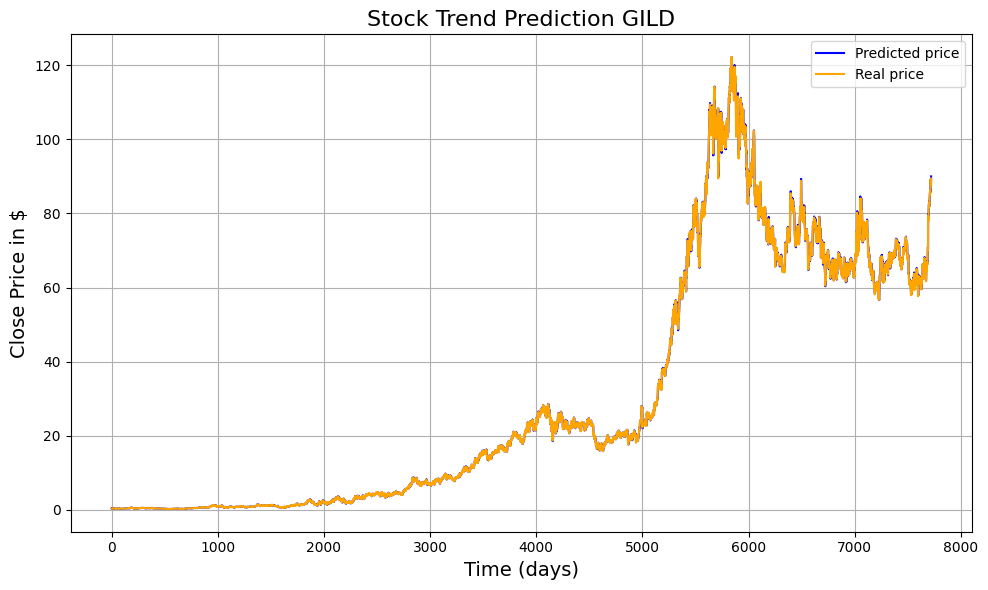

246/246 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.015156726447129143
(7869, 1) (7869, 1)


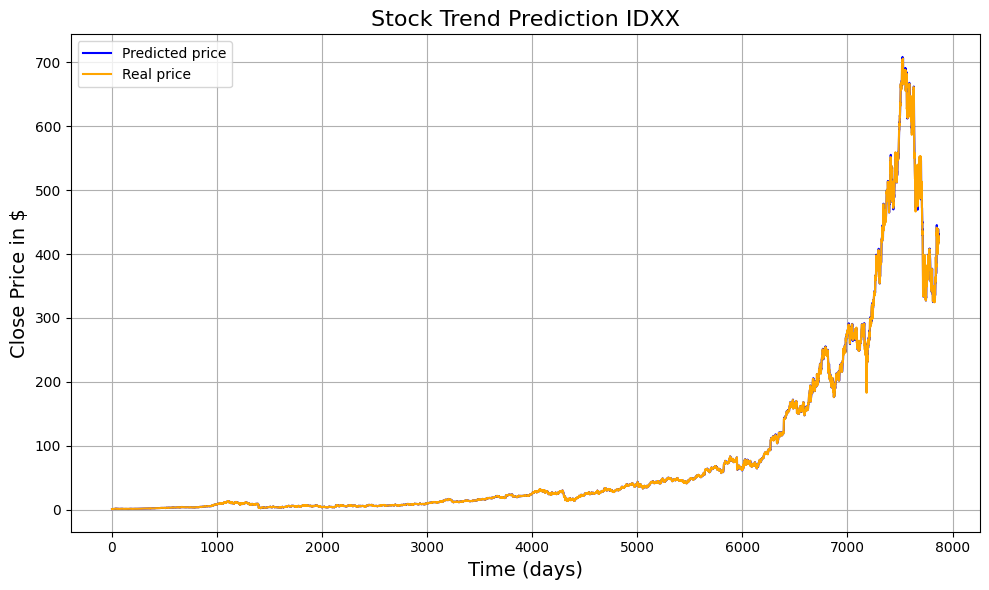

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012999021085954644
(5569, 1) (5569, 1)


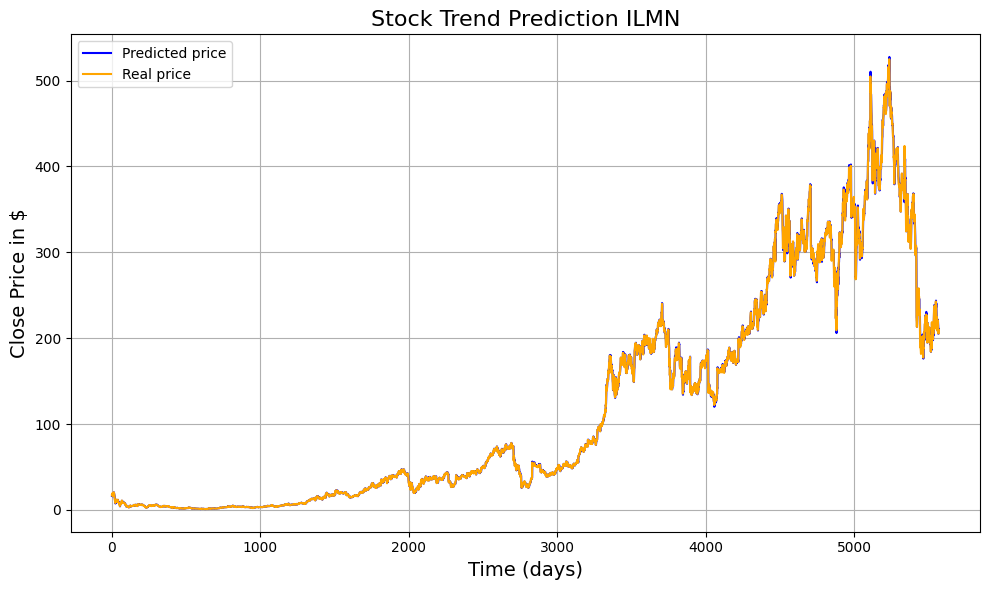

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.011765385886142959
(10717, 1) (10717, 1)


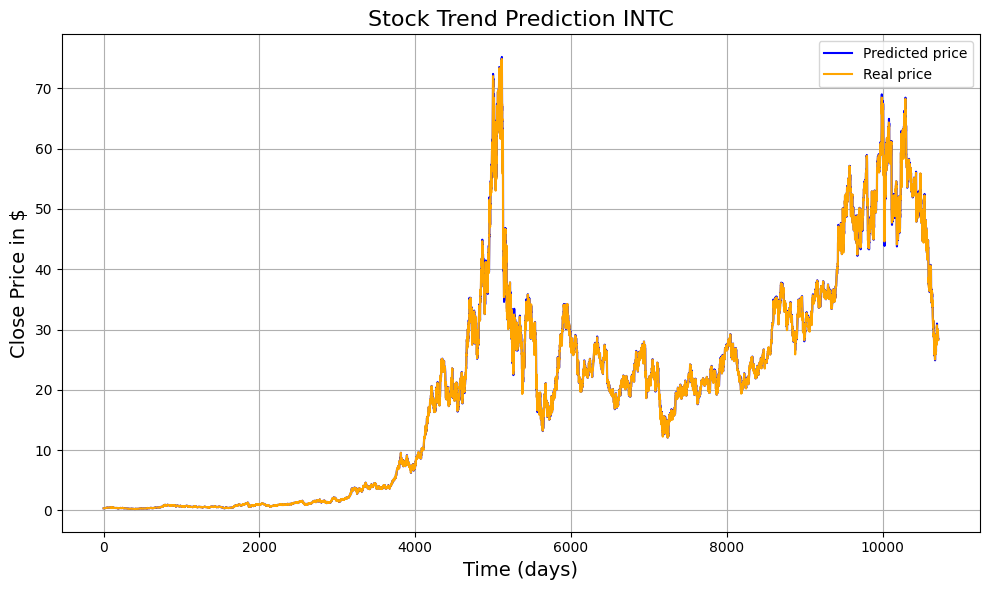

233/233 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014705546585117404
(7433, 1) (7433, 1)


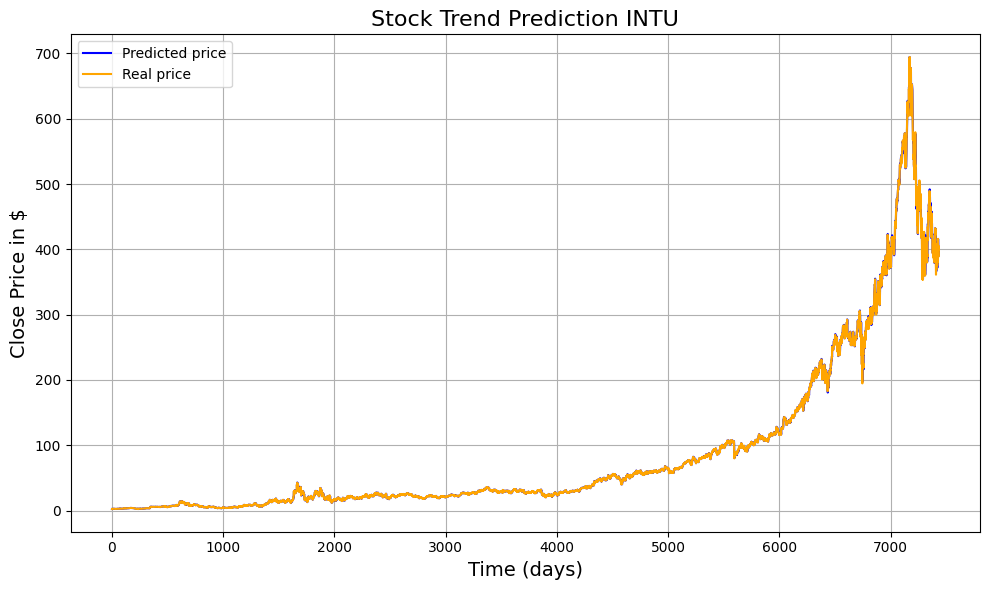

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.015489869452958412
(5598, 1) (5598, 1)


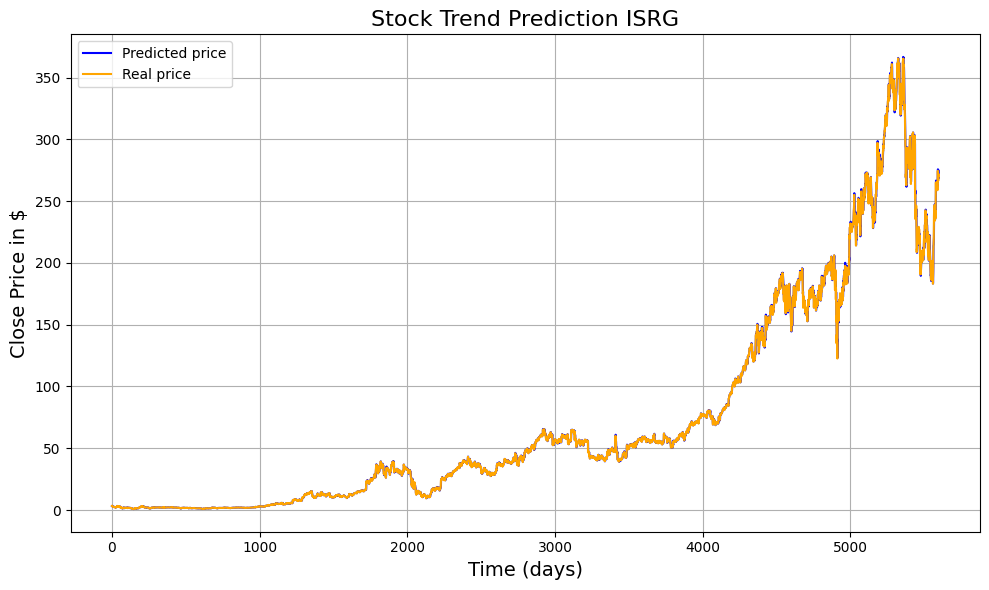

303/303 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.012935740668846292
(9672, 1) (9672, 1)


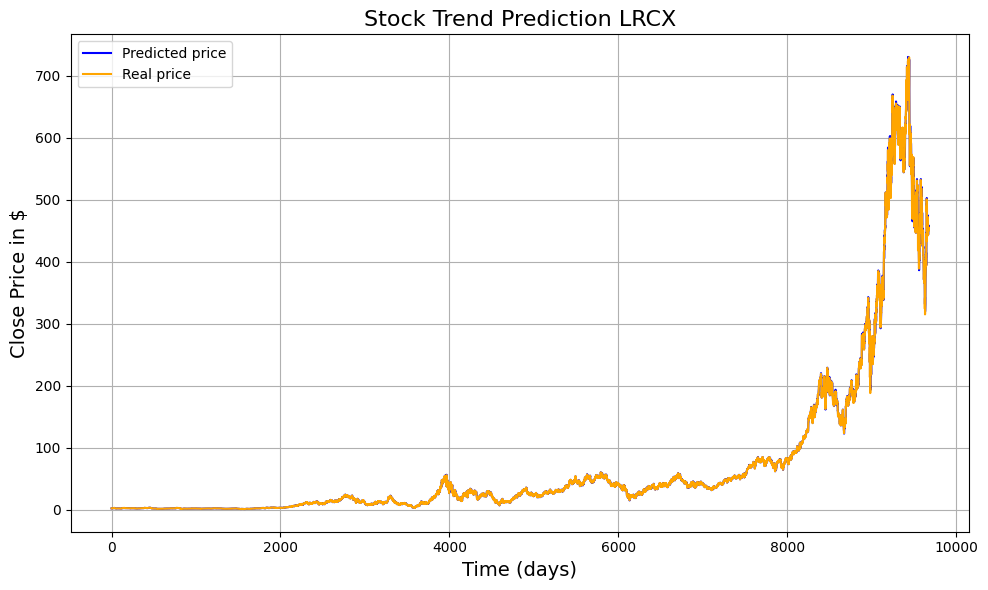

120/120 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012940409123393158
(3812, 1) (3812, 1)


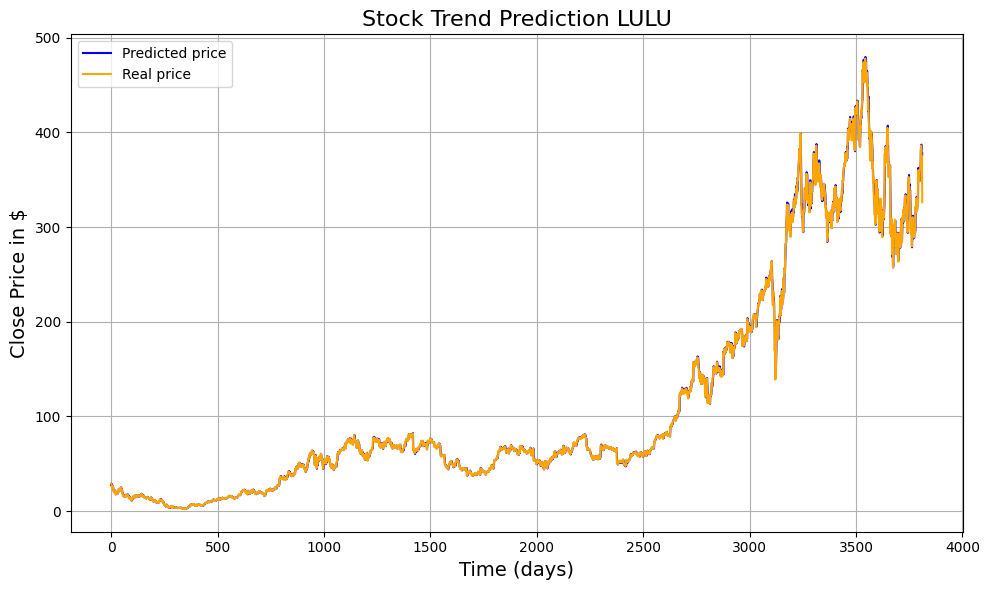

193/193 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012345105003099344
(6163, 1) (6163, 1)


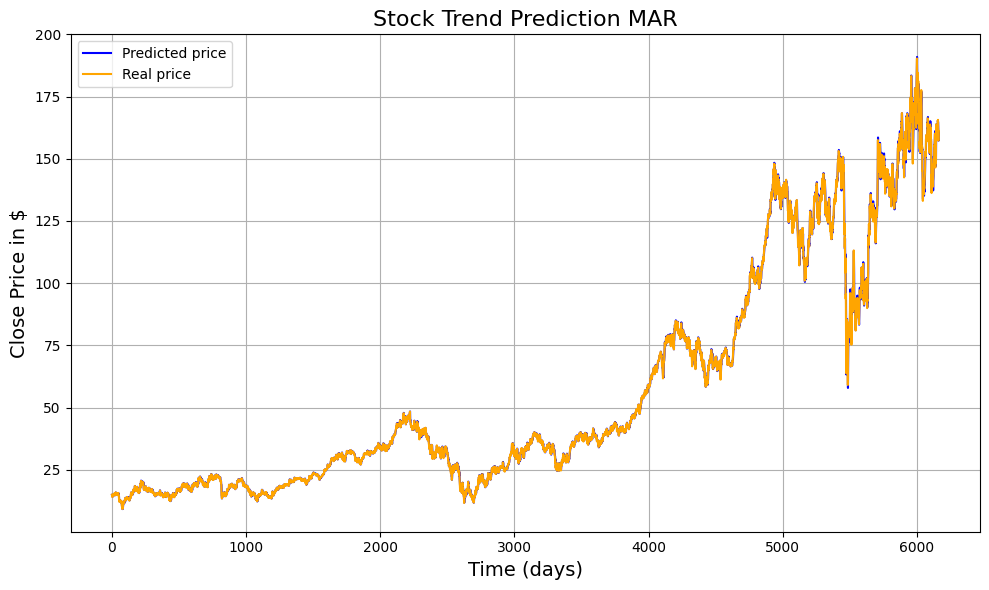

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.011988216782819546
(5588, 1) (5588, 1)


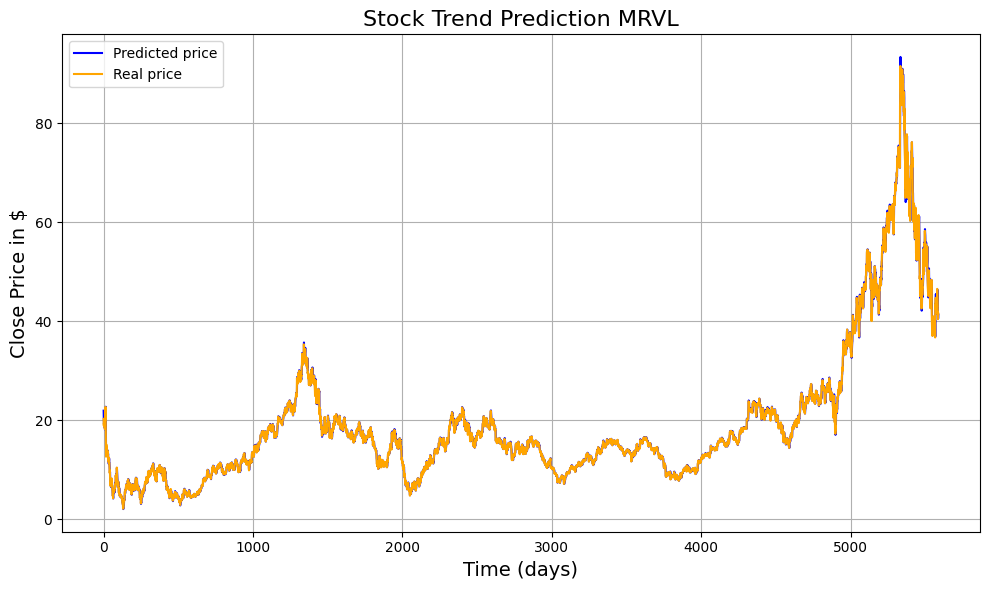

119/119 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.011698259007346867
(3802, 1) (3802, 1)


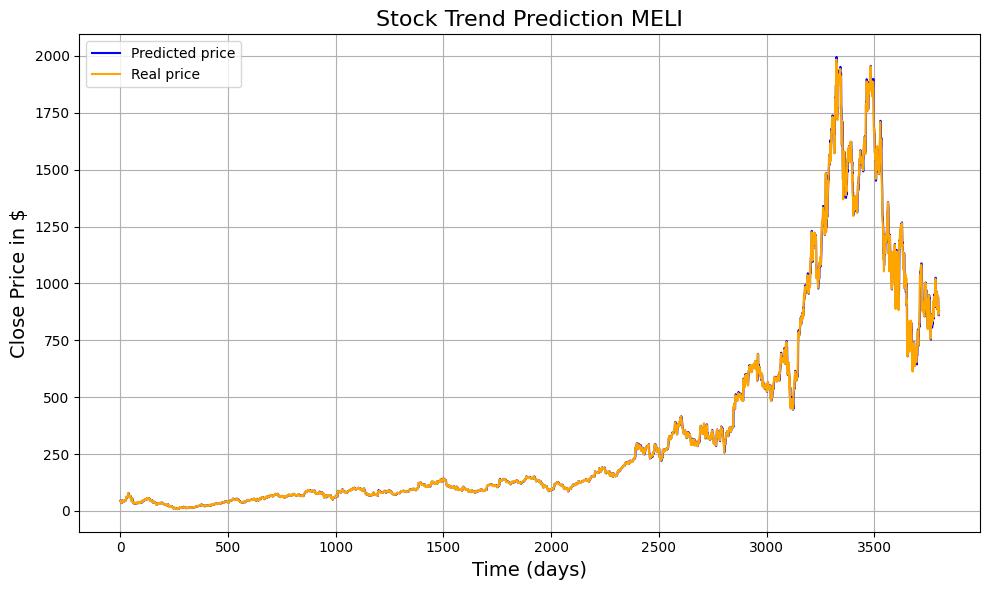

233/233 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014140560267893147
(7428, 1) (7428, 1)


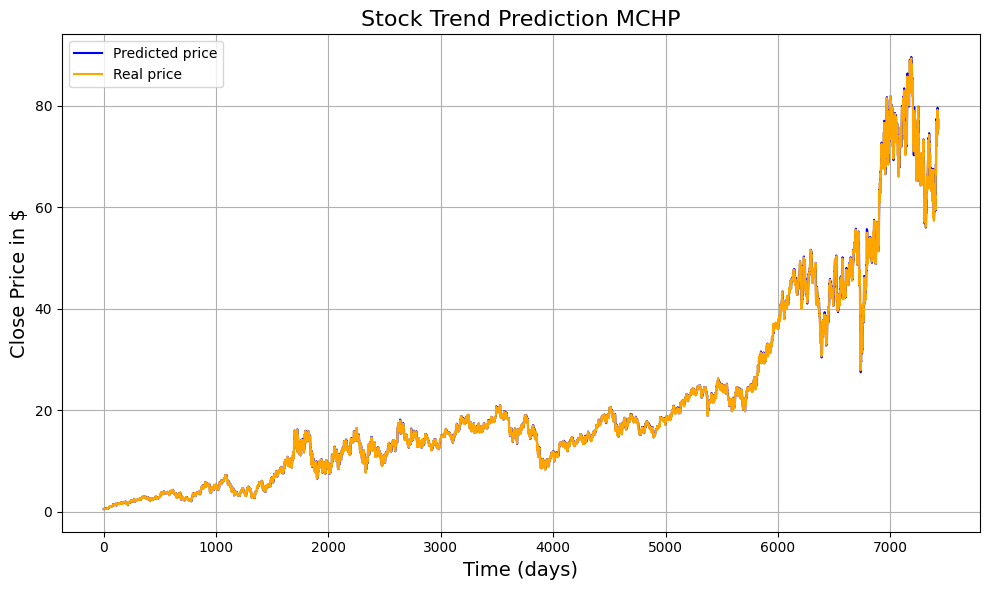

302/302 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.010744940191865827
(9652, 1) (9652, 1)


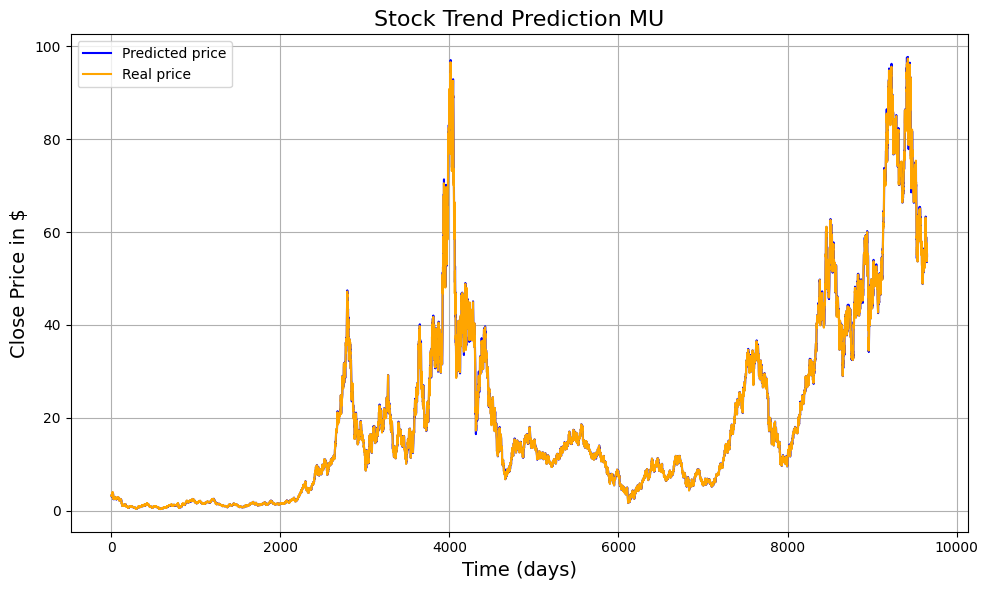

288/288 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013007347648520299
(9203, 1) (9203, 1)


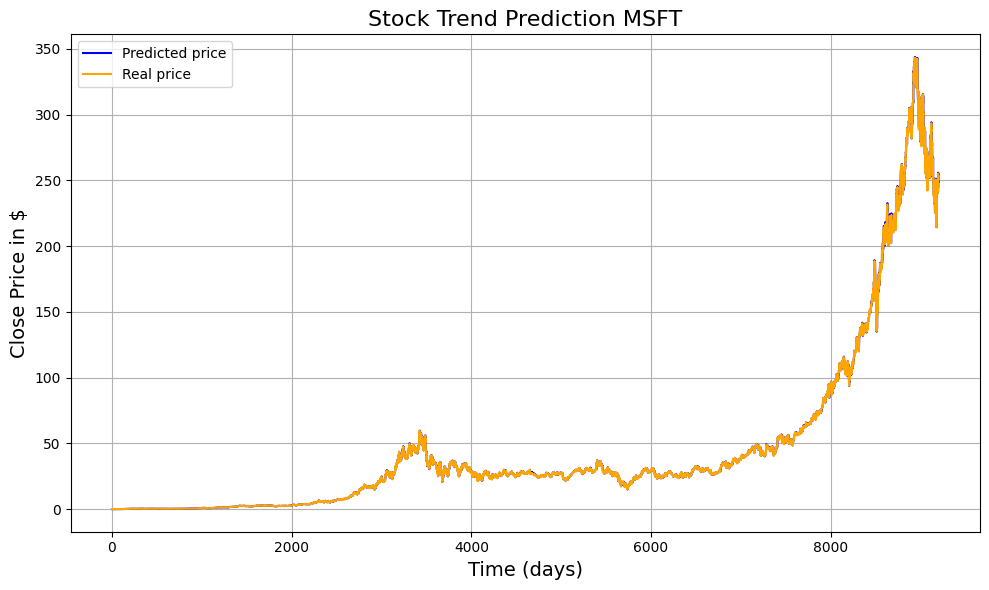

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01691960224816942
(5349, 1) (5349, 1)


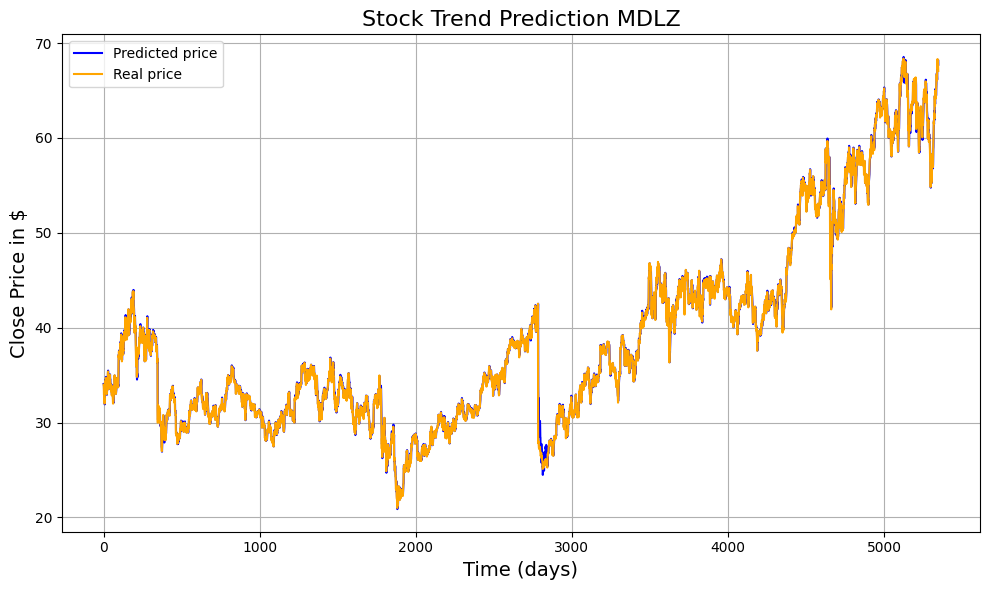

290/290 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020431681035448134
(9268, 1) (9268, 1)


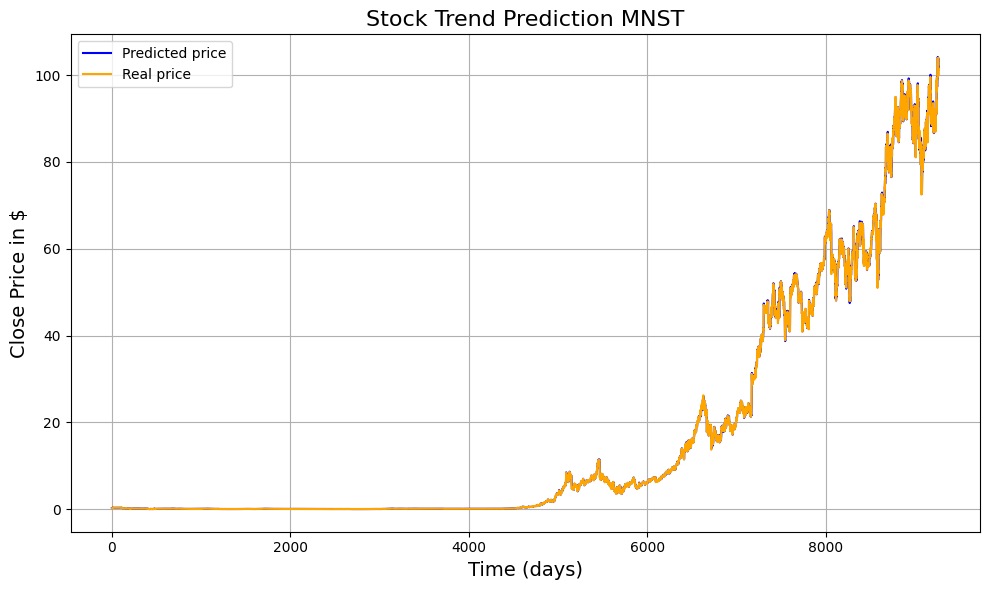

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013694805023620311
(5115, 1) (5115, 1)


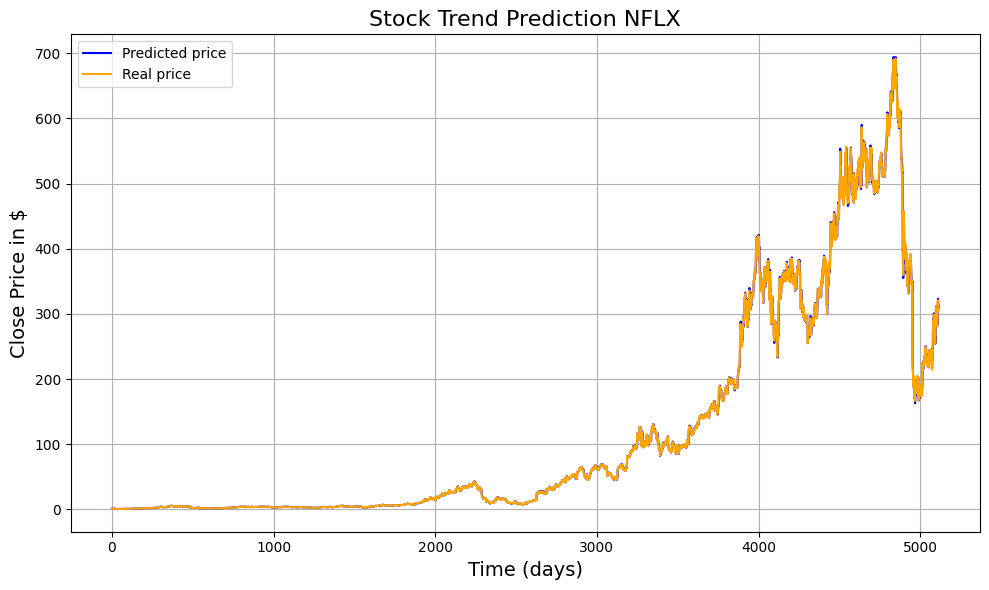

186/186 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.011877807933937553
(5952, 1) (5952, 1)


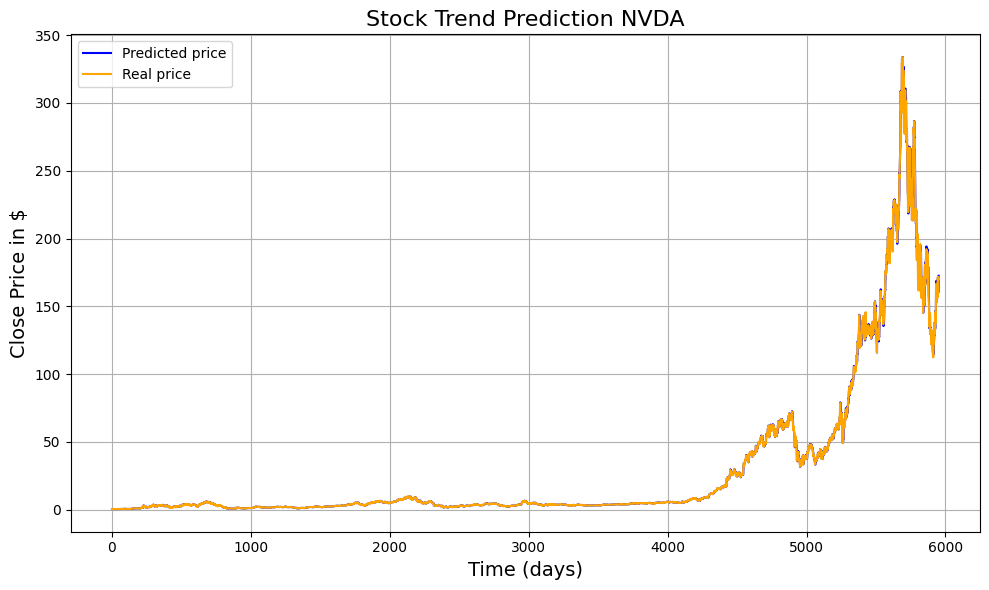

96/96 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012807207308492193
(3049, 1) (3049, 1)


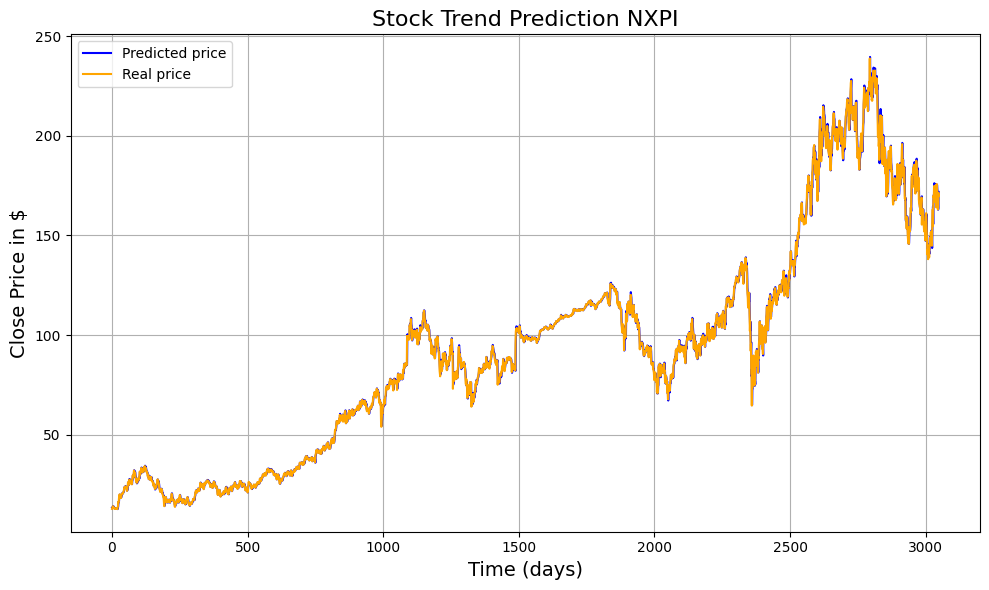

232/232 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014257211346396964
(7404, 1) (7404, 1)


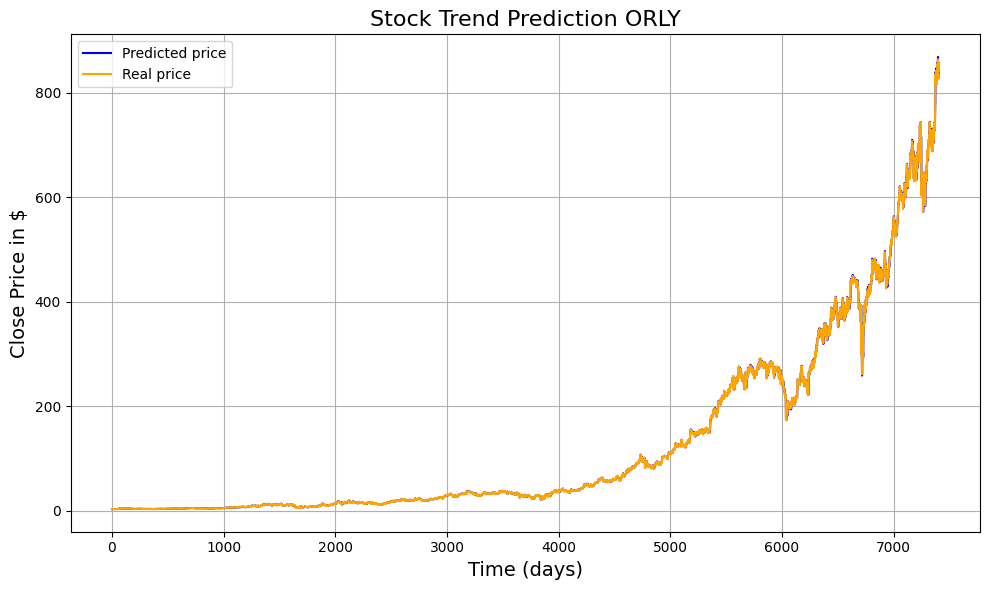

244/244 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018510753461401776
(7782, 1) (7782, 1)


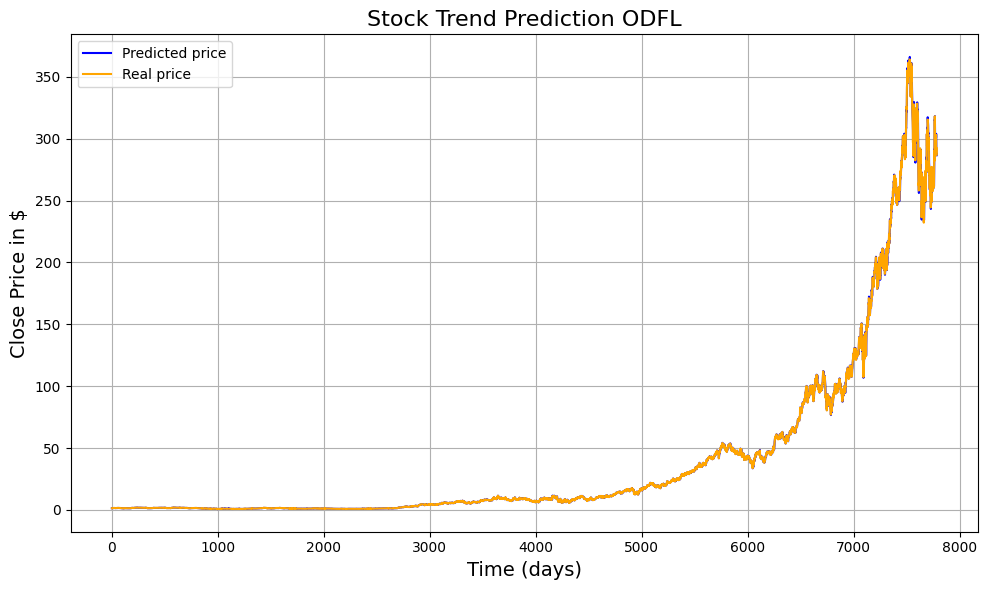

176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01191785455054399
(5630, 1) (5630, 1)


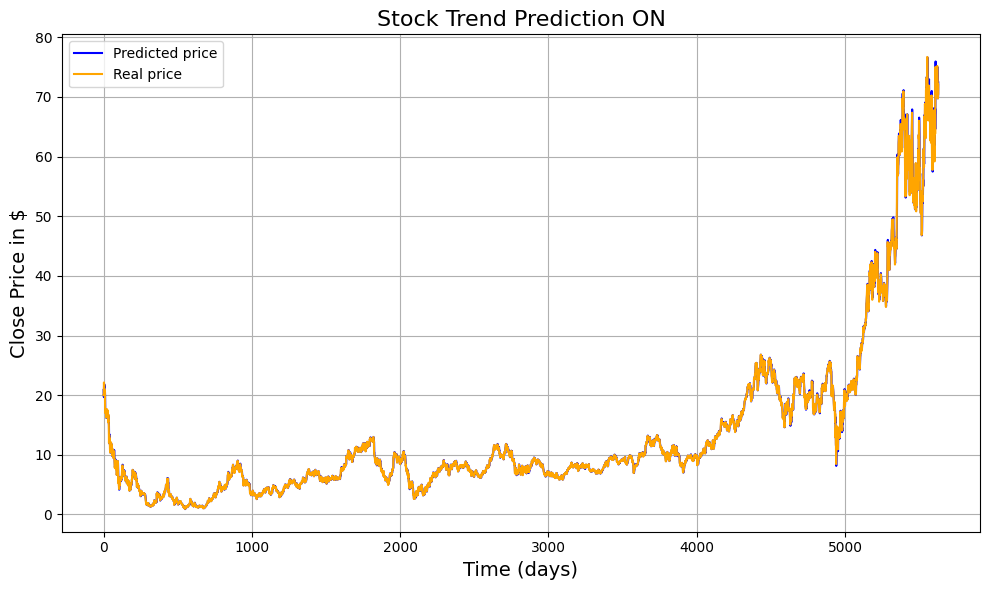

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.012827388141984827
(10717, 1) (10717, 1)


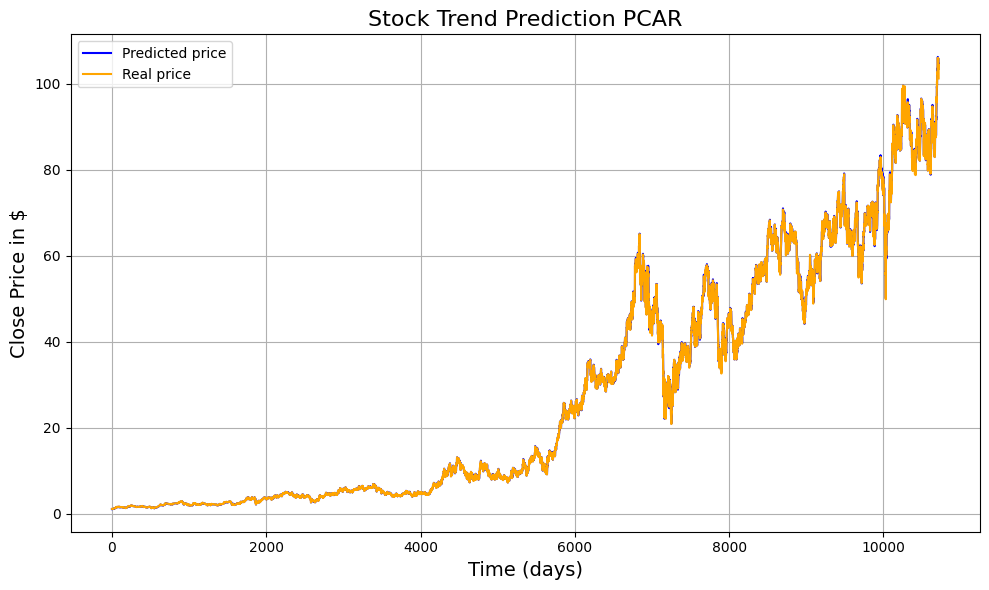

308/308 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013331644904748764
(9845, 1) (9845, 1)


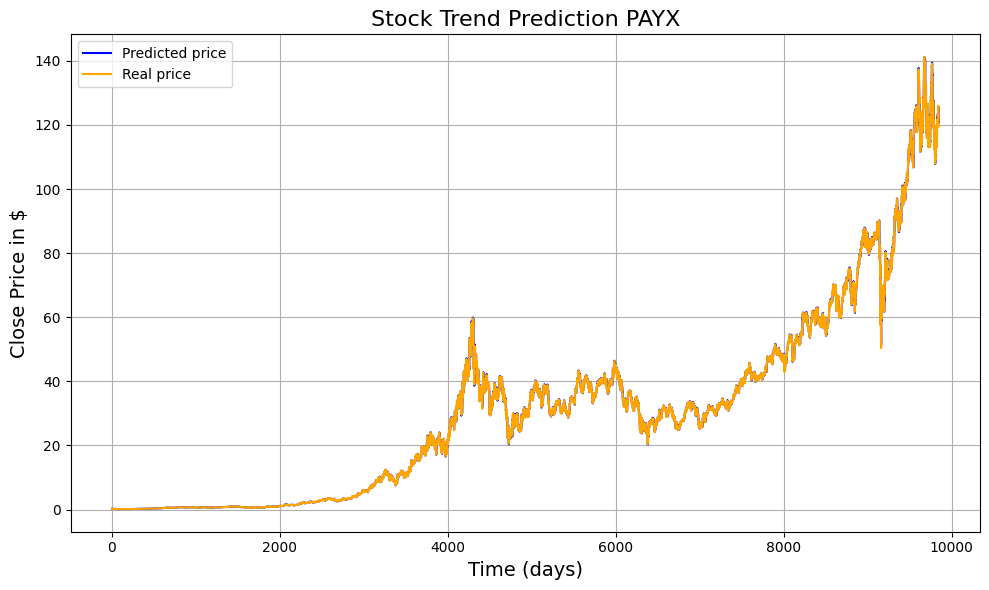

243/243 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013637445077502018
(7747, 1) (7747, 1)


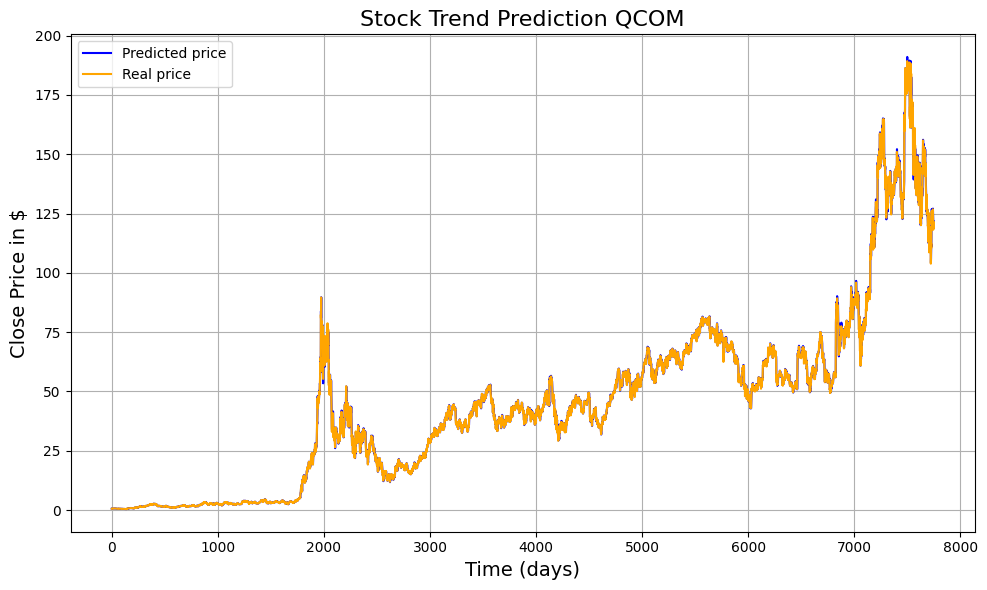

248/248 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014007264322575121
(7926, 1) (7926, 1)


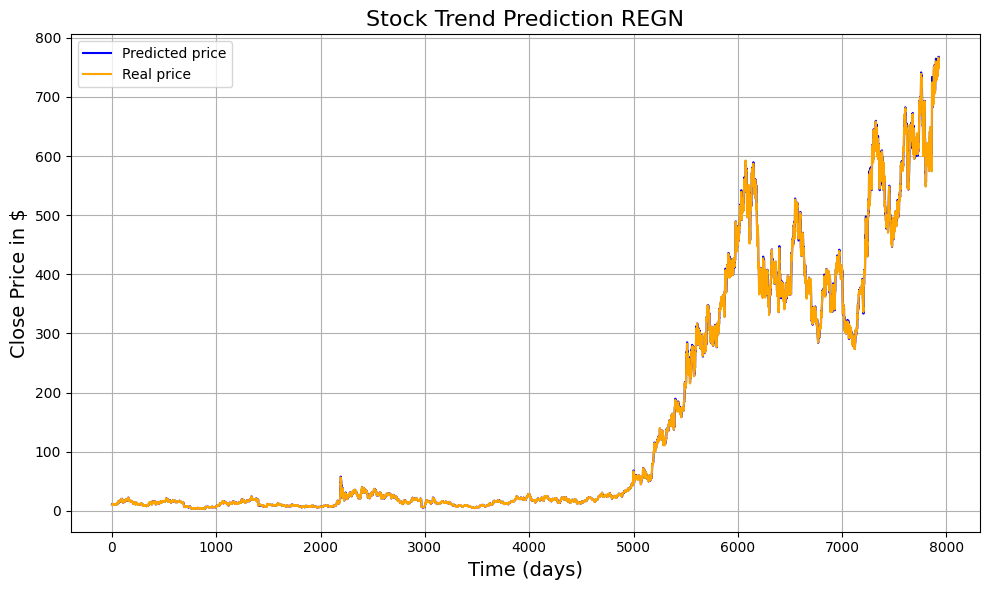

293/293 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
MSE on the test set:  0.012362378308371764
(9352, 1) (9352, 1)


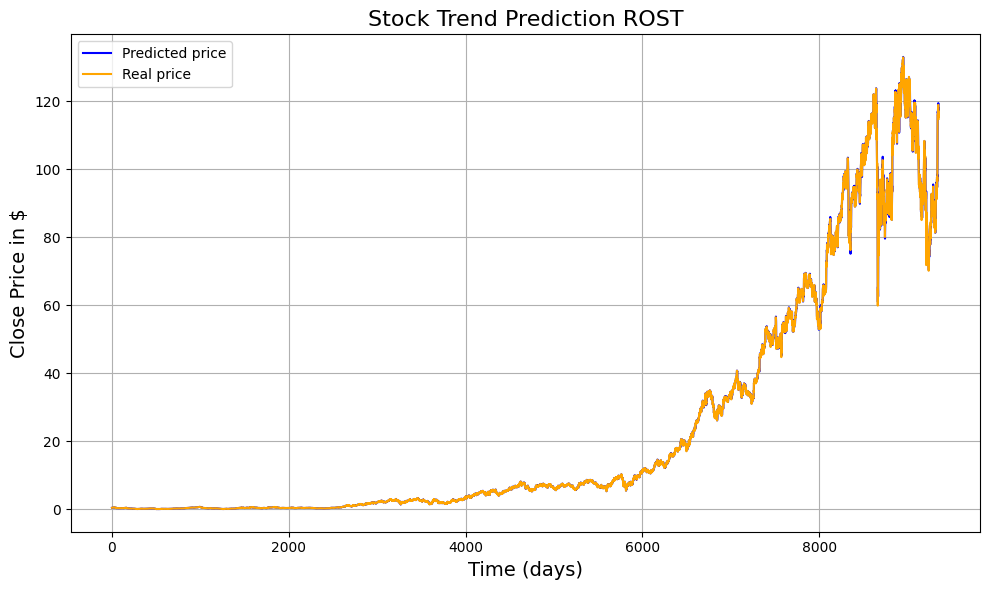

238/238 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.012655602302515273
(7612, 1) (7612, 1)


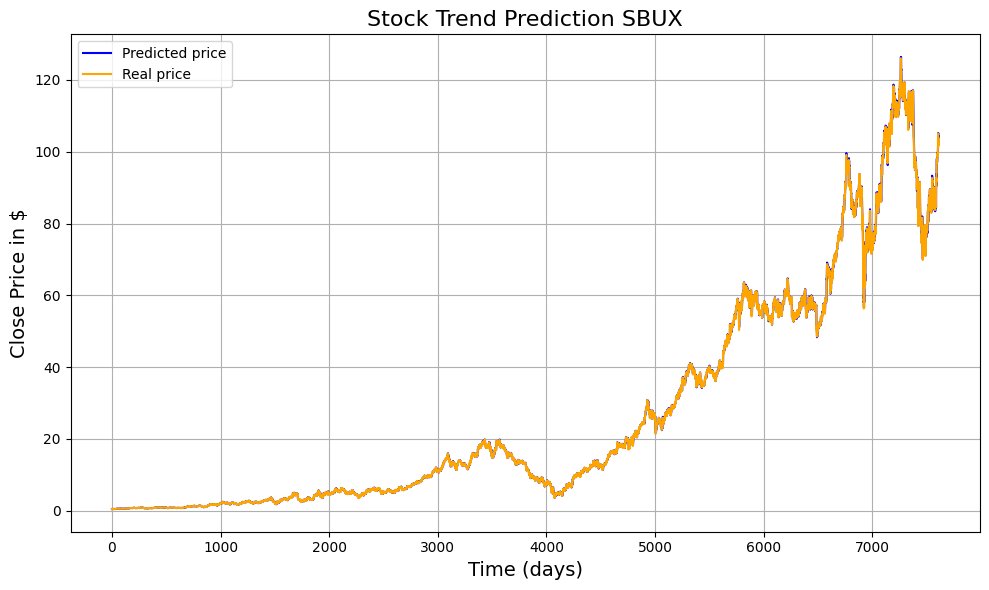

122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01507310928636157
(3895, 1) (3895, 1)


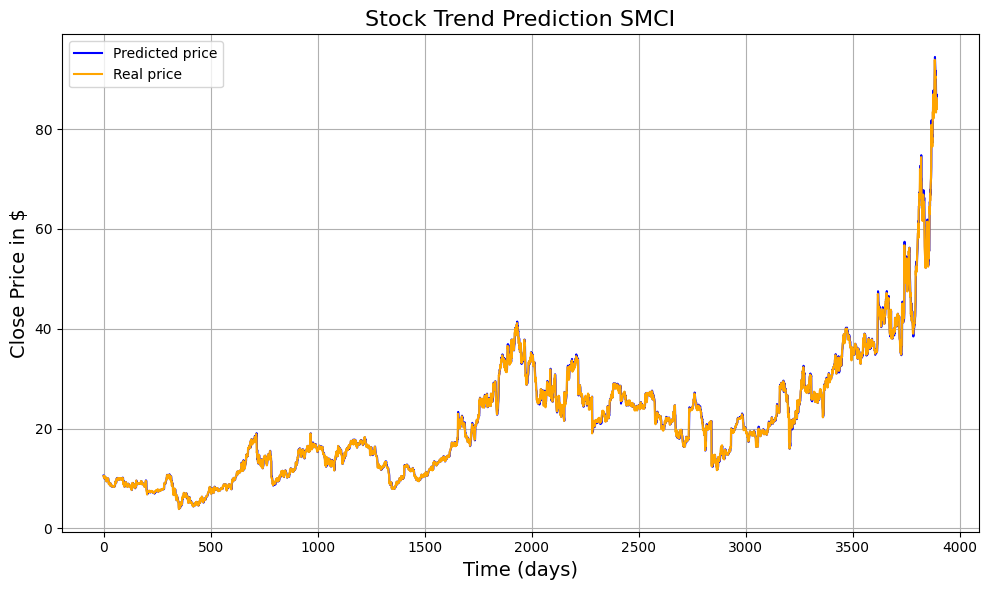

241/241 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.013845884550752316
(7697, 1) (7697, 1)


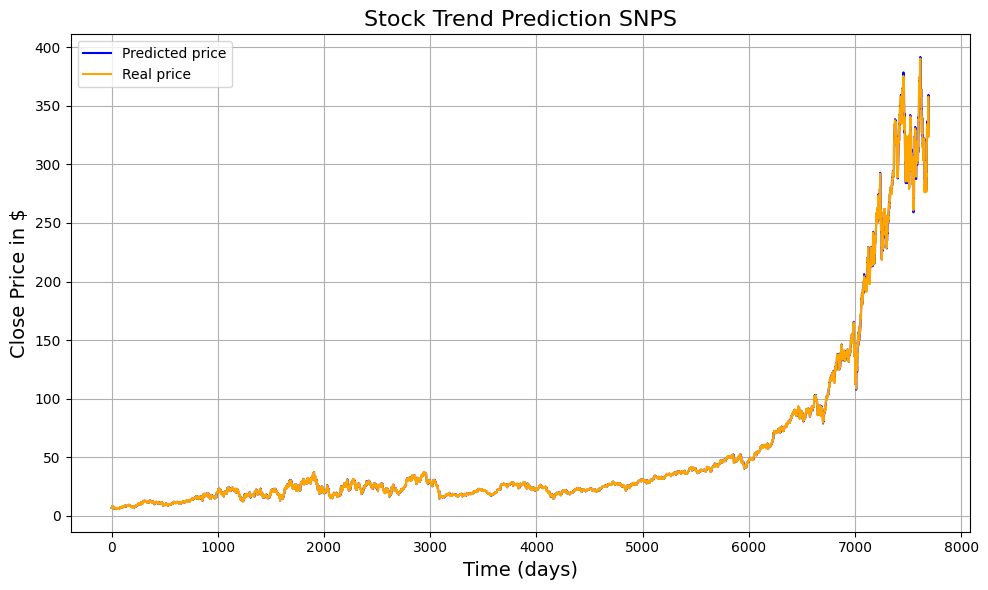

397/397 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
MSE on the test set:  0.011627149593718283
(12683, 1) (12683, 1)


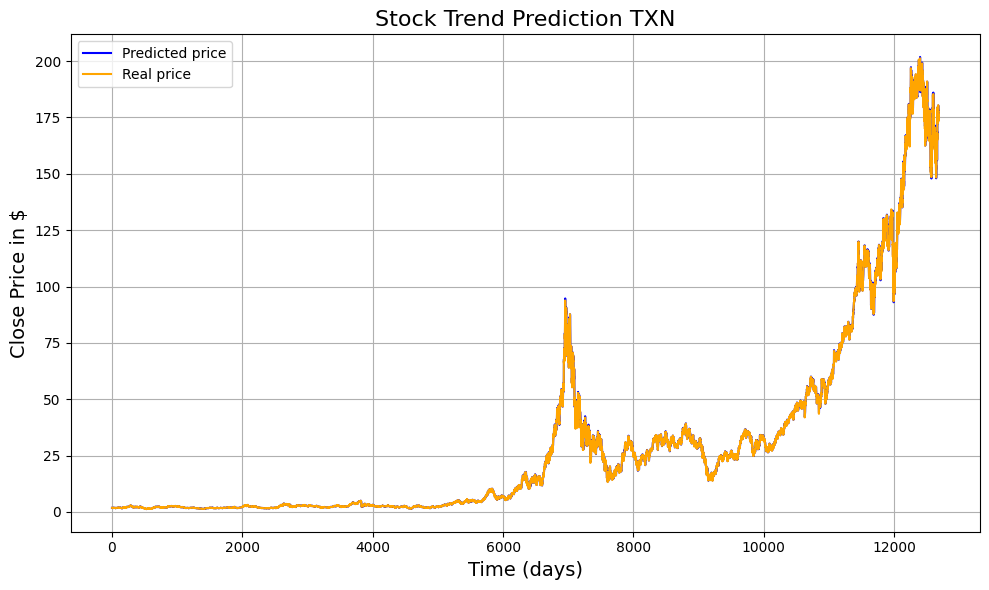

102/102 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.014900516496865041
(3258, 1) (3258, 1)


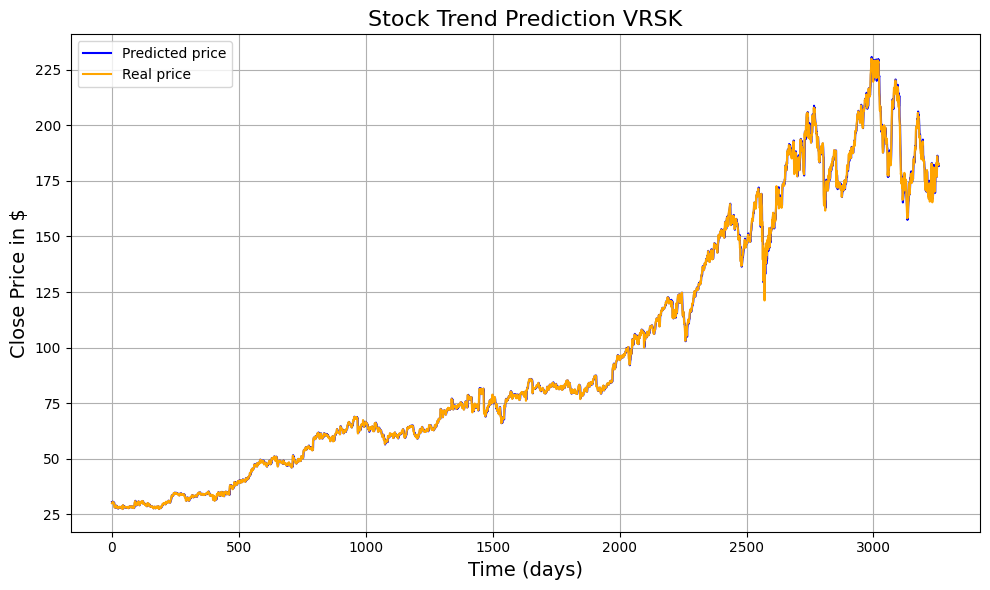

246/246 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01642800295765835
(7847, 1) (7847, 1)


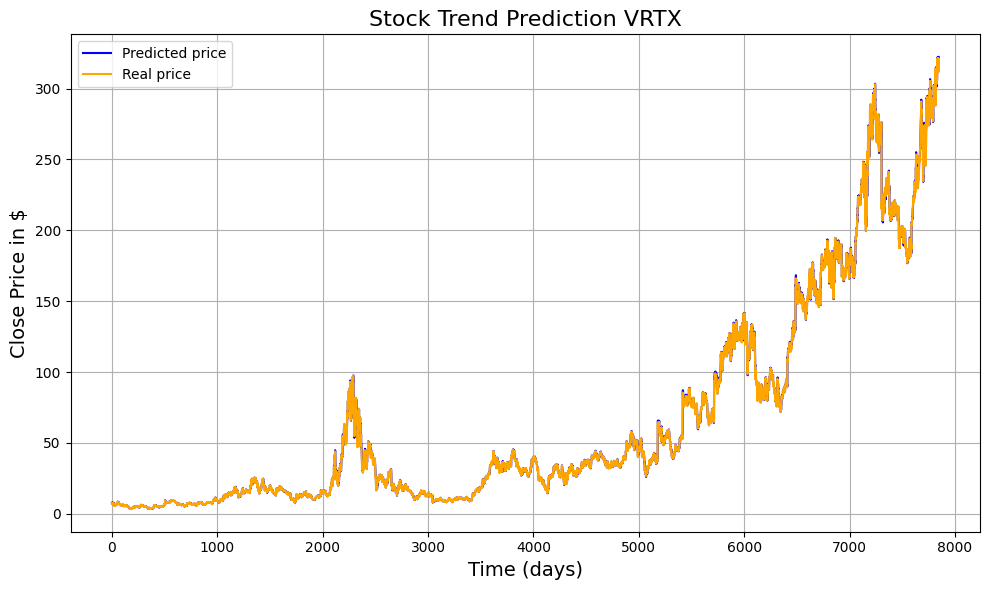

In [44]:
# Load model
conv1d_test_2 = tf.keras.models.load_model('1dcnn_day.keras')

# Load all data first
(all_X_data, all_y_data, 
all_X_data_norm, all_y_data_norm, 
all_X_data_norm_t, all_y_data_norm_t, 
all_feature_choice_indices) = load_all_data(
    nasqad100, 
    features, 
    window_size=window_size, 
    k_days=1, 
    feature_choice='Close', 
    type=1
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        conv1d_test_2, 
        all_X_data_norm_t[stock], 
        all_y_data_norm[stock], 
        all_X_data[stock], 
        all_y_data[stock], 
        all_feature_choice_indices[stock], 
        stock
    ) 

#### LSTM

285/285 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.01268459303538451


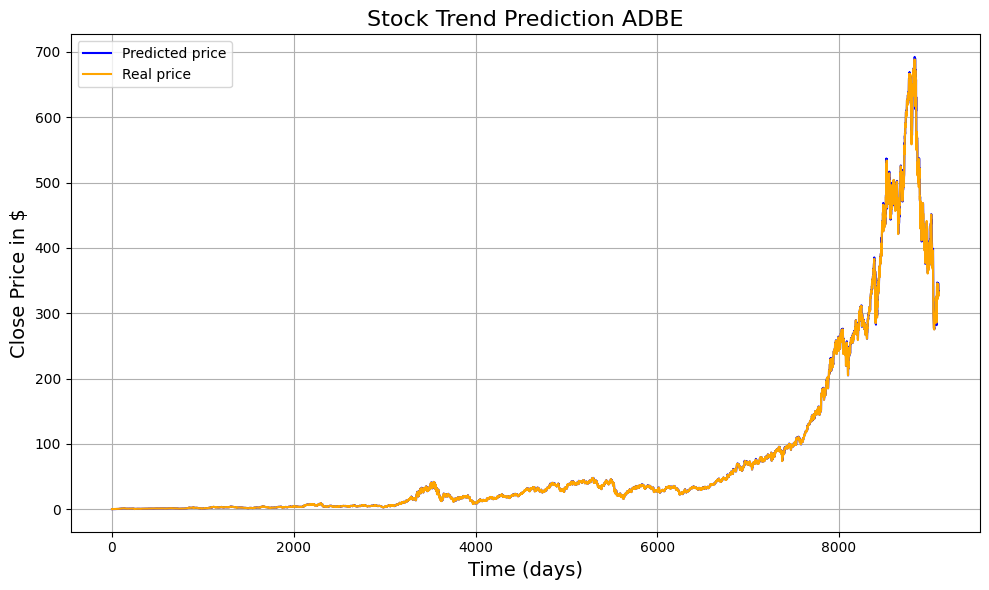

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.011077098579954436


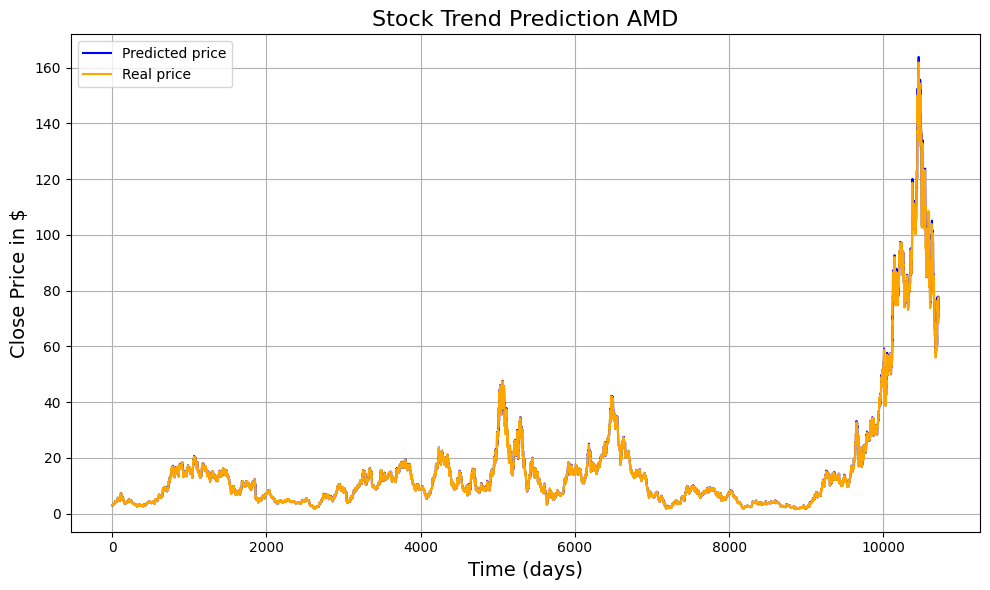

200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.013156753070932814


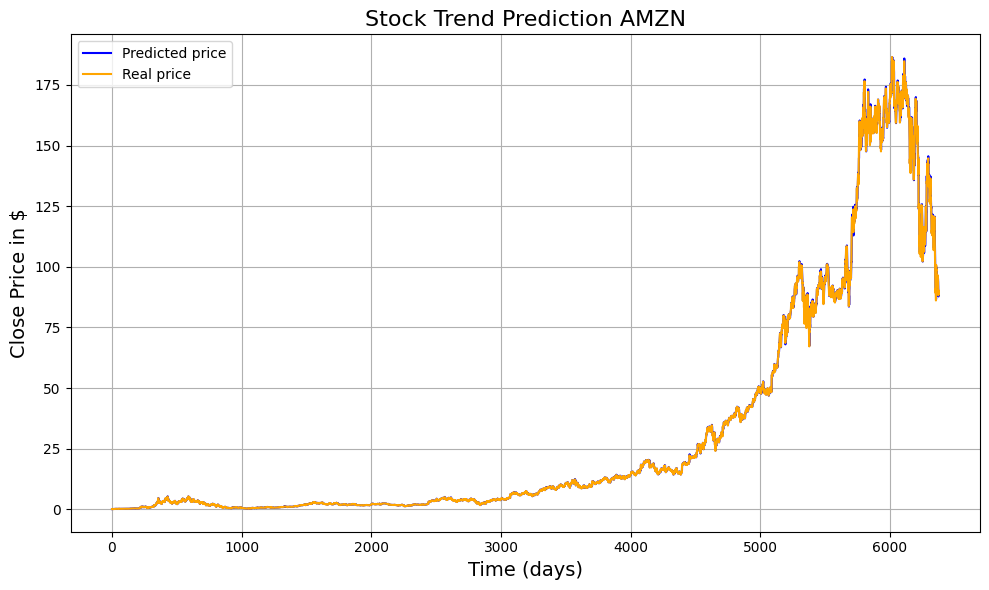

310/310 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.012230956709057586


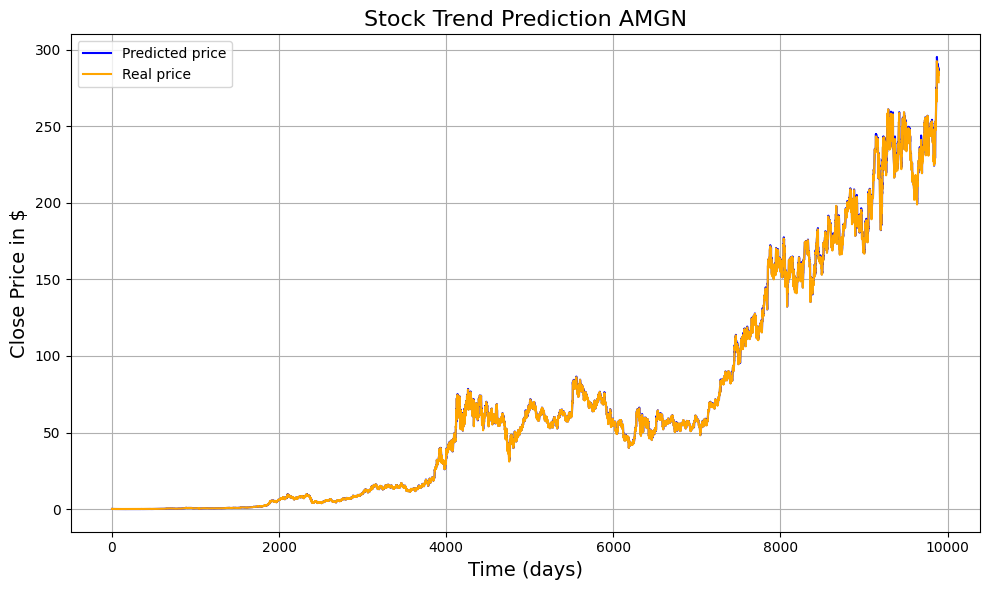

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013185570867214903


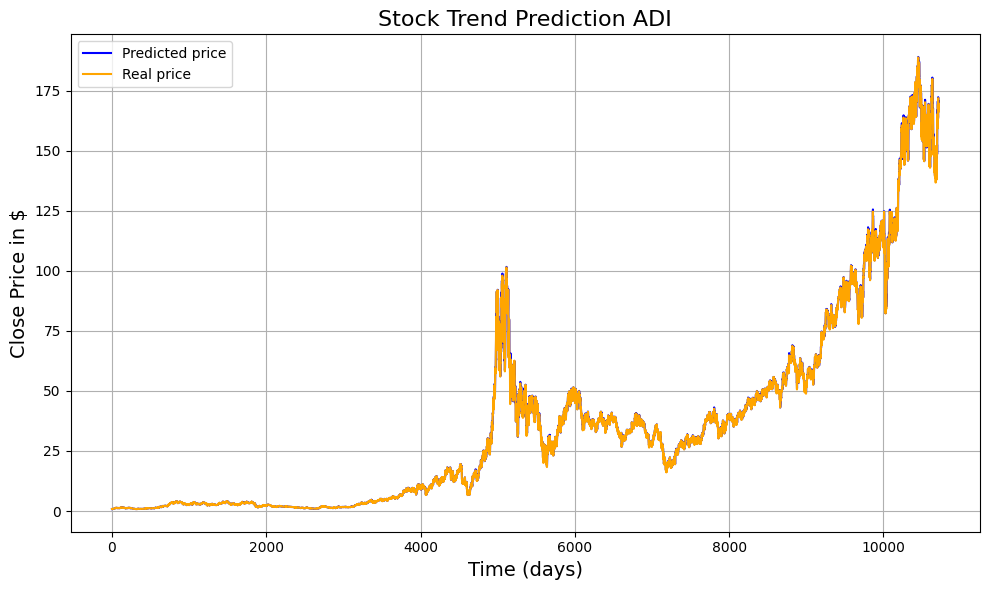

330/330 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.010761416609021556


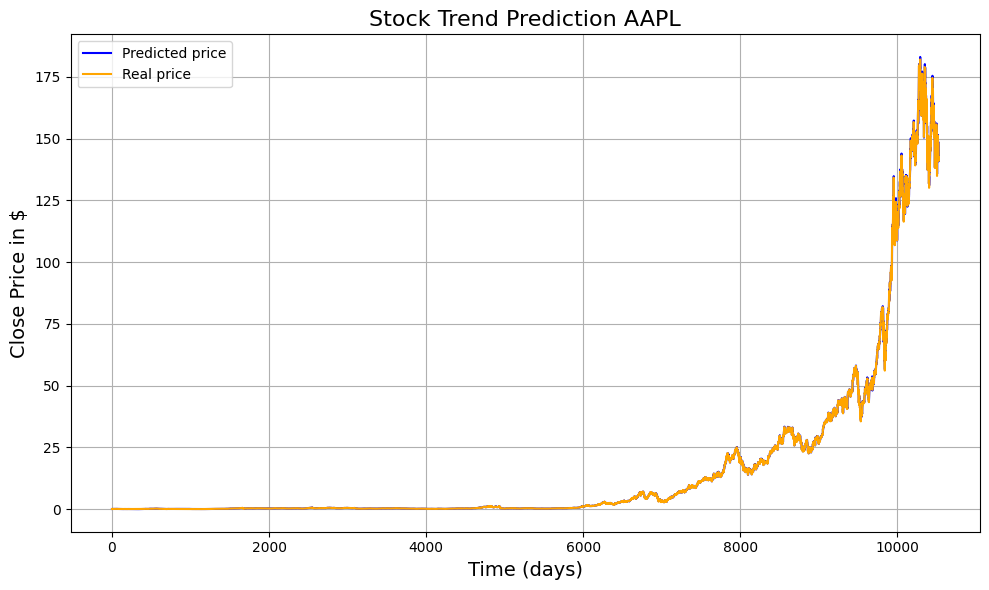

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.011432863623222479


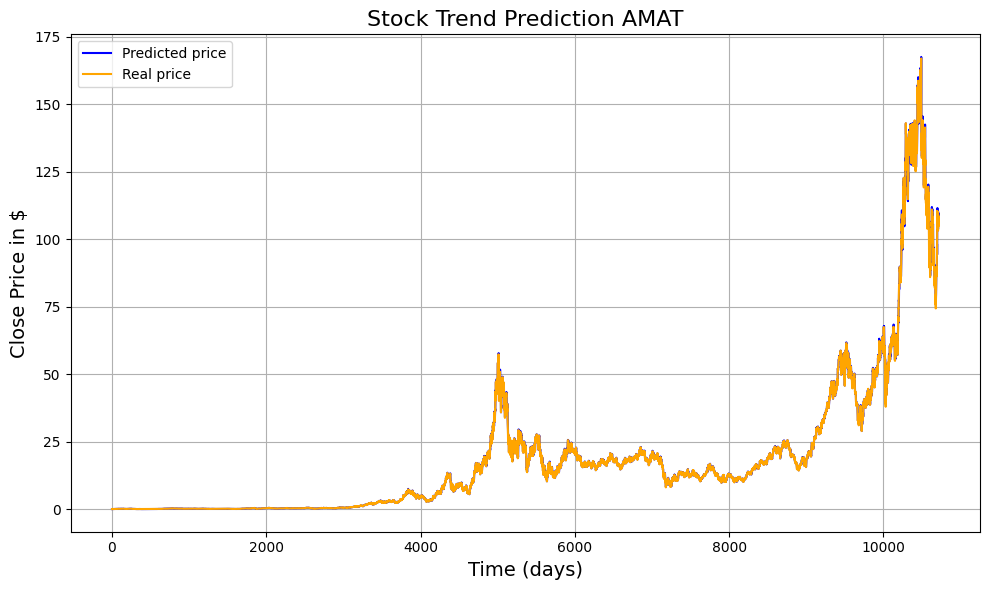

217/217 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.011618707565742072


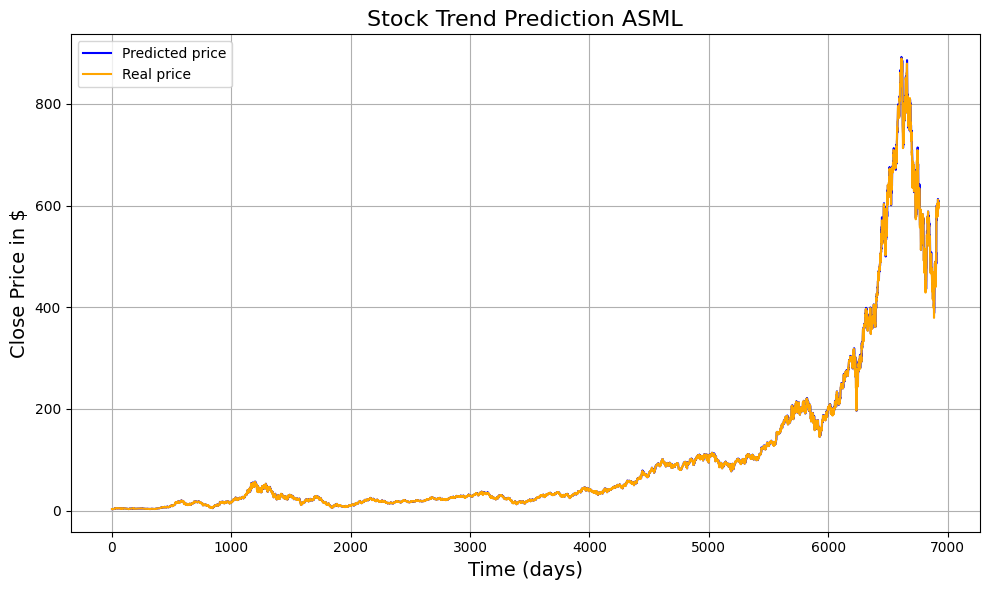

294/294 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.01238091056498254


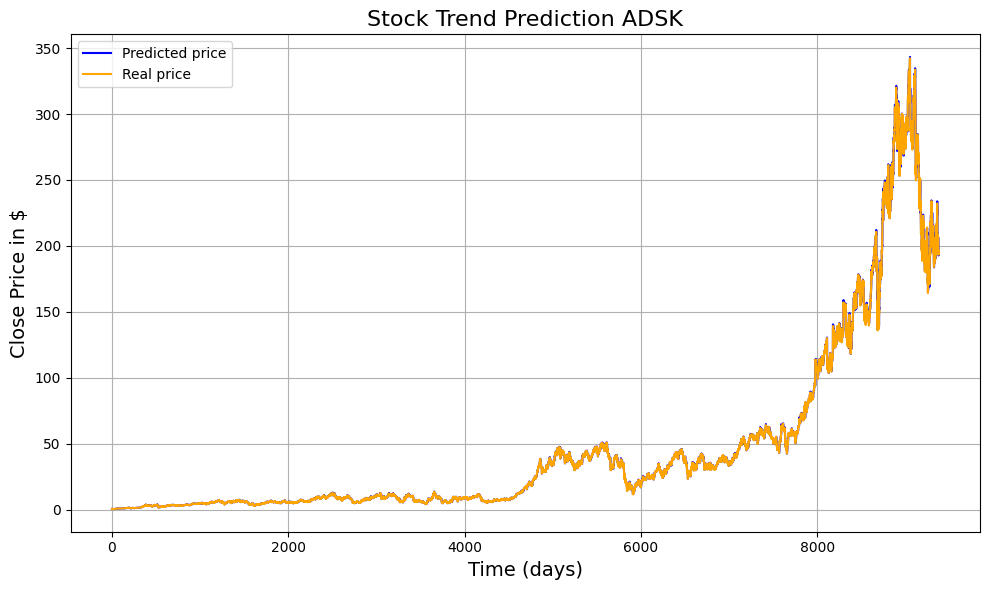

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.013012025373972325


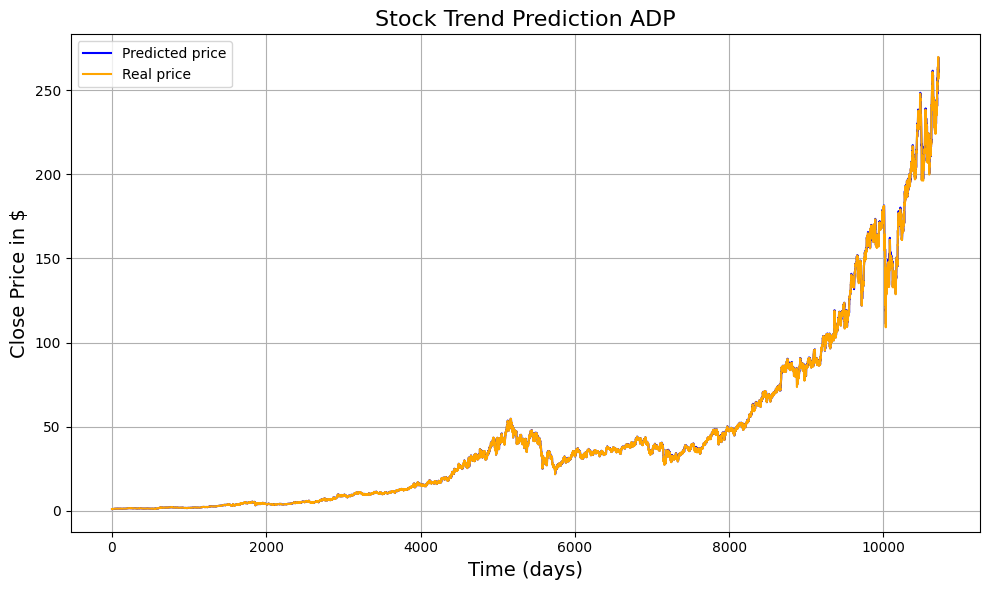

245/245 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.020234021796070804


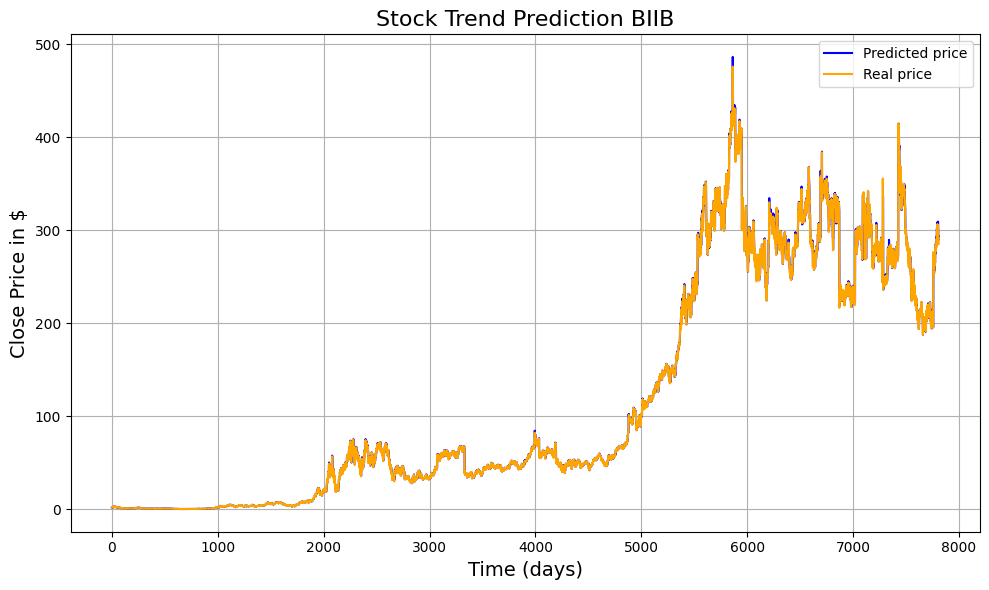

278/278 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.012630280116447585


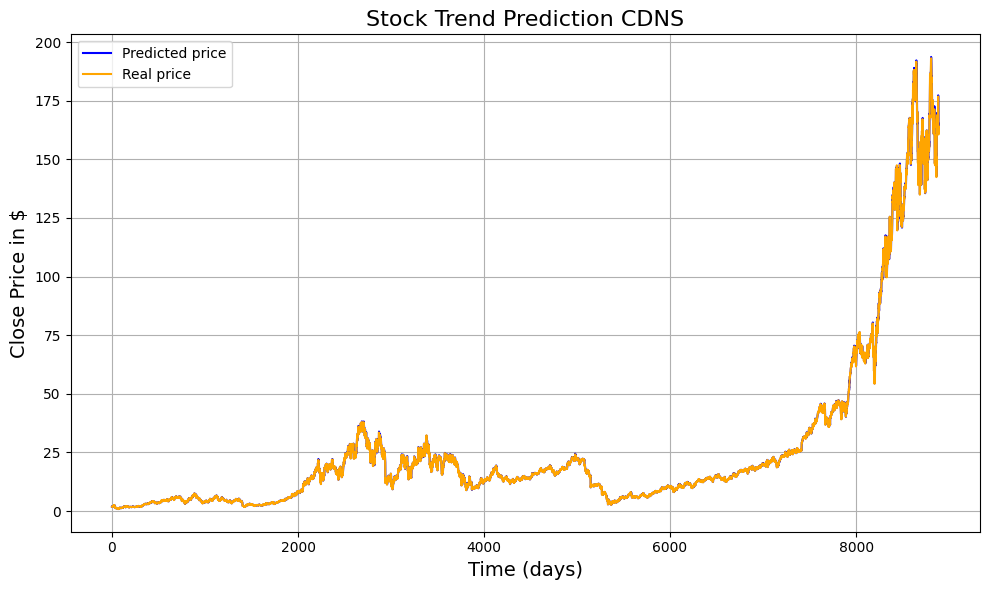

73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012498110417153674


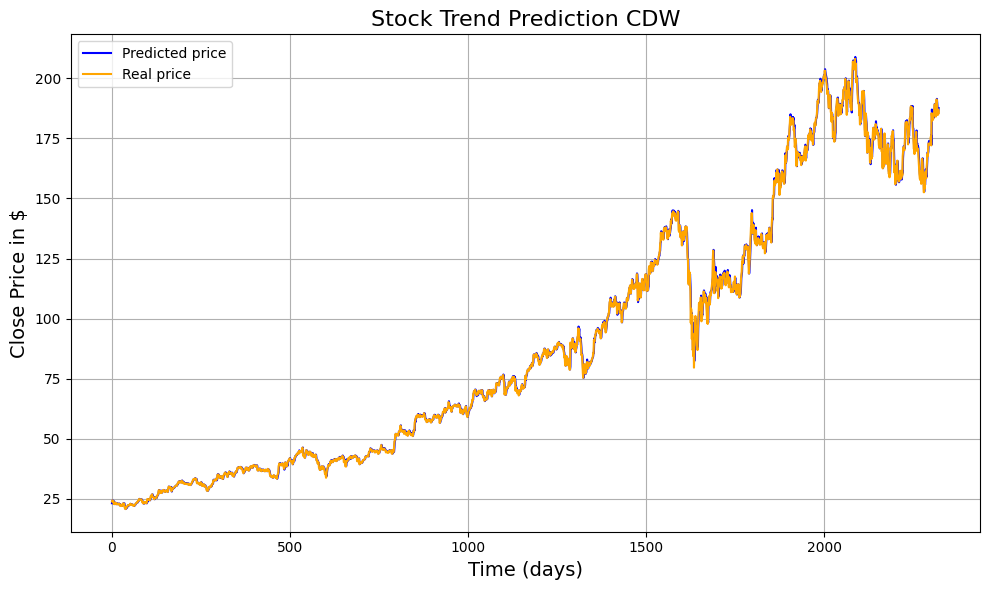

100/100 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012221602164885383


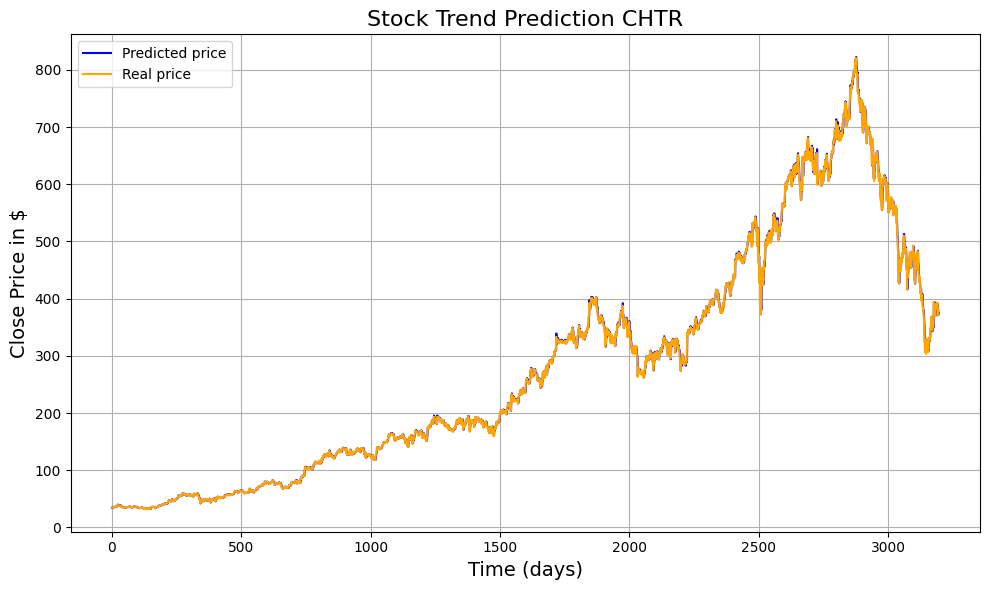

308/308 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.014128857413649847


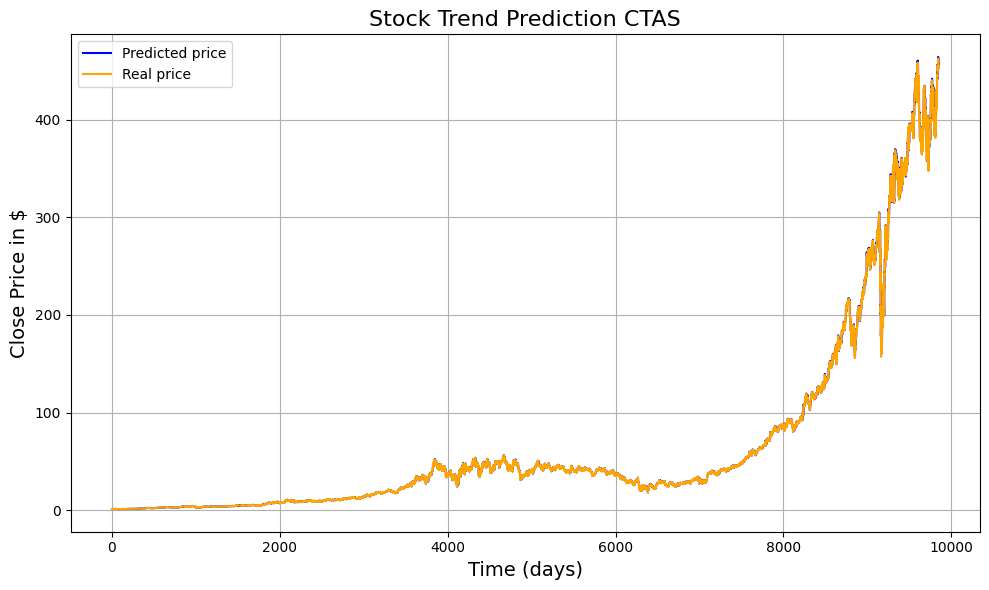

257/257 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013391347410055971


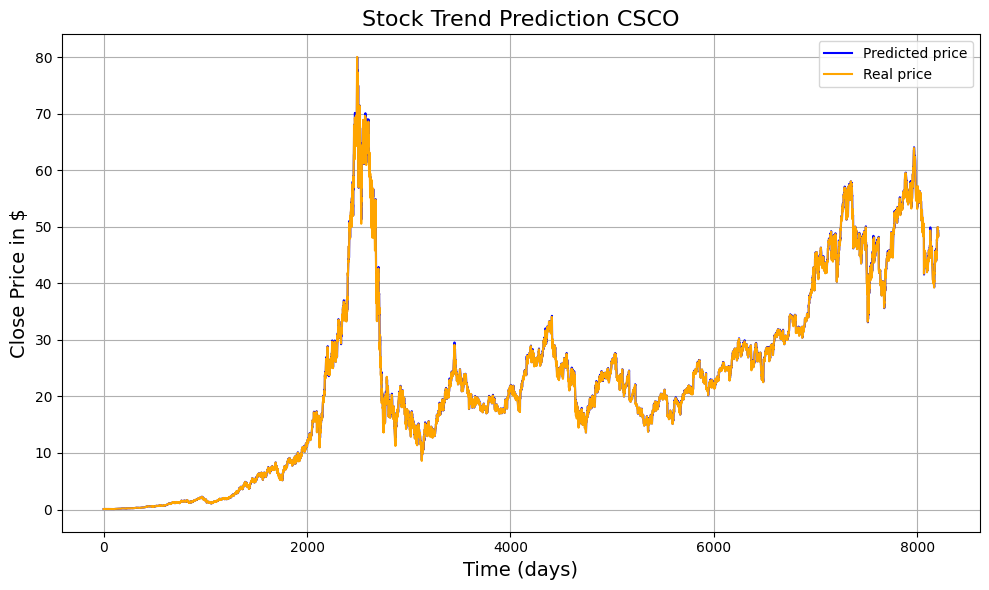

191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014212240820093834


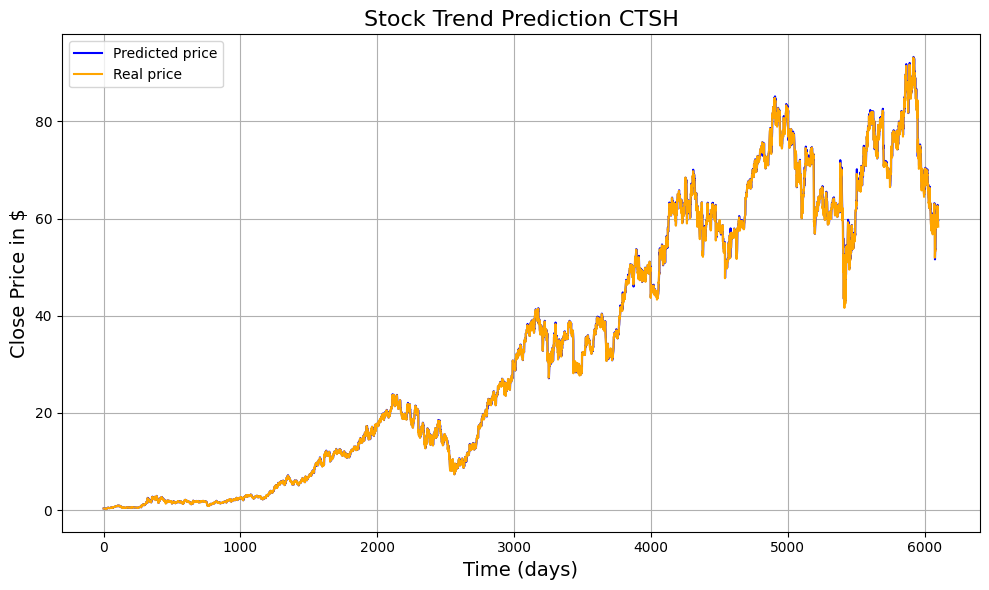

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.011920128397331376


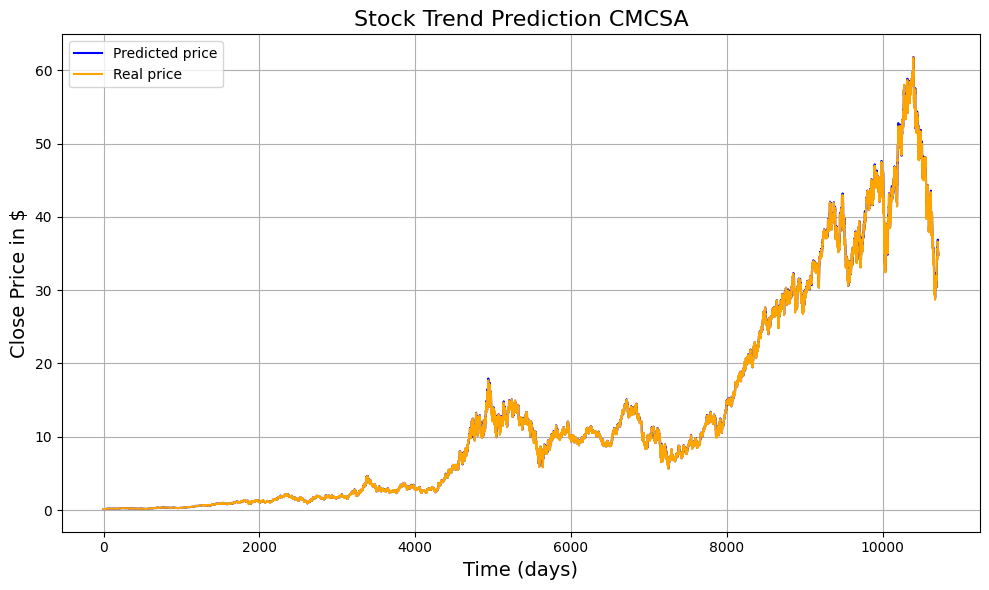

225/225 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.01314912451727078


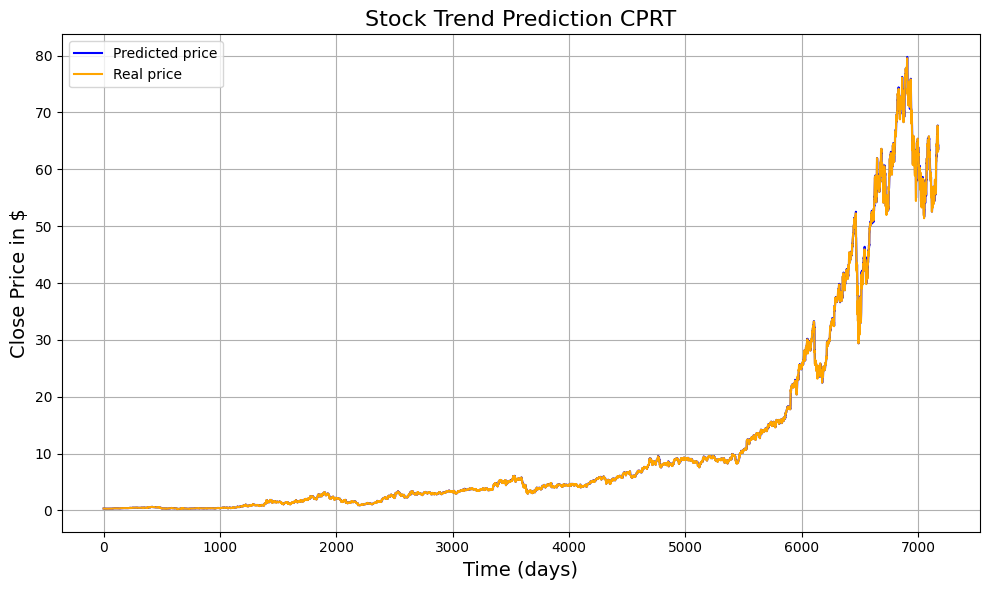

191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.012348237254526091


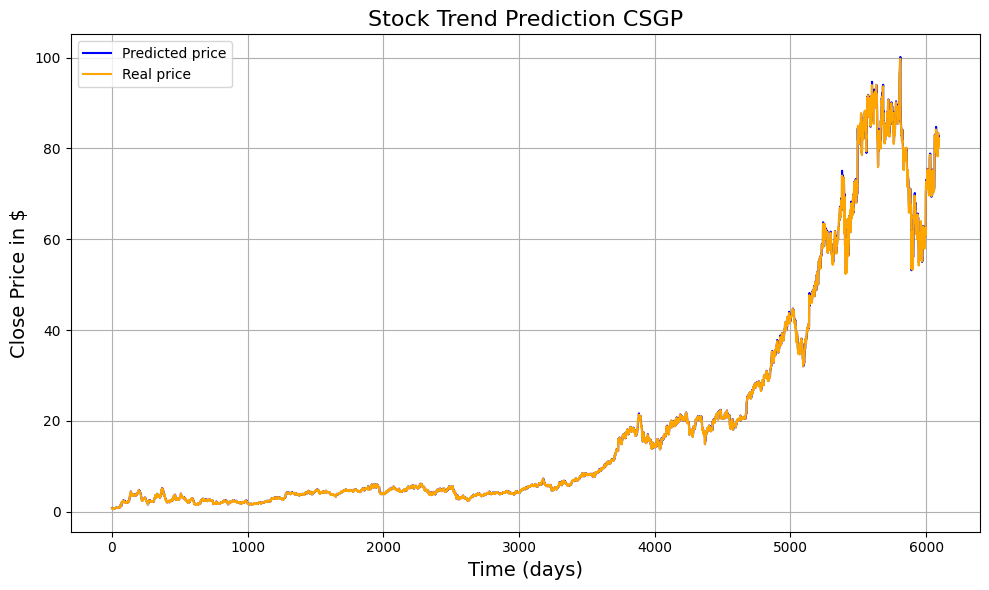

286/286 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.014284894925137131


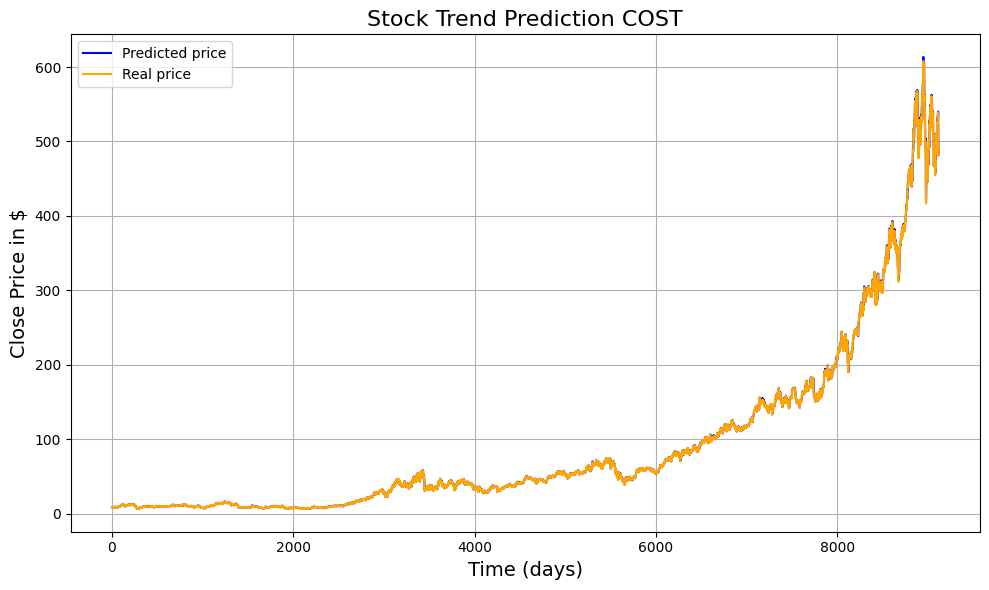

138/138 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.01399464750061979


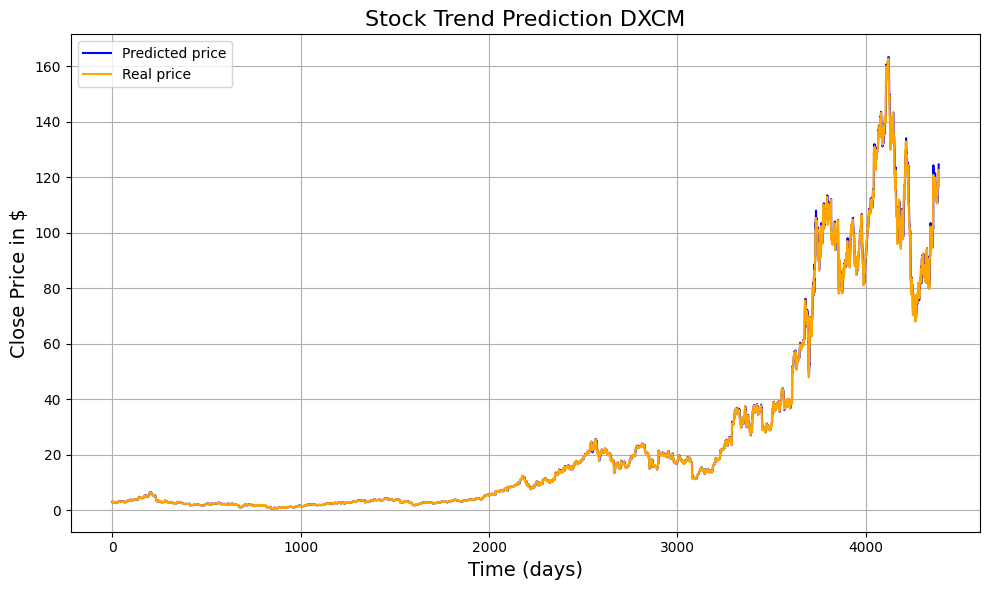

79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012668858745207583


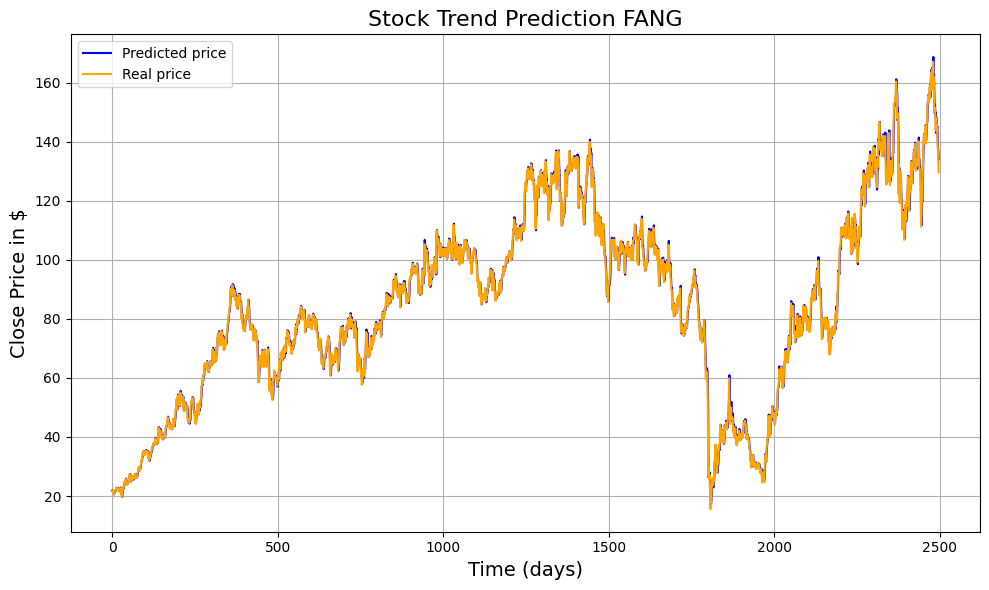

260/260 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013997199123946164


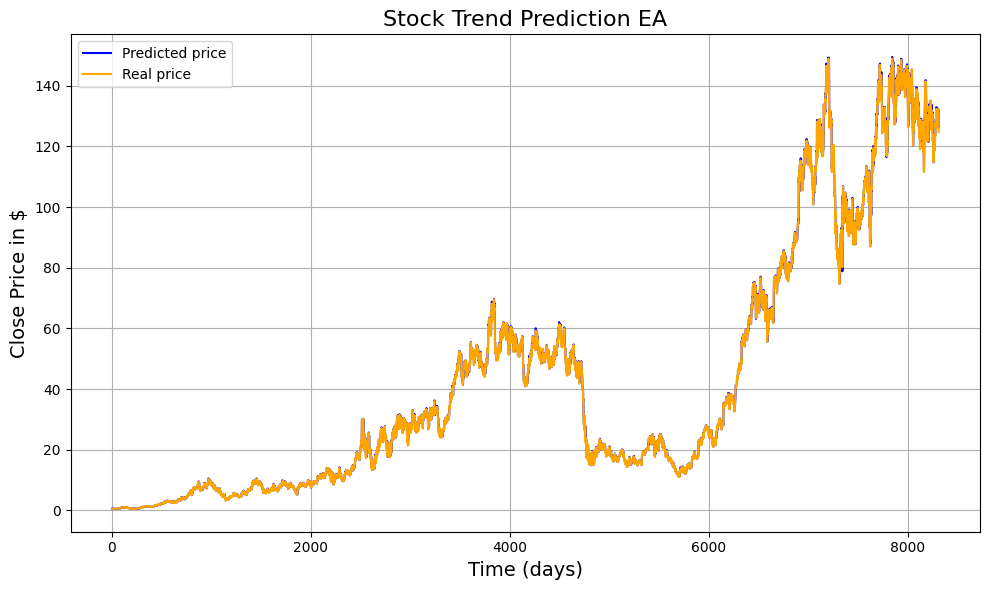

277/277 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.01291883502688246


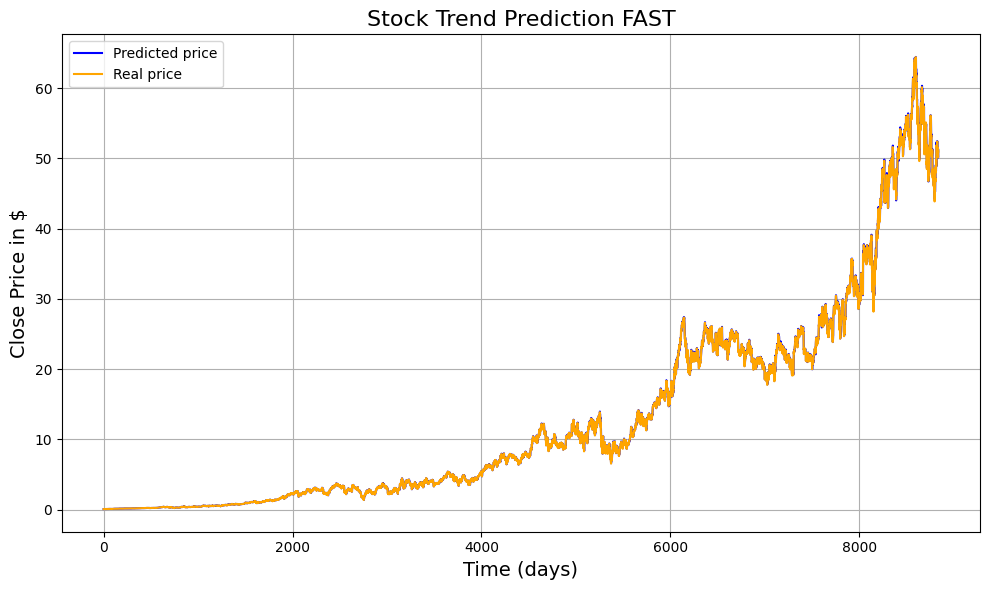

101/101 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014150223555166042


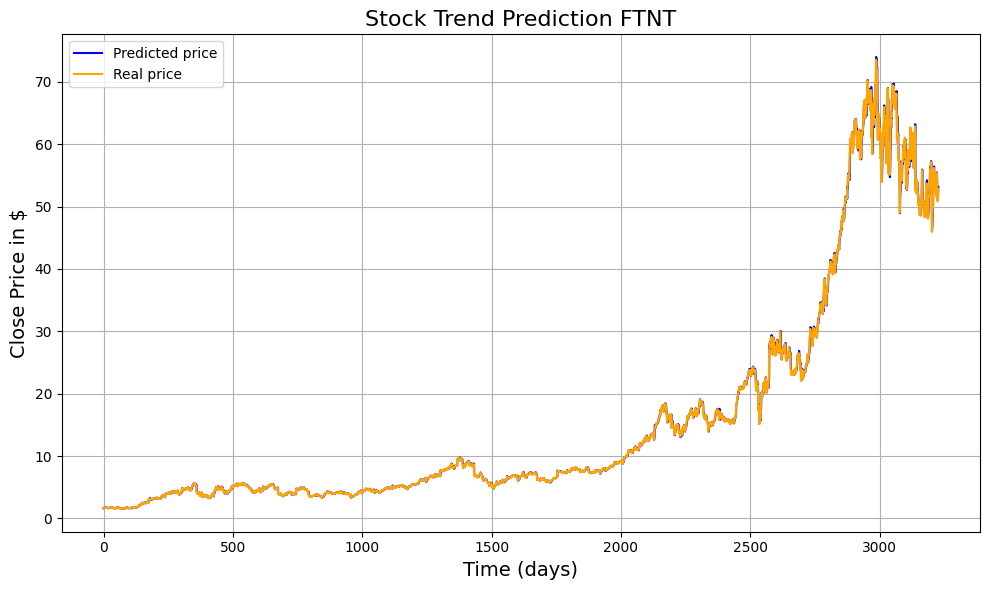

242/242 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013703246203252077


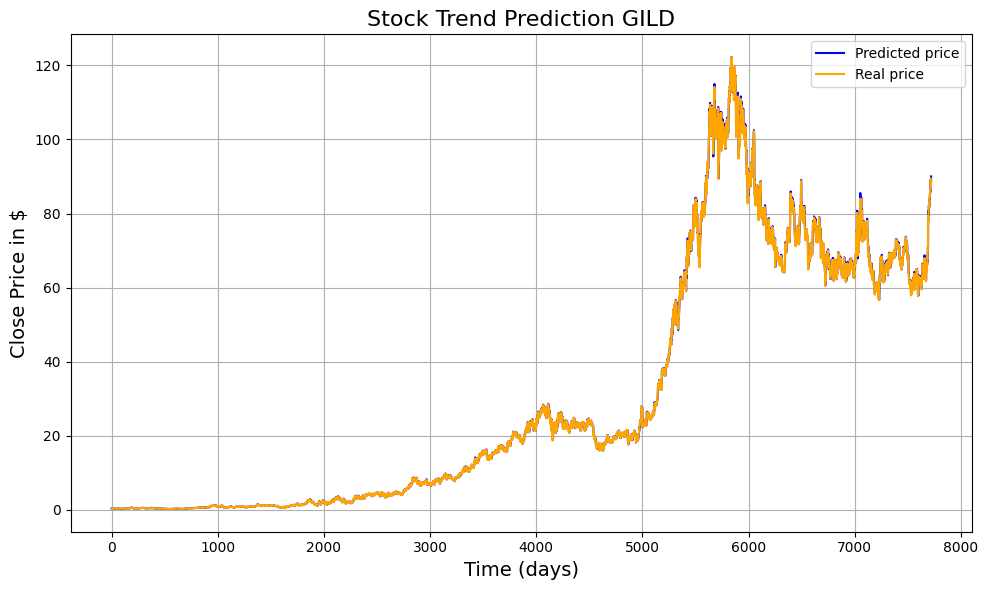

246/246 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.01514905104642207


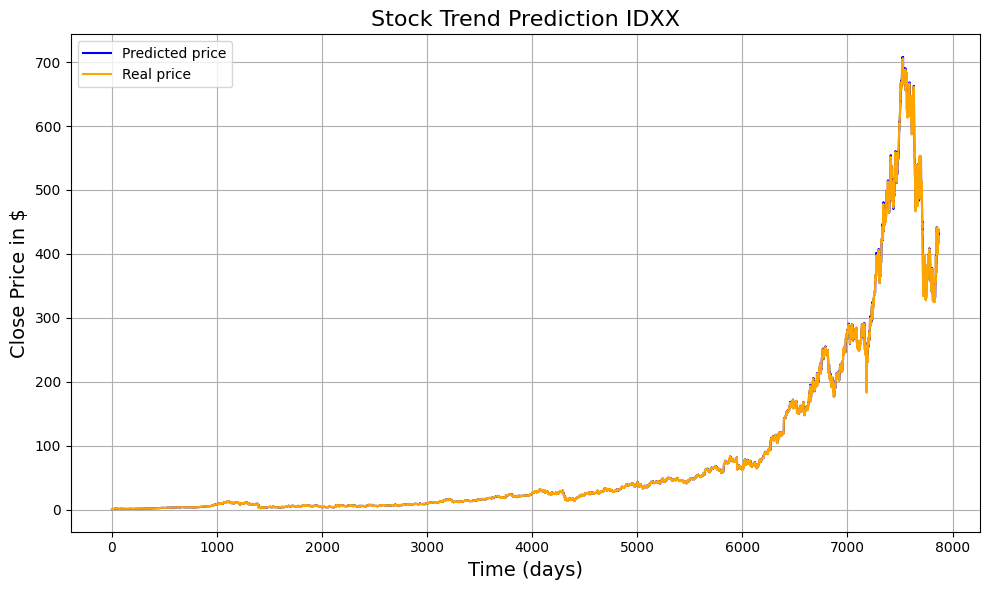

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.012913117880667655


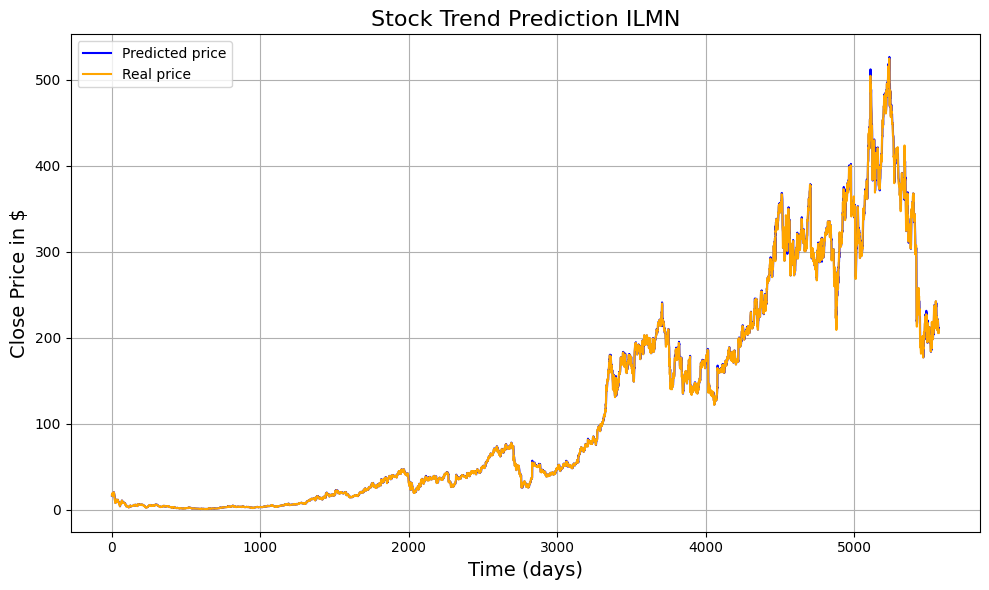

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.011777346805206866


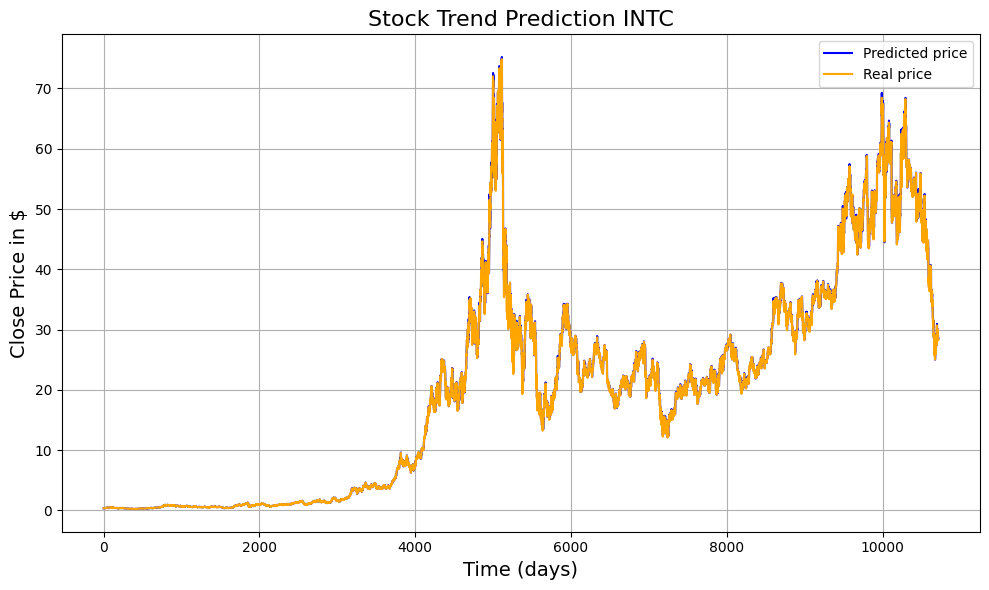

233/233 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014532981506183353


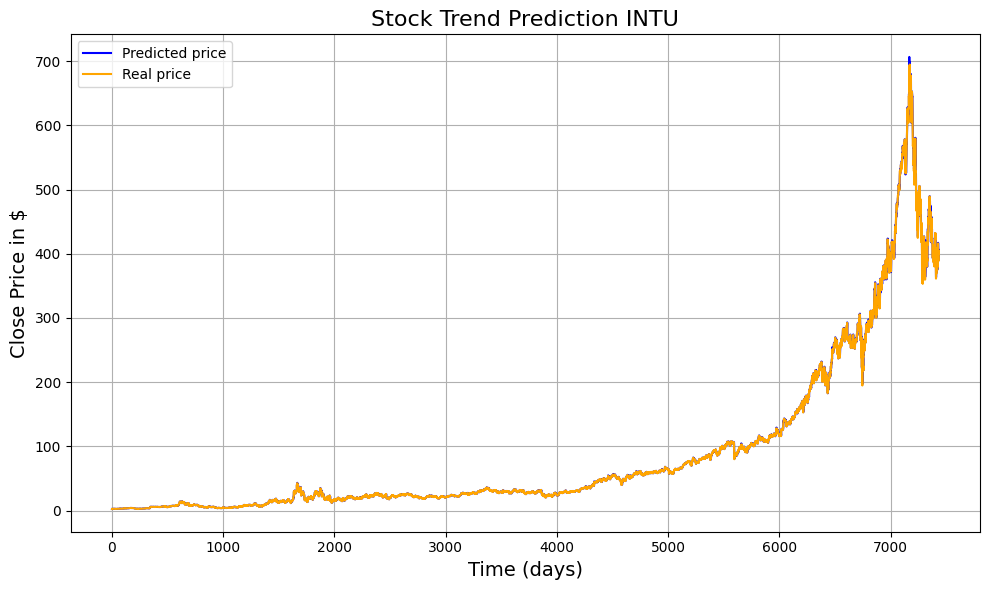

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.015297328249188306


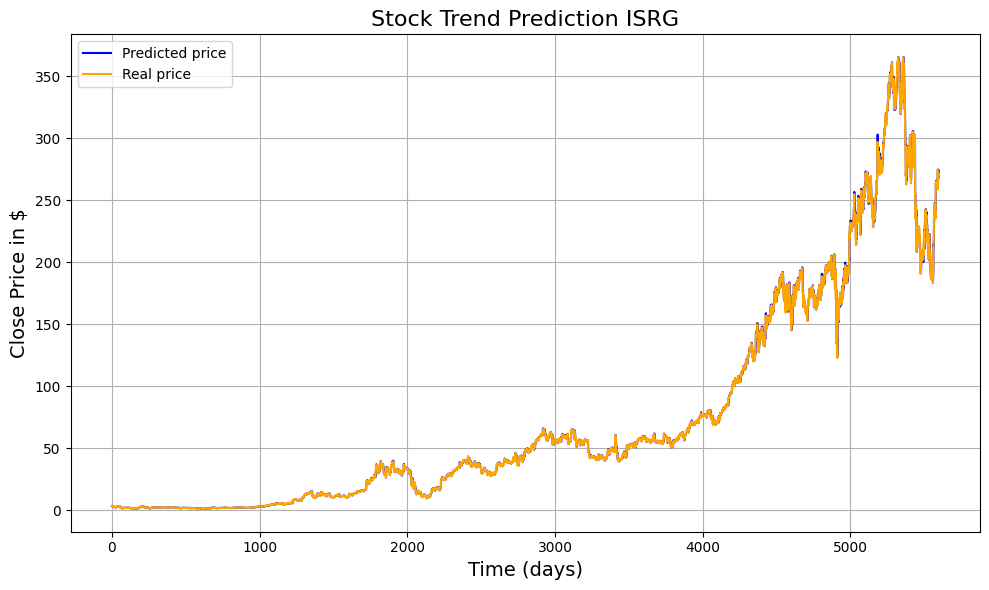

303/303 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.012643131270292714


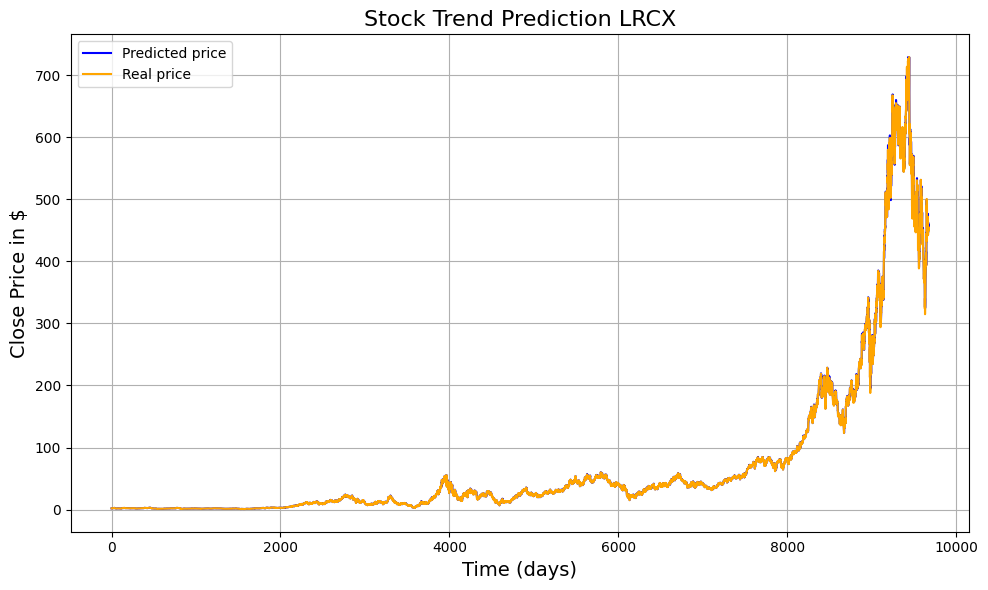

120/120 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012825249017253935


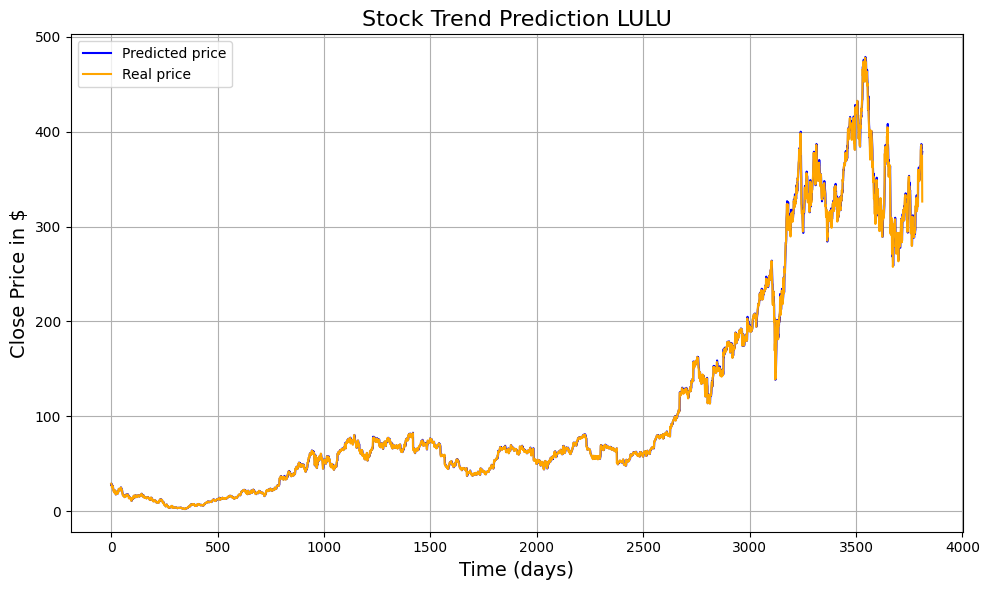

193/193 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.012335693880037255


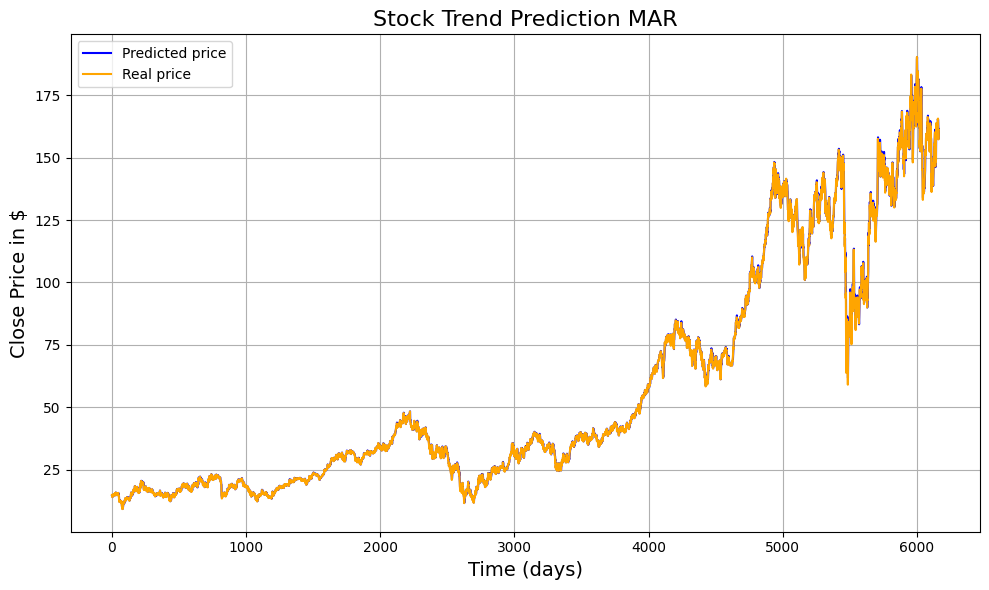

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.011994669267335997


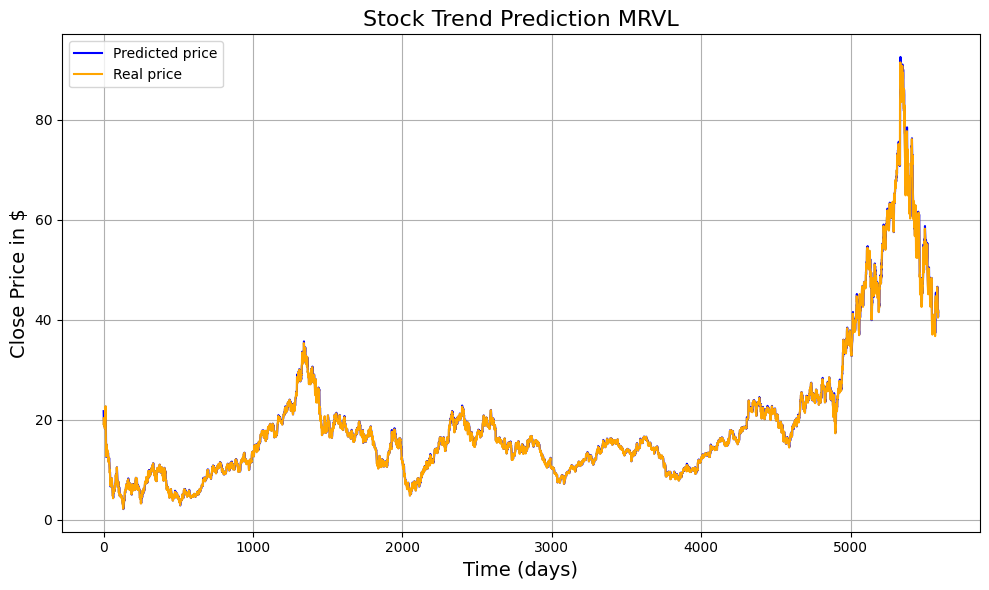

119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.011464354064507253


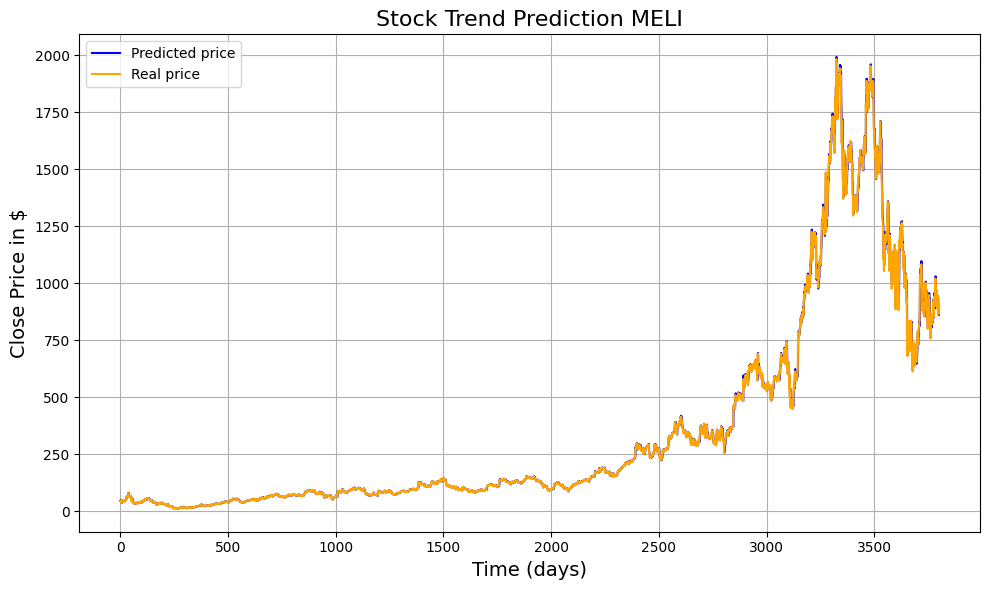

233/233 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.014312021211484215


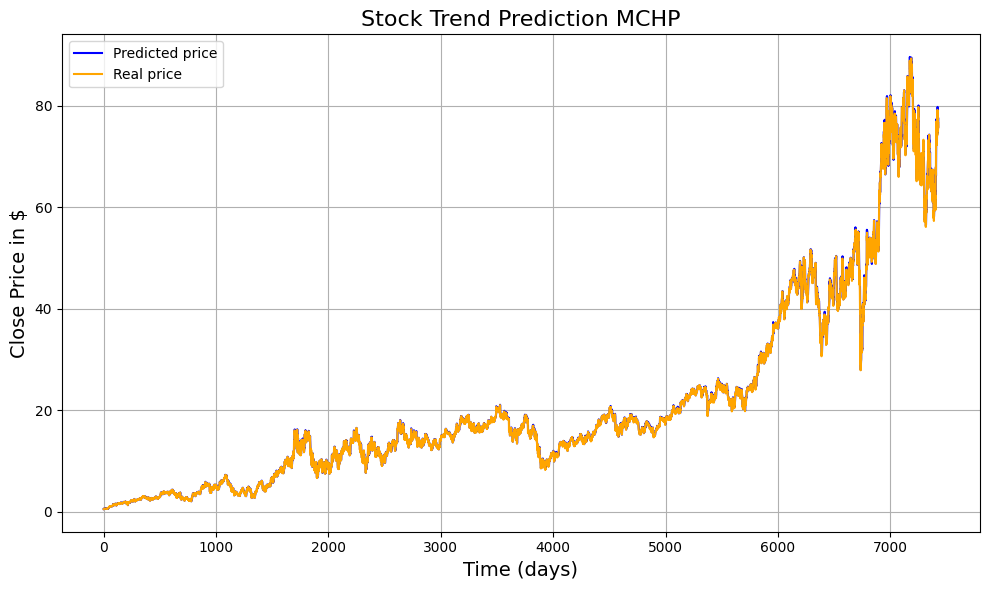

302/302 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.010506500713667998


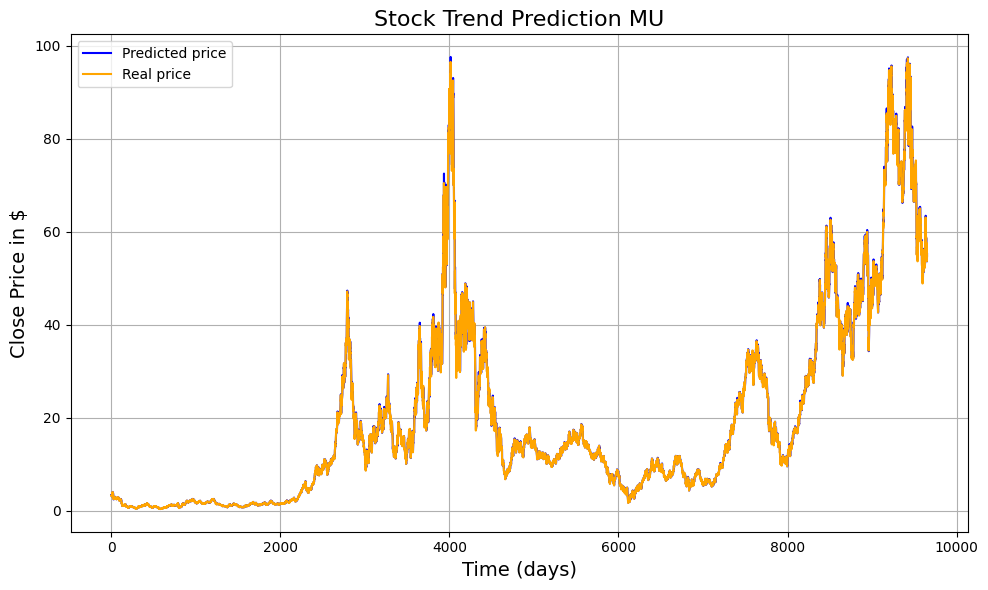

288/288 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013206850399892629


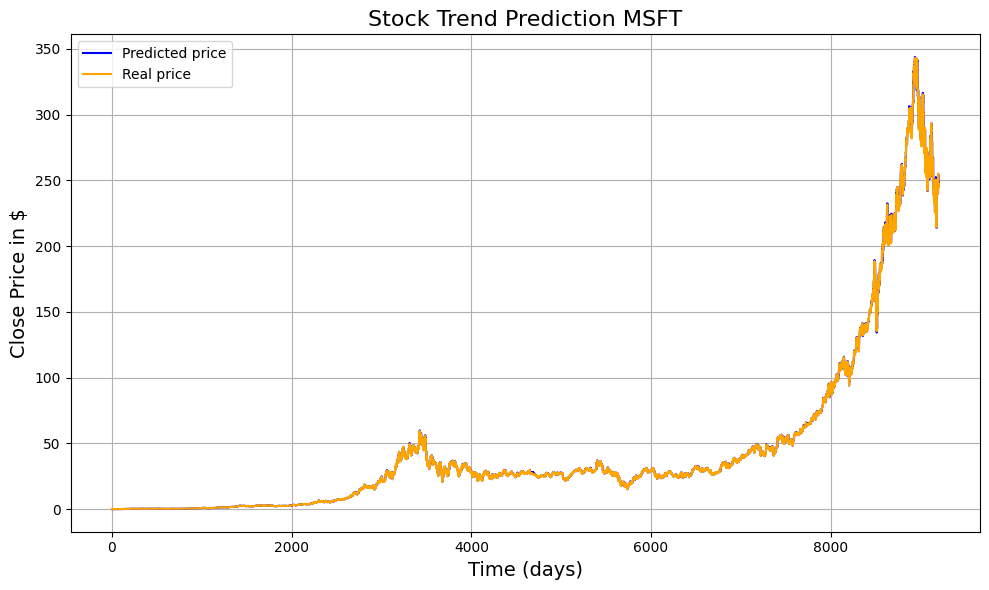

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.017309159472420645


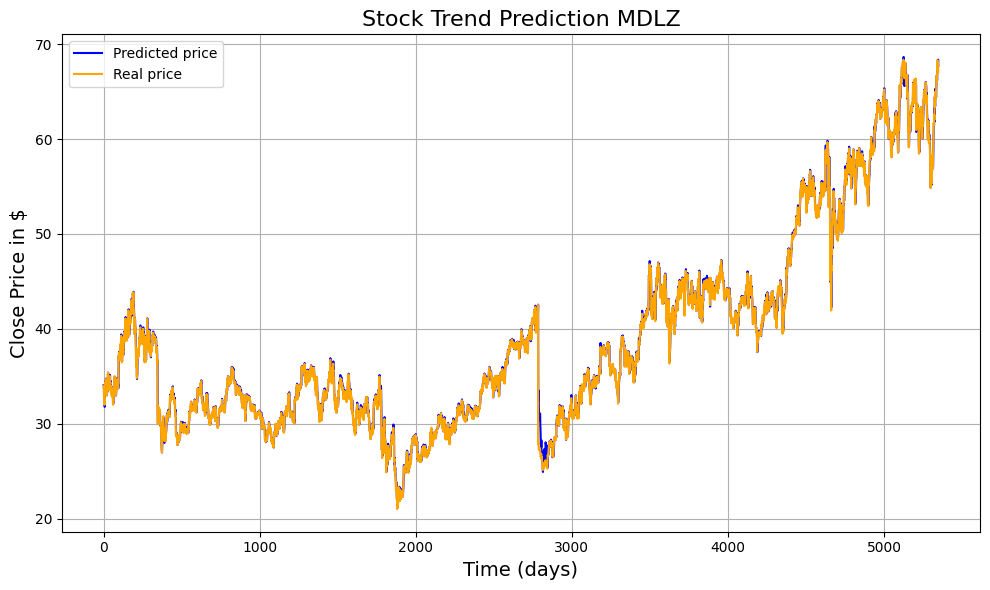

290/290 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.02016801034410552


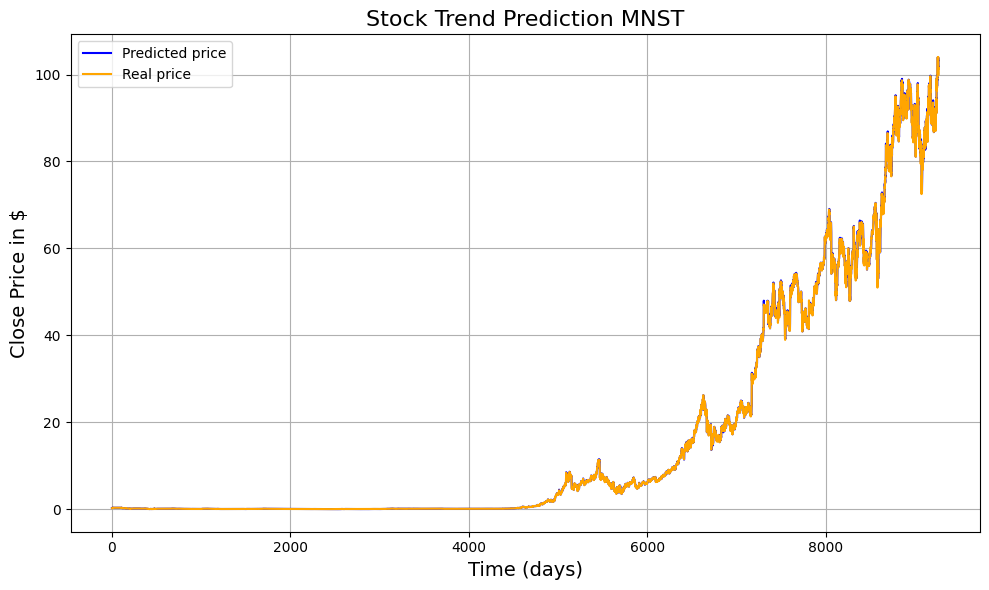

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.013543994088900857


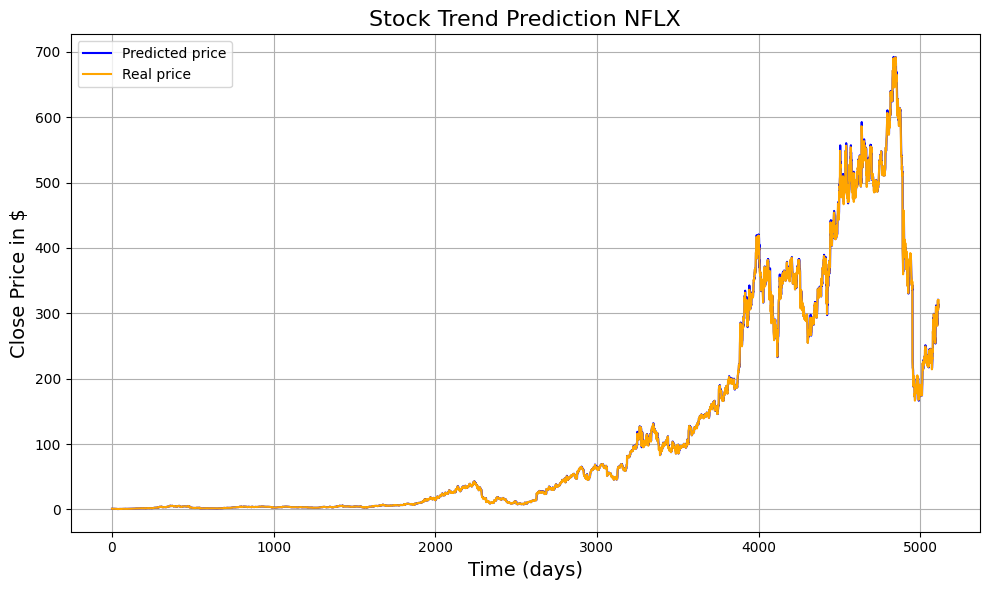

186/186 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.011815459138321055


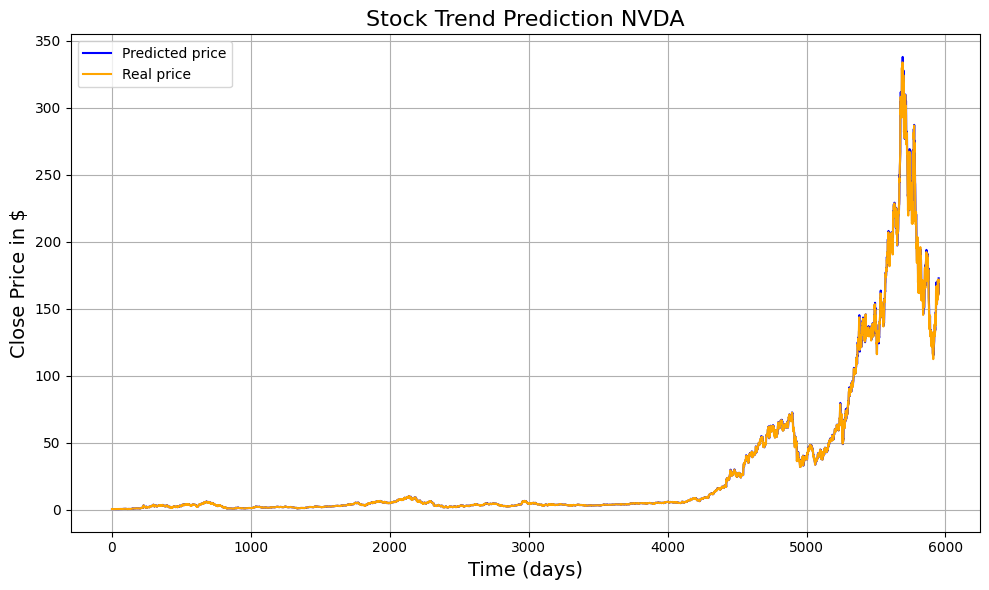

96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012900312837561307


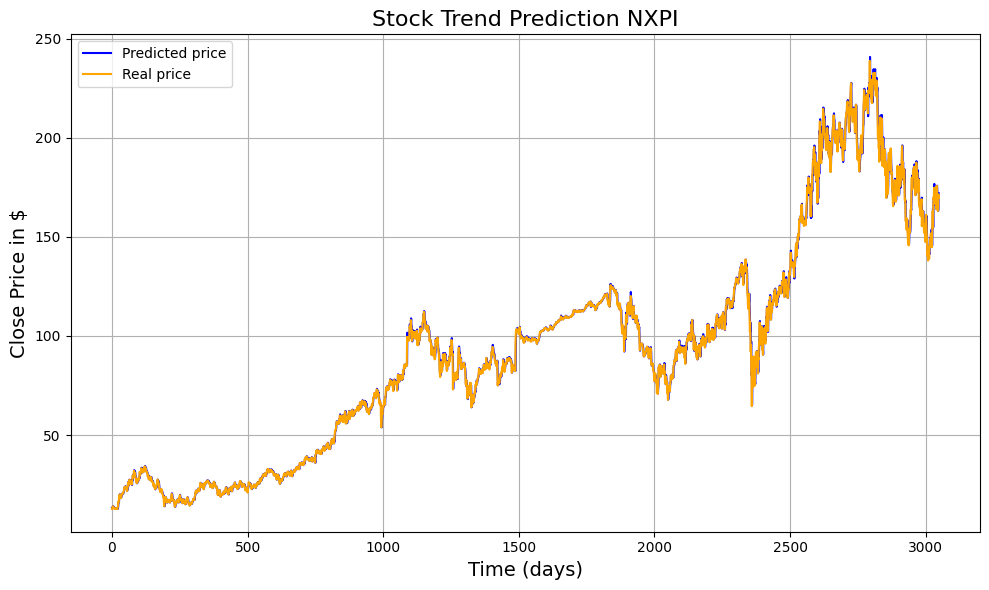

232/232 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.014233195567080834


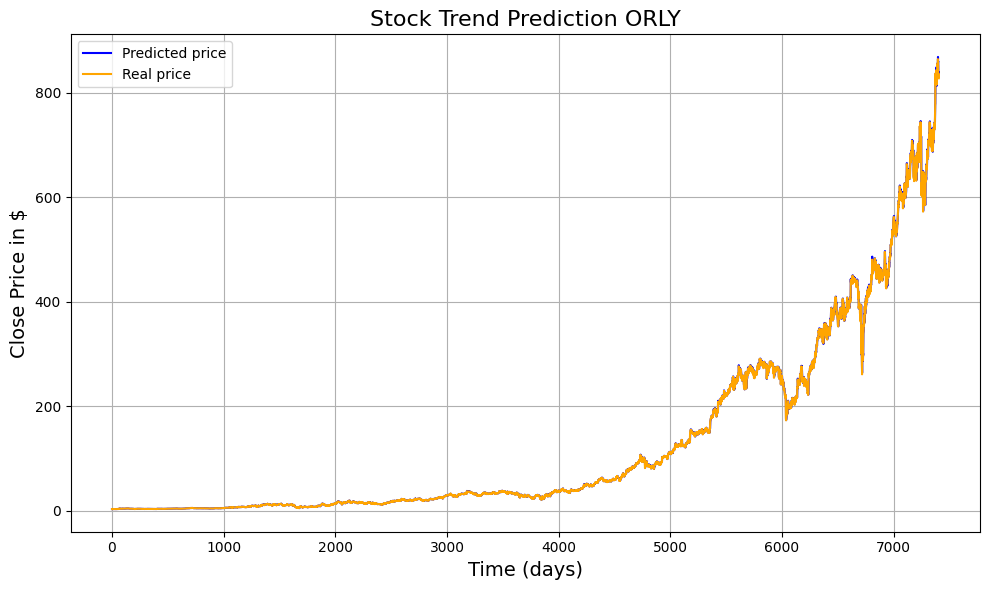

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.01849514132673937


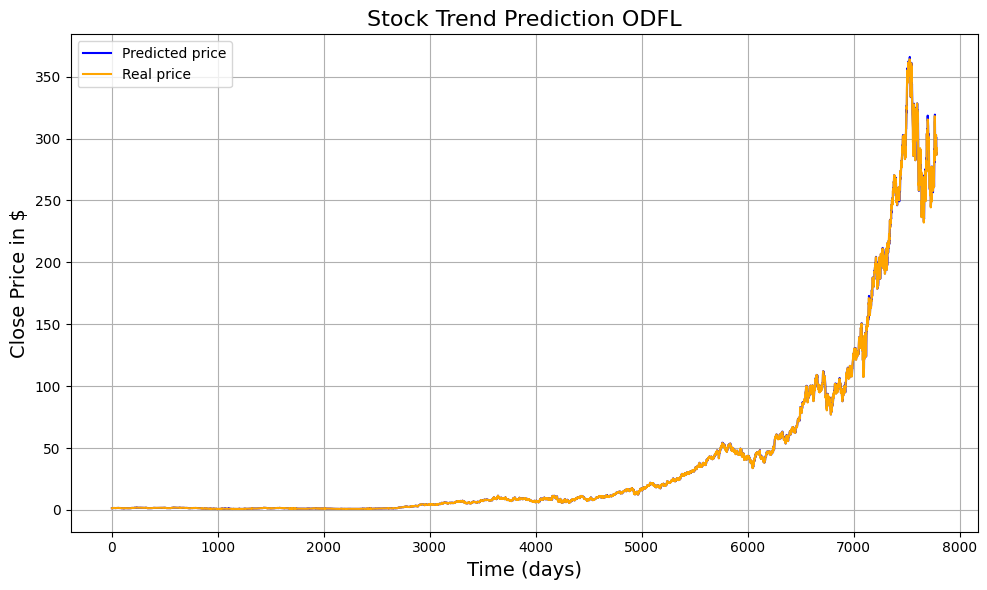

176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.011888794262289133


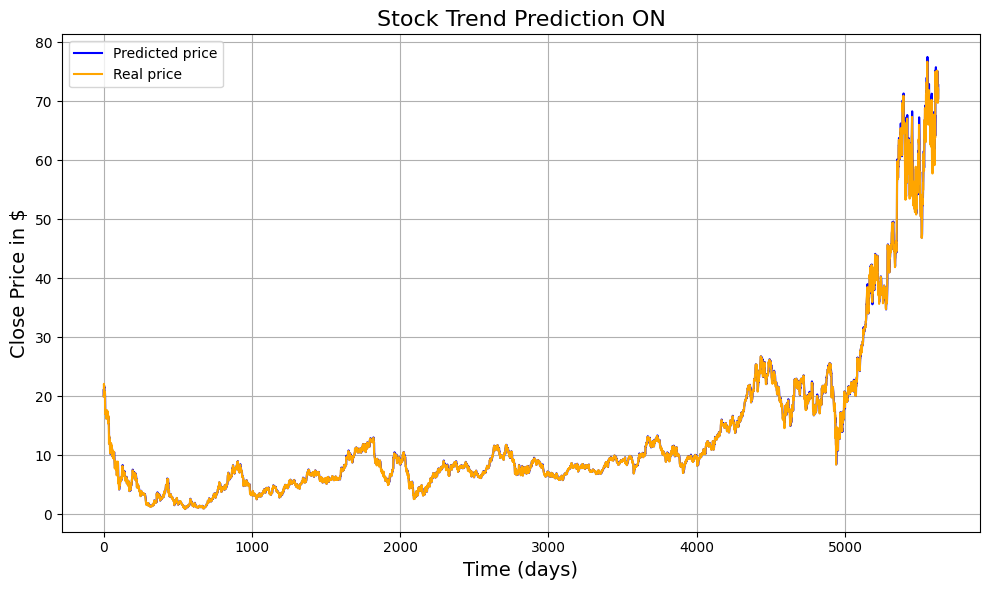

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.012622230077949487


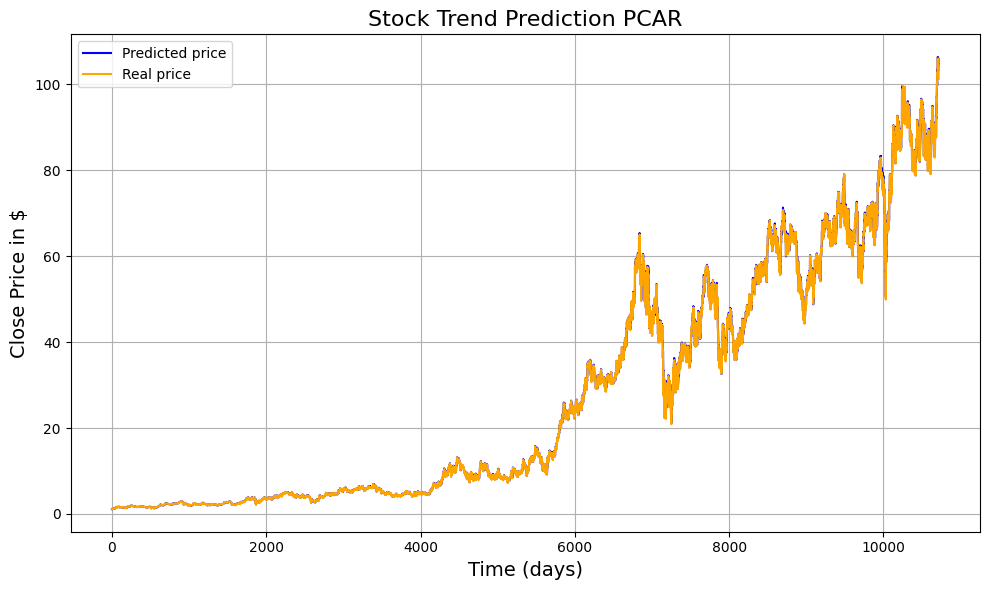

308/308 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013106726851342317


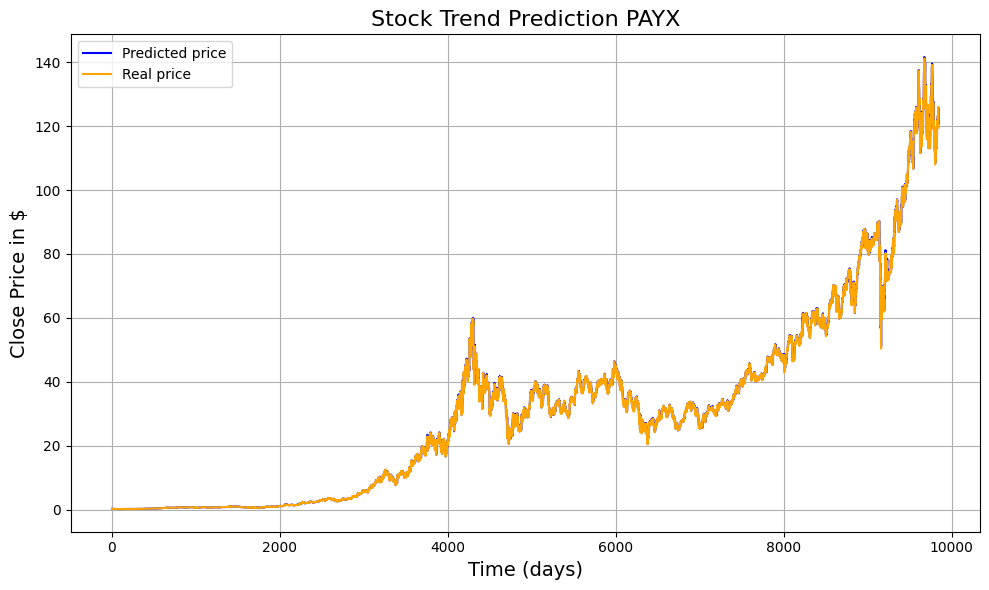

243/243 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.01364339910250263


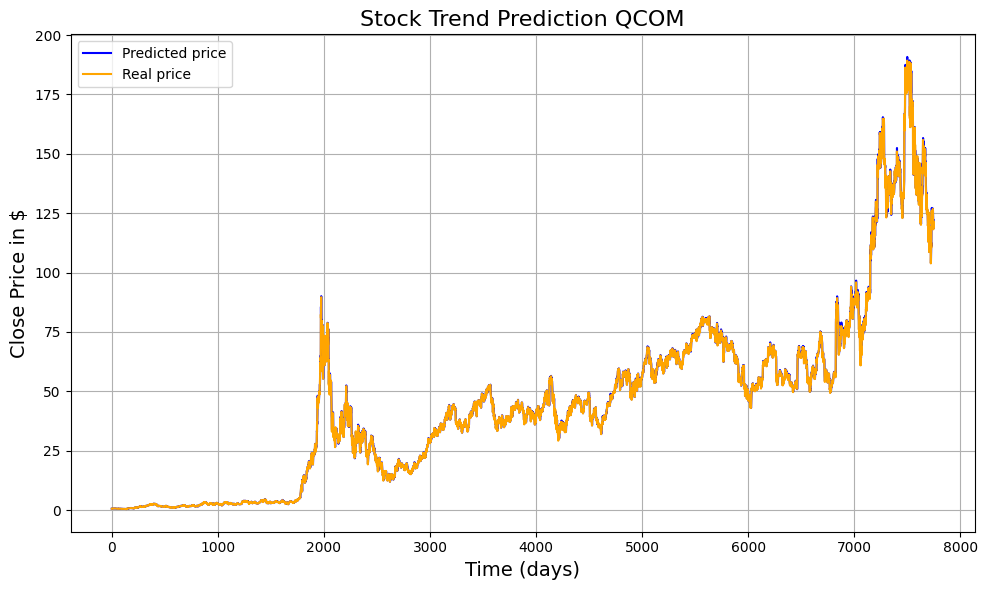

248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.014155040264209875


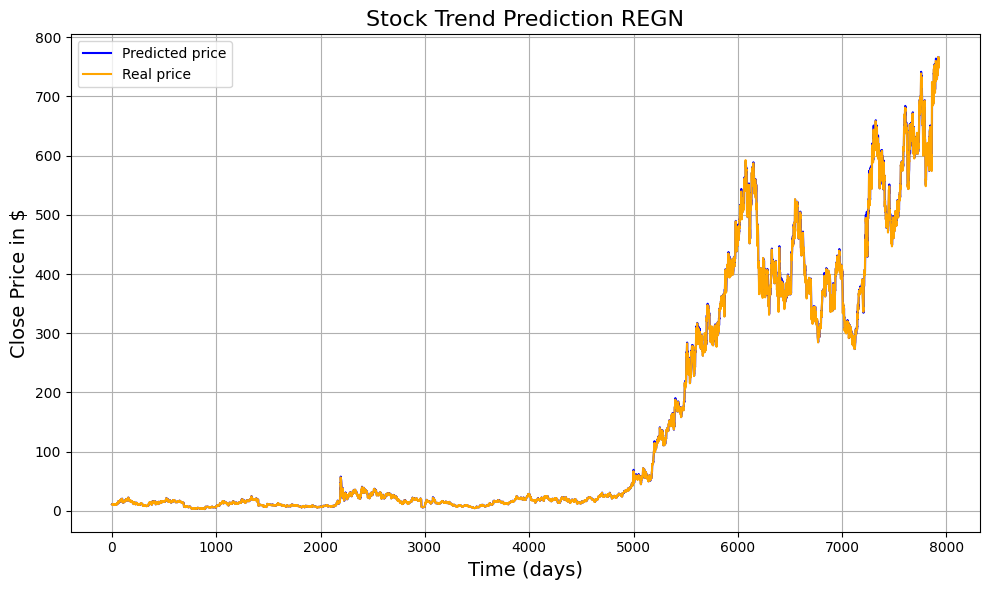

293/293 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.012274133817319434


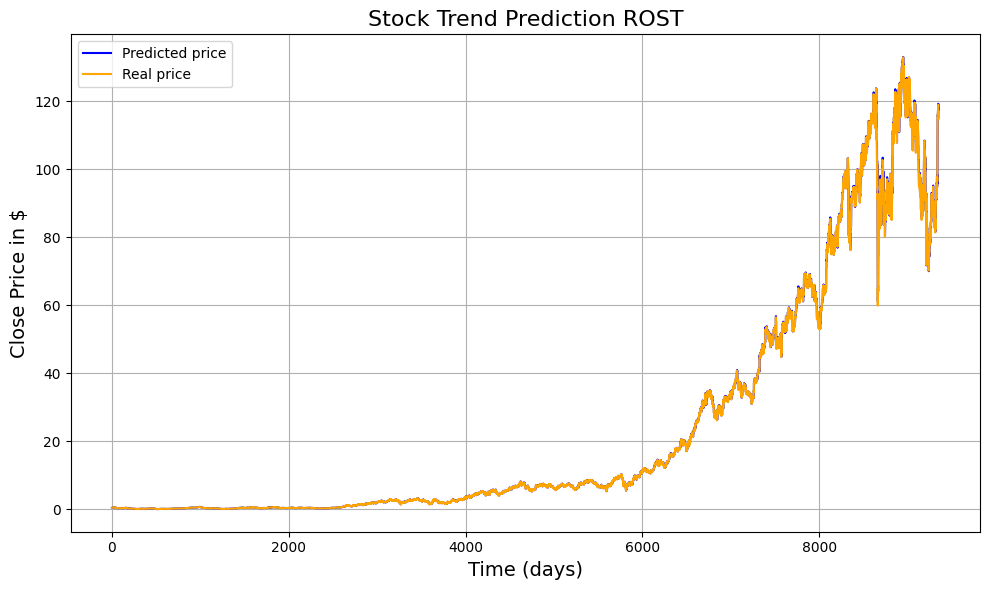

238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.01273406454483267


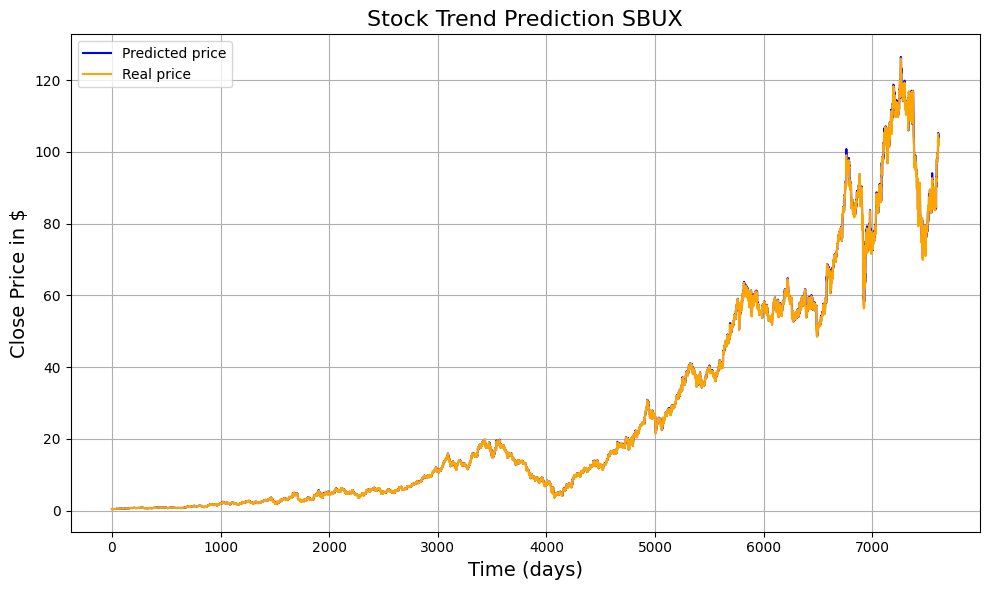

122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
MSE on the test set:  0.014998169653333235


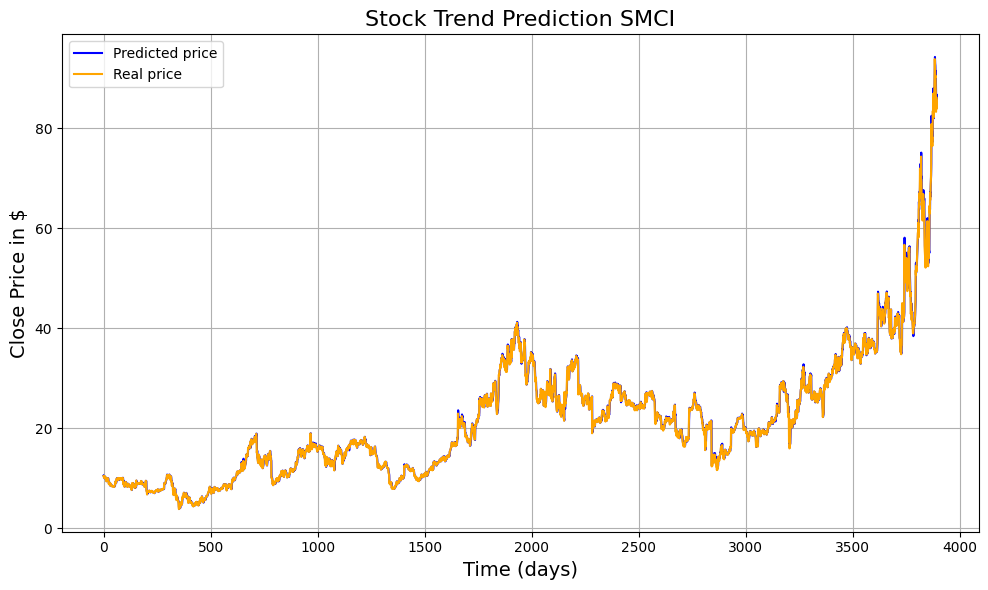

241/241 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.013848348133955742


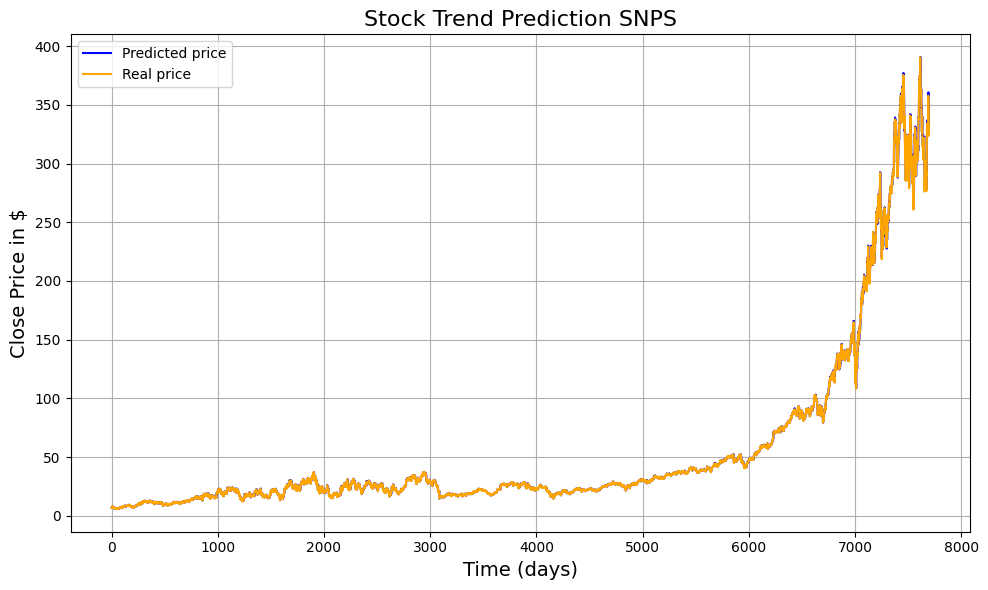

397/397 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
MSE on the test set:  0.011694035942413241


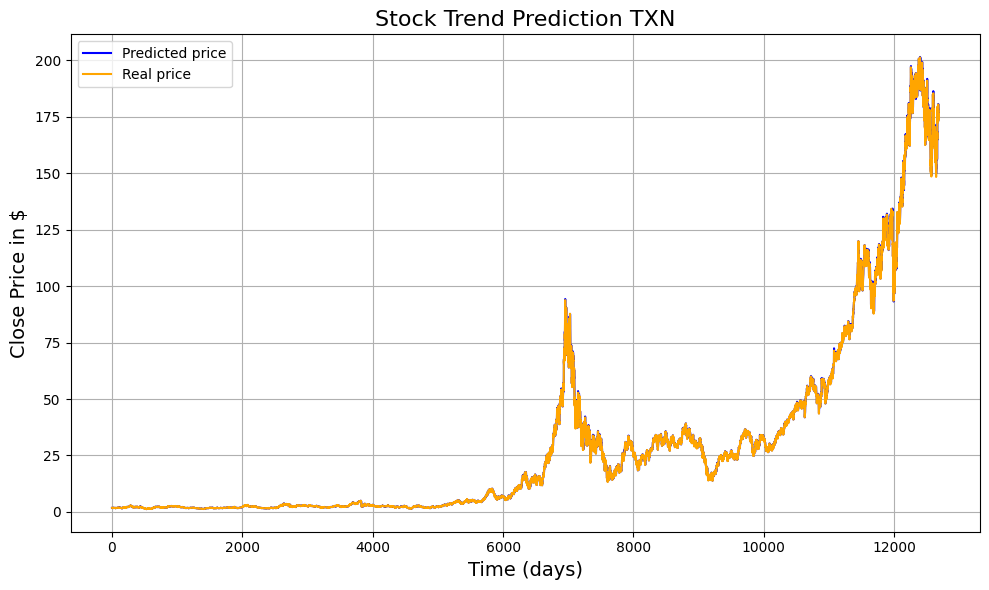

102/102 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014611799719165217


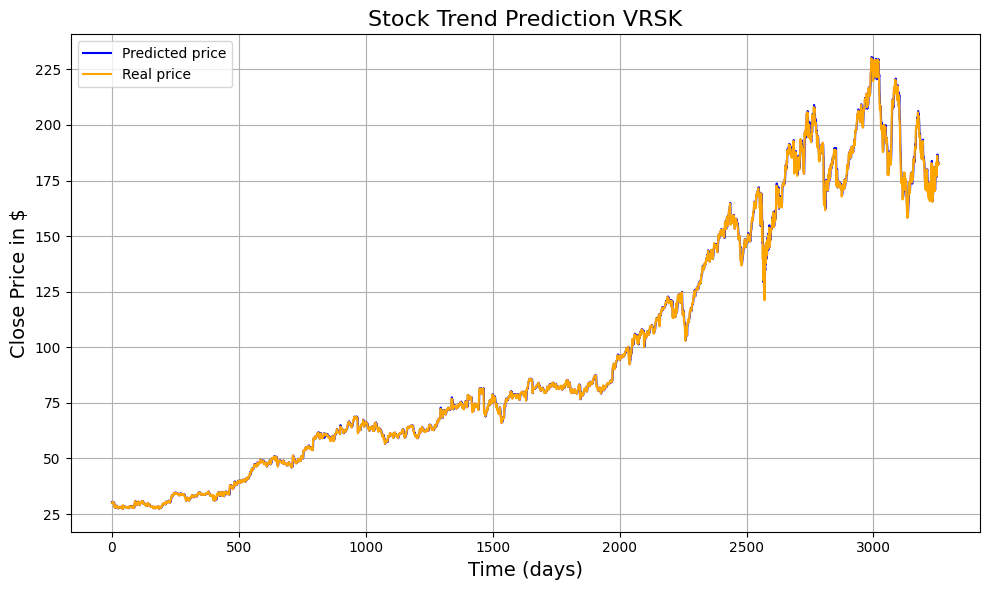

246/246 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
MSE on the test set:  0.01649089041623872


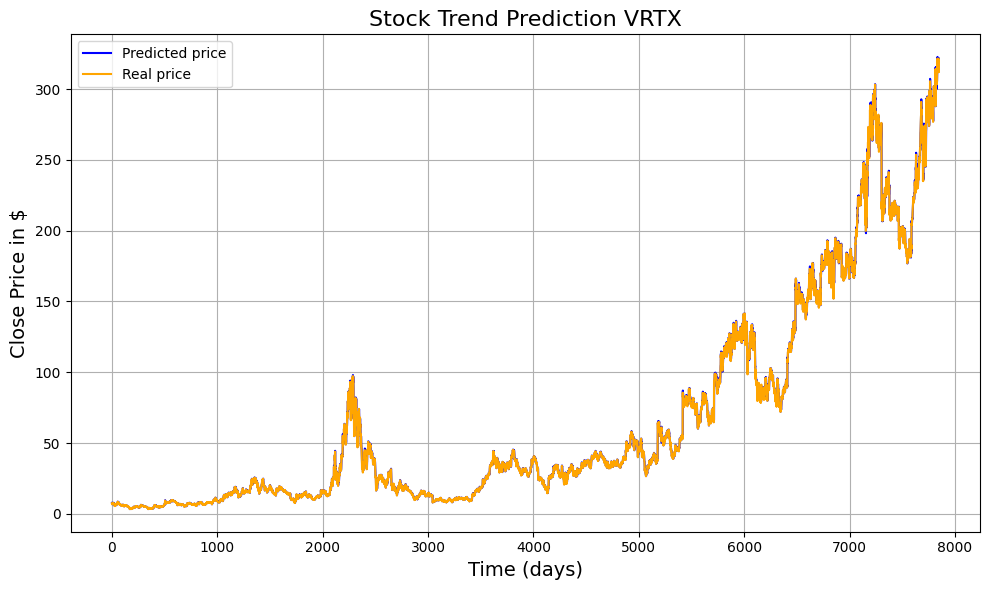

In [46]:
lstm_test_2 = tf.keras.models.load_model('lstm_day.keras')

# Load all data first
(all_X_data, all_y_data,
all_X_data_norm, all_y_data_norm,
all_X_data_norm_t, all_y_data_norm_t,
all_feature_choice_indices) = load_all_data(
    nasqad100,
    features,
    window_size=window_size,
    k_days=1,
    feature_choice='Close',
    type=1
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        lstm_test_2,
        all_X_data_norm_t[stock],
        all_y_data_norm[stock],
        all_X_data[stock],
        all_y_data[stock],
        all_feature_choice_indices[stock],
        stock
    )
    

### Task 1.3

In [47]:
# Parameters
window_size = 75  # Time window for data feature (size of 'number of days').
features = ['Low', 'High', 'Open', 'Close', 'Adjusted Close', 'Volume']
k_days = 2  # Number of days to predict in the future

#### 1D Convolutional Neural Network

284/284 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.018756915936795227


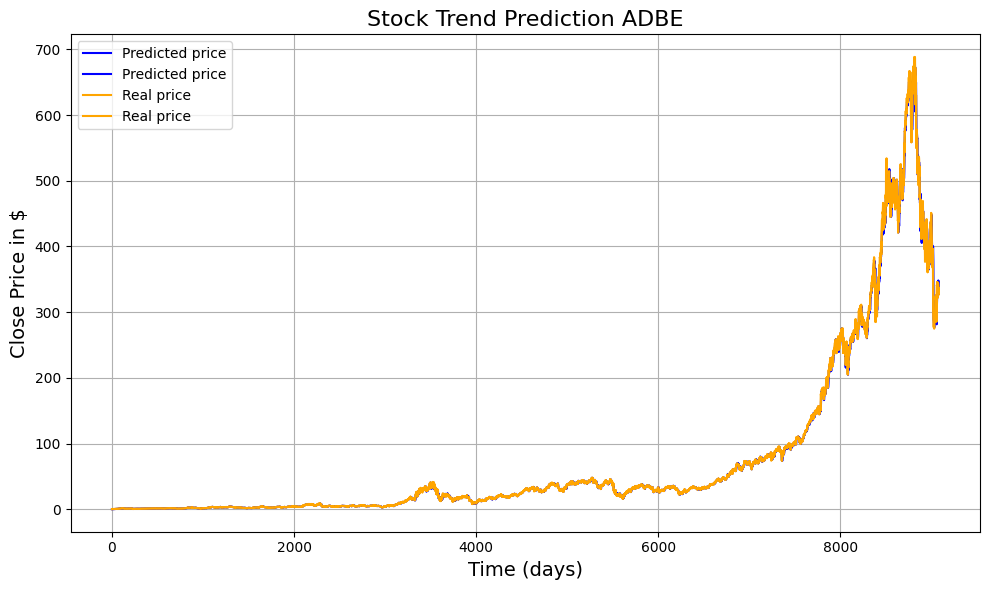

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.01801494479603255


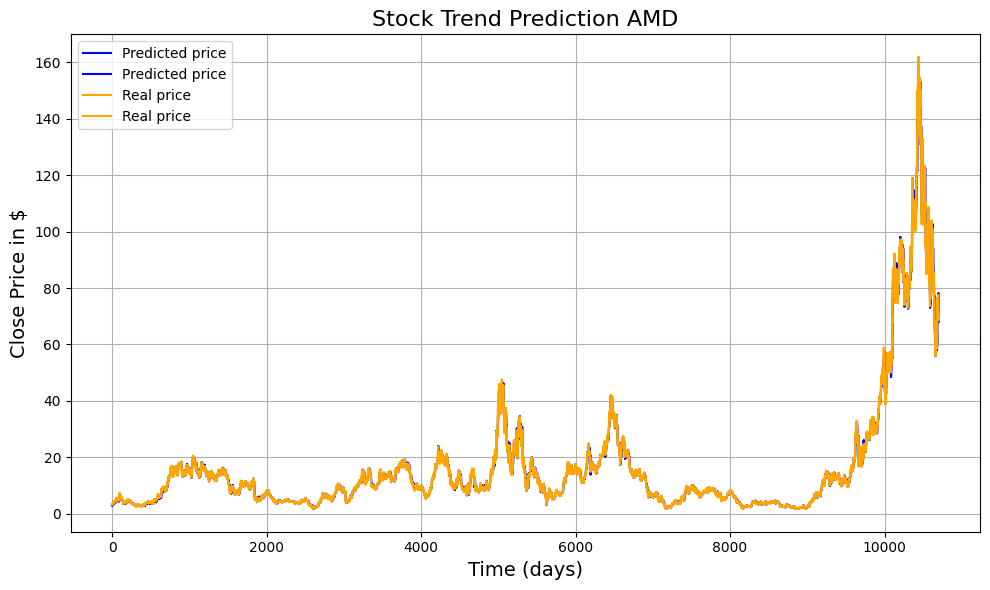

199/199 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.019171717119513793


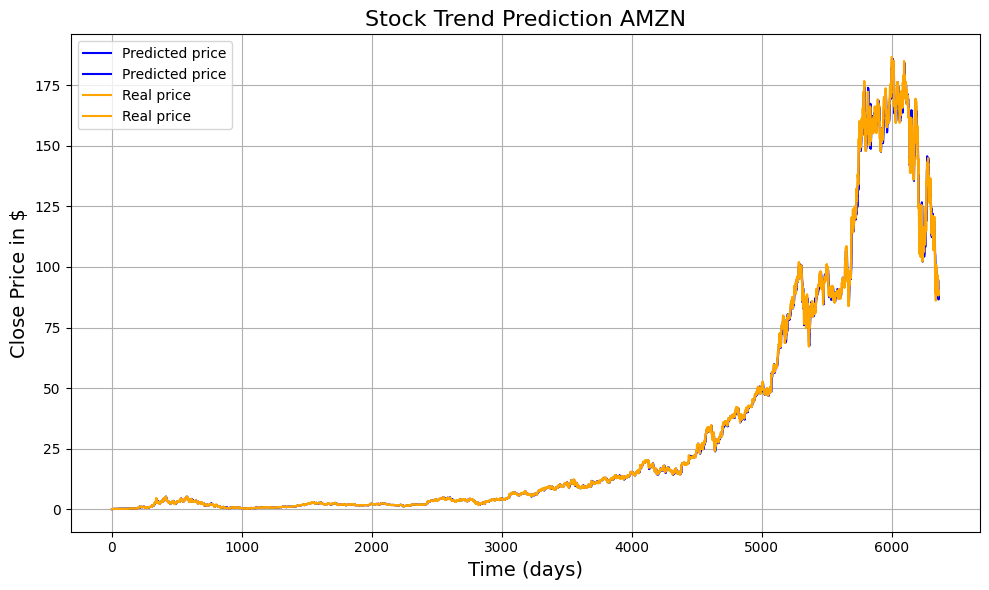

309/309 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.01889132681927689


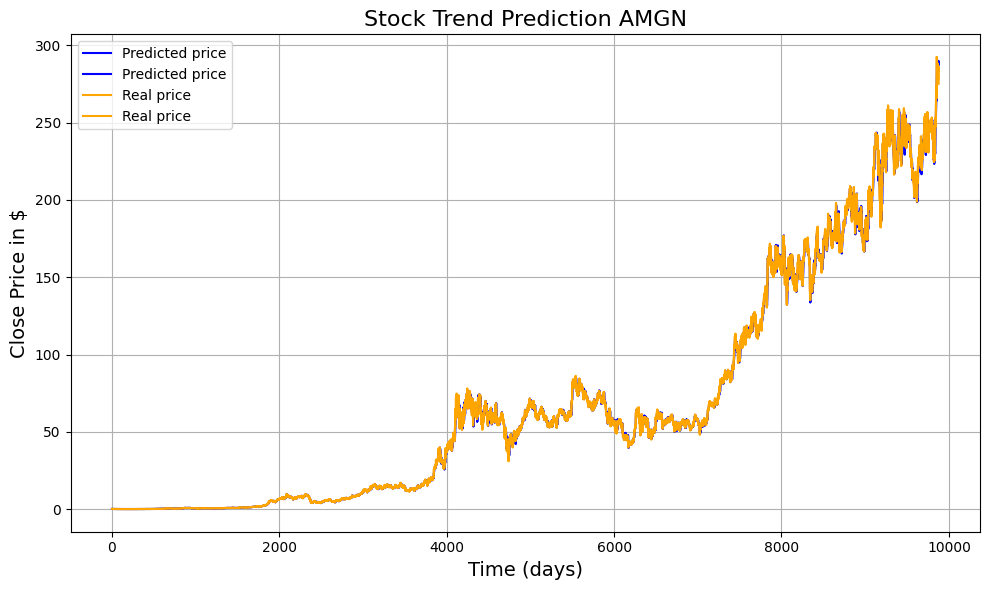

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.02188480405623365


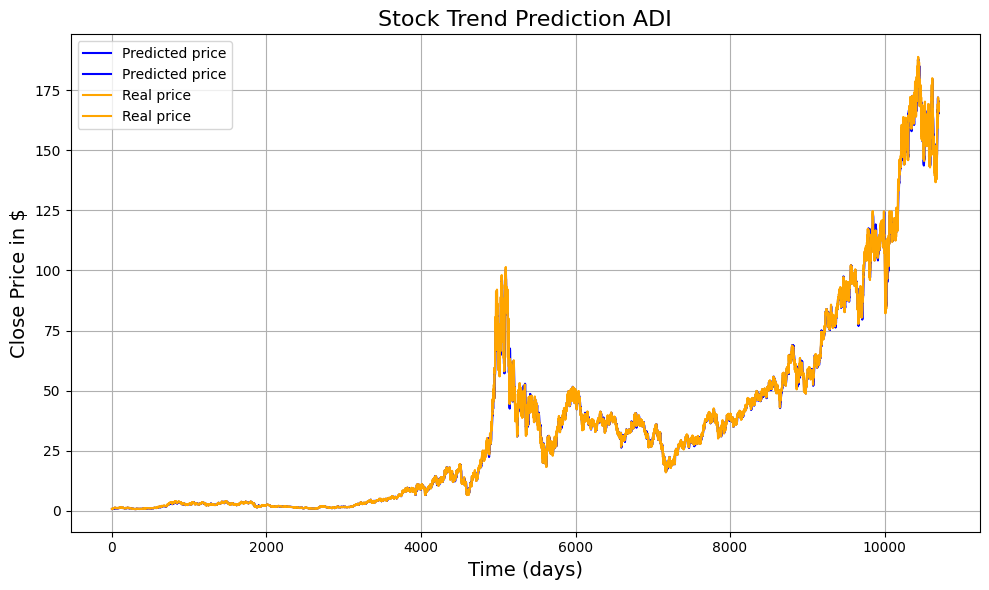

329/329 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.015860174058206666


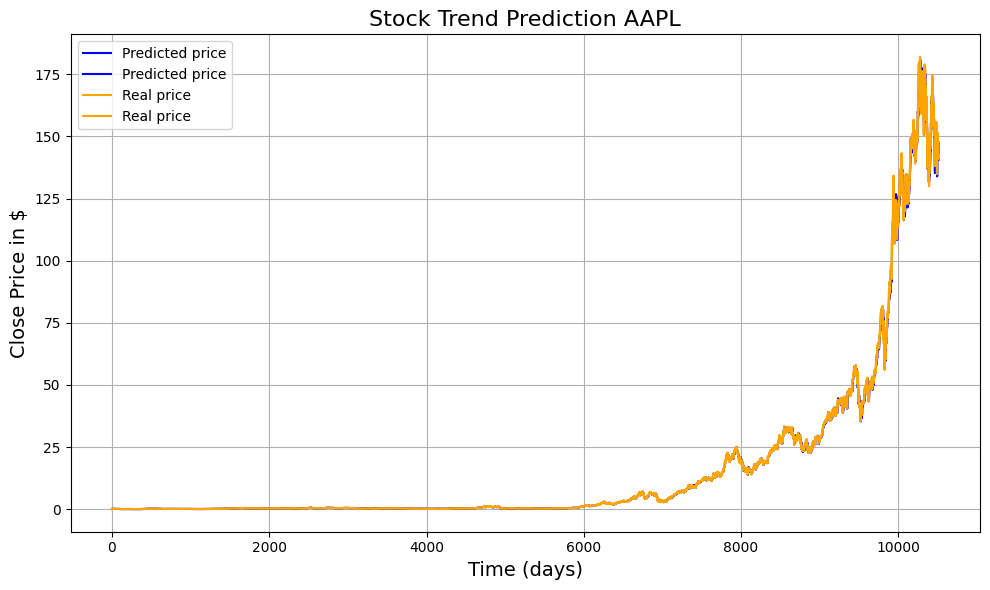

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.018971172090868984


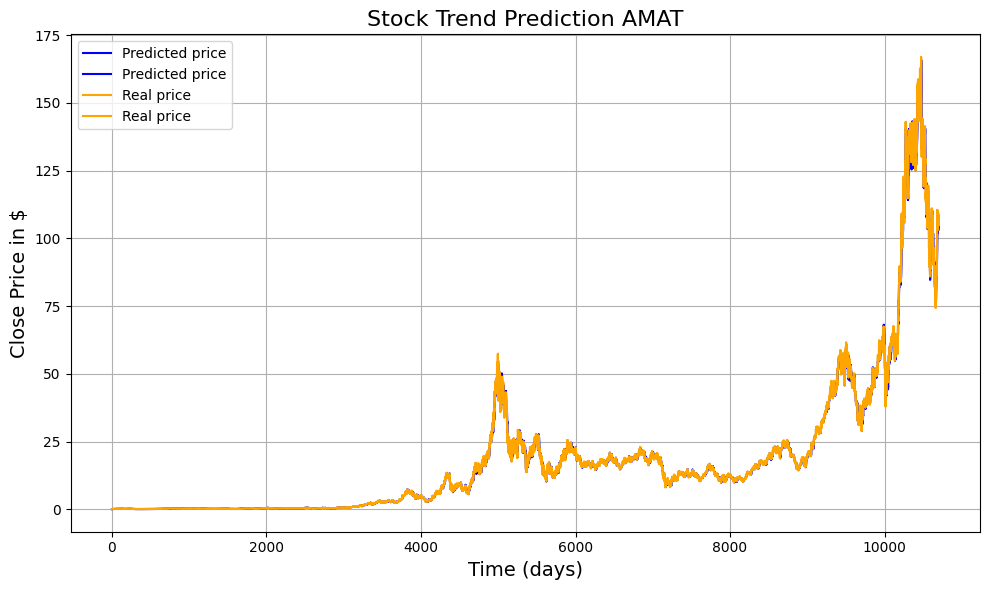

216/216 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.017836584621984217


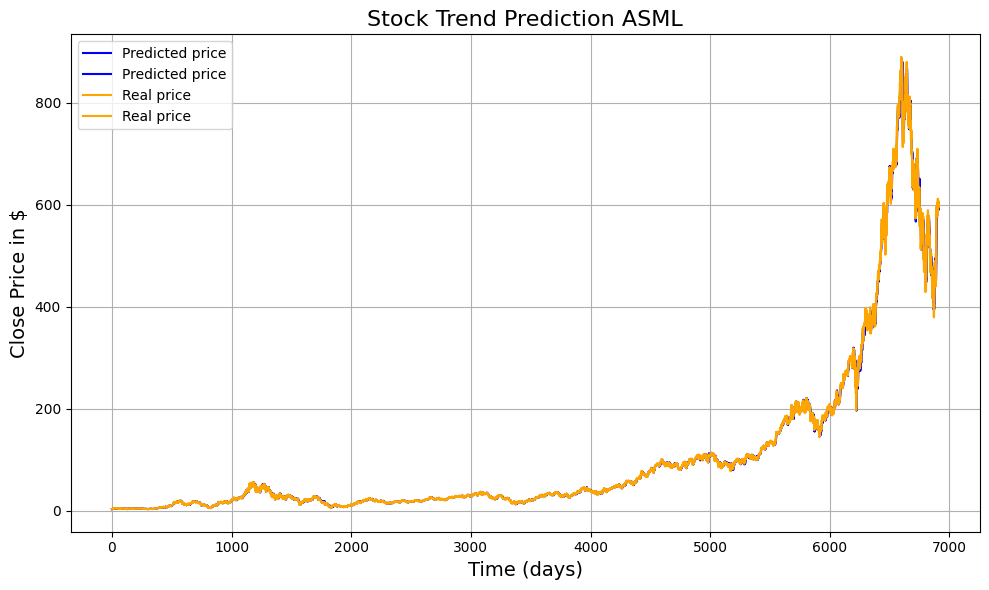

293/293 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.0184003194906696


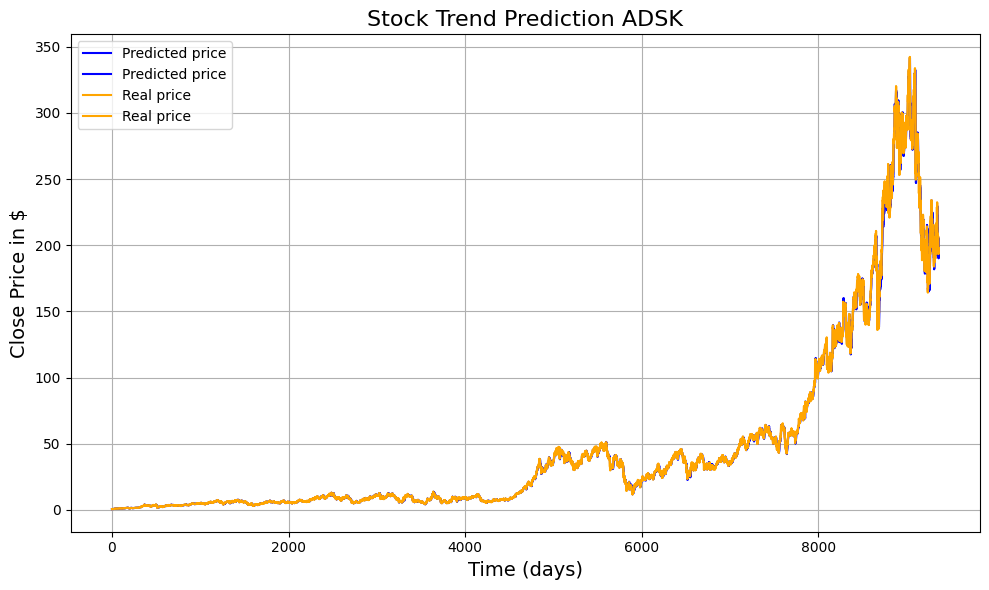

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.021508818550773107


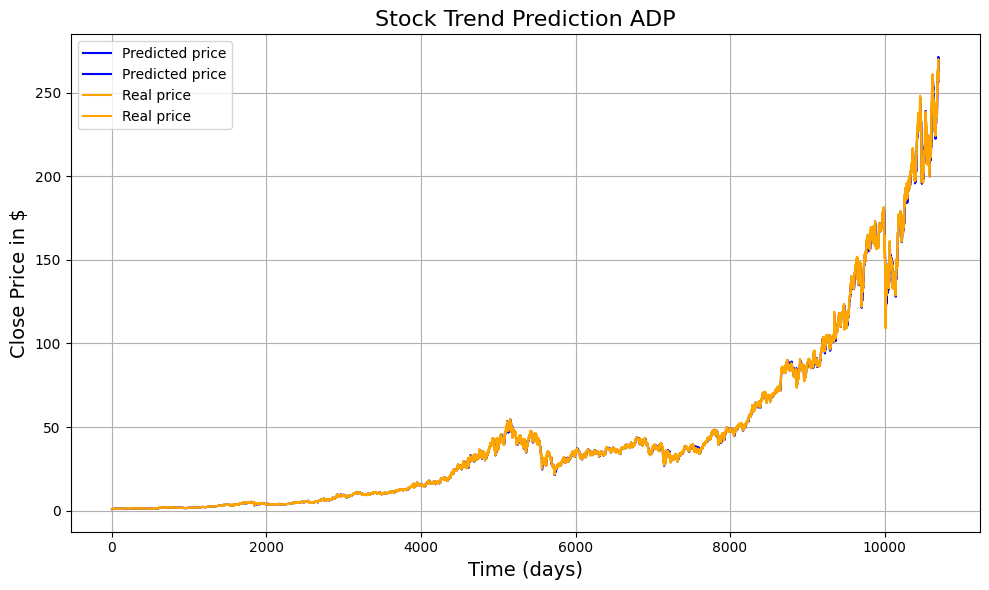

244/244 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.027443385448443616


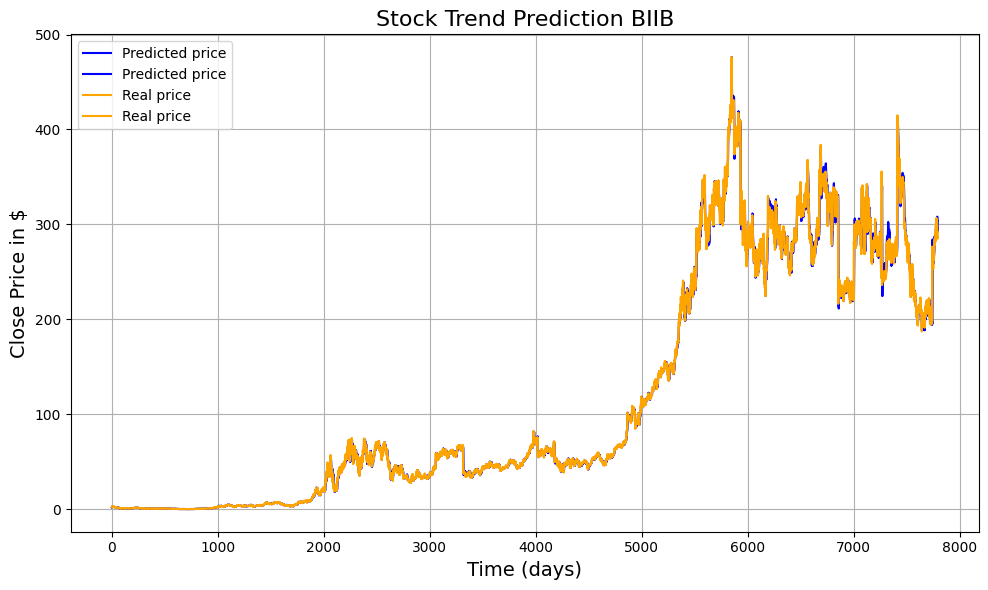

278/278 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.020390235796834584


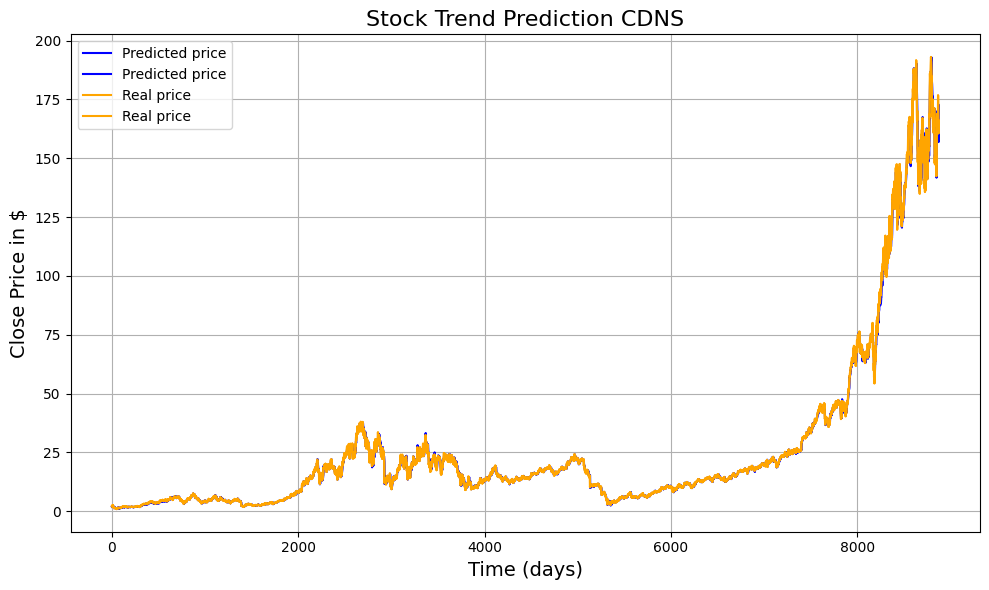

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018972543648425724


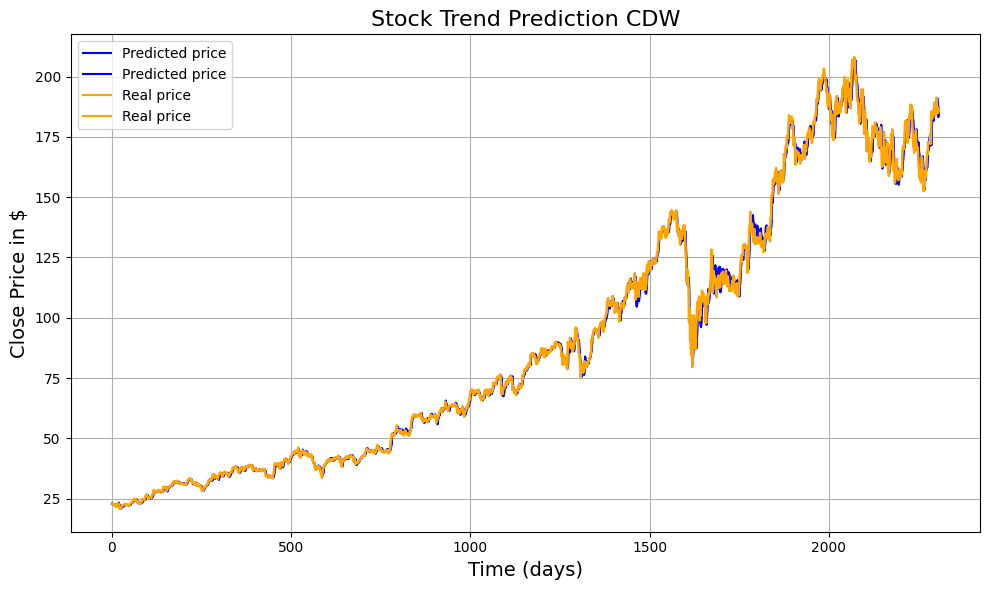

100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01906926416305736


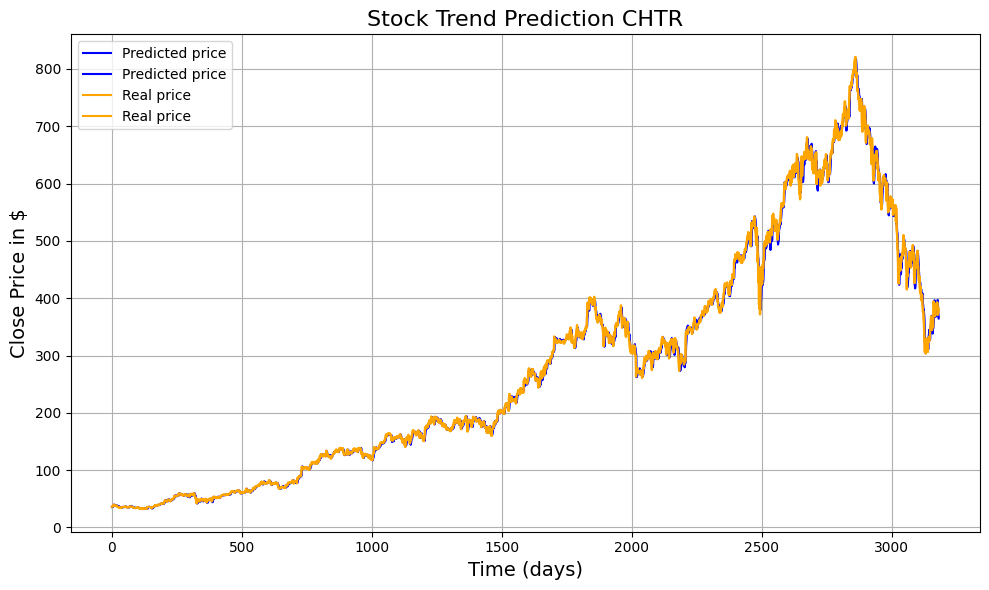

308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.02294254358965407


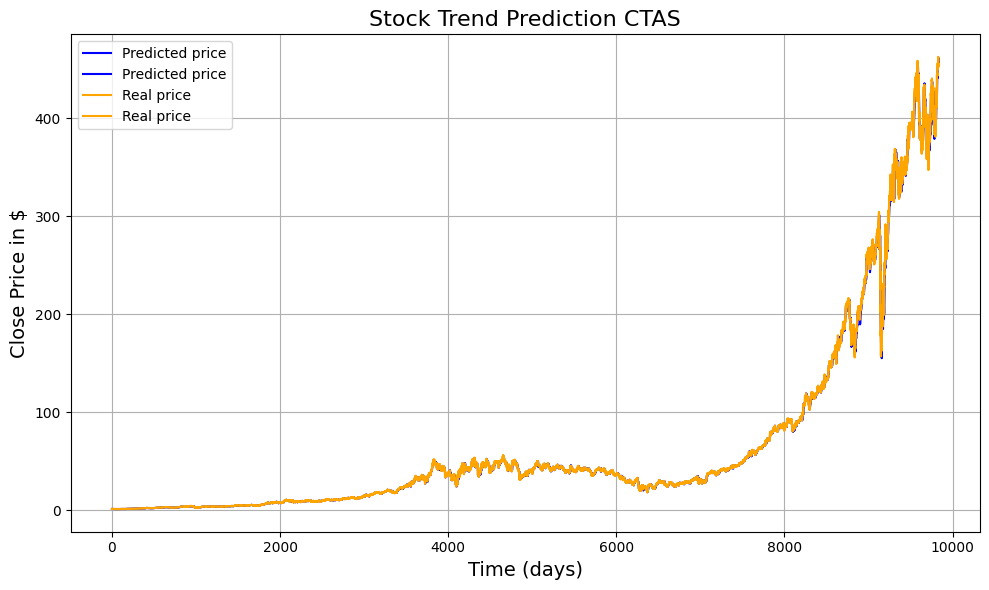

257/257 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.0184507922053377


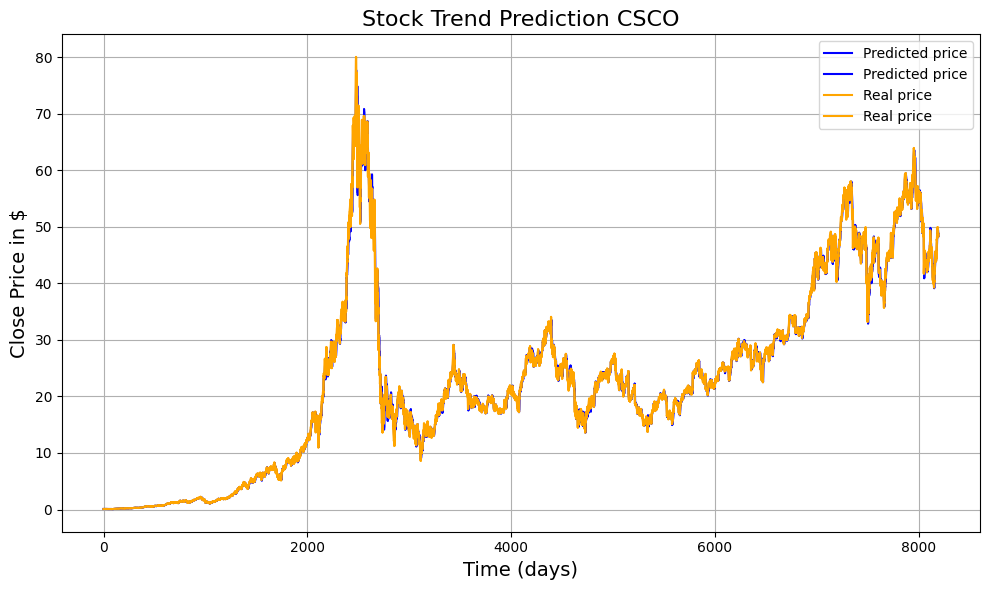

191/191 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02072304486651926


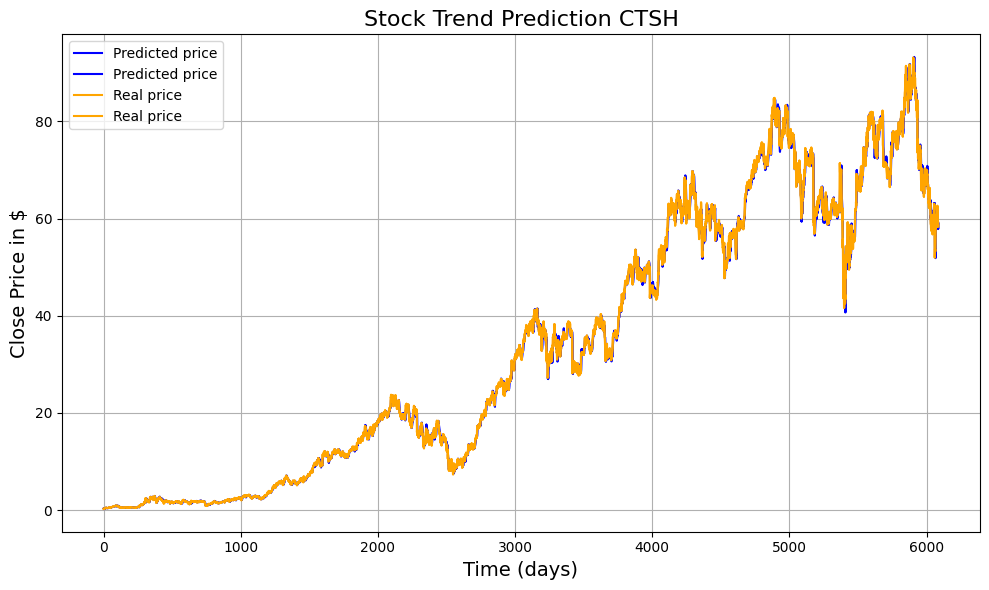

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.02200282276837063


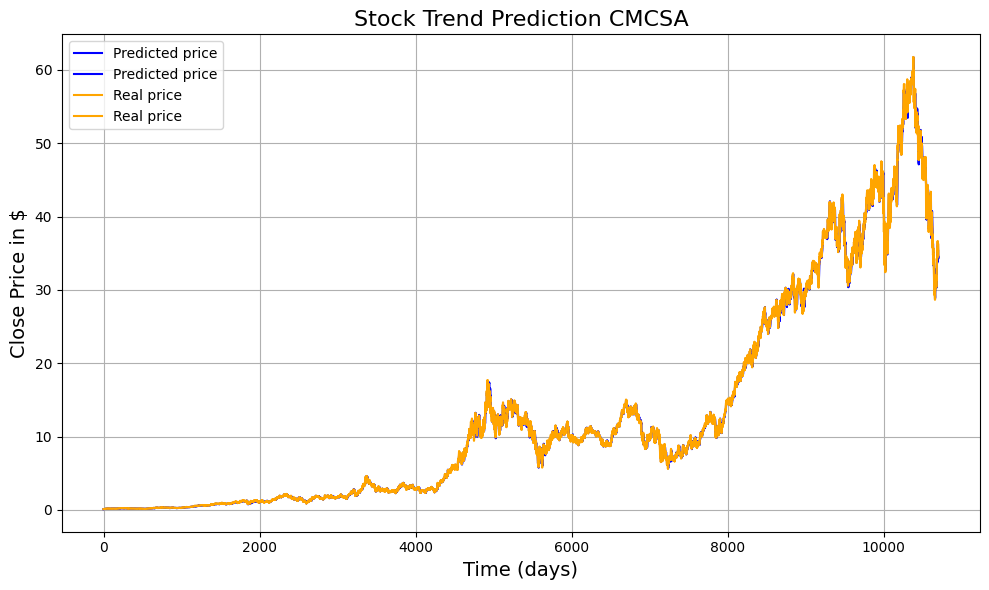

224/224 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020004359919083434


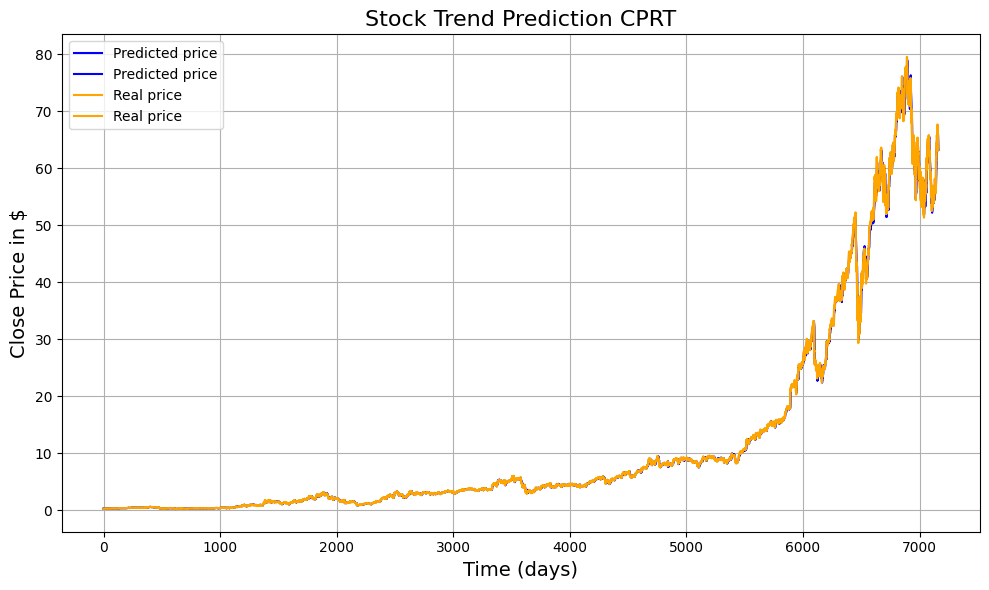

190/190 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01909384321277577


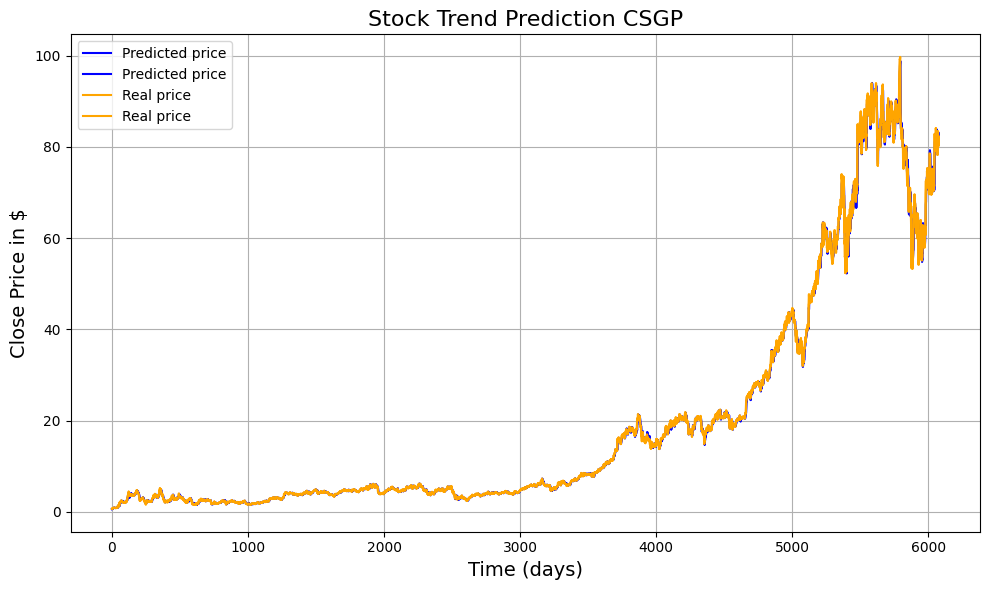

285/285 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020854730764351216


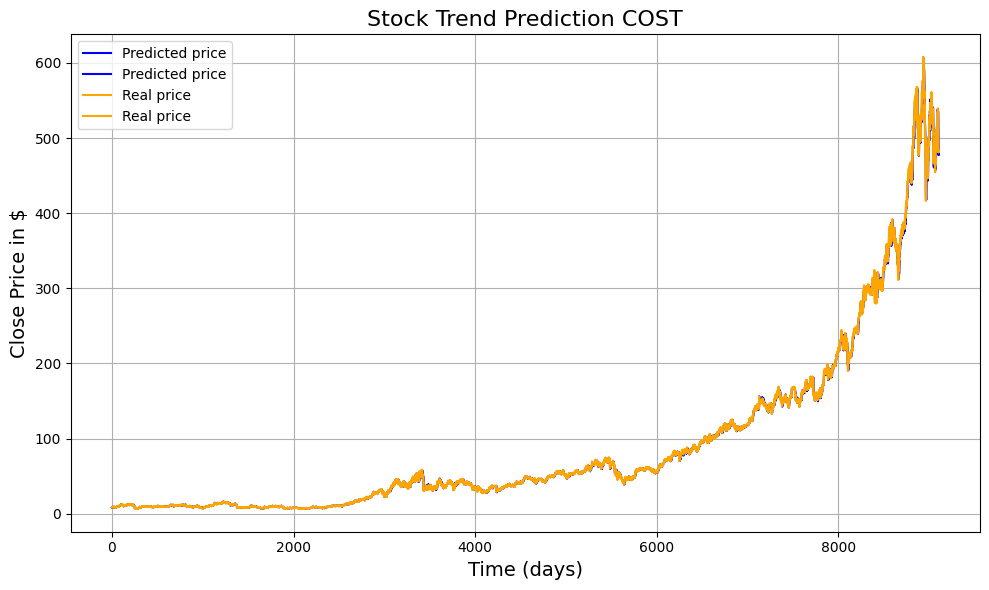

137/137 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018786159884270386


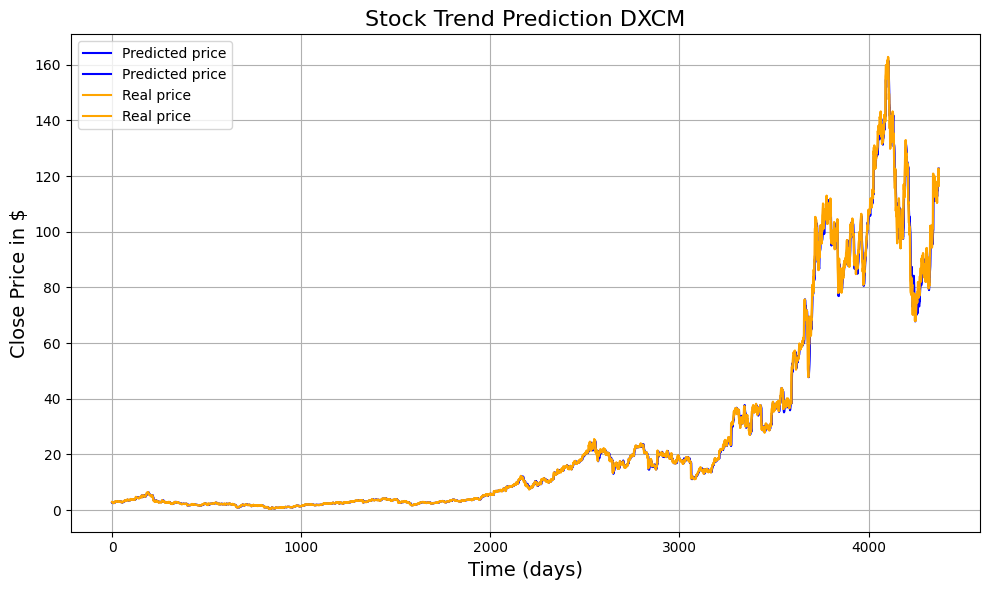

78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01982427900468786


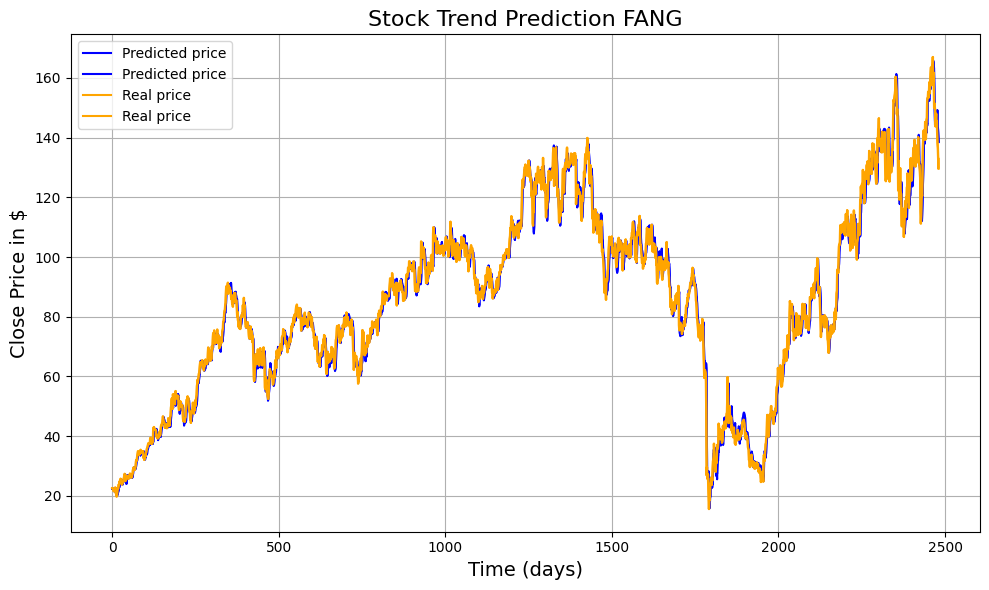

260/260 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01974547509481849


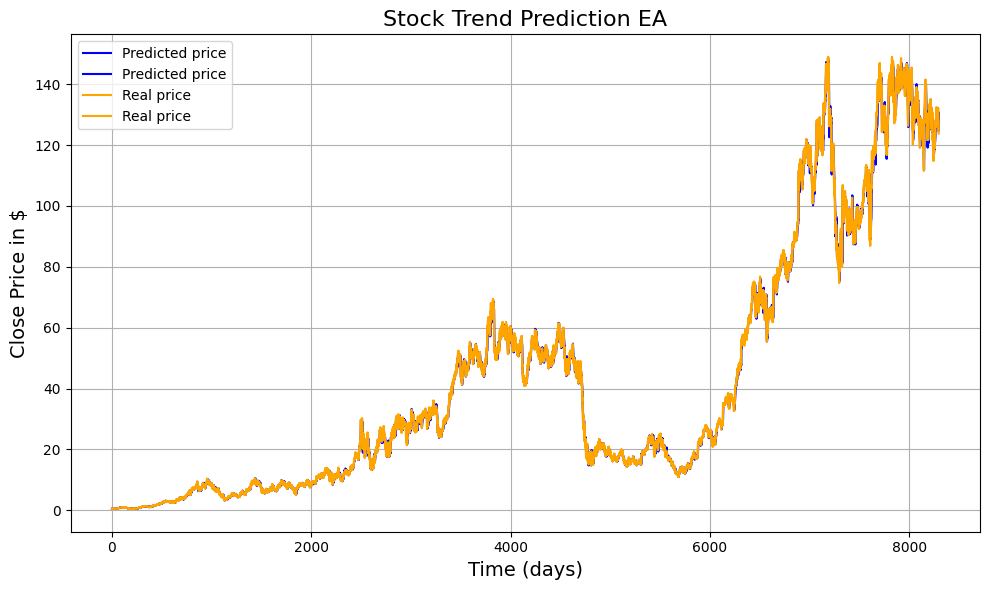

276/276 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020769921835143


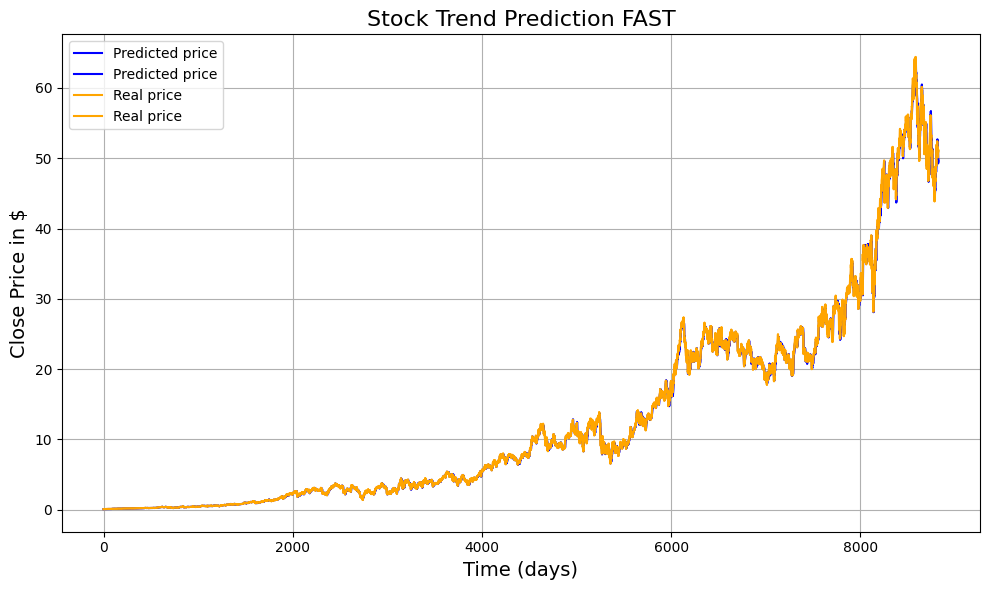

101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018848596866050553


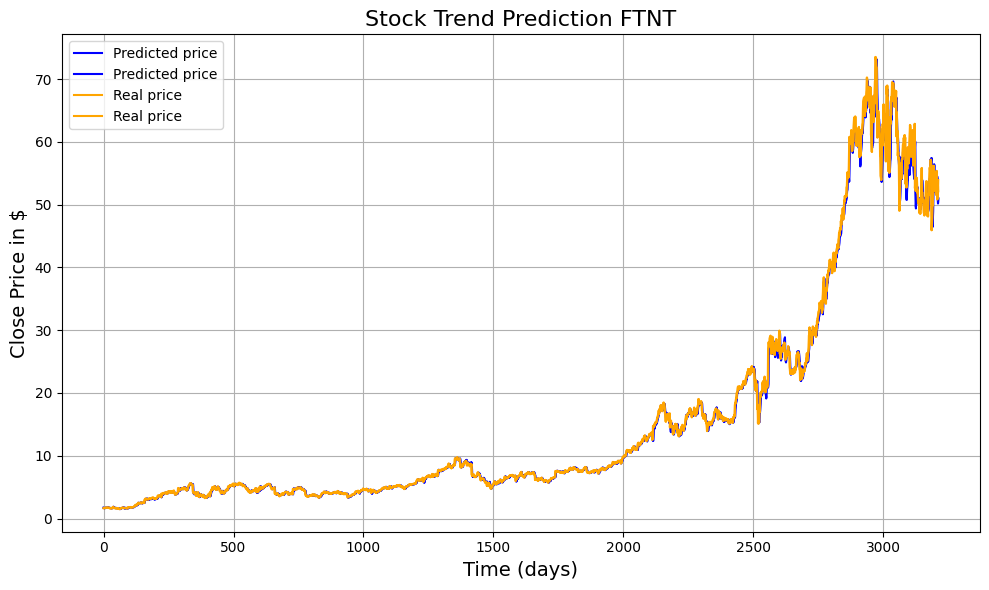

241/241 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020571116732602715


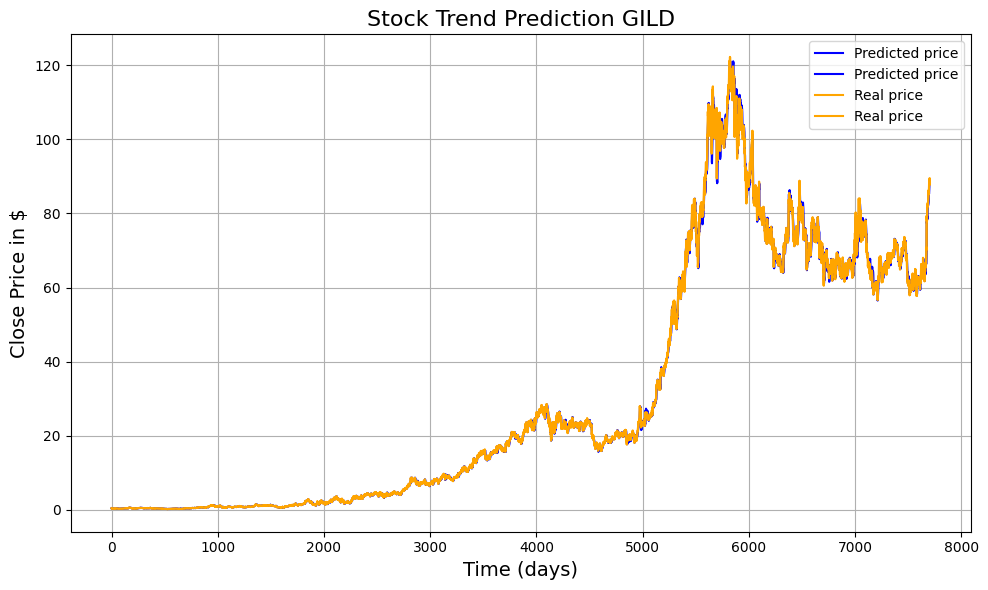

246/246 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020821077300097537


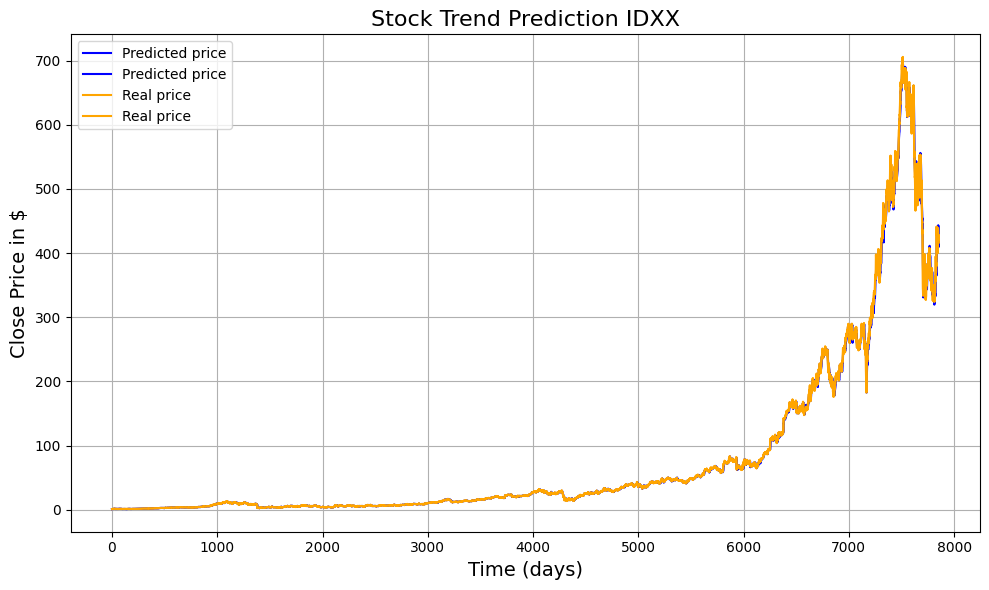

174/174 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.017966242634748986


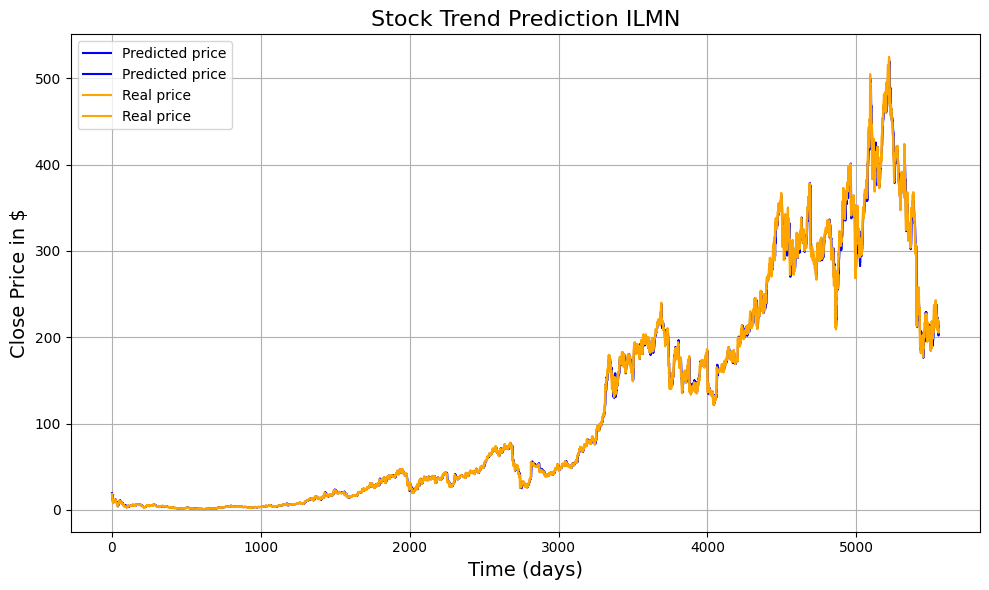

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.0179076963529022


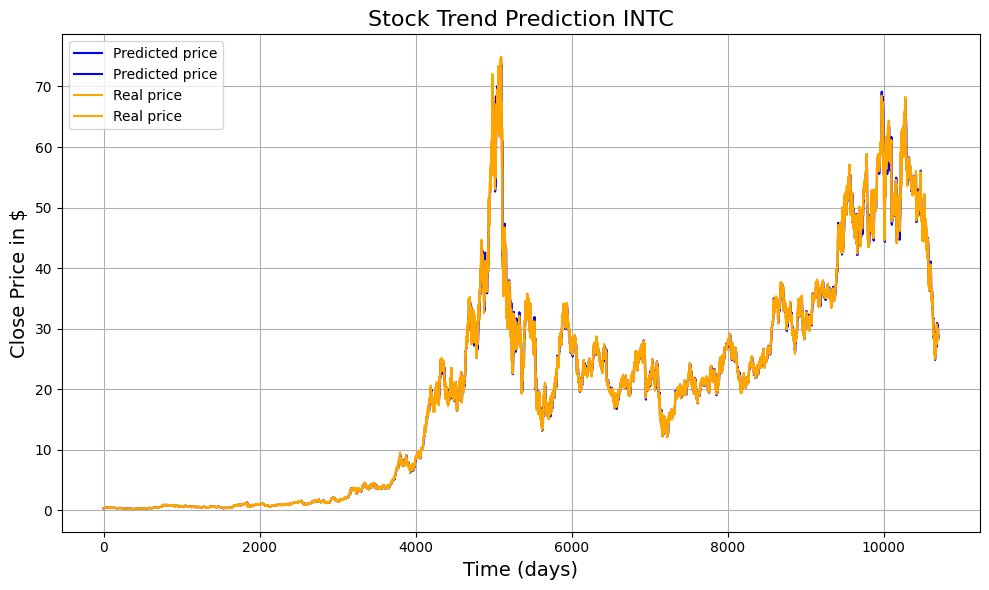

232/232 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02102121992778864


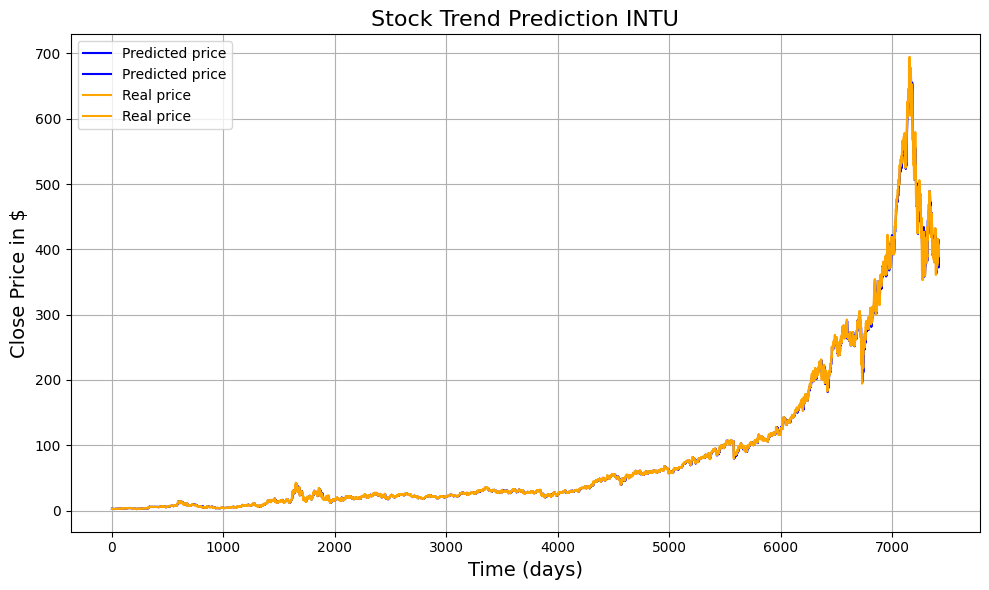

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02061130191452963


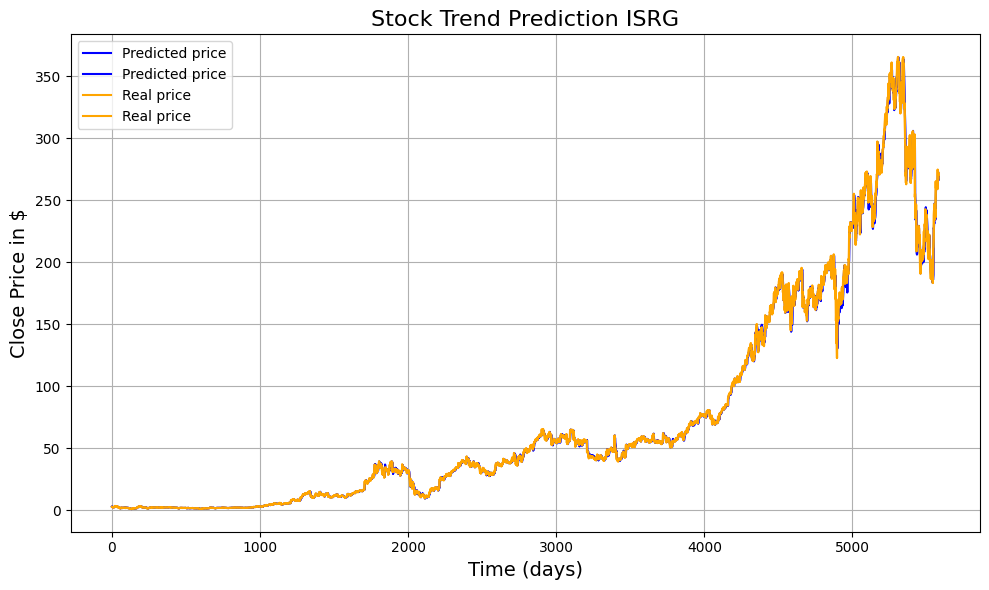

302/302 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020436735088969284


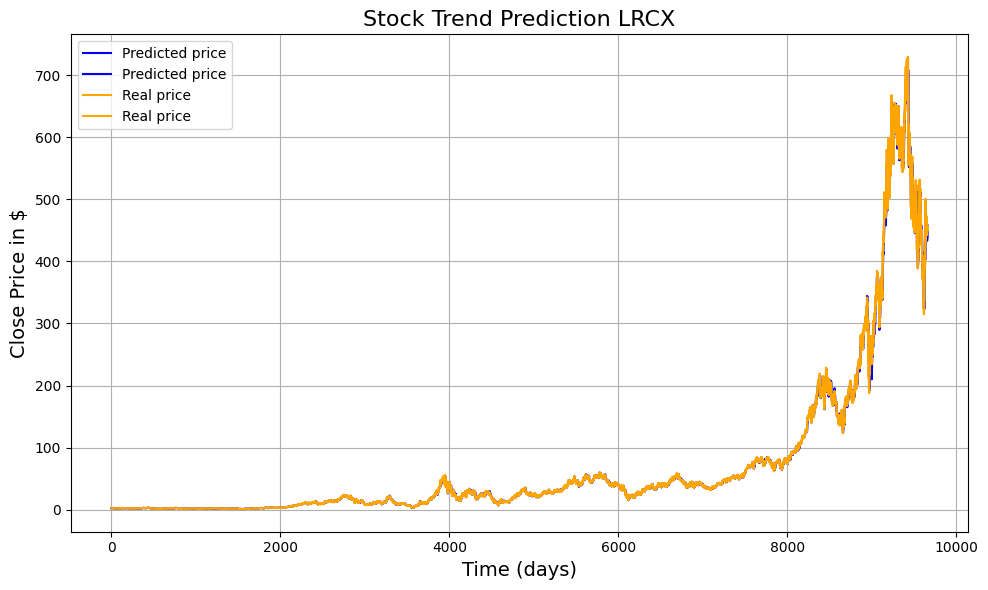

119/119 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018142774937347103


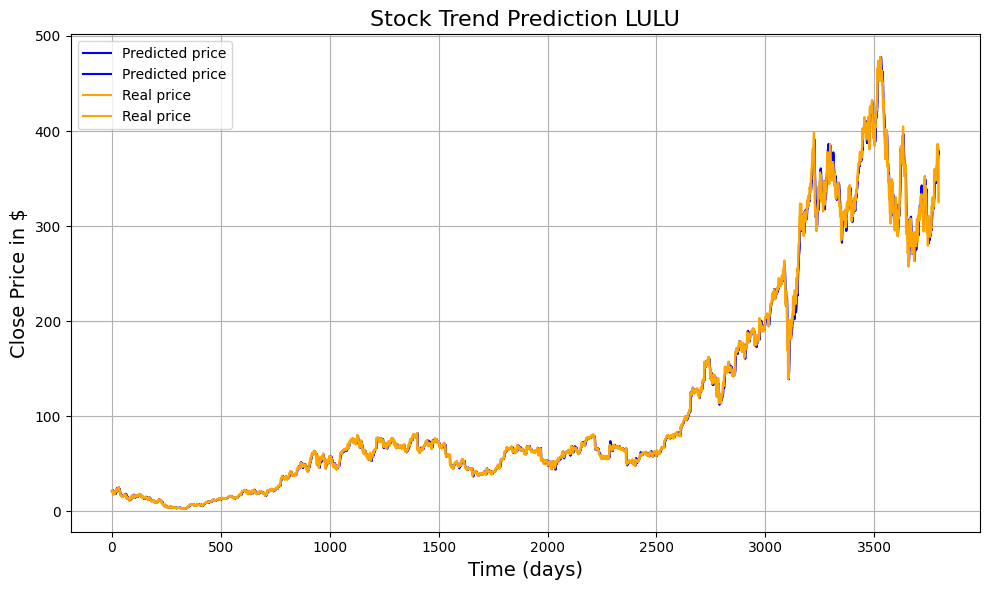

193/193 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.01841070993828746


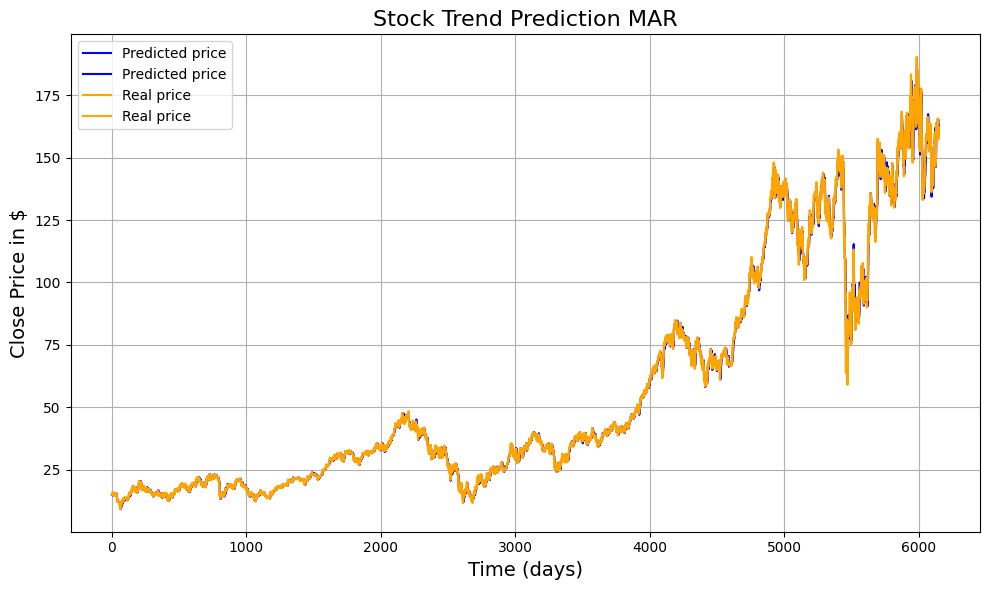

175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018004251336998085


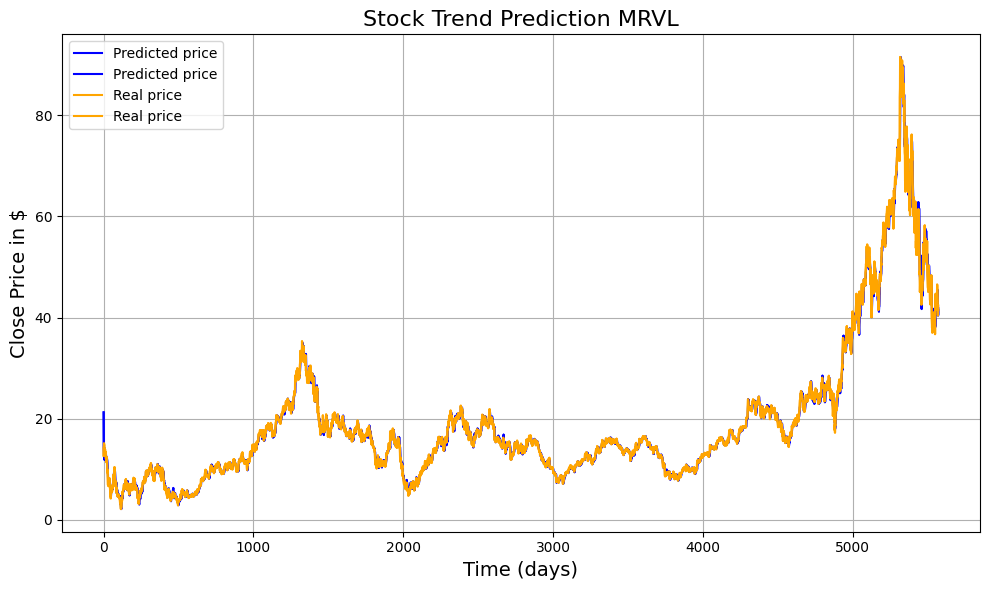

119/119 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.017103229803003175


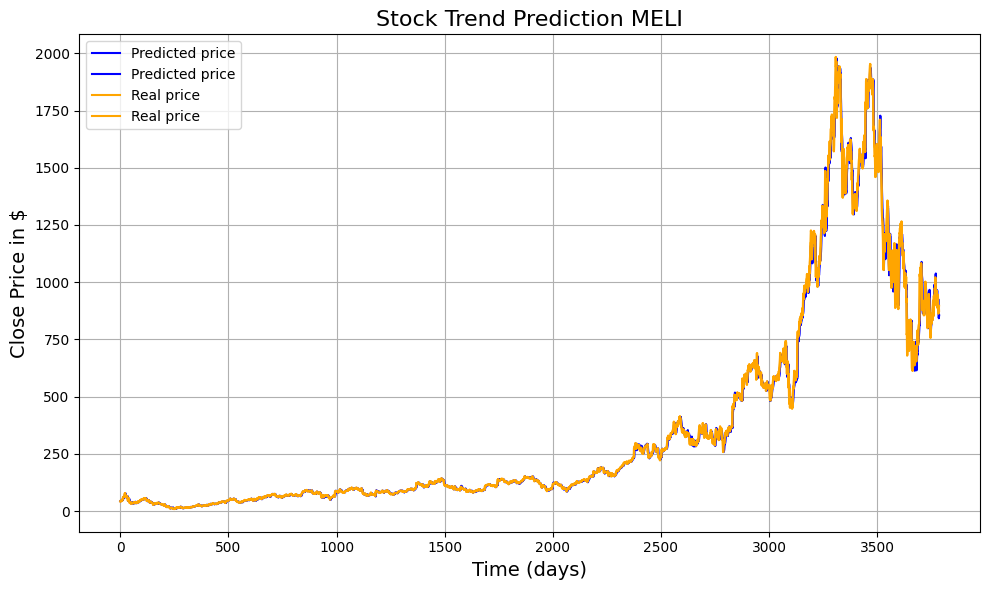

232/232 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02075478824378986


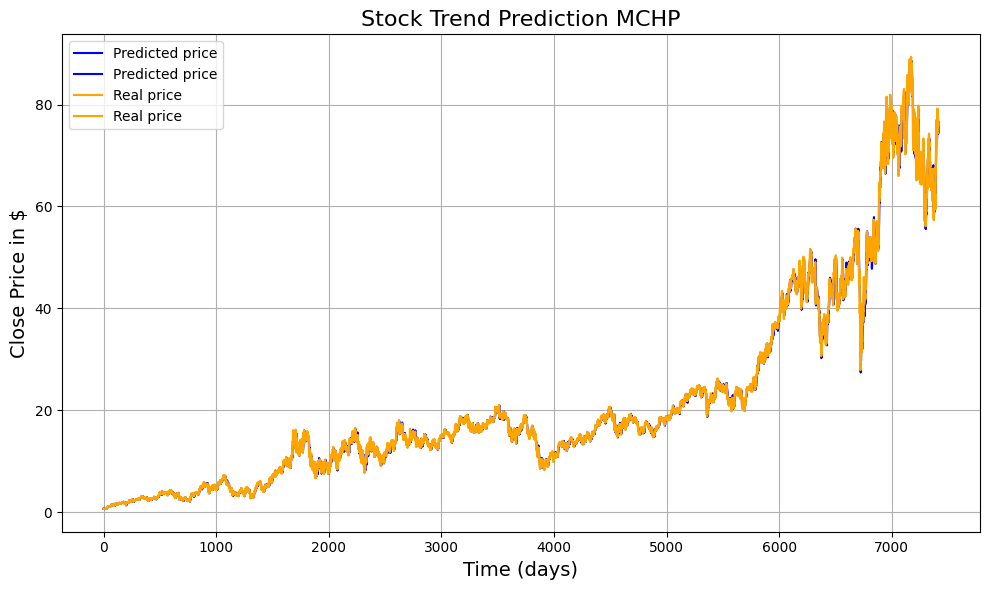

302/302 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.01788555076618273


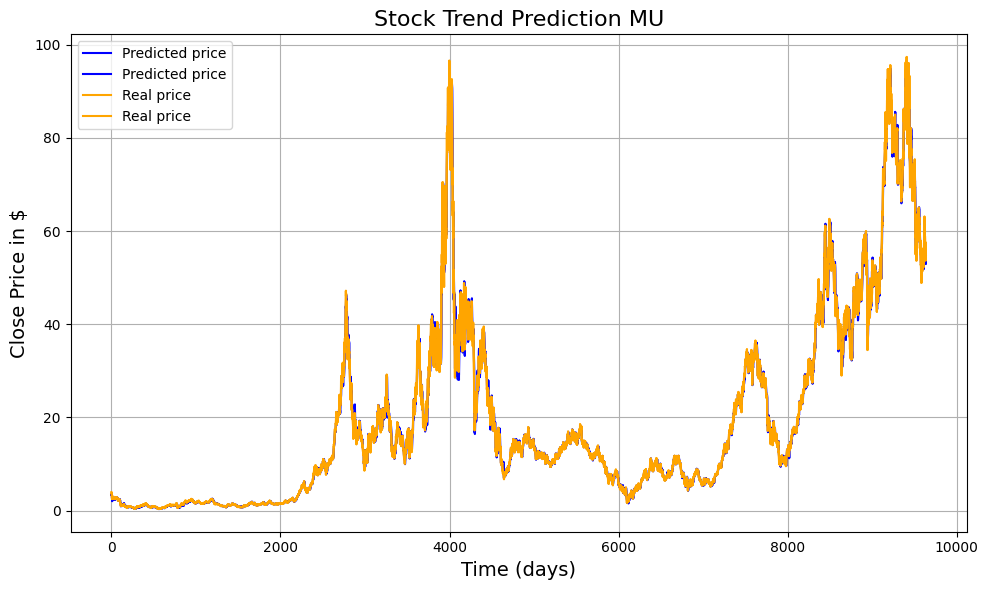

288/288 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.018510102935064443


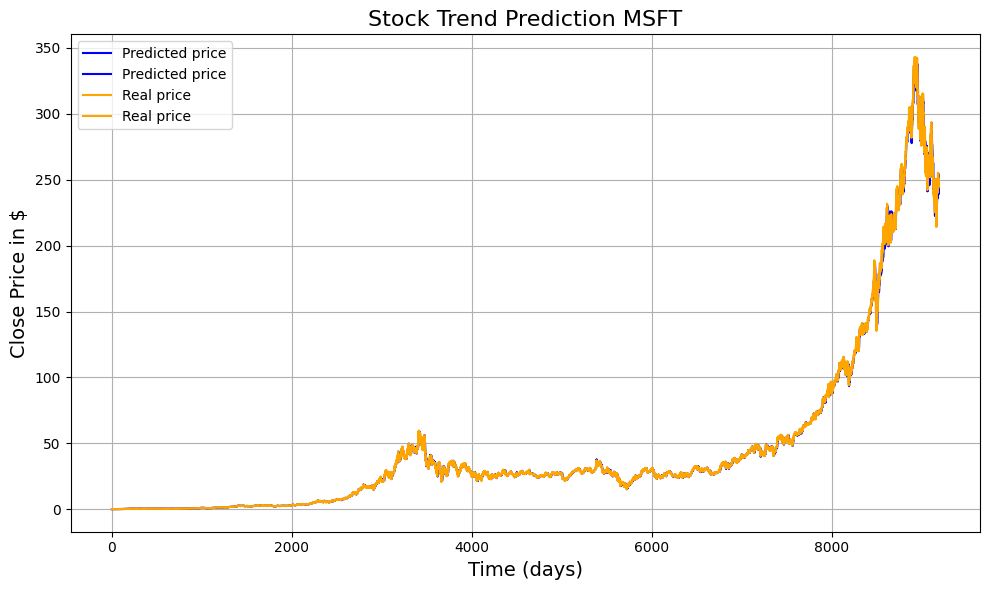

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02288959934805384


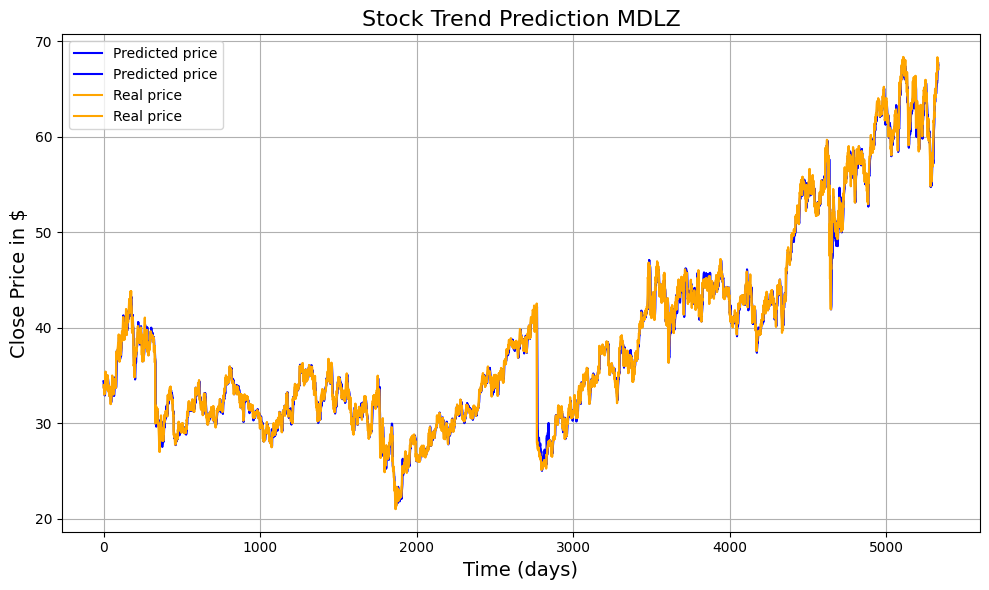

290/290 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.02584328410050176


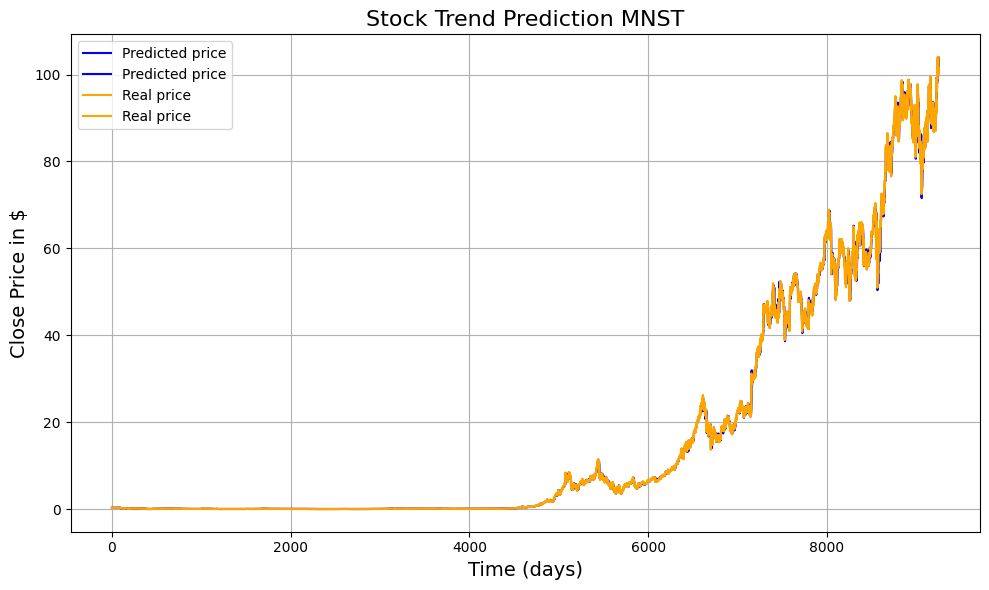

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.018580895636242344


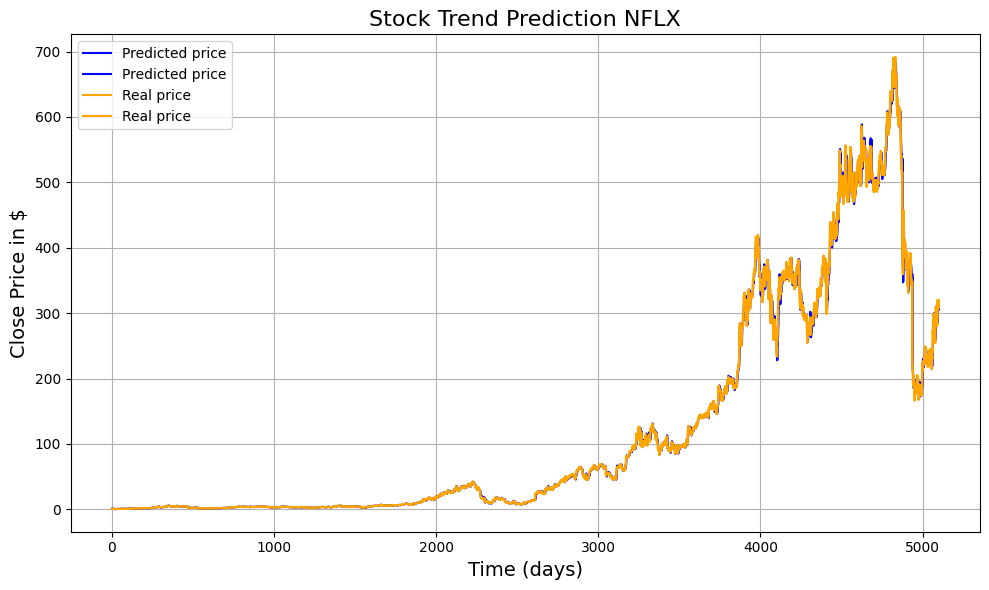

186/186 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.017615085028258183


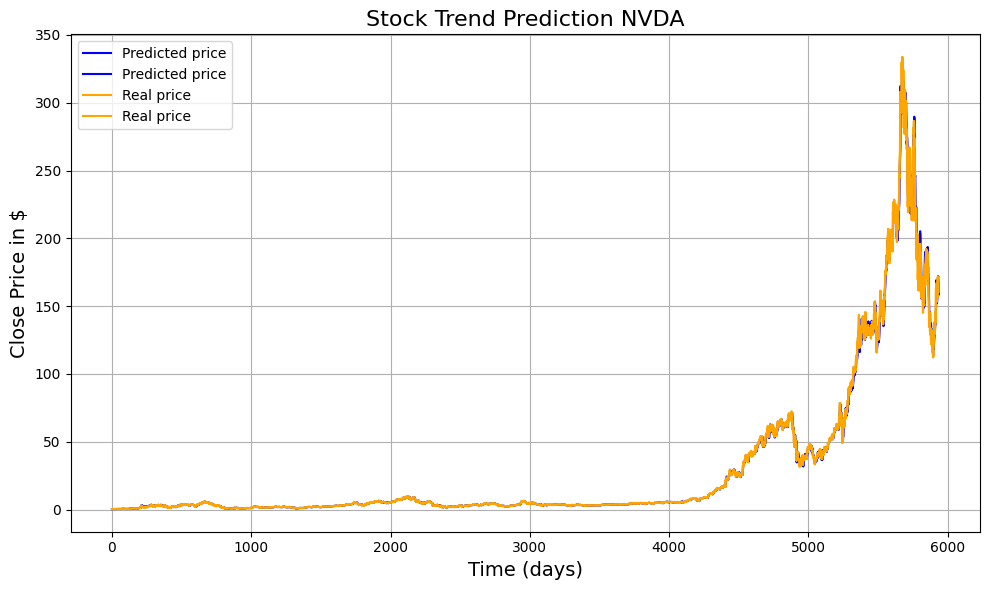

95/95 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.019466455580798386


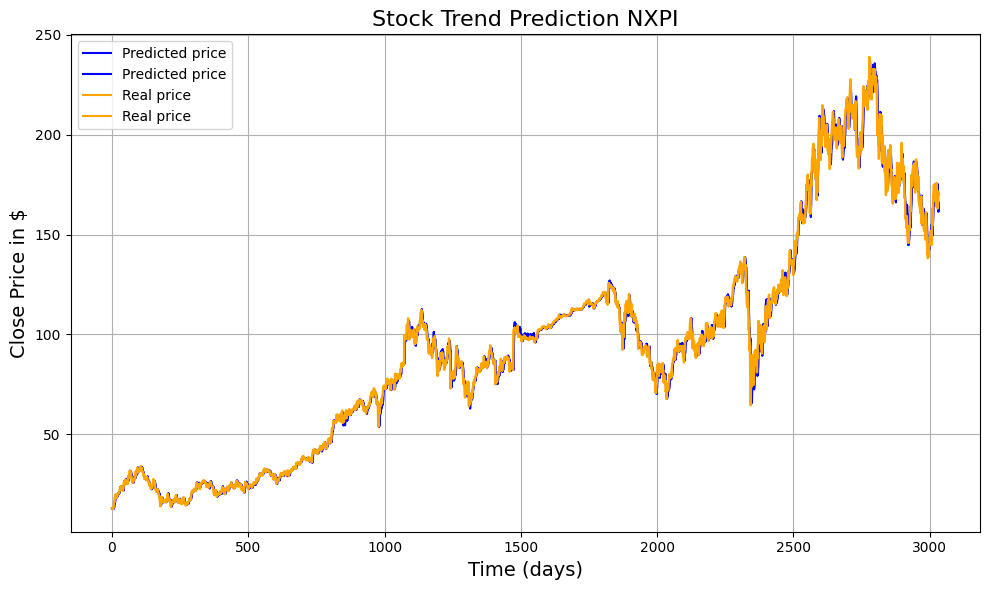

231/231 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02038251949066079


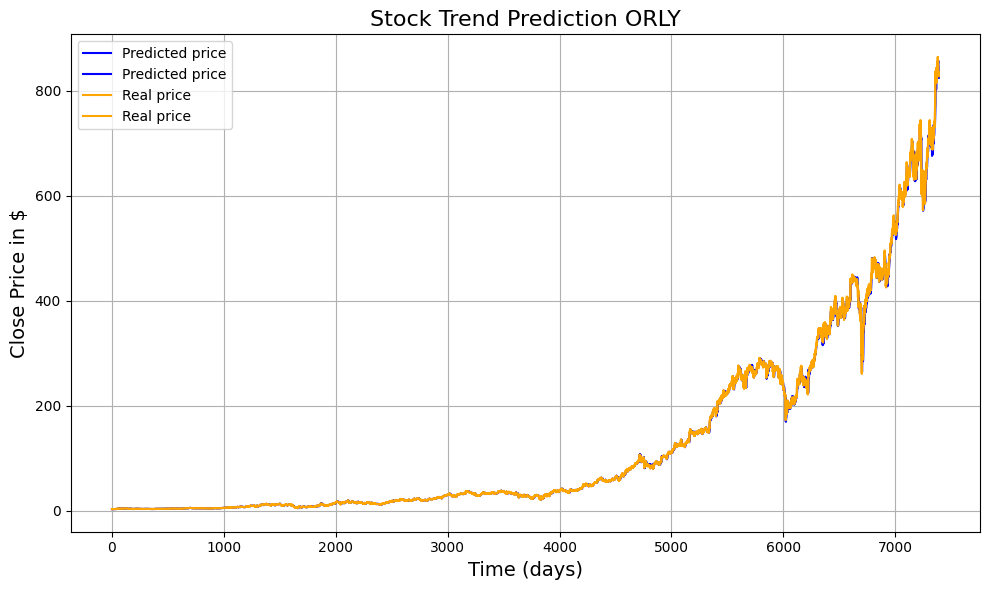

243/243 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02401958519618226


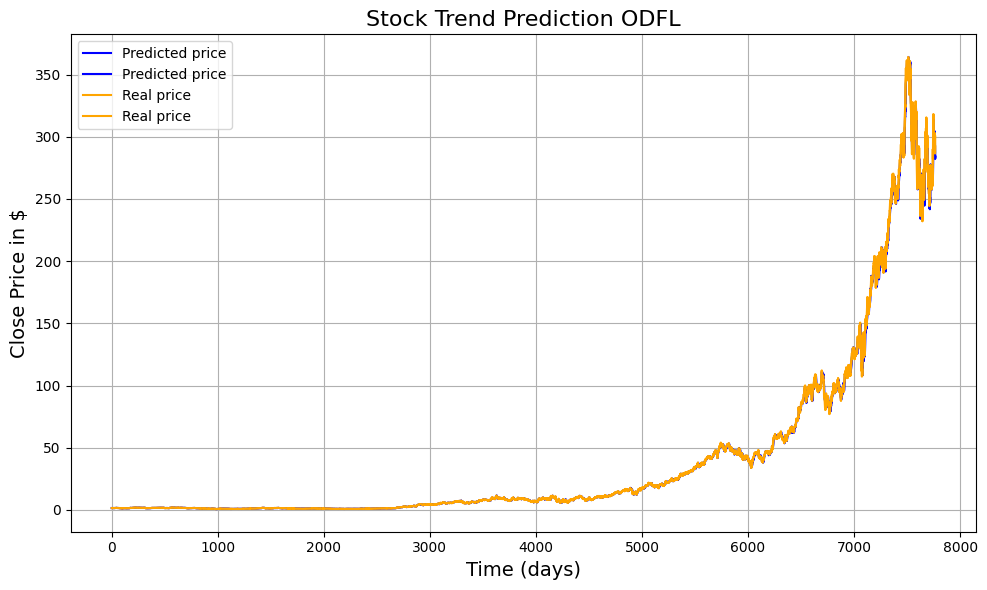

176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.0176564507700478


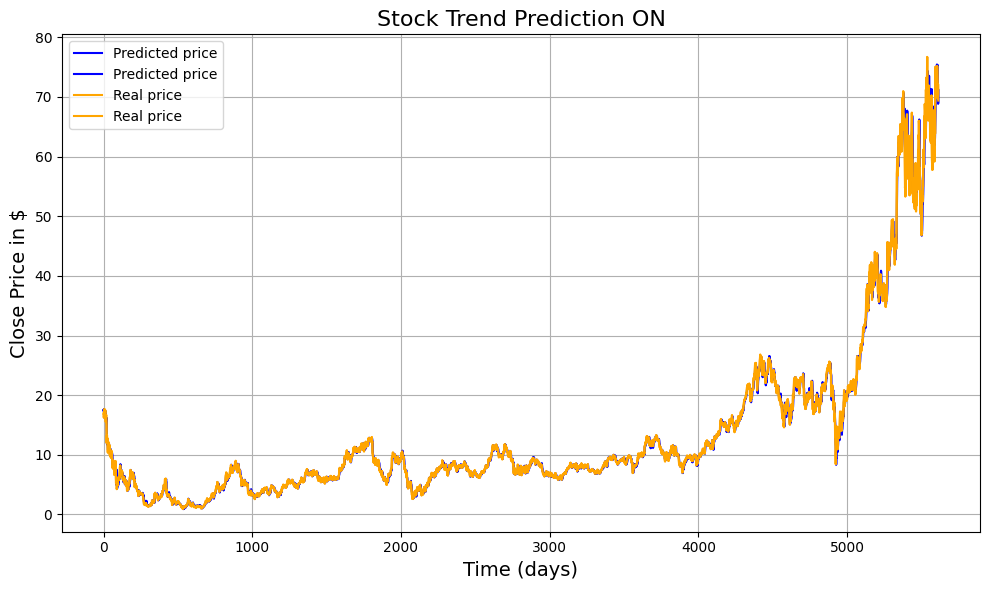

335/335 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.021495064527265025


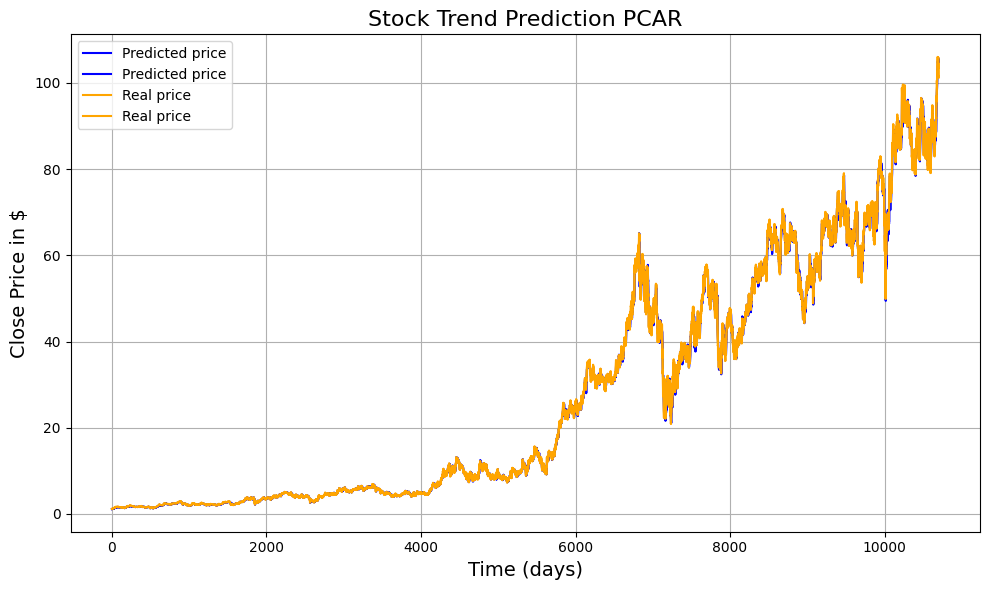

308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.02042789713364347


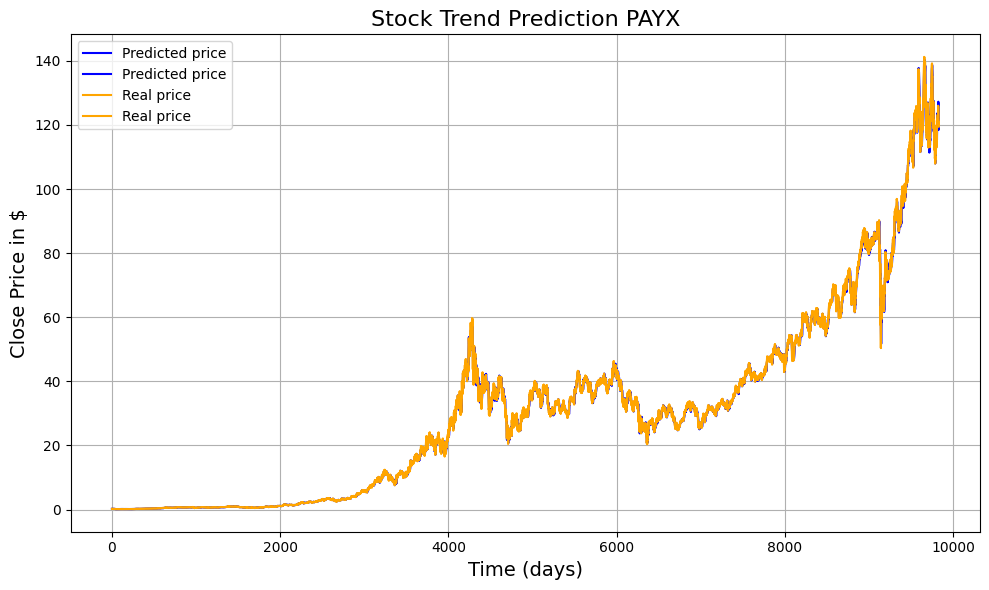

242/242 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.019977889694825432


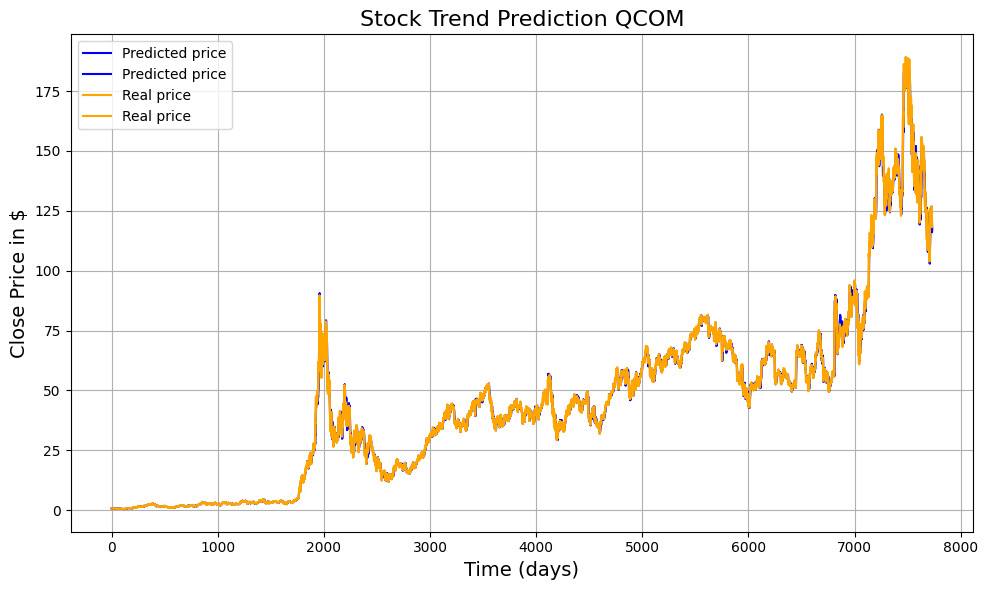

248/248 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.0207100759812969


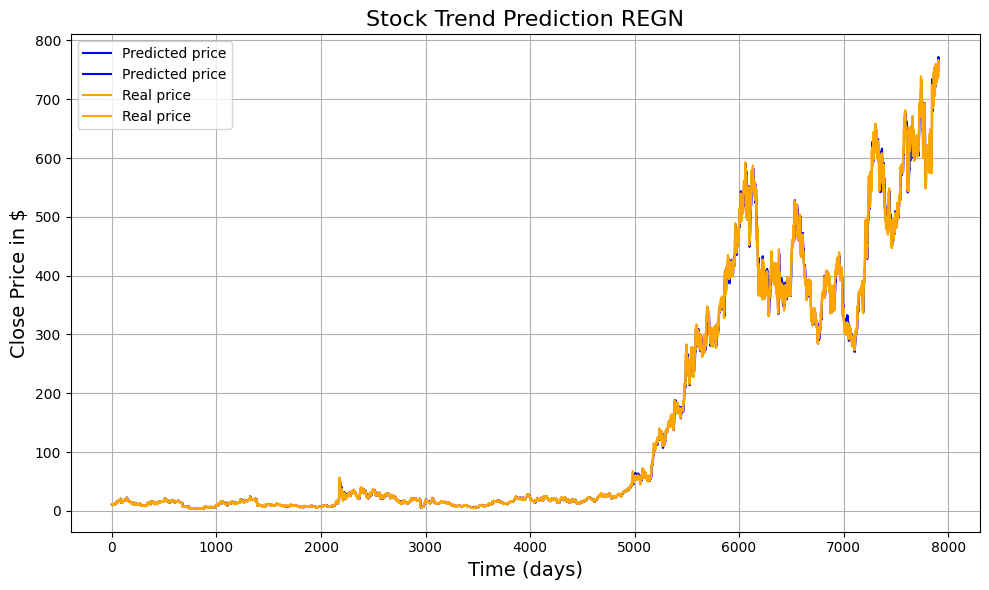

292/292 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.01834958379537773


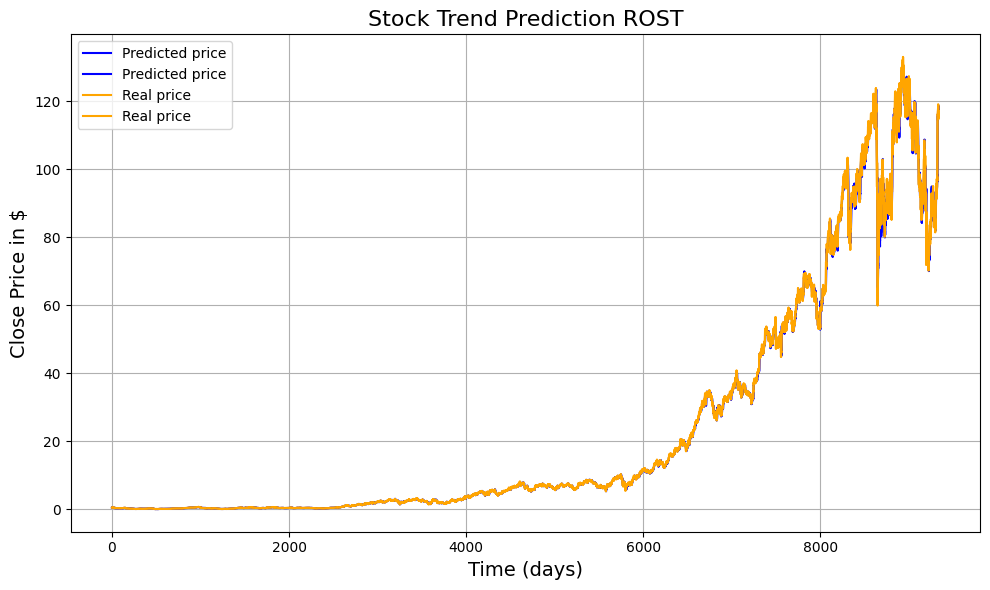

238/238 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.0183227869461683


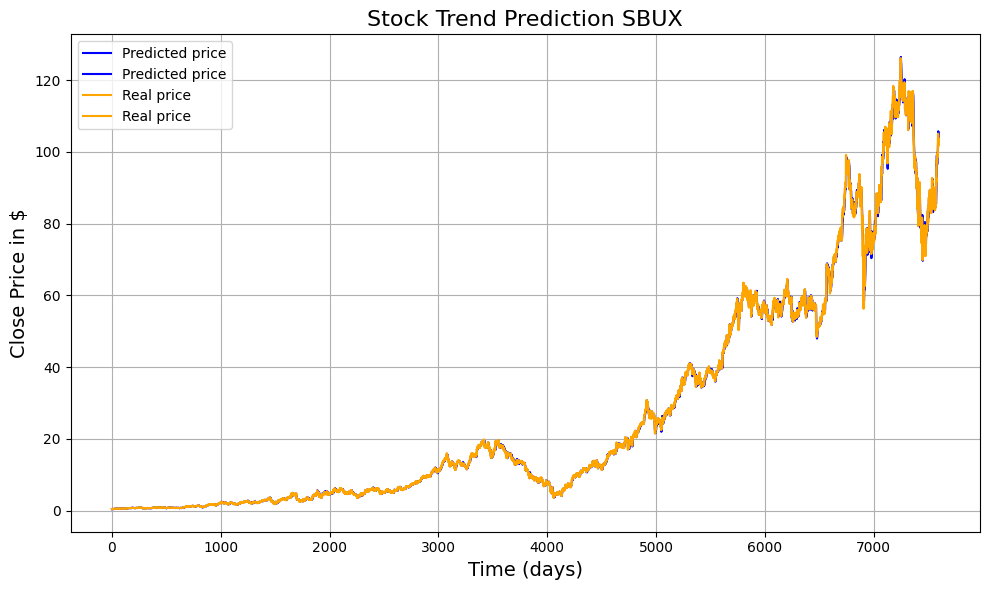

122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020505783872668968


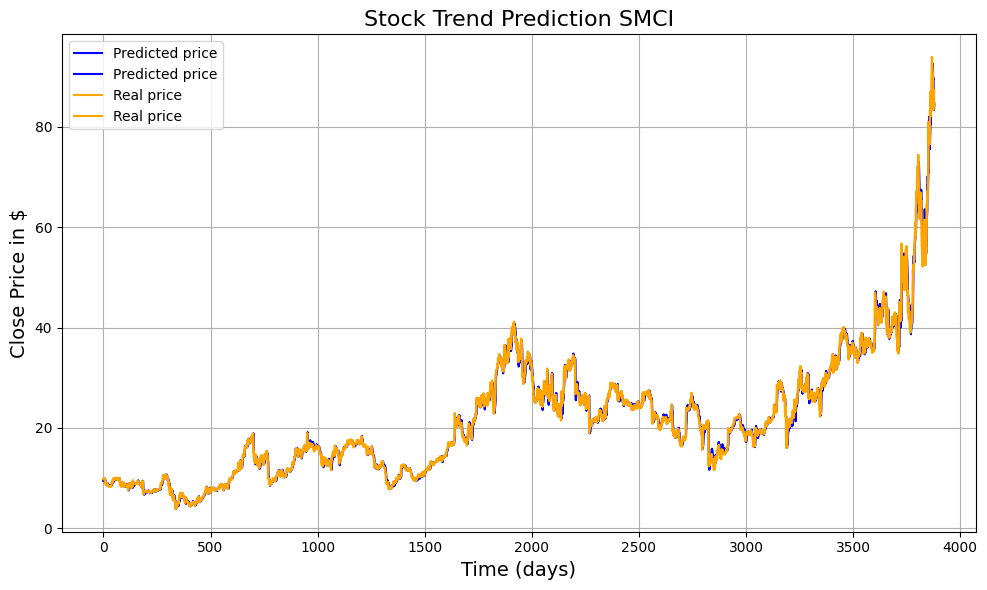

241/241 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.020050645468652945


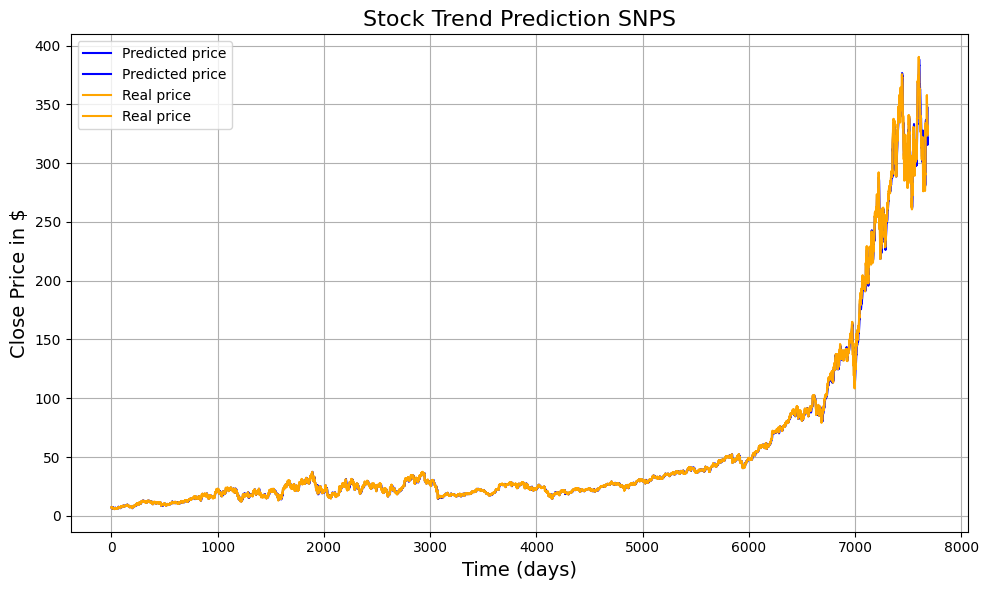

396/396 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MSE on the test set:  0.0177668560140183


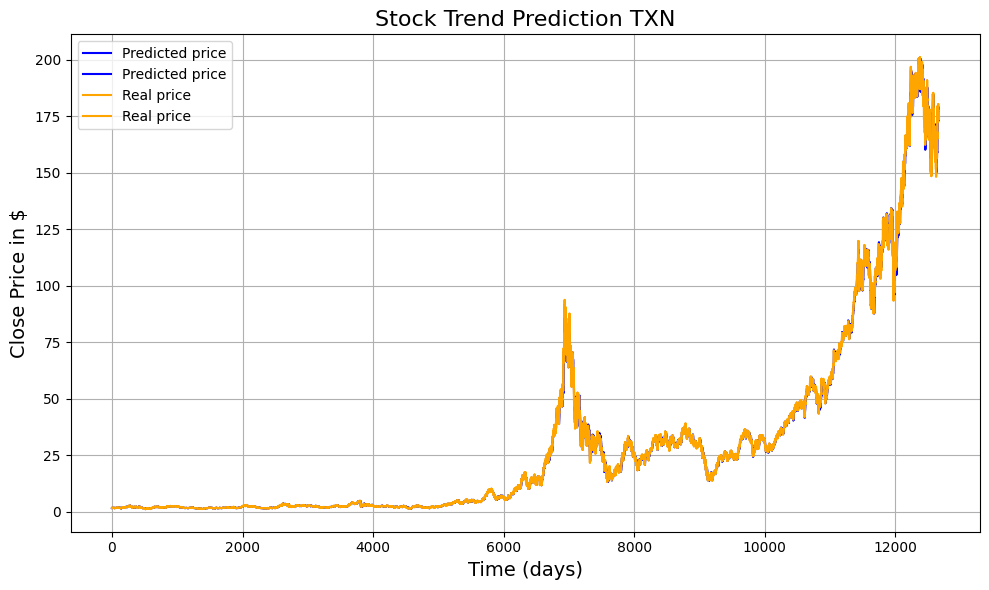

102/102 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.02327583983904718


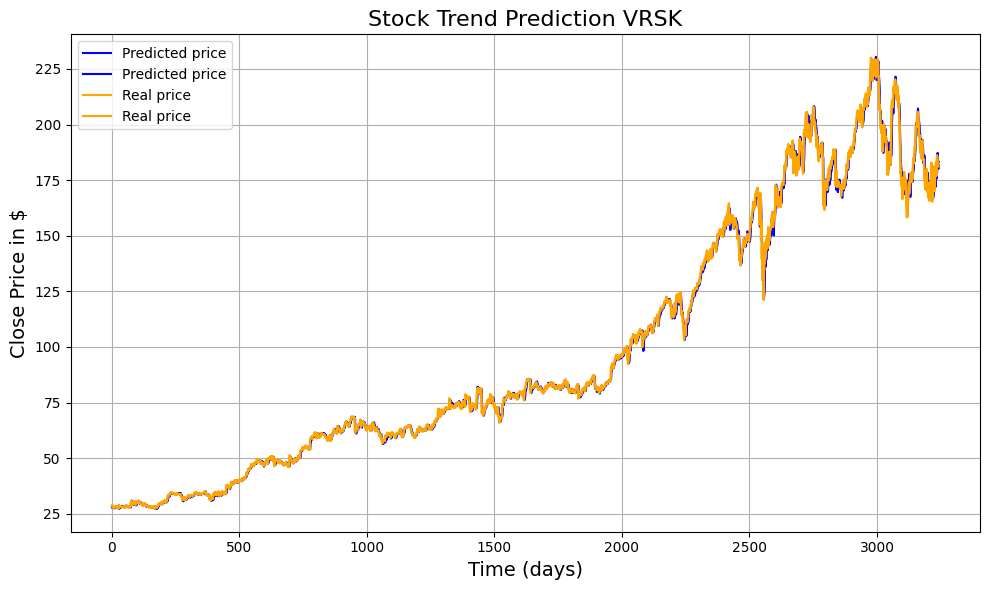

245/245 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MSE on the test set:  0.022912461095510143


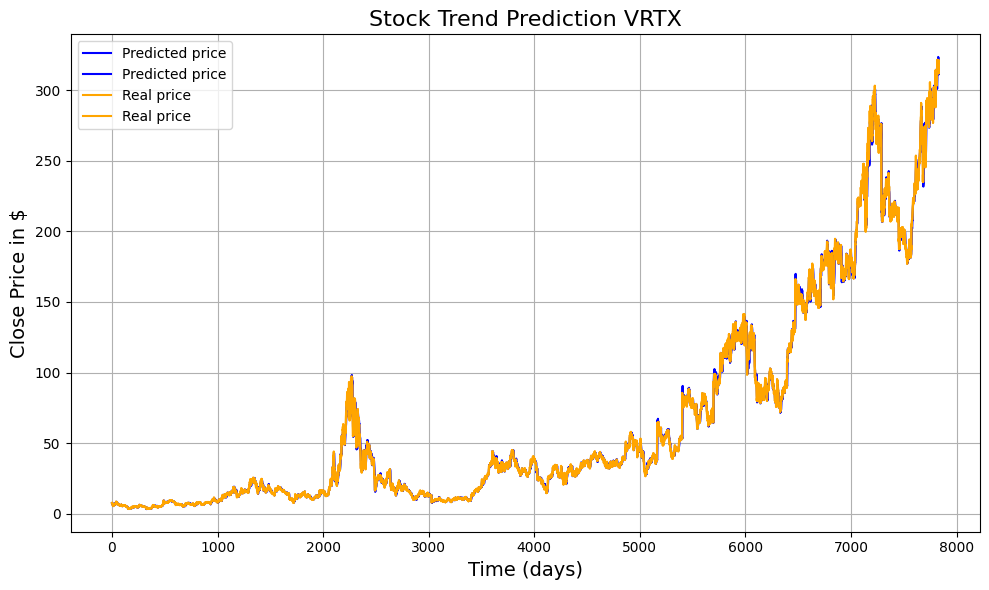

In [48]:
conv1d_test_3 = tf.keras.models.load_model('1dcnn_dayrange.keras')

# Load all data first
(all_X_data, all_y_data,
all_X_data_norm, all_y_data_norm,
all_X_data_norm_t, all_y_data_norm_t,
all_feature_choice_indices) = load_all_data(
    nasqad100,
    features,
    window_size=window_size,
    k_days=k_days,
    feature_choice='Close',
    type=2
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        conv1d_test_3,
        all_X_data_norm_t[stock],
        all_y_data_norm[stock],
        all_X_data[stock],
        all_y_data[stock],
        all_feature_choice_indices[stock],
        stock
    )

#### LSTM

284/284 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
MSE on the test set:  0.014462745193128373


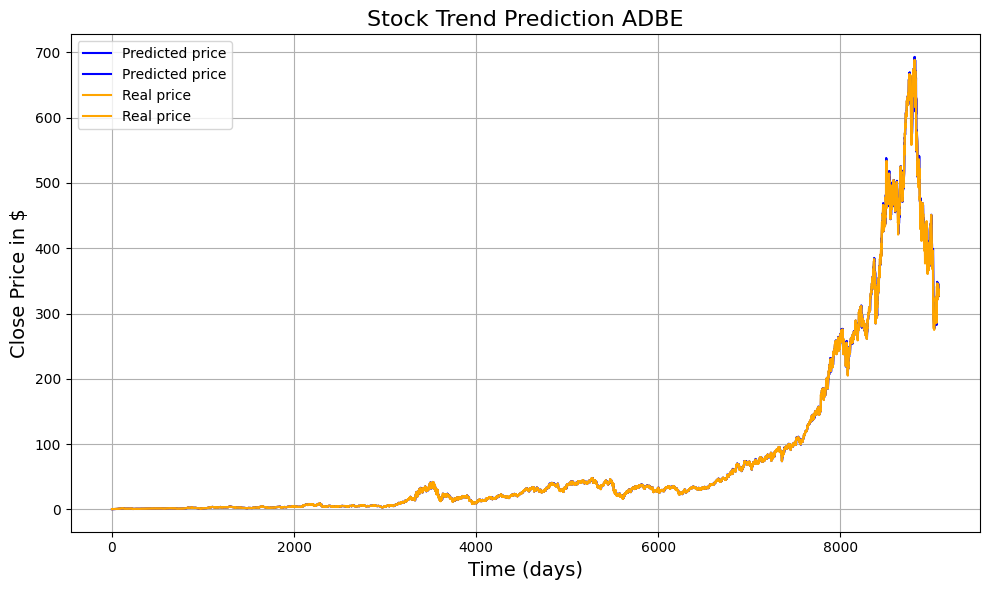

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.01299749181958717


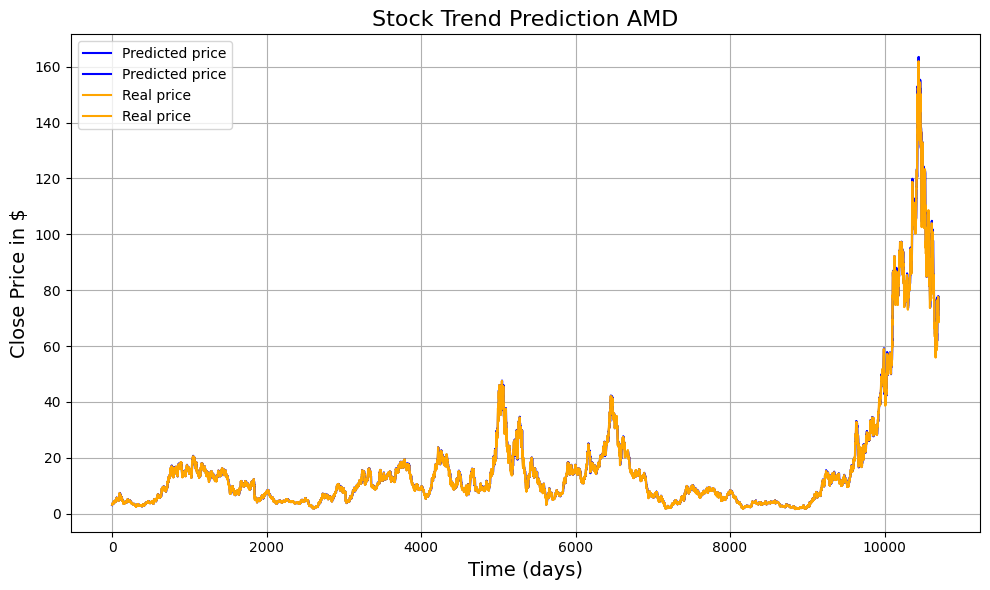

199/199 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.015134978410920187


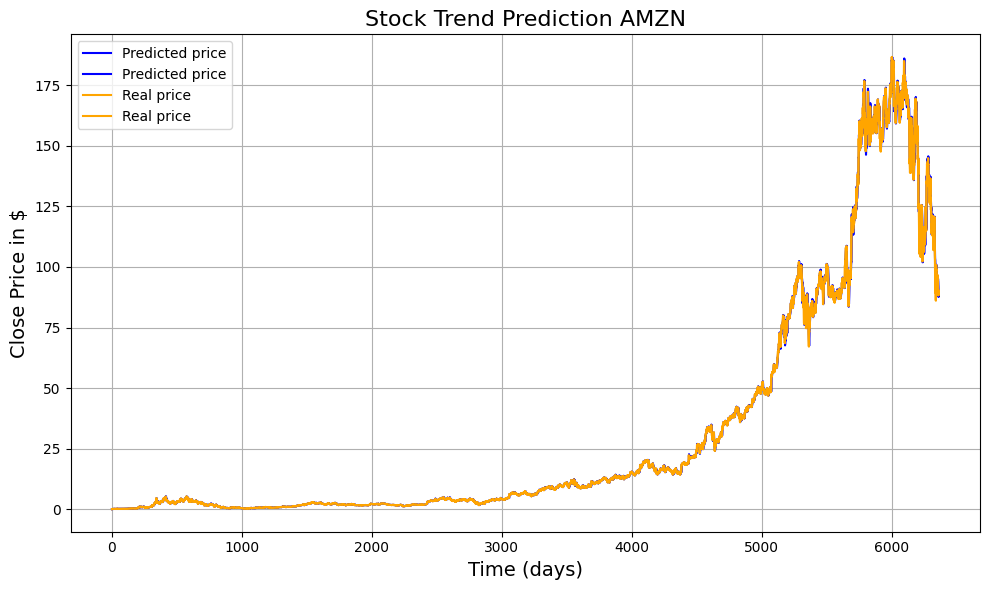

309/309 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014384907288132427


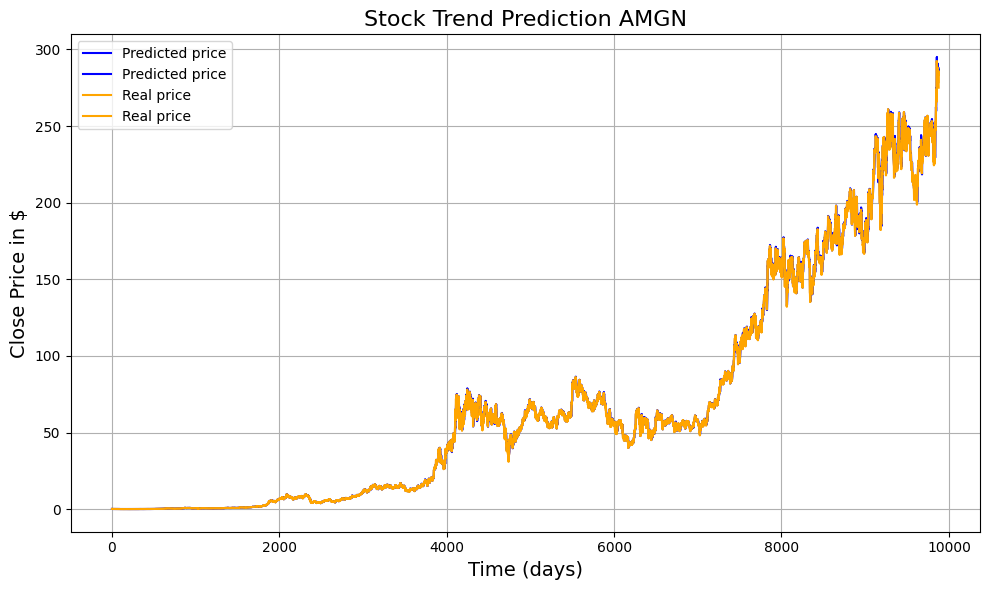

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015581894528131843


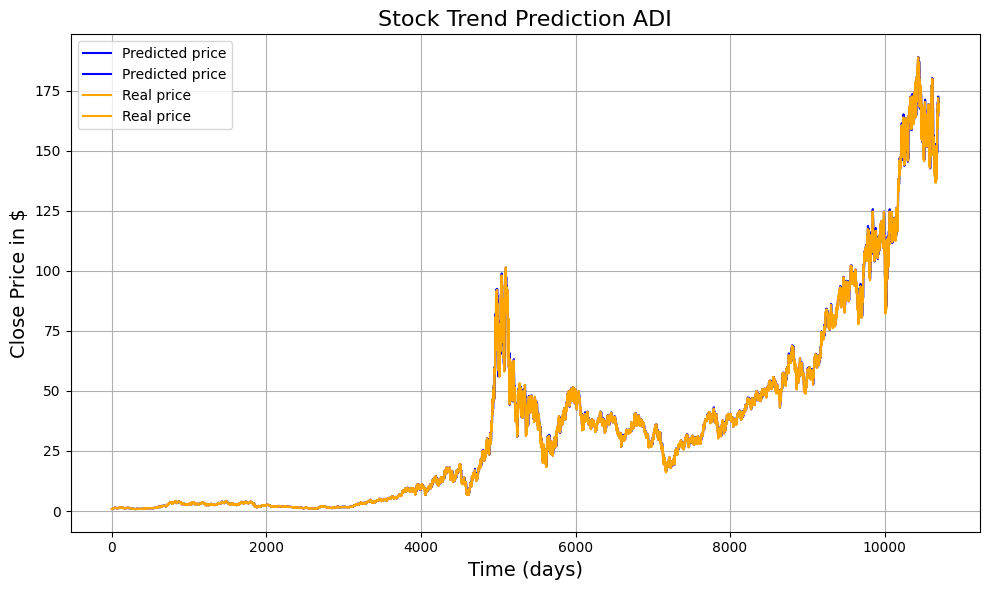

329/329 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.012419278877128426


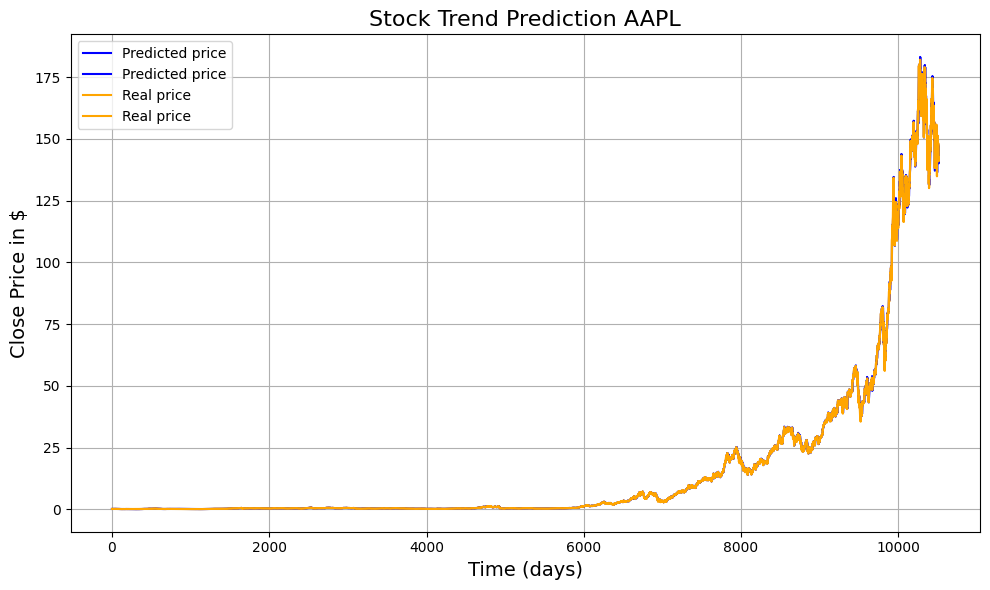

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.013472009130586451


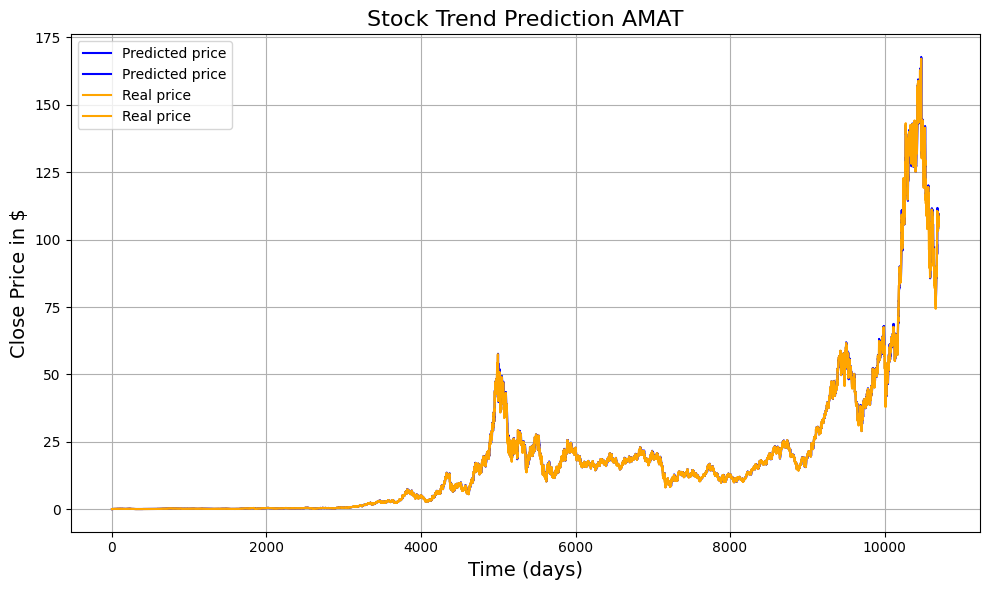

216/216 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.01372722294293959


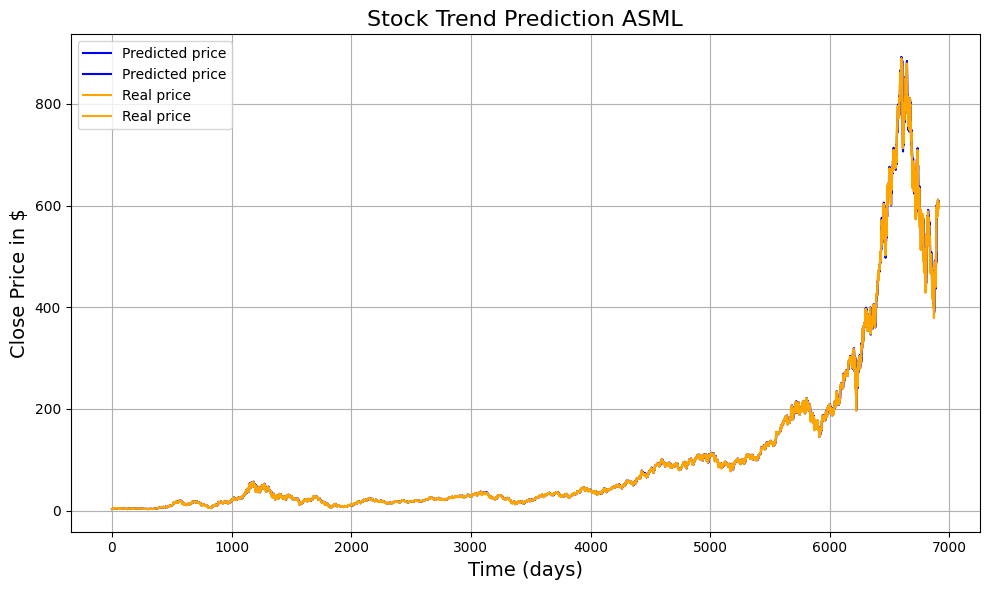

293/293 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014135594925386605


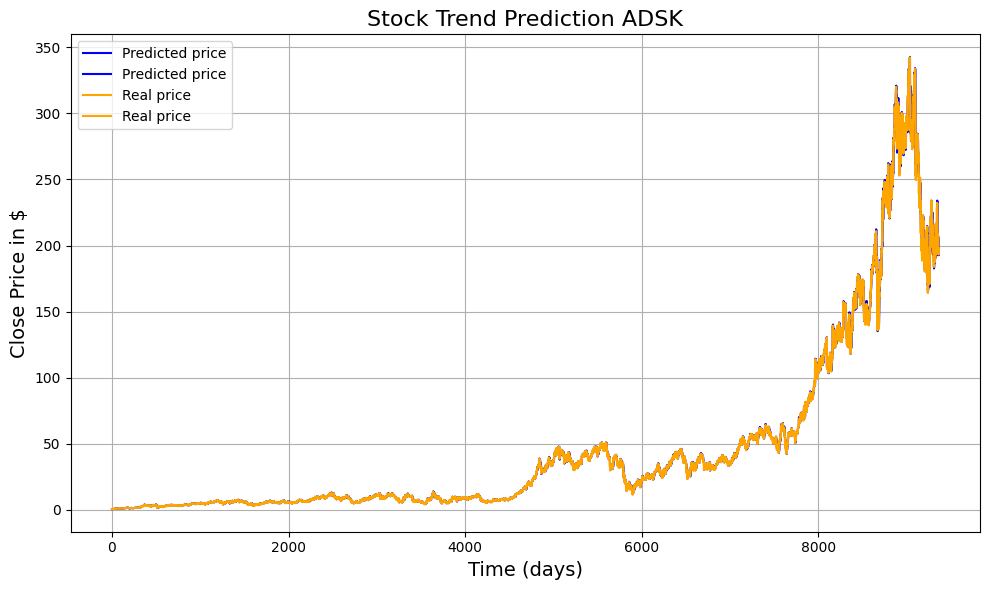

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015114482465331532


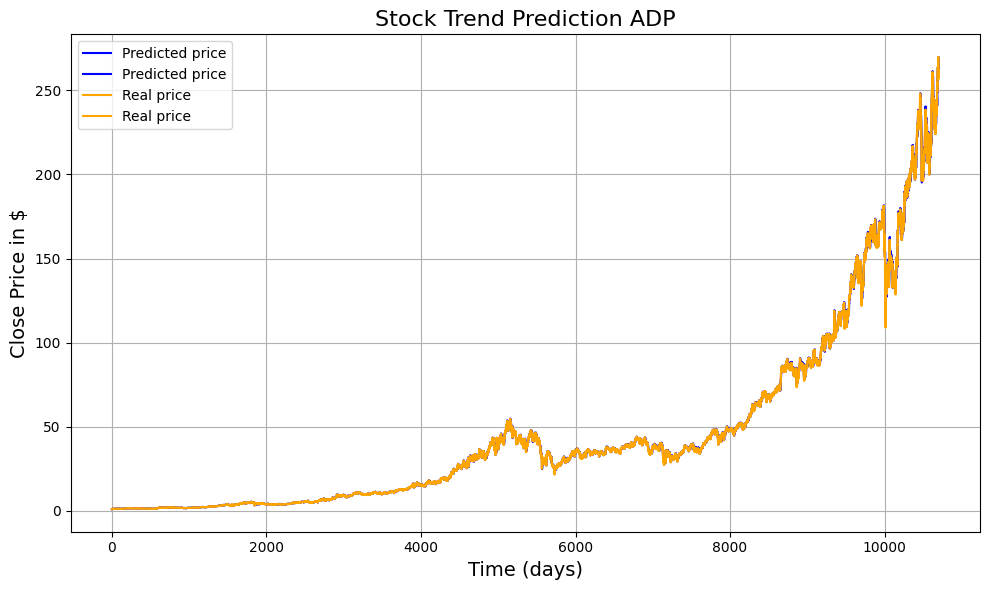

244/244 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.022880070627226336


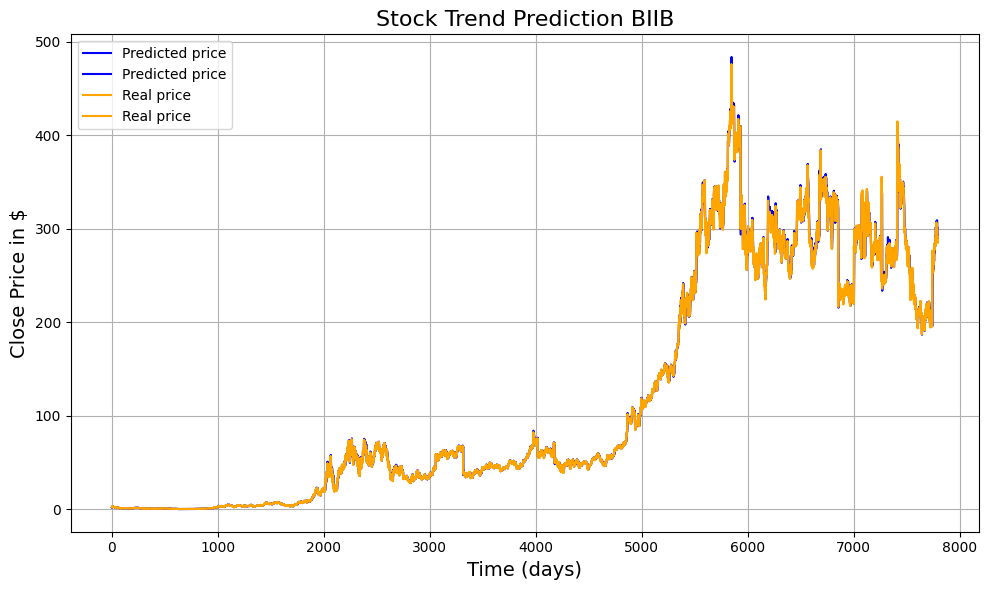

278/278 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014935111607061517


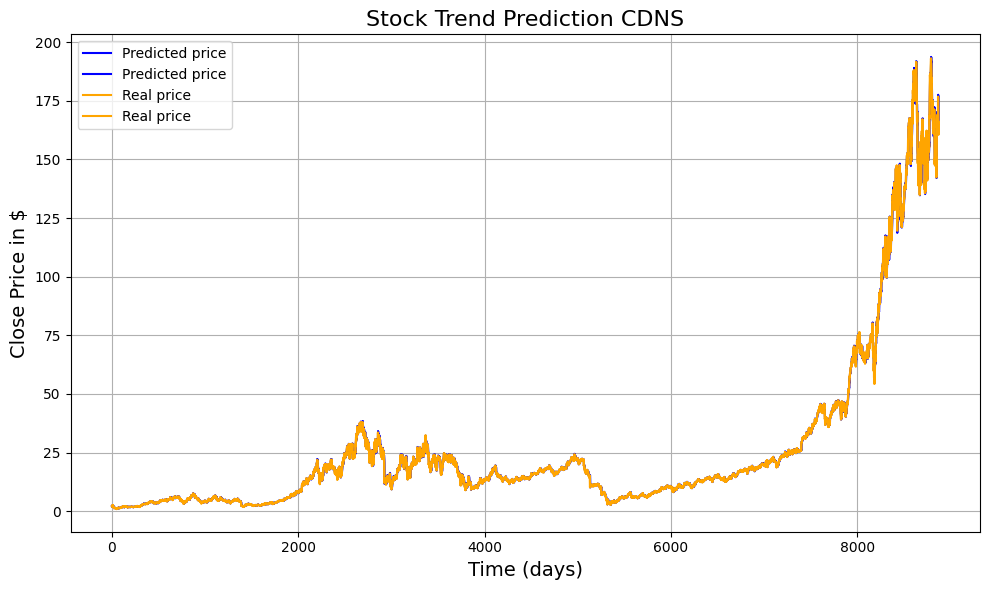

73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.01417607758140514


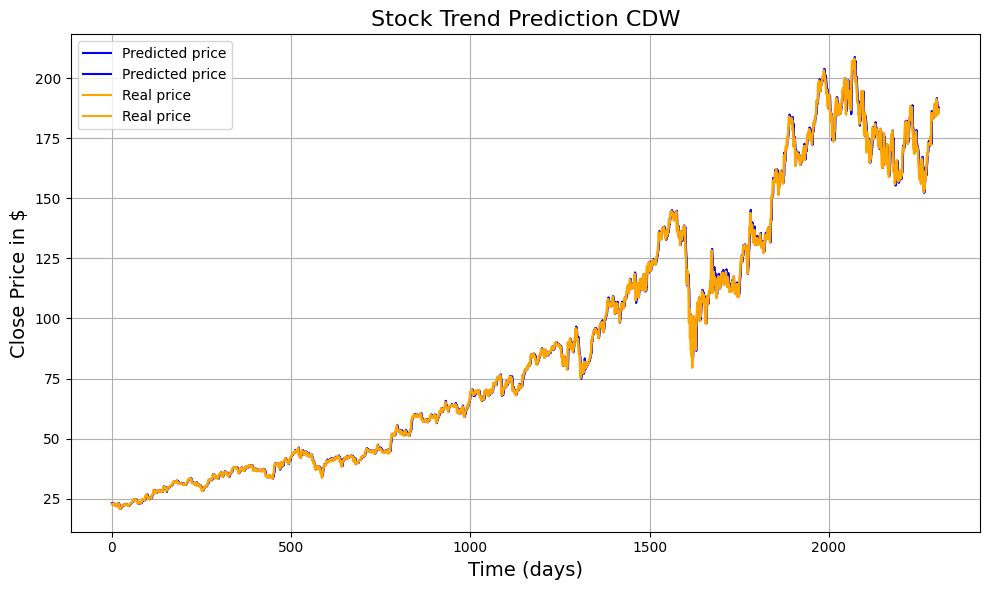

100/100 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.014311978443117015


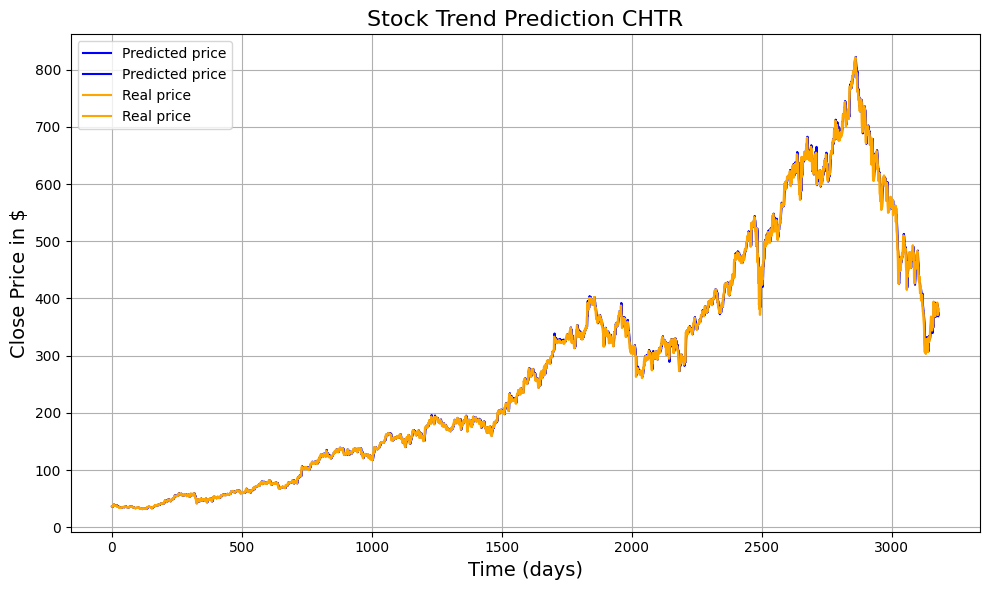

308/308 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015218787766836432


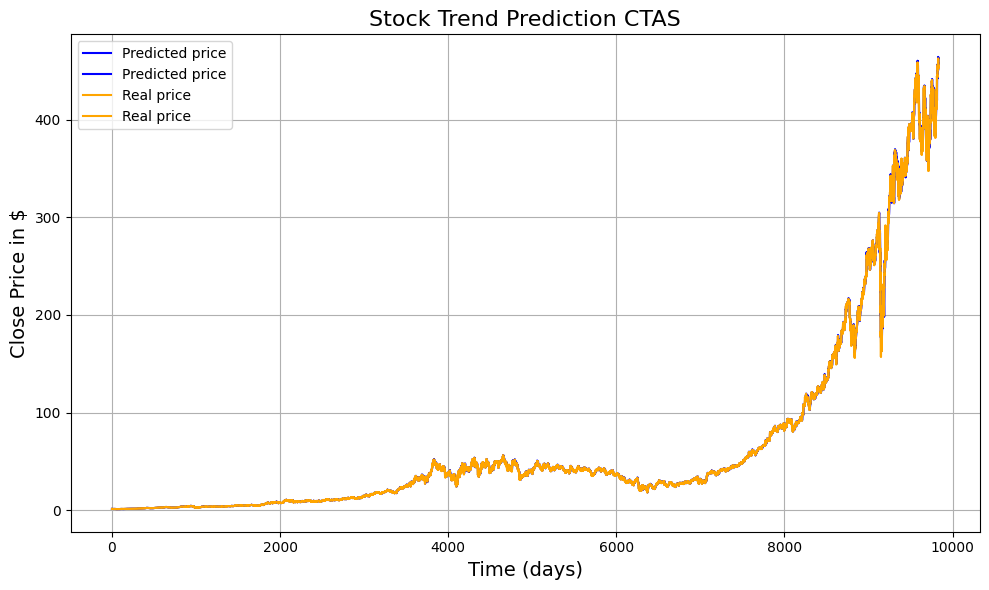

257/257 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014451088855953732


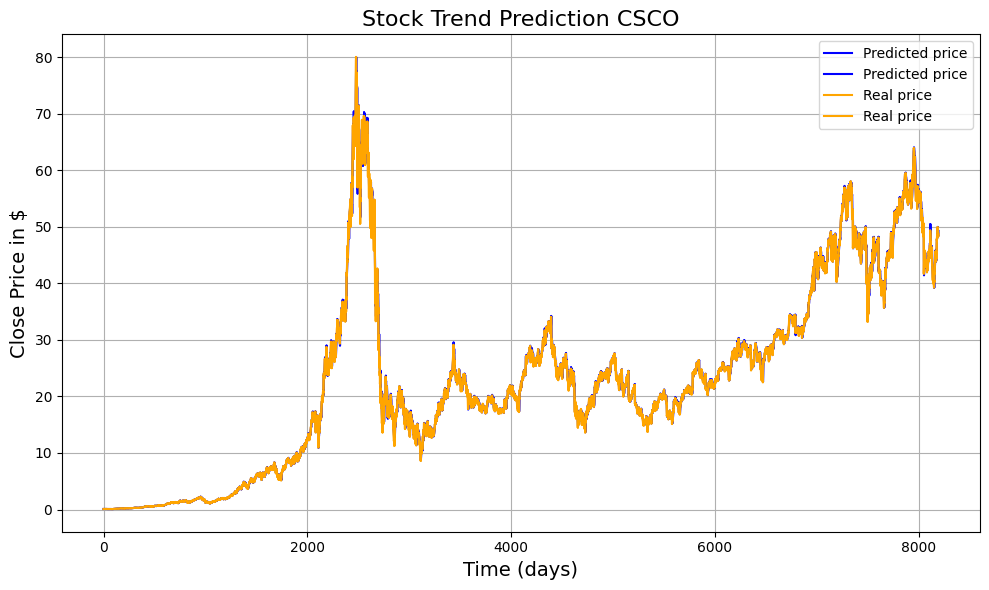

191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.016220425010992537


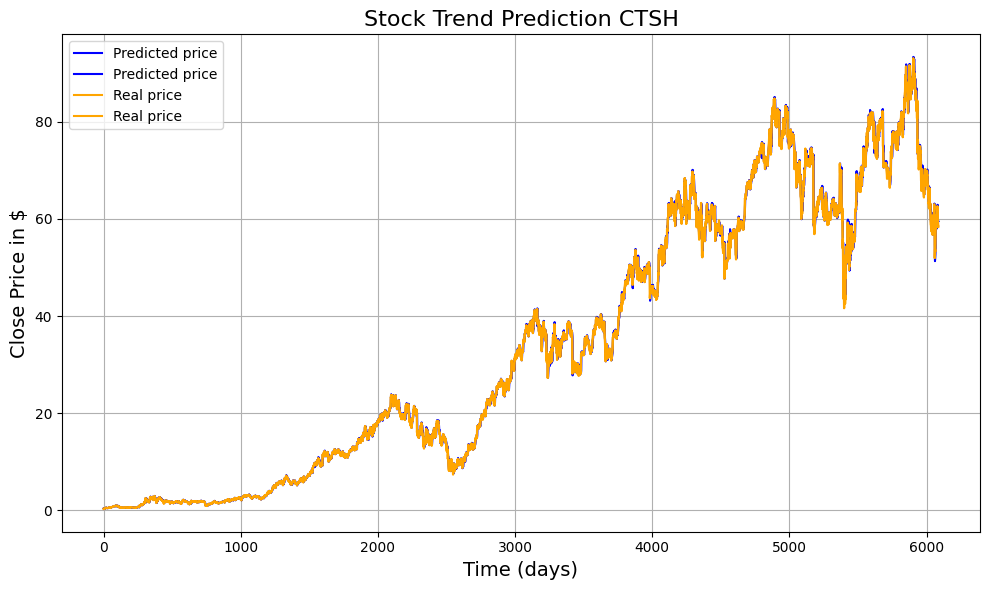

335/335 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
MSE on the test set:  0.01412829036849166


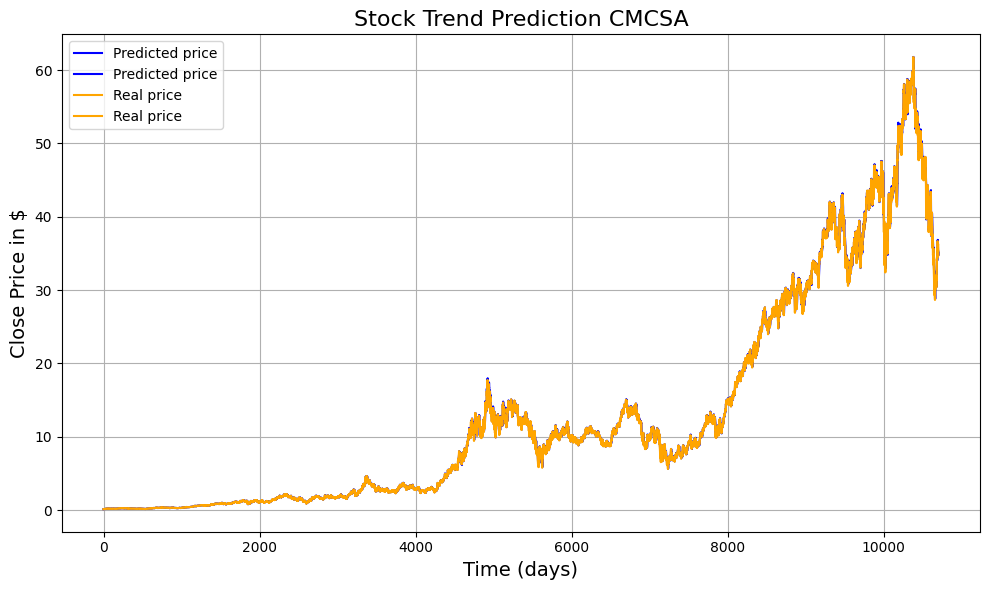

224/224 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015215692251133294


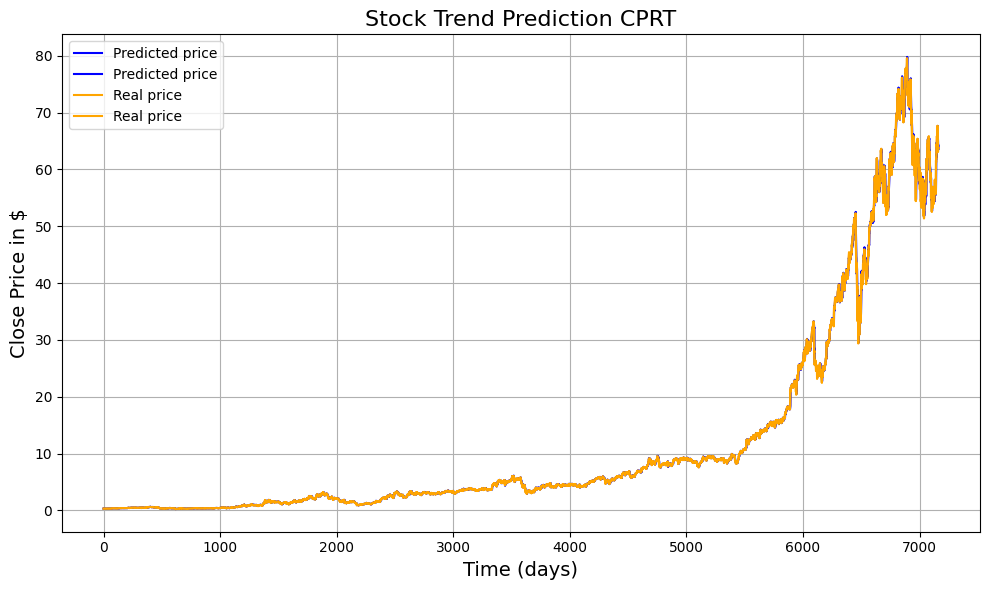

190/190 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.014471956970423765


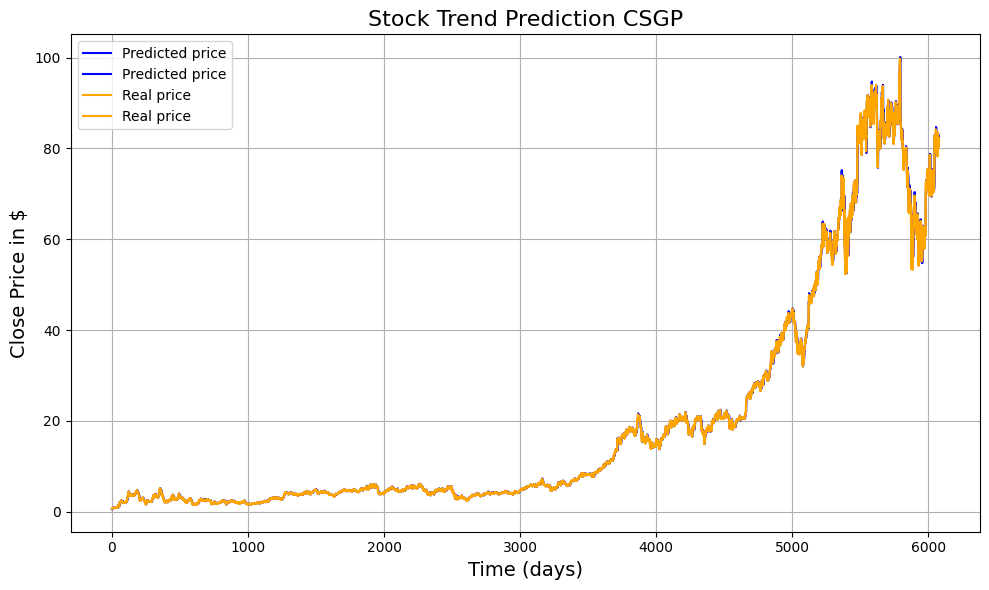

285/285 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.016195459036639777


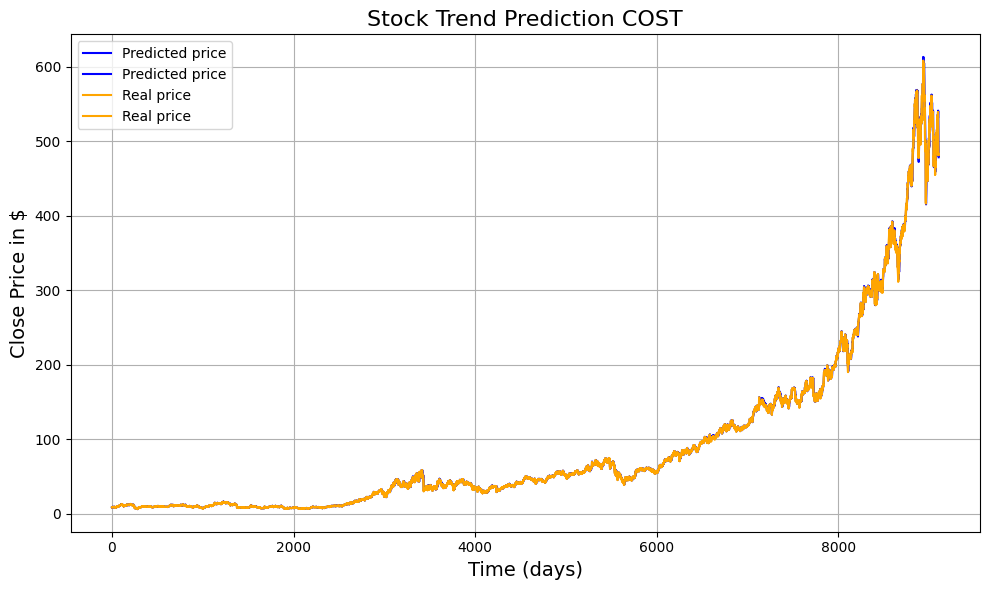

137/137 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.01506599800872448


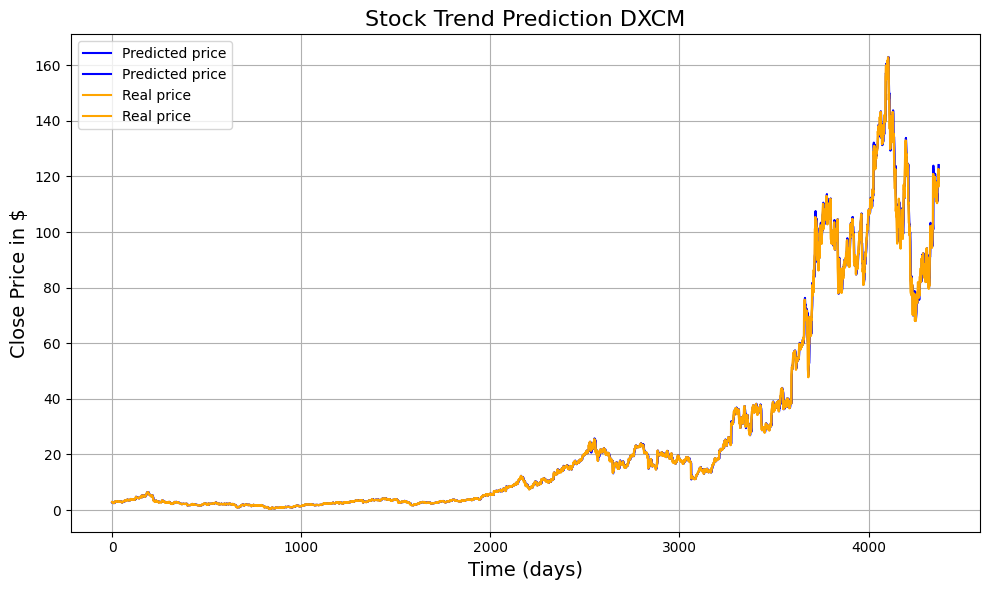

78/78 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.01507329052493726


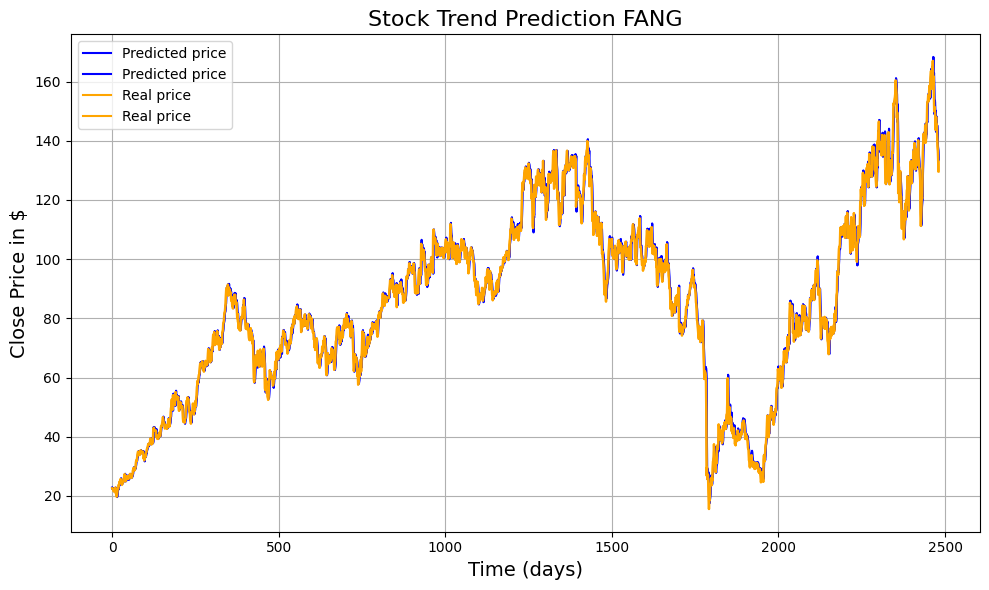

260/260 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015433693167000873


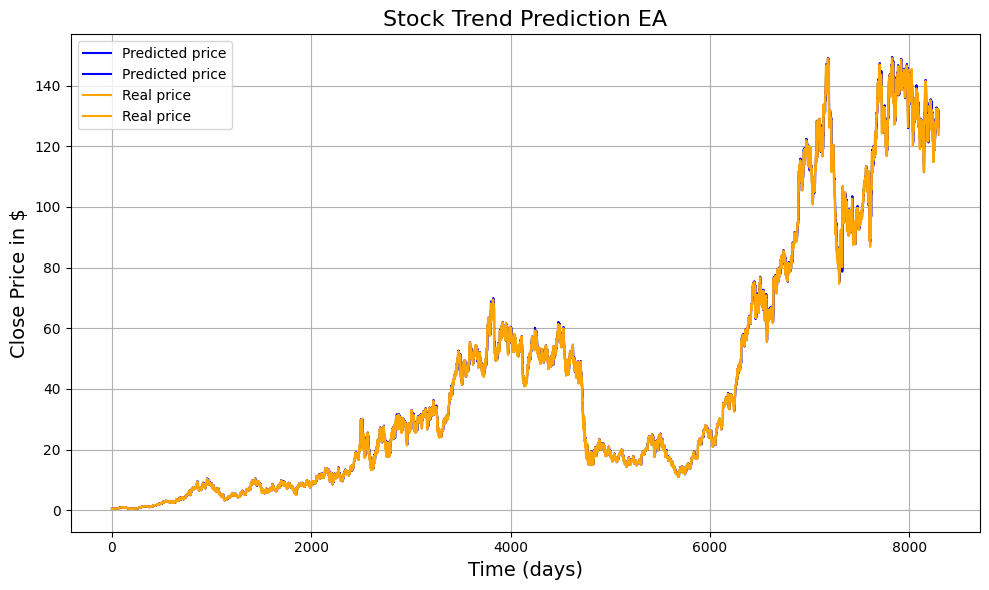

276/276 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014666817244958807


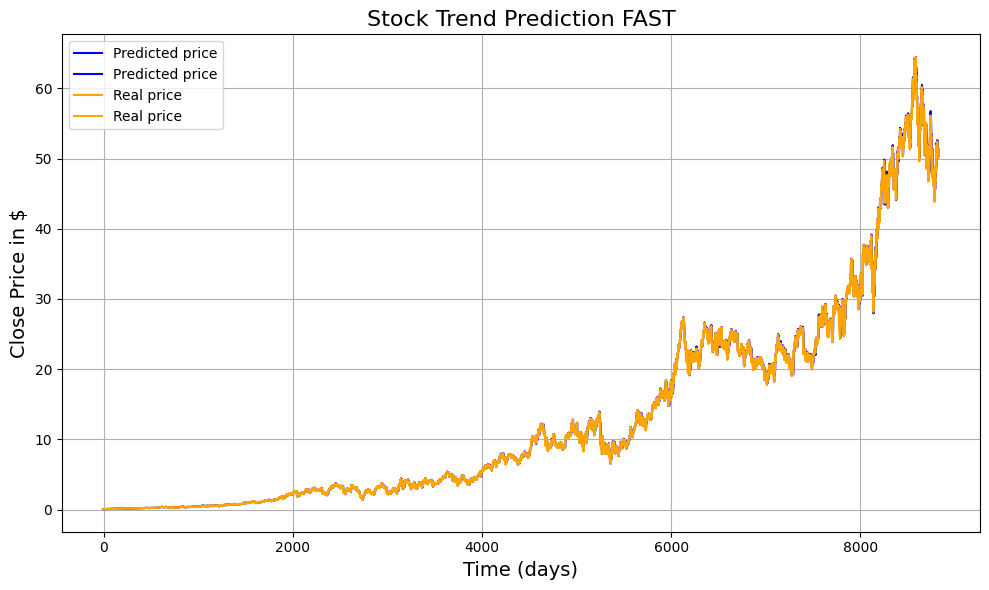

101/101 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.01487050785622325


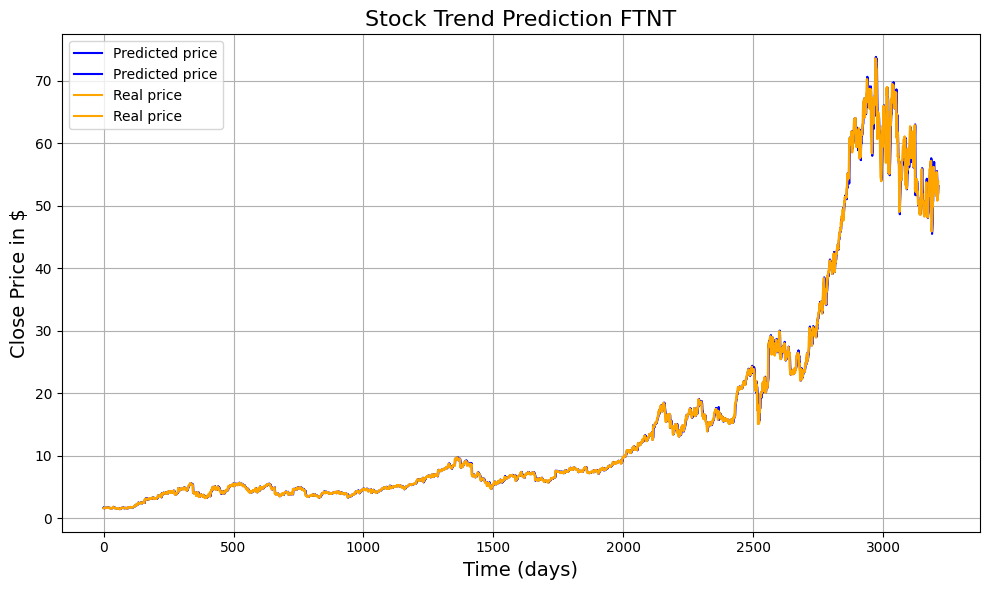

241/241 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.01601253912918065


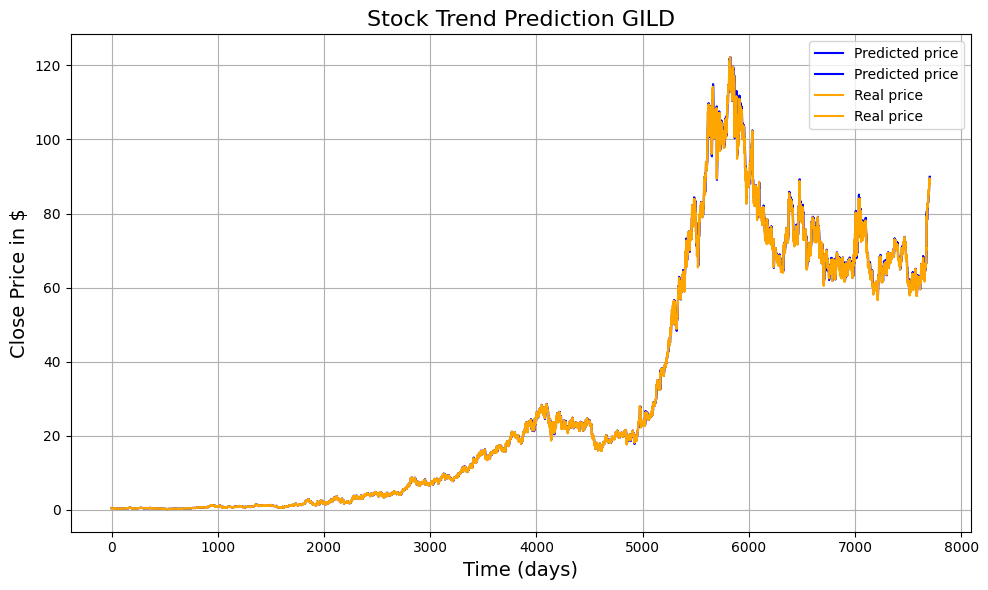

246/246 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.016318409642108733


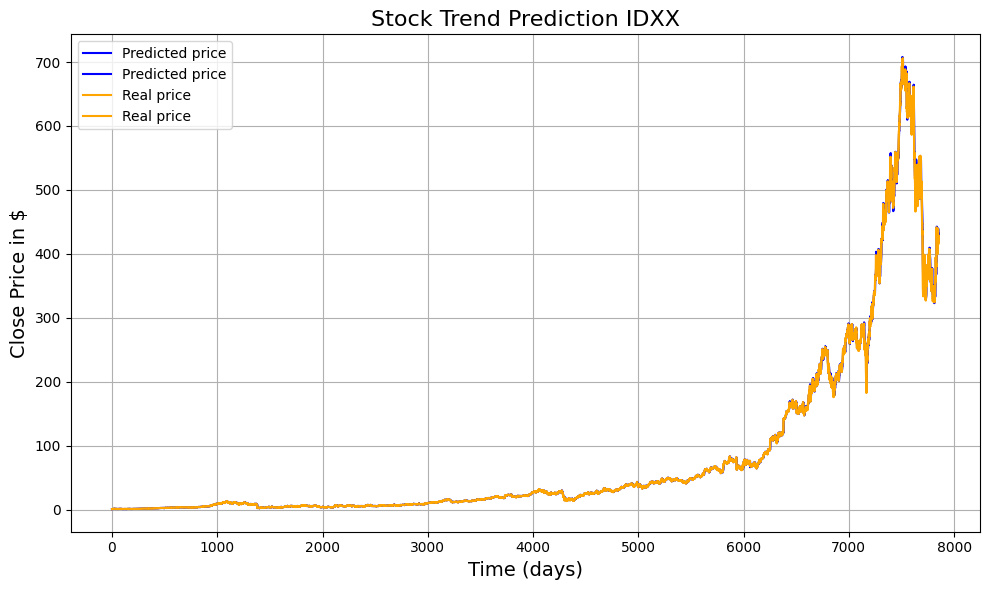

174/174 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014368216322119137


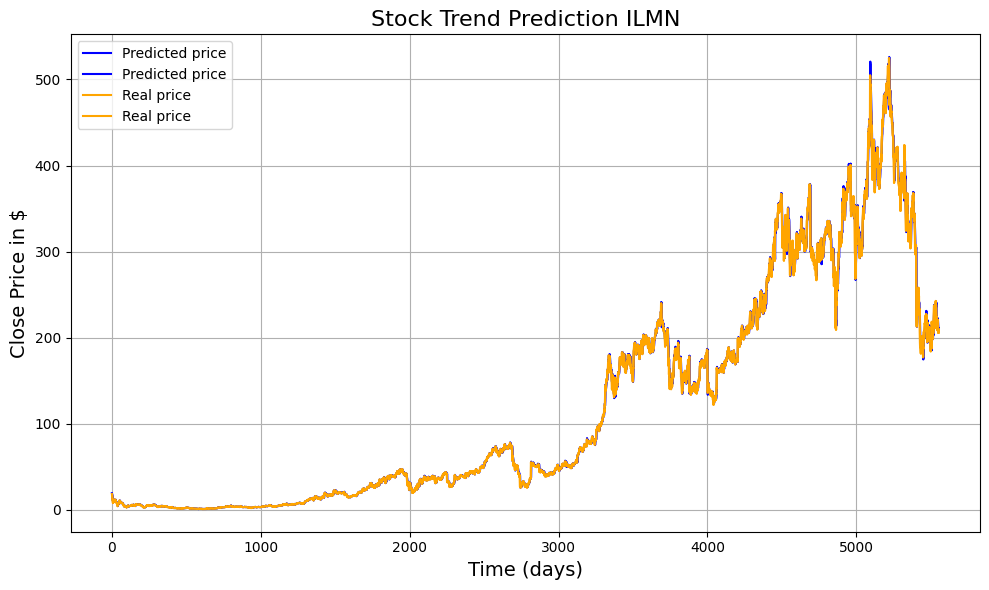

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.013578494187813822


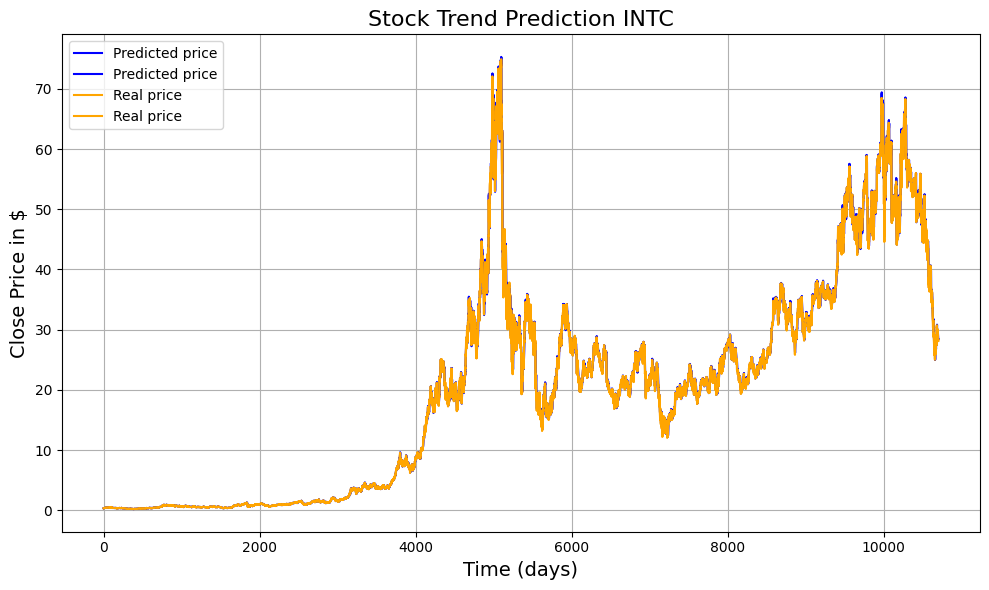

232/232 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.016489941015713903


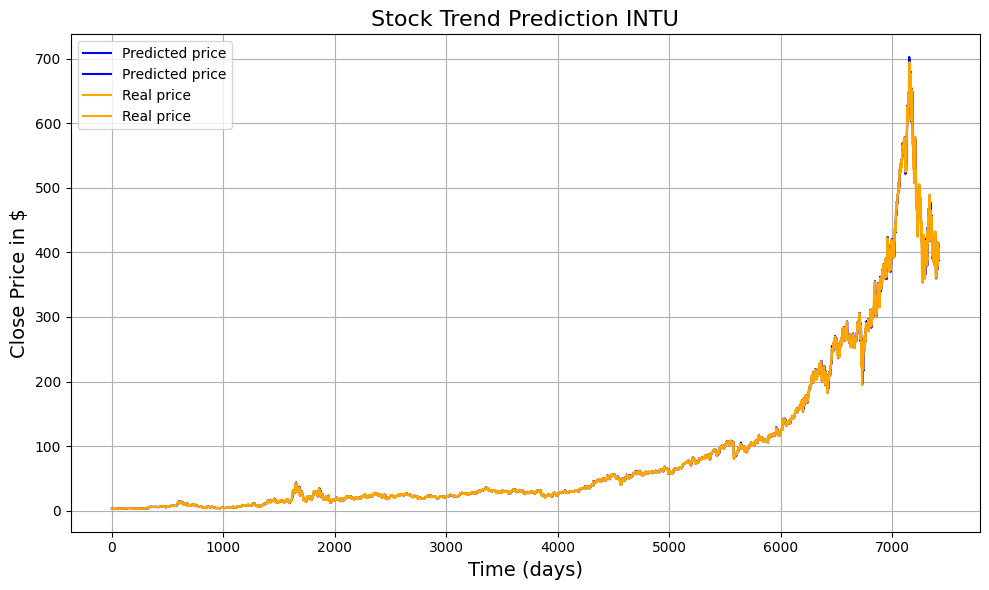

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.016370735580050675


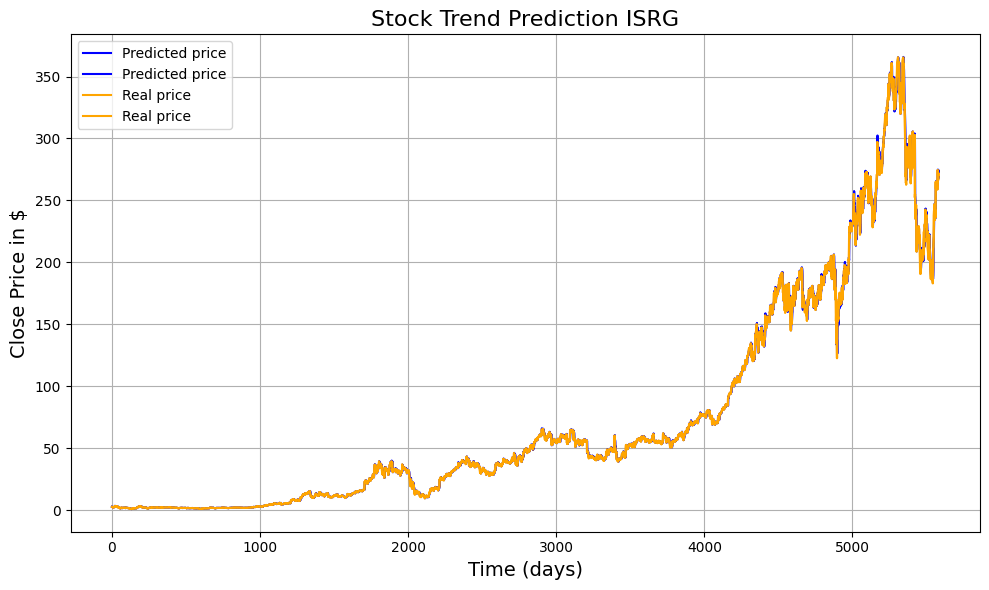

302/302 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014491649788493294


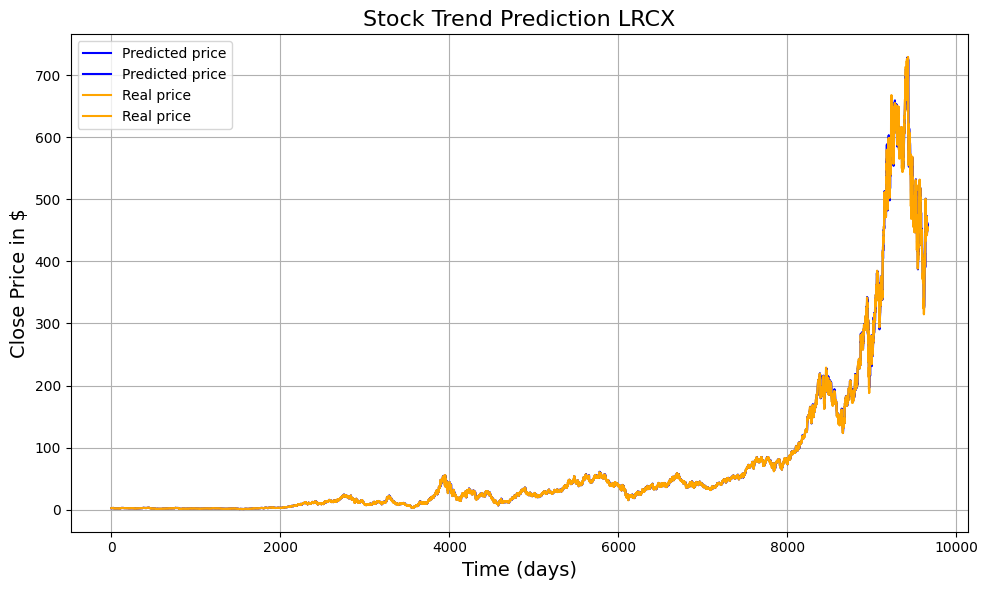

119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014489887398169726


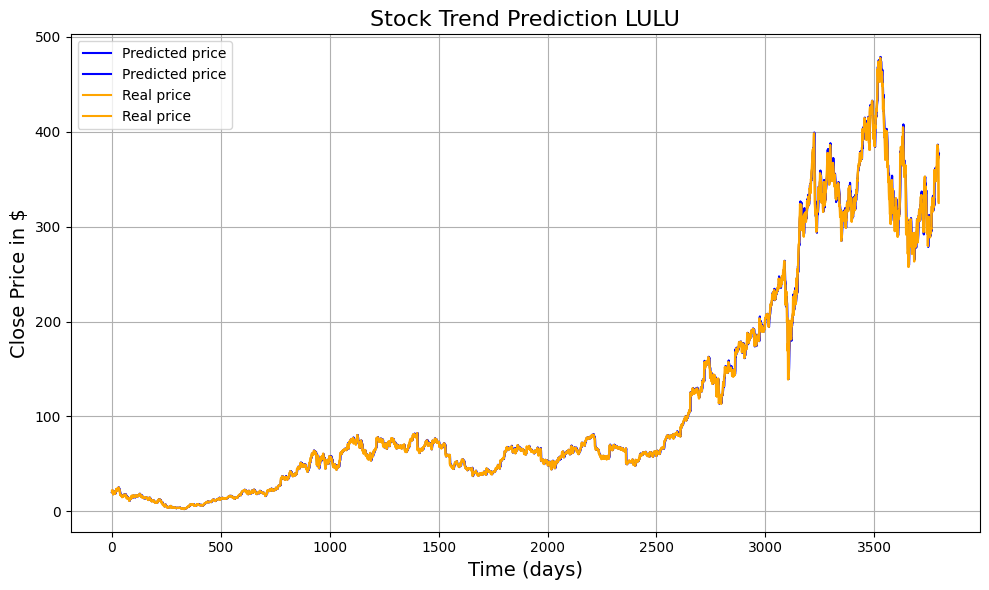

193/193 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014142776475575599


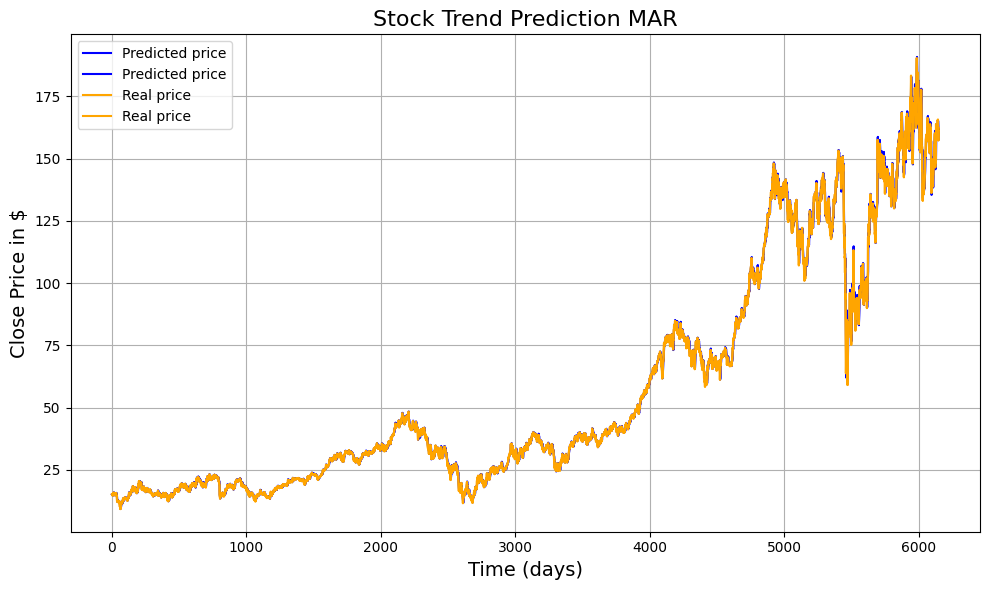

175/175 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.013873210508427235


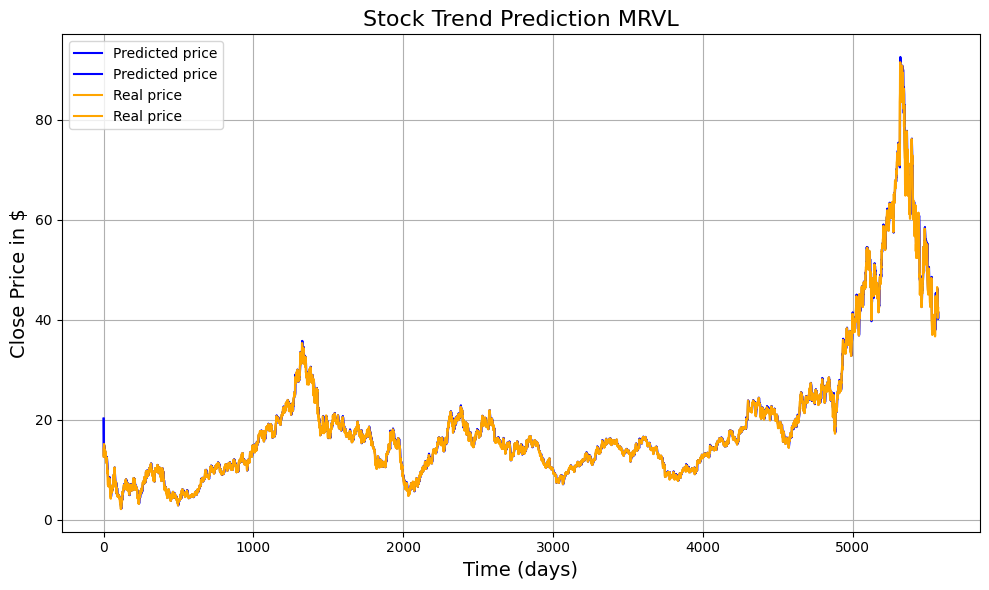

119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.012938509514259828


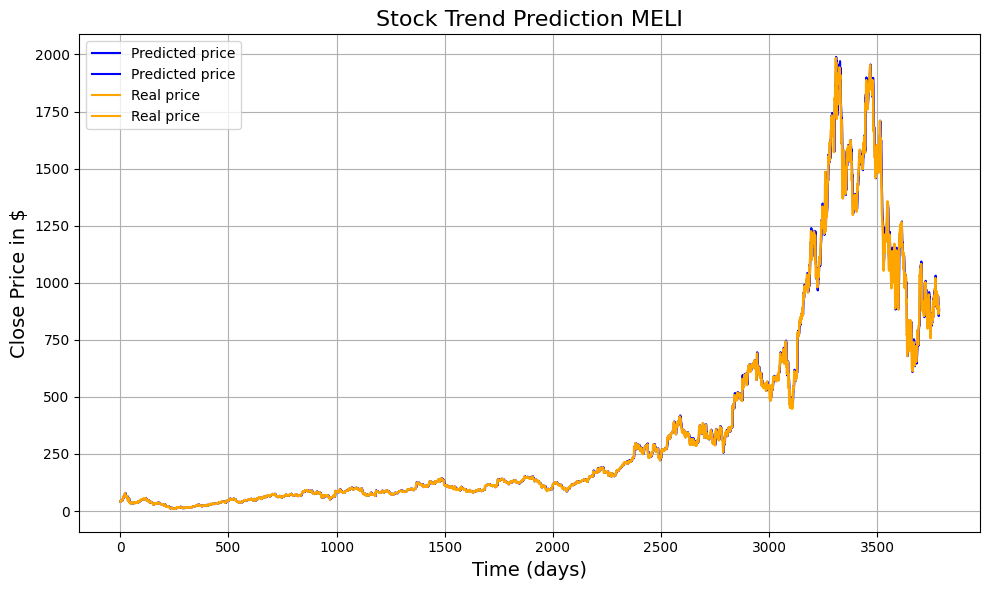

232/232 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.016669392741599252


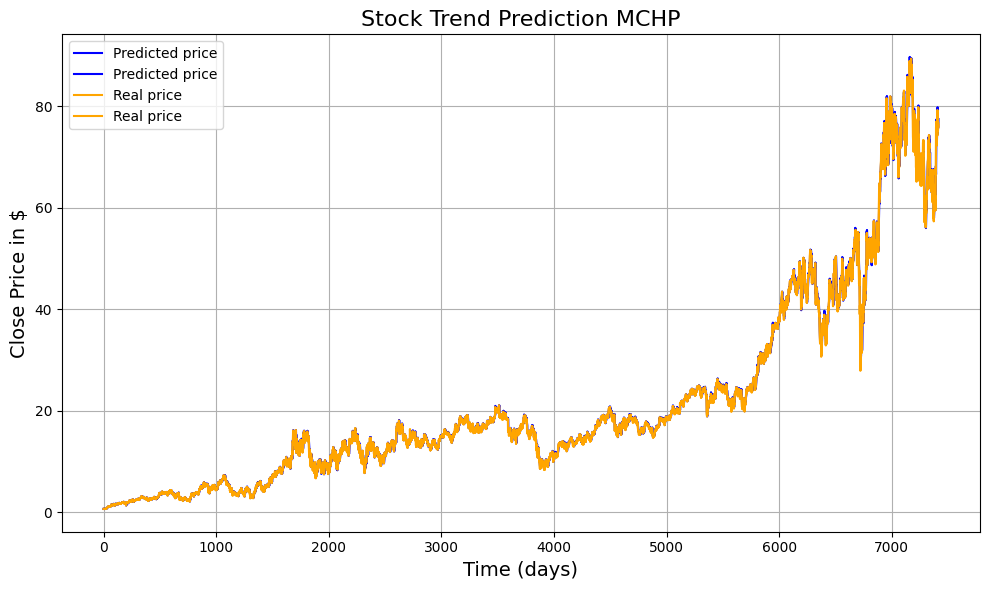

302/302 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.012456186447134029


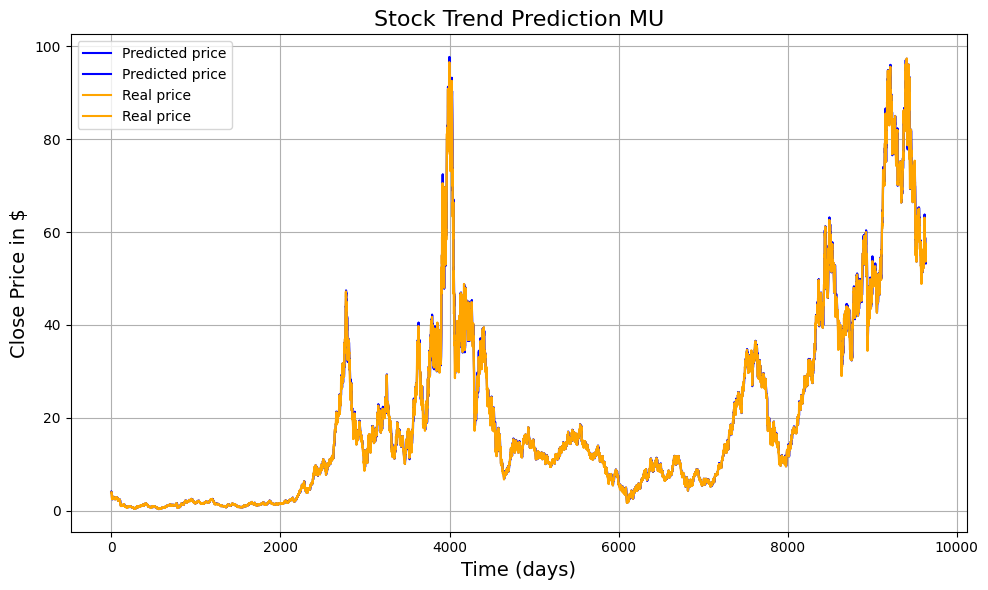

288/288 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014604156579386633


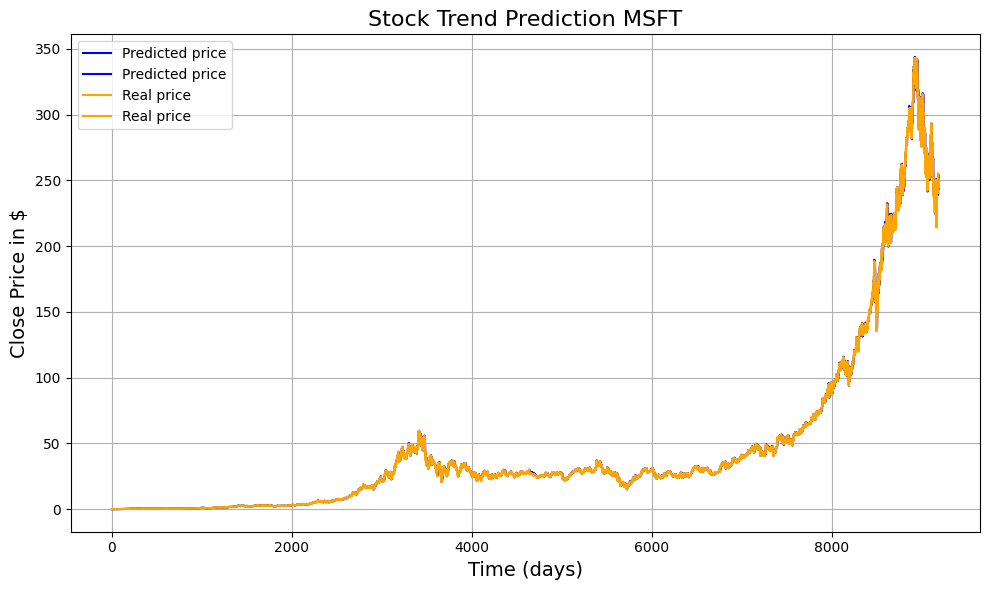

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.018405064584790957


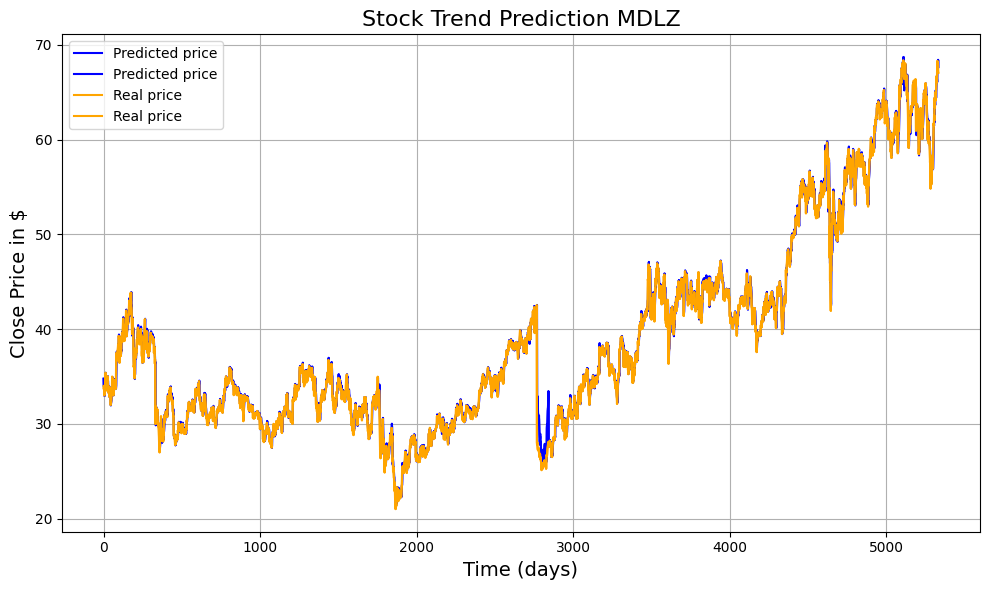

290/290 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.02027983200717471


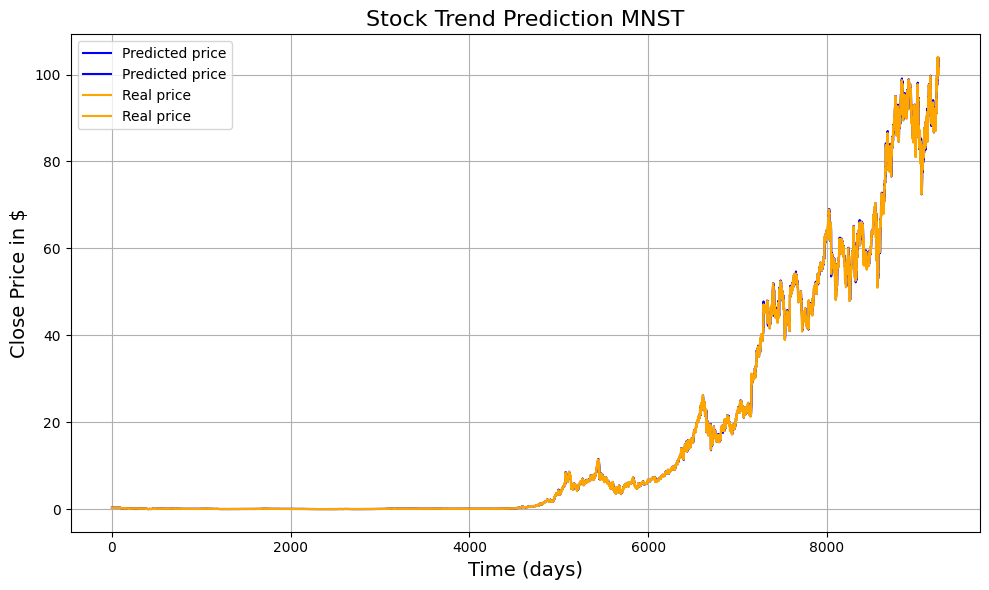

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.014650969032241789


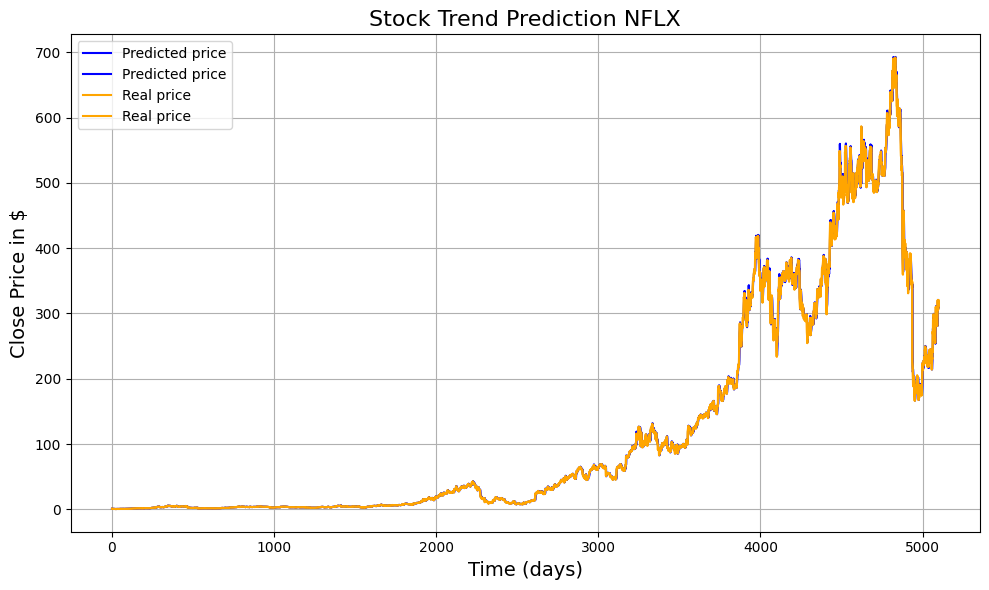

186/186 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.013391198531538402


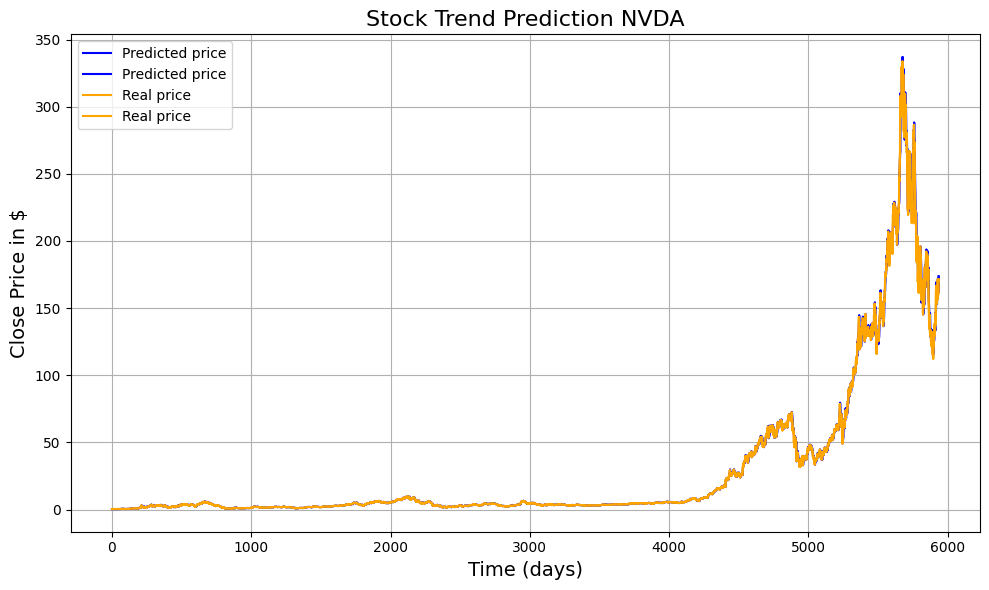

95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.014655325346653477


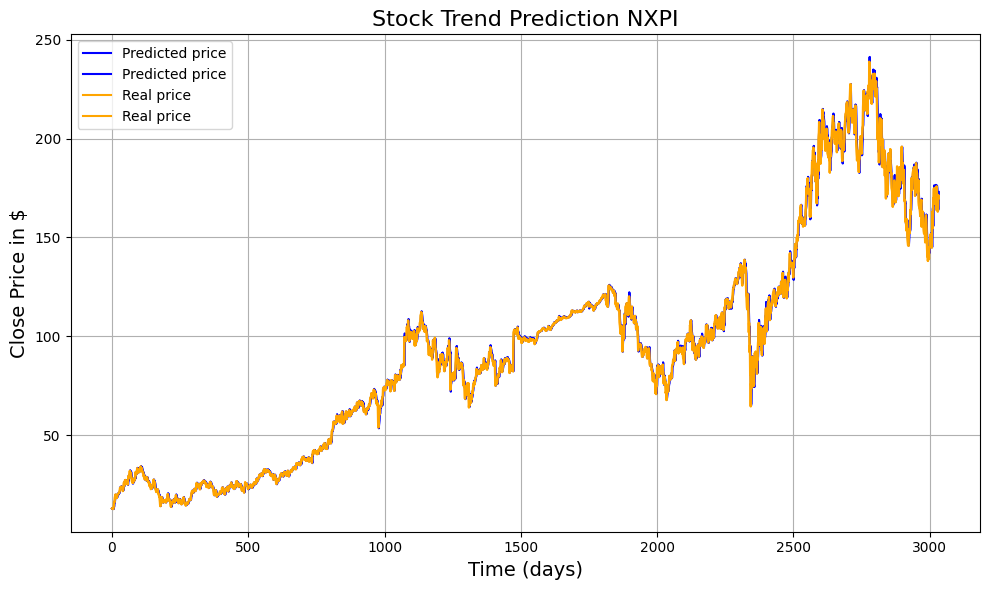

231/231 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015767361823713907


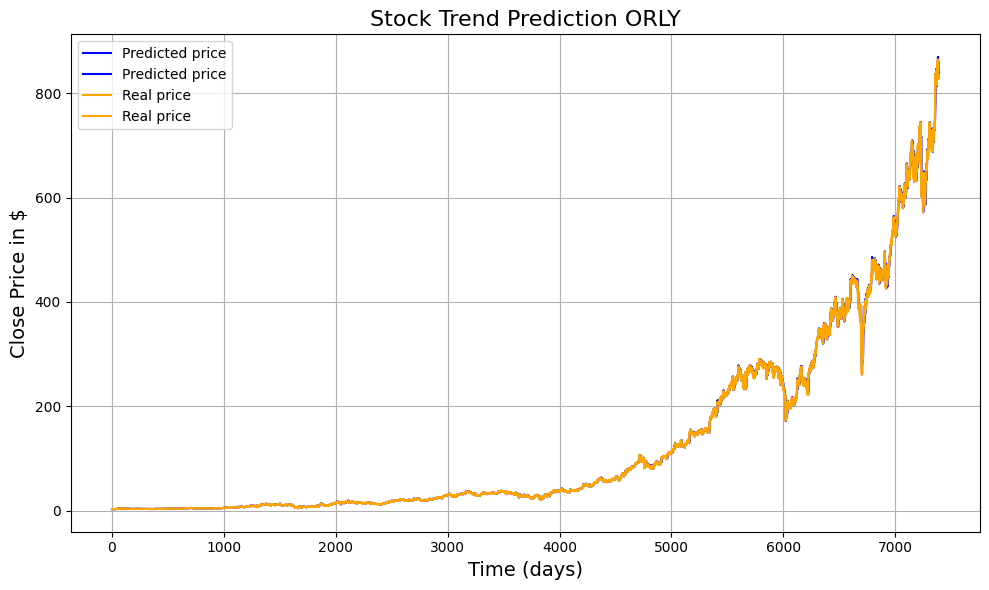

243/243 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.01959626901554402


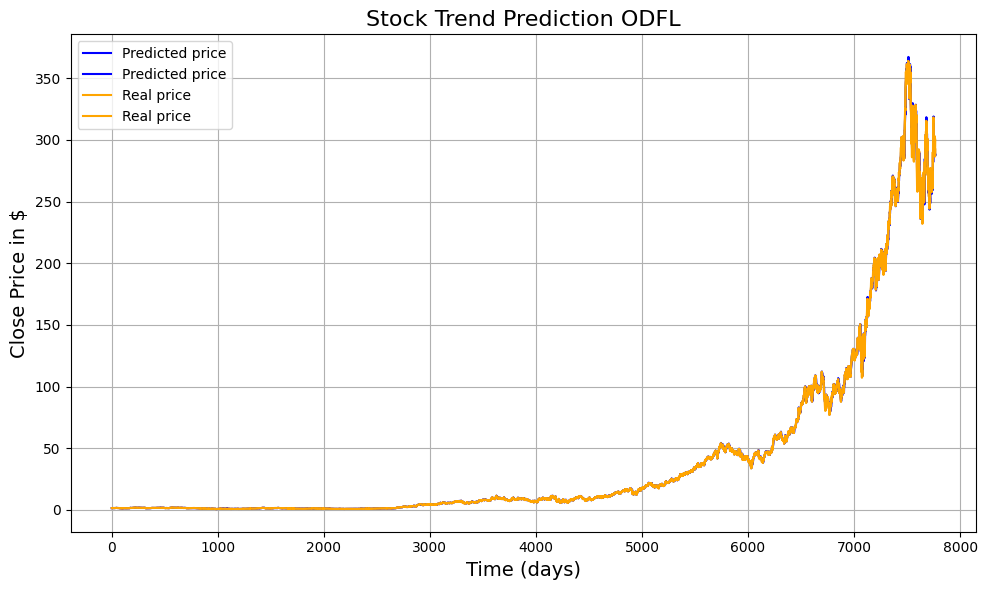

176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
MSE on the test set:  0.013550661687659275


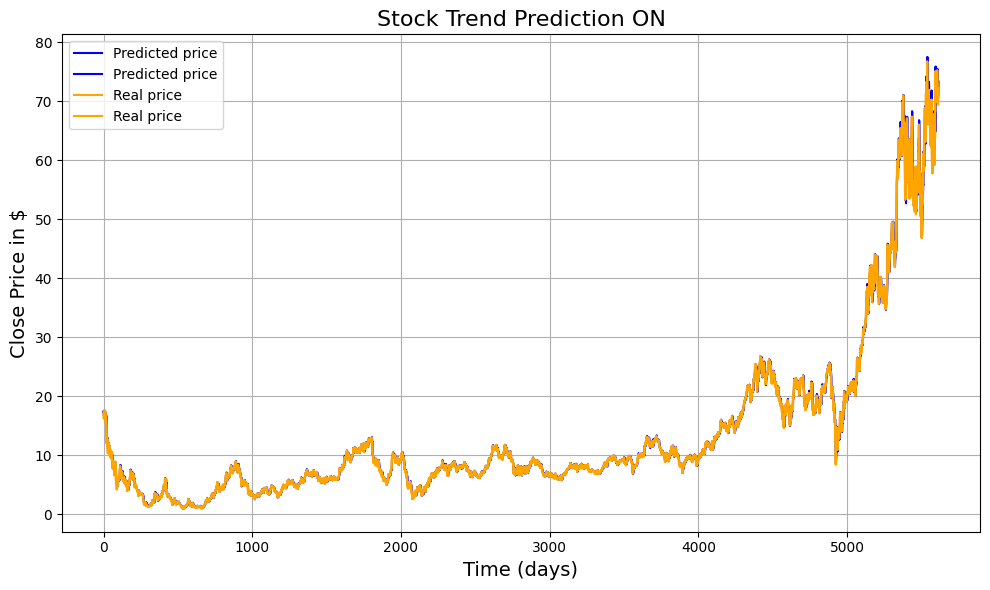

335/335 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.014775373271925098


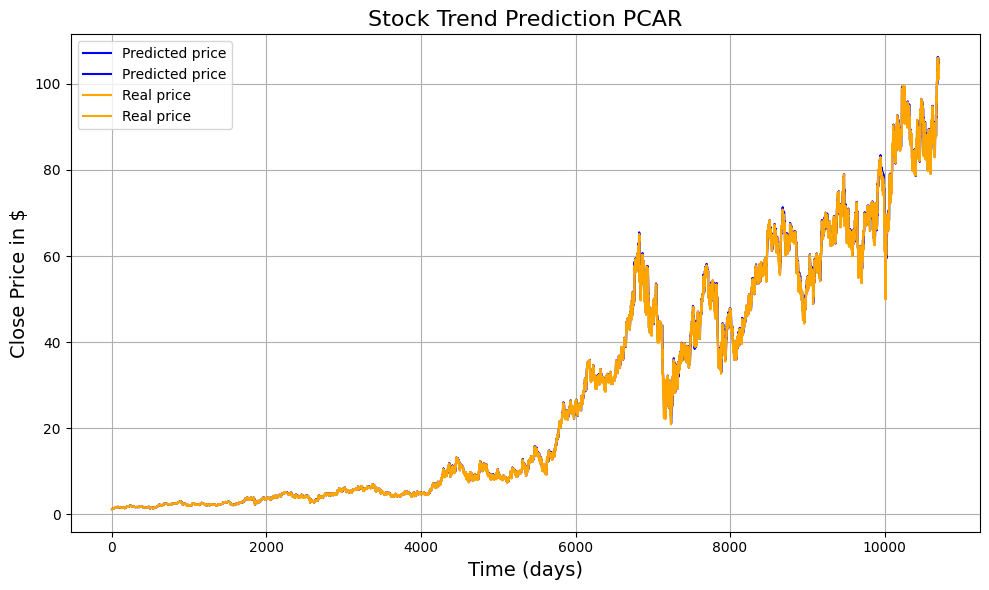

308/308 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.014107998811178489


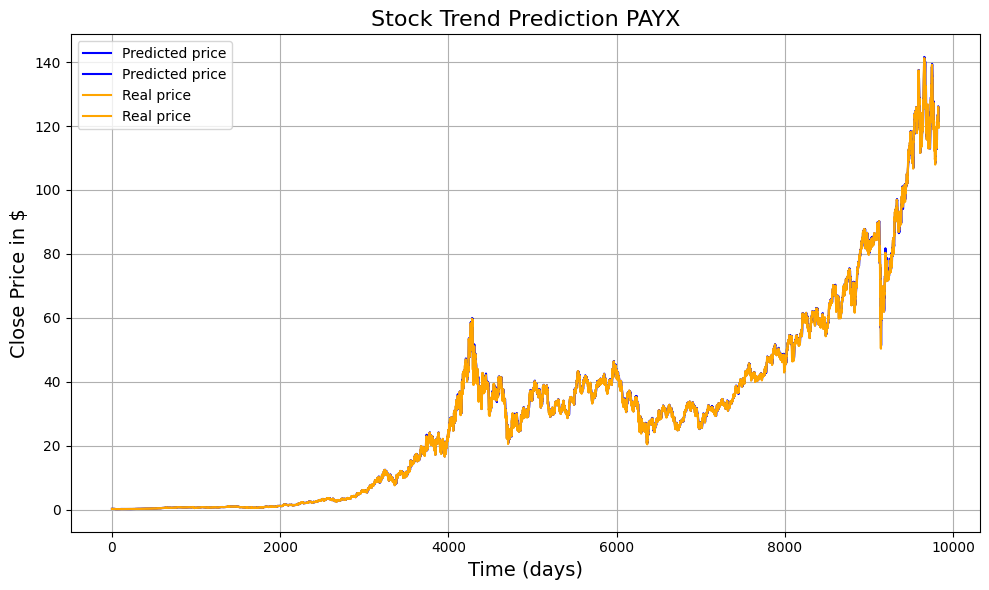

242/242 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.015808955818961464


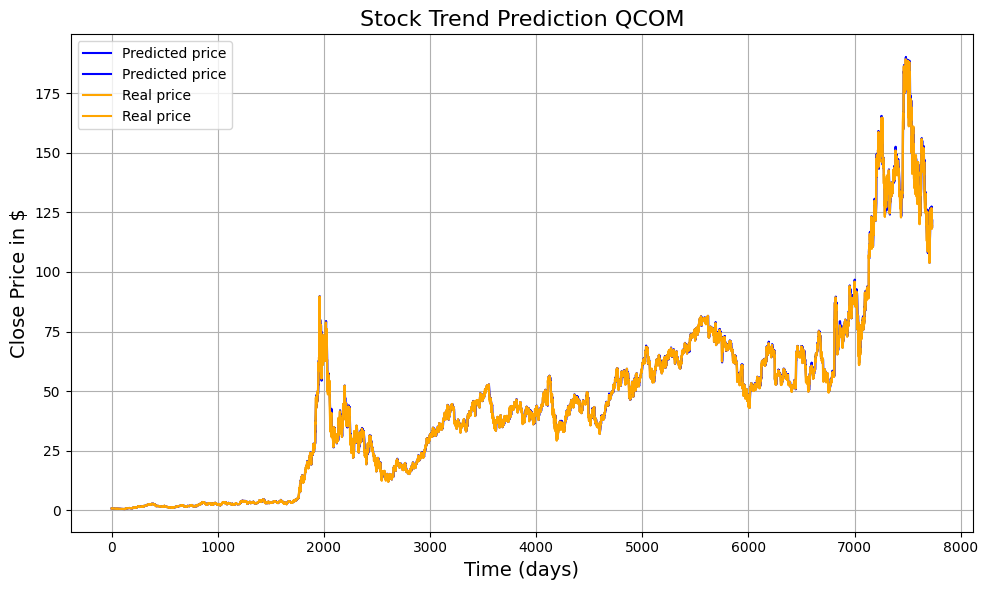

248/248 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.016359258131303747


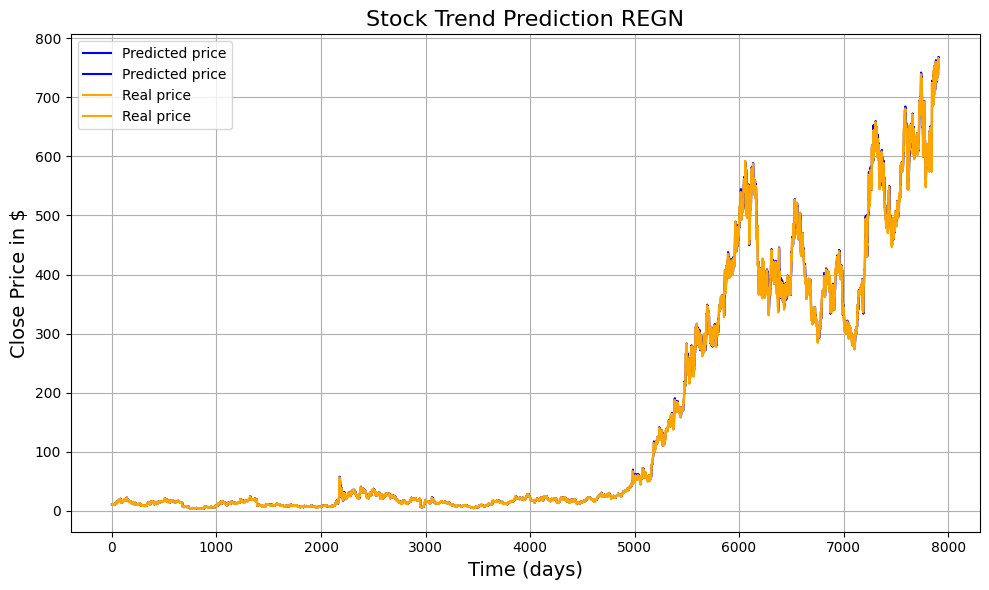

292/292 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.01378665630009545


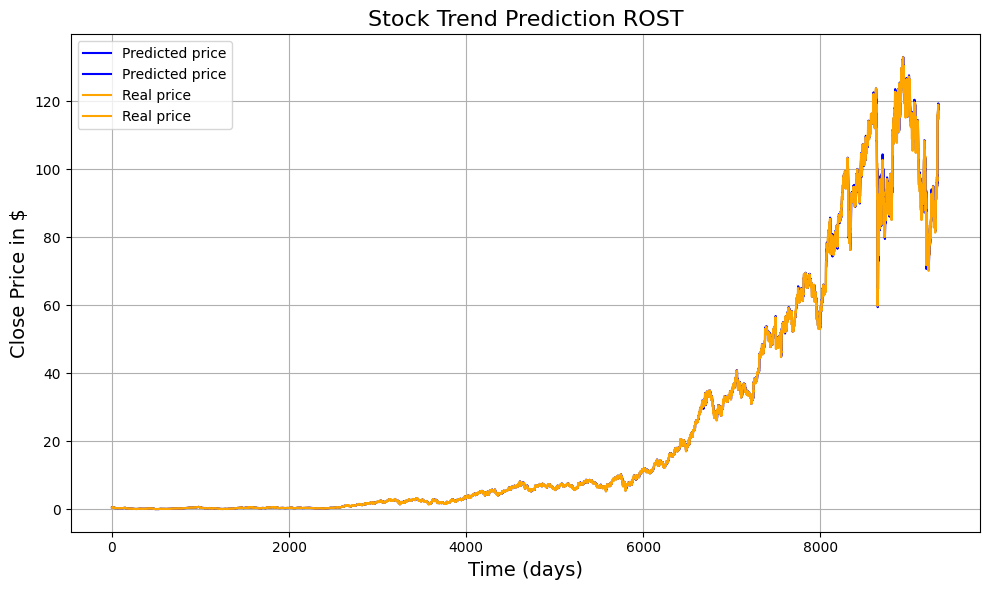

238/238 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
MSE on the test set:  0.014232651052303147


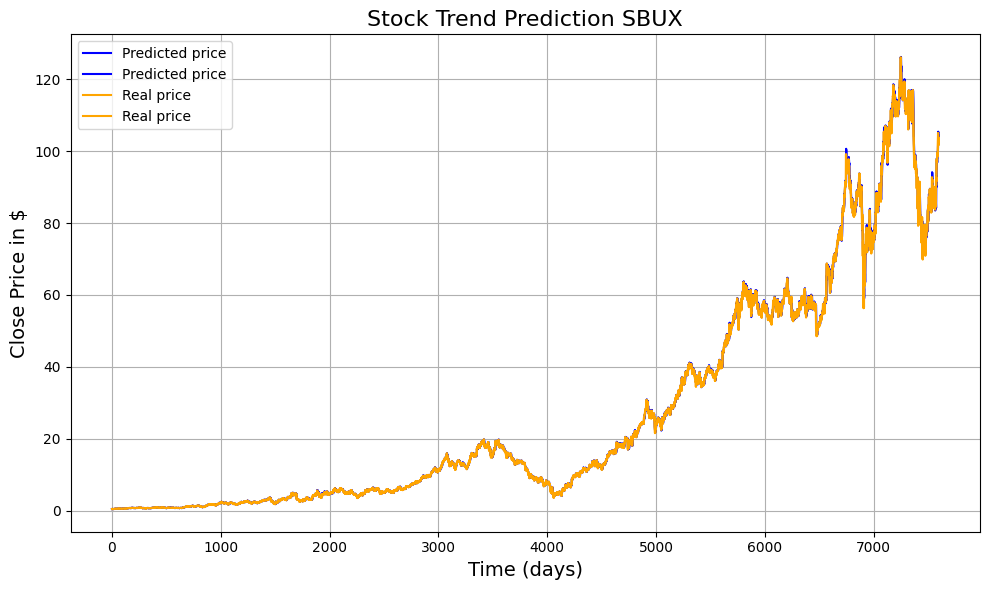

122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.016677469627683558


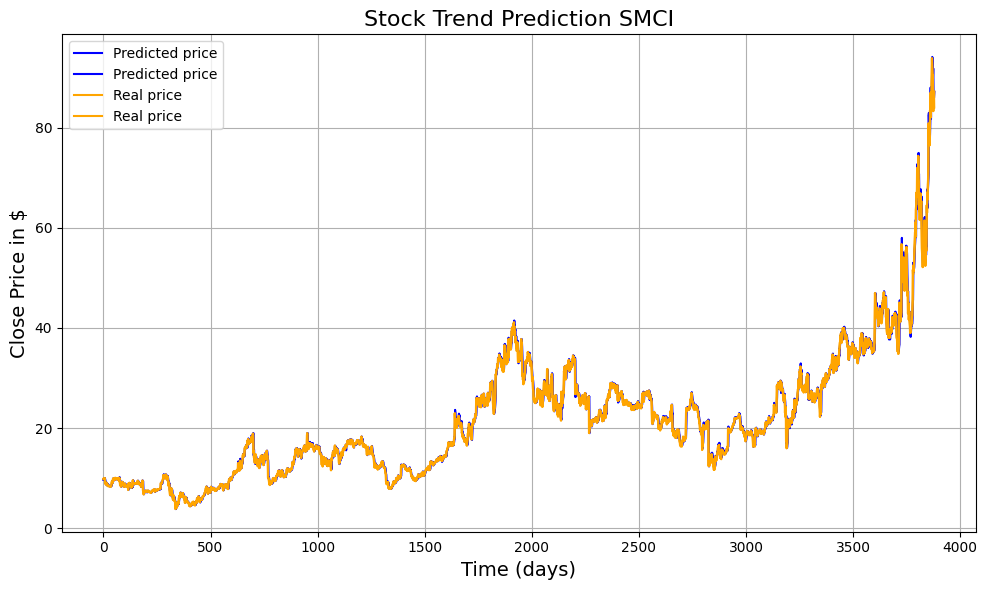

241/241 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.015316292145639426


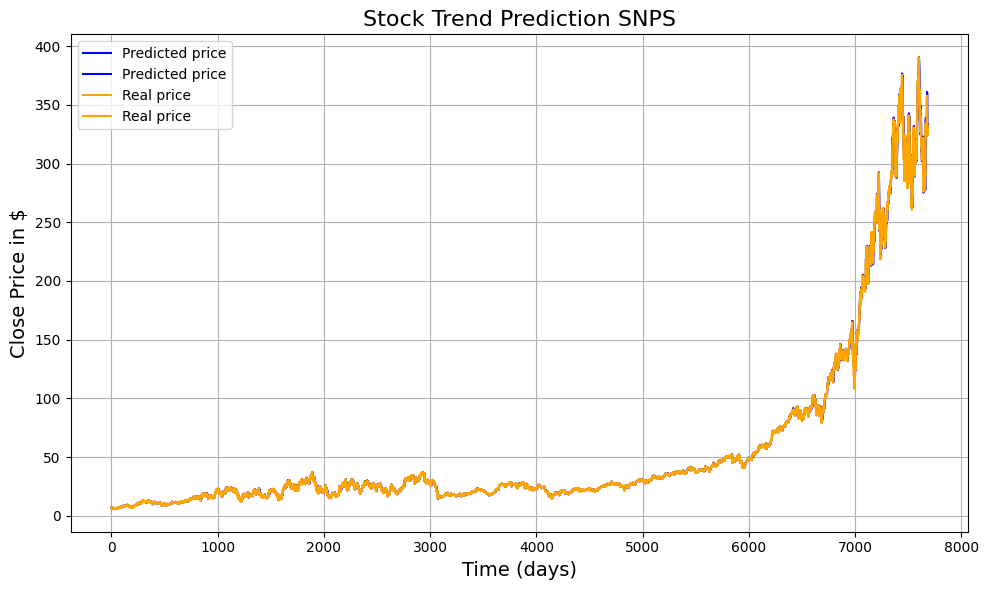

396/396 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
MSE on the test set:  0.01380106676211235


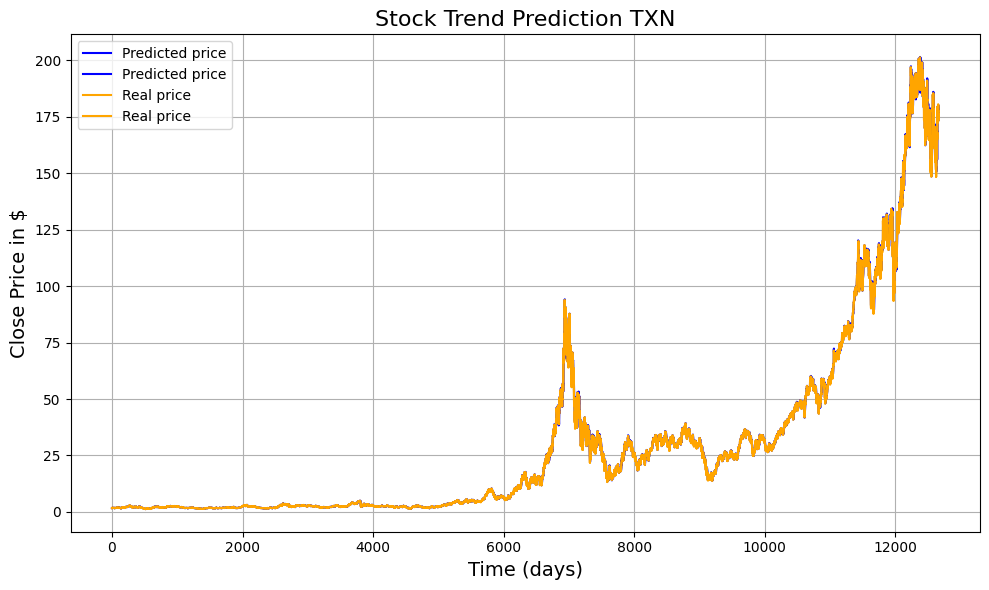

102/102 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
MSE on the test set:  0.017419861204382023


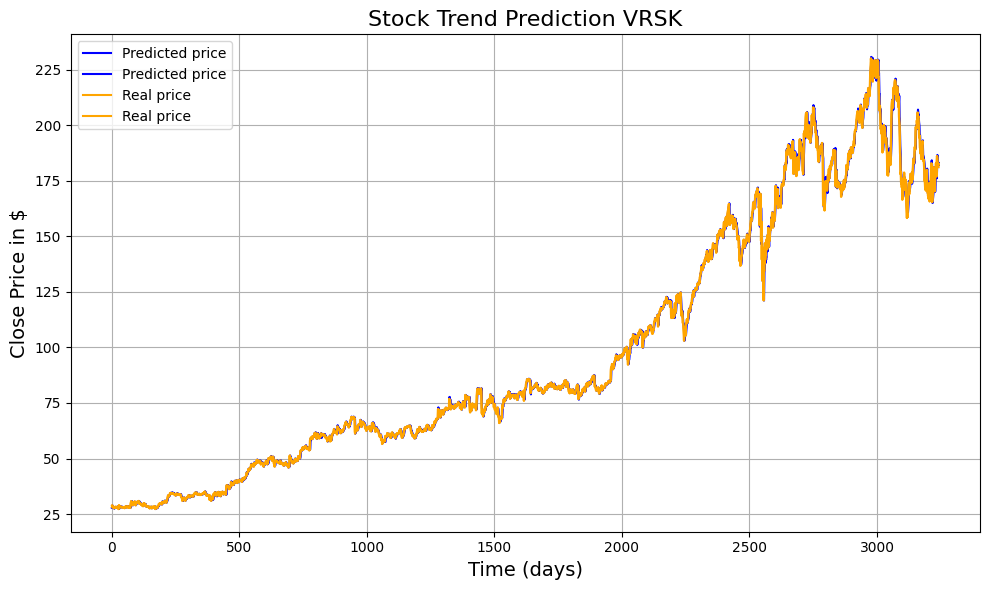

245/245 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
MSE on the test set:  0.018496806881920243


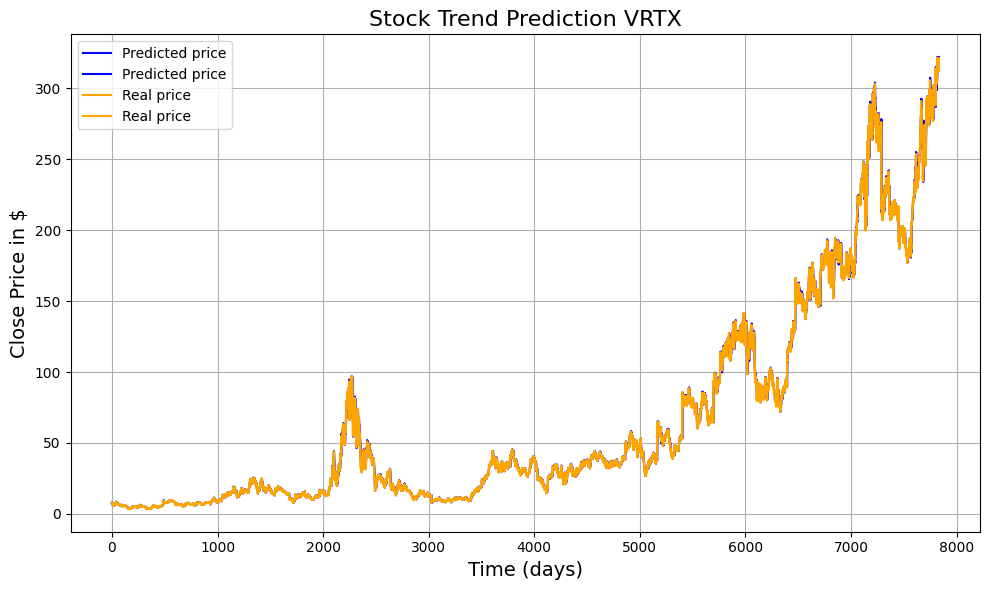

In [49]:
lstm_test_3 = tf.keras.models.load_model('lstm_dayrange.keras')

# Load all data first
(all_X_data, all_y_data,
all_X_data_norm, all_y_data_norm,
all_X_data_norm_t, all_y_data_norm_t,
all_feature_choice_indices) = load_all_data(
    nasqad100,
    features,
    window_size=window_size,
    k_days=k_days,
    feature_choice='Close',
    type=2
)

# Test on each stock
for stock in all_X_data.keys():
    plt.figure(figsize=(10, 6))  # Create a new figure for each stock
    model_test(
        lstm_test_3,
        all_X_data_norm_t[stock],
        all_y_data_norm[stock],
        all_X_data[stock],
        all_y_data[stock],
        all_feature_choice_indices[stock],
        stock
    )

# Task 2

## Task 2.1

In [ ]:
# Parameters
window_size = 30  # Time window for data feature (size of 'number of days').
features = ['Open', 'High', 'Low', 'Close', 'Volume']

In [ ]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-vn-20230228/stock-historical-data/HPG-VNINDEX-History.csv',
    features=features,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type = 0
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3809 entries, 0 to 3808
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   3809 non-null   int64  
 1   Open         3809 non-null   float64
 2   High         3809 non-null   float64
 3   Low          3809 non-null   float64
 4   Close        3809 non-null   float64
 5   Volume       3809 non-null   int64  
 6   TradingDate  3809 non-null   object 
dtypes: float64(4), int64(2), object(1)
memory usage: 208.4+ KB
Shape of training set:  (2418, 30, 5)
Shape of validation set:  (605, 30, 5)
Shape of test set:  (756, 30, 5)


### 1D Convolutional Neural Network

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_54 (Conv1D)              │ (None, 30, 64)         │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_54 (MaxPooling1D) │ (None, 15, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_55 (Conv1D)              │ (None, 15, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_55 (MaxPooling1D) │ (None, 7, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_56 (Conv1D)              │ (None, 7, 64)          │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_56 (MaxPooling1D) │ (None, 3, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 100)            │        19,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 69,769 (272.54 KB)

 Trainable params: 69,769 (272.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step - loss: 0.4616 - mse: 0.4616
Epoch 1: val_loss improved from inf to 0.41023, saving model to 1dcnn_vn_nor.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 135ms/step - loss: 6.9459 - mse: 6.9459 - val_loss: 0.4102 - val_mse: 0.4102 - learning_rate: 0.0100
Epoch 2/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 0.4534 - mse: 0.4534
Epoch 2: val_loss improved from 0.41023 to 0.36213, saving model to 1dcnn_vn_nor.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.4528 - mse: 0.4528 - val_loss: 0.3621 - val_mse: 0.3621 - learning_rate: 0.0100
Epoch 3/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 0.3900 - mse: 0.3900
Epoch 3: val_loss improved from 0.36213 to 0.25387, saving model to 1dcnn_vn_nor.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 0.3832 - mse: 0.3832 - val_loss: 0.2539 - val_mse: 0.2539 - learning_rate: 0.0100
Epoch 4/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.2664 - mse: 0.2664
Epoch 4: val_loss improved from 0.25387 to 0.167

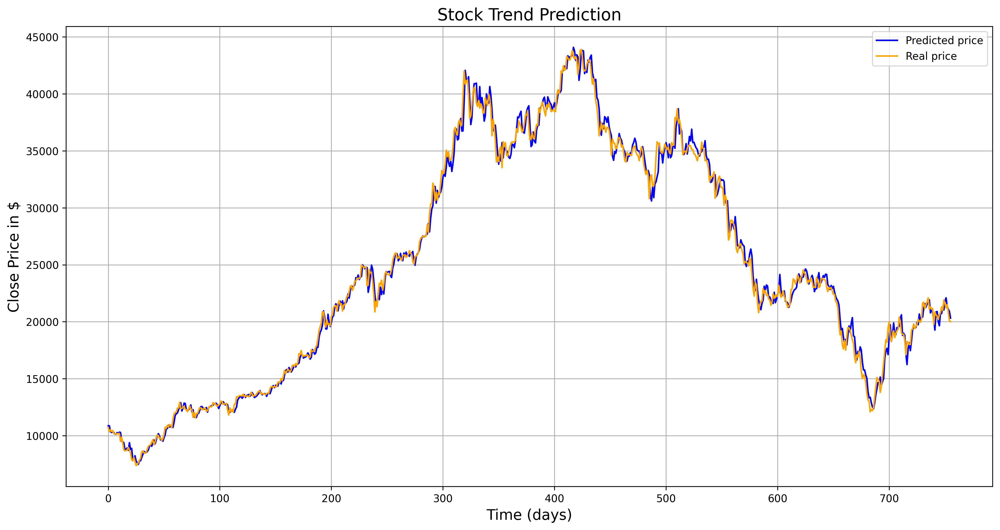

In [ ]:
conv1d_4, conv1d_4_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='1dcnn_vn_nor')
cnn_test(conv1d_4, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_14 (LSTM)                  │ (None, 30, 32)         │         4,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_15 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,297 (141.79 KB)

 Trainable params: 36,297 (141.79 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.3887 - mse: 0.3887
Epoch 1: val_loss improved from inf to 0.10015, saving model to lstm_vn_nor.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 235ms/step - loss: 0.4720 - mse: 0.4720 - val_loss: 0.1002 - val_mse: 0.1002 - learning_rate: 0.0100
Epoch 2/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - loss: 0.1611 - mse: 0.1611
Epoch 2: val_loss did not improve from 0.10015
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.1944 - mse: 0.1944 - val_loss: 0.2354 - val_mse: 0.2354 - learning_rate: 0.0100
Epoch 3/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.2277 - mse: 0.2277
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.007999999821186066.

Epoch 3: val_loss did not improve from 0.10015
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - loss: 0.2224 - mse: 0.2224 - val_loss: 0.2003 - val_mse: 0.2003 - learning_rate: 0.0100
Epoch 4/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 0.1707 - mse: 0.1707
Epoch 4: val_loss did not improve from 0.10015
3/3 

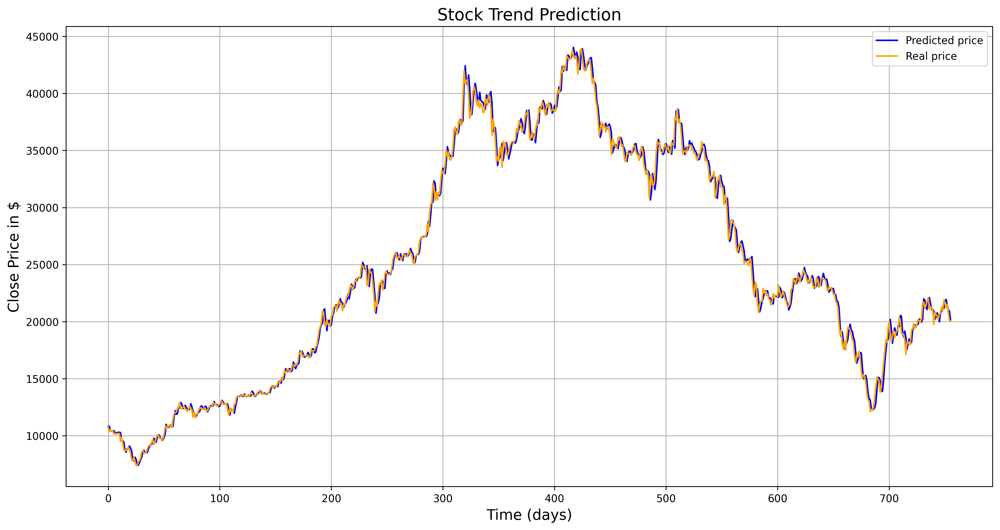

In [ ]:
lstm_4, lstm_4_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='lstm_vn_nor')
lstm_test(lstm_4, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

## Task 2.2

In [ ]:
# Parameters
window_size = 60  # Time window for data feature (size of 'number of days').
features = ['Open', 'High', 'Low', 'Close', 'Volume']
k_days = 1  # Number of days to predict in the future

In [ ]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-vn-20230228/stock-historical-data/HPG-VNINDEX-History.csv',
    features=features,
    k_days=k_days,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type = 1
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3809 entries, 0 to 3808
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   3809 non-null   int64  
 1   Open         3809 non-null   float64
 2   High         3809 non-null   float64
 3   Low          3809 non-null   float64
 4   Close        3809 non-null   float64
 5   Volume       3809 non-null   int64  
 6   TradingDate  3809 non-null   object 
dtypes: float64(4), int64(2), object(1)
memory usage: 208.4+ KB


Shape of training set:  (2398, 60, 5)
Shape of validation set:  (600, 60, 5)
Shape of test set:  (750, 60, 5)


### 1D Convolutional Neural Network

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_57 (Conv1D)              │ (None, 60, 64)         │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_57 (MaxPooling1D) │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_58 (Conv1D)              │ (None, 30, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_58 (MaxPooling1D) │ (None, 15, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_59 (Conv1D)              │ (None, 15, 64)         │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_59 (MaxPooling1D) │ (None, 7, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 448)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 100)            │        44,900 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 95,369 (372.54 KB)

 Trainable params: 95,369 (372.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/60
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 10.8662 - mse: 10.8662
Epoch 1: val_loss improved from inf to 0.36442, saving model to 1dcnn_vn_day.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 152ms/step - loss: 14.5520 - mse: 14.5520 - val_loss: 0.3644 - val_mse: 0.3644 - learning_rate: 0.0100
Epoch 2/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.4333 - mse: 0.4333
Epoch 2: val_loss improved from 0.36442 to 0.25467, saving model to 1dcnn_vn_day.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.4315 - mse: 0.4315 - val_loss: 0.2547 - val_mse: 0.2547 - learning_rate: 0.0100
Epoch 3/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.2675 - mse: 0.2675
Epoch 3: val_loss improved from 0.25467 to 0.20989, saving model to 1dcnn_vn_day.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.2602 - mse: 0.2602 - val_loss: 0.2099 - val_mse: 0.2099 - learning_rate: 0.0100
Epoch 4/60
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.1823 - mse: 0.1823
Epoch 4: val_loss improved from 0.20989 to

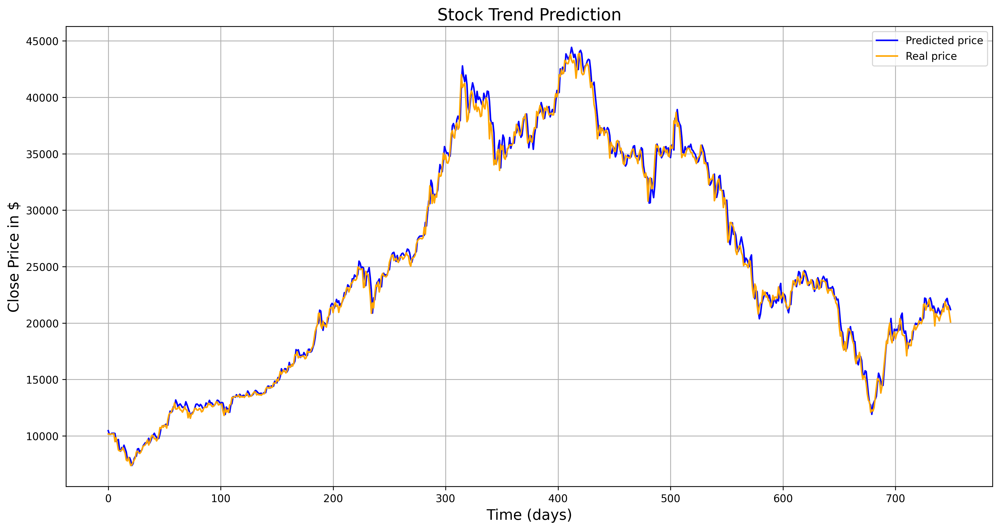

In [ ]:
conv1d_5, conv1d_5_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=60, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='1dcnn_vn_day')
cnn_test(conv1d_5, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_16 (LSTM)                  │ (None, 60, 32)         │         4,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_17 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,297 (141.79 KB)

 Trainable params: 36,297 (141.79 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - loss: 0.3053 - mse: 0.3053
Epoch 1: val_loss improved from inf to 0.04966, saving model to lstm_vn_day.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 465ms/step - loss: 0.2891 - mse: 0.2891 - val_loss: 0.0497 - val_mse: 0.0497 - learning_rate: 0.0100
Epoch 2/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 0.0647 - mse: 0.0647
Epoch 2: val_loss did not improve from 0.04966
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 173ms/step - loss: 0.0661 - mse: 0.0661 - val_loss: 0.0532 - val_mse: 0.0532 - learning_rate: 0.0100
Epoch 3/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - loss: 0.0546 - mse: 0.0546
Epoch 3: val_loss improved from 0.04966 to 0.03877, saving model to lstm_vn_day.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 212ms/step - loss: 0.0535 - mse: 0.0535 - val_loss: 0.0388 - val_mse: 0.0388 - learning_rate: 0.0100
Epoch 4/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step - loss: 0.0339 - mse: 0.0339
Epoch 4: val_loss improved from 0.03877 to 0.02668, saving model to lstm_vn_day.ke

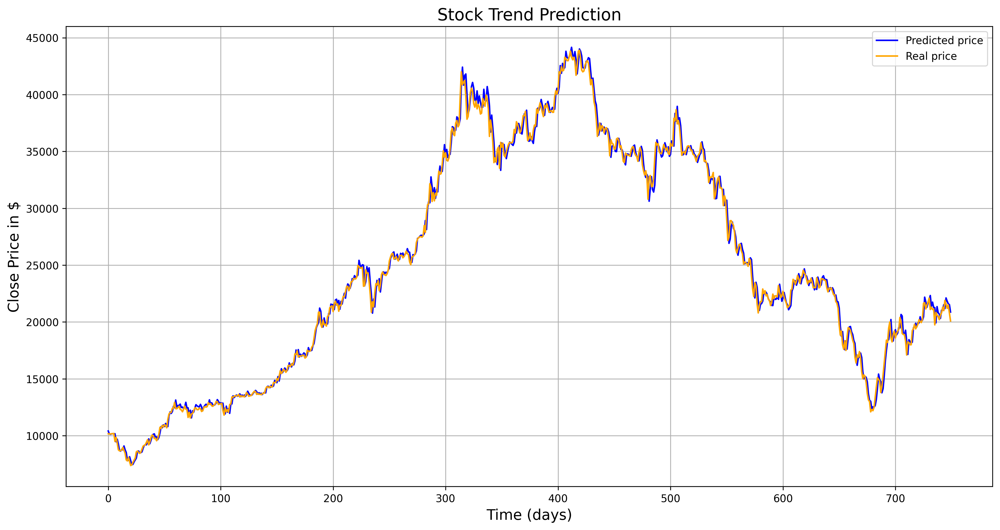

In [ ]:
lstm_5, lstm_5_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=60, batch_size=1024,min_lr=0.005,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='lstm_vn_day')
lstm_test(lstm_5, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

## Task 2.3

In [ ]:
# Parameters
window_size = 90  # Time window for data feature (size of 'number of days').
features = ['Open', 'High', 'Low', 'Close', 'Volume']
k_days = 2 # Number of days to predict in the future

In [ ]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation(
    data_path='./data-vn-20230228/stock-historical-data/HPG-VNINDEX-History.csv',
    features=features,
    k_days=k_days,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    type = 2
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3809 entries, 0 to 3808
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   3809 non-null   int64  
 1   Open         3809 non-null   float64
 2   High         3809 non-null   float64
 3   Low          3809 non-null   float64
 4   Close        3809 non-null   float64
 5   Volume       3809 non-null   int64  
 6   TradingDate  3809 non-null   object 
dtypes: float64(4), int64(2), object(1)
memory usage: 208.4+ KB
Shape of training set:  (2379, 90, 5)
Shape of validation set:  (595, 90, 5)
Shape of test set:  (744, 90, 5)


### 1D Convolutional Neural Network

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_60 (Conv1D)              │ (None, 90, 64)         │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_60 (MaxPooling1D) │ (None, 45, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_61 (Conv1D)              │ (None, 45, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_61 (MaxPooling1D) │ (None, 22, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_62 (Conv1D)              │ (None, 22, 64)         │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_62 (MaxPooling1D) │ (None, 11, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 704)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 100)            │        70,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │           202 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 121,070 (472.93 KB)

 Trainable params: 121,070 (472.93 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 4.3546 - mse: 4.3546
Epoch 1: val_loss improved from inf to 0.36071, saving model to 1dcnn_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 161ms/step - loss: 5.7101 - mse: 5.7101 - val_loss: 0.3607 - val_mse: 0.3607 - learning_rate: 0.0100
Epoch 2/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 0.4612 - mse: 0.4612
Epoch 2: val_loss improved from 0.36071 to 0.21107, saving model to 1dcnn_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 0.4536 - mse: 0.4536 - val_loss: 0.2111 - val_mse: 0.2111 - learning_rate: 0.0100
Epoch 3/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - loss: 0.2529 - mse: 0.2529
Epoch 3: val_loss improved from 0.21107 to 0.16727, saving model to 1dcnn_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - loss: 0.2370 - mse: 0.2370 - val_loss: 0.1673 - val_mse: 0.1673 - learning_rate: 0.0100
Epoch 4/50
2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.1490 - mse: 0.1490
Epoch 4: val_loss improved from

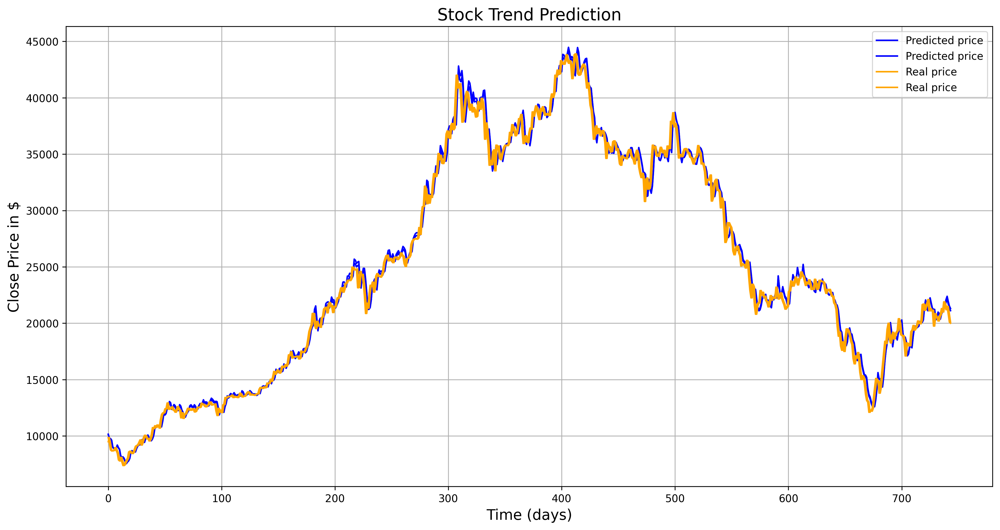

In [ ]:
conv1d_6, conv1d_6_history = cnn_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=k_days,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=1024,min_lr=0.008,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='1dcnn_vn_dayrange')
cnn_test(conv1d_6, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

### LSTM

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_18 (LSTM)                  │ (None, 90, 32)         │         4,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_19 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │           202 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,398 (142.18 KB)

 Trainable params: 36,398 (142.18 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - loss: 0.4185 - mse: 0.4185
Epoch 1: val_loss improved from inf to 0.12442, saving model to lstm_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 381ms/step - loss: 0.4053 - mse: 0.4053 - val_loss: 0.1244 - val_mse: 0.1244 - learning_rate: 0.0100
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - loss: 0.1510 - mse: 0.1510
Epoch 2: val_loss improved from 0.12442 to 0.05417, saving model to lstm_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 252ms/step - loss: 0.1493 - mse: 0.1493 - val_loss: 0.0542 - val_mse: 0.0542 - learning_rate: 0.0100
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step - loss: 0.0610 - mse: 0.0610
Epoch 3: val_loss improved from 0.05417 to 0.03812, saving model to lstm_vn_dayrange.keras
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 332ms/step - loss: 0.0619 - mse: 0.0619 - val_loss: 0.0381 - val_mse: 0.0381 - learning_rate: 0.0100
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - loss: 0.0511 - mse: 0.0511
Epoch 4: val_loss improved from 0.03

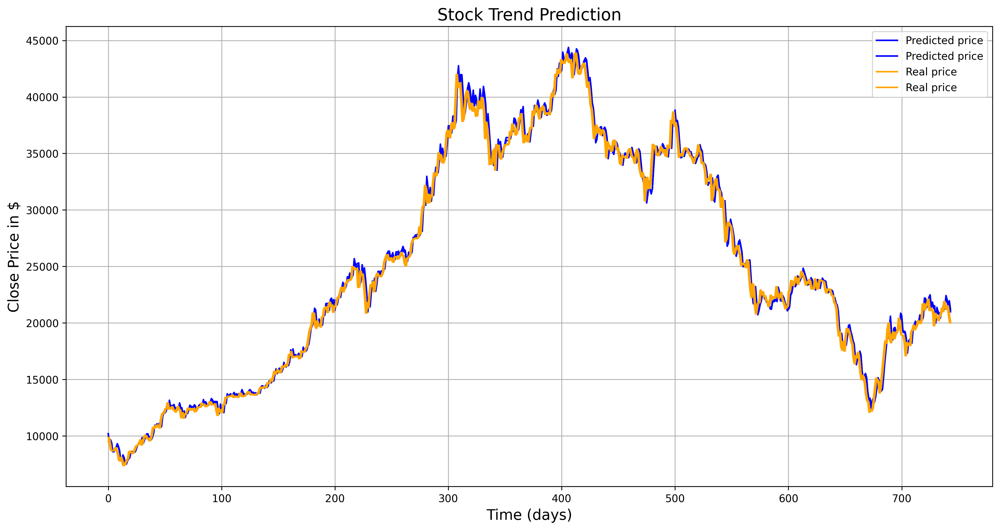

In [ ]:
lstm_6, lstm_6_history = lstm_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=k_days,monitor="val_loss",learning_rate=0.01,epochs=100, batch_size=1024,min_lr=0.008,lr_patience=2,es_patience=8,feature_len=len(features),checkpoint_header='lstm_vn_dayrange')
lstm_test(lstm_6, X_test_norm_t, y_test_norm_t, X_test, y_test, feature_choice_index)

# Task 3

In [ ]:
def cnn_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size, n_dense=1, monitor="val_loss", learning_rate=0.001, epochs=50, batch_size=512, min_lr=0.0001, lr_patience=2, es_patience=5, feature_len=6):
    lower_lr = ReduceLROnPlateau(monitor=monitor, factor=0.8, patience=lr_patience, verbose=1, min_lr=min_lr)
    earlystopping = EarlyStopping(monitor=monitor, patience=es_patience, verbose=1)
    checkpoint = ModelCheckpoint(filepath='1dcnn_c.{epoch:02d}-{val_loss:.6f}.keras', verbose=1, save_best_only=True, mode='min')

    conv1d = tf.keras.Sequential()
    conv1d.add(Conv1D(64, kernel_size=3, activation='relu', input_shape=(window_size, feature_len), padding='same'))
    conv1d.add(MaxPooling1D(pool_size=2))
    conv1d.add(Conv1D(128, kernel_size=3, activation='relu', padding='same'))
    conv1d.add(MaxPooling1D(2))
    conv1d.add(Conv1D(64, kernel_size=3, activation='relu', padding='same'))
    conv1d.add(MaxPooling1D(2))
    conv1d.add(Flatten())
    conv1d.add(Dense(100, activation='relu'))
    conv1d.add(Dense(n_dense, activation='sigmoid'))

    conv1d.summary()
    conv1d.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])

    history = conv1d.fit(X_train_norm_t, y_train_norm_t, validation_data=(X_val_norm_t, y_val_norm_t), epochs=epochs, batch_size=batch_size, callbacks=[lower_lr, earlystopping, checkpoint])
    return conv1d, history

In [ ]:
def lstm_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size, n_dense=1,monitor="val_loss",learning_rate=0.01,epochs=50, batch_size=512,min_lr=0.005,sample_weights=None,lr_patience=2,es_patience=5,feature_len = 6):
    lower_lr = ReduceLROnPlateau(monitor=monitor, factor=0.8, patience=lr_patience, verbose=1,min_lr=min_lr) # add reduce learning rate value to (maybe) solve the problems above
    earlystopping = EarlyStopping(monitor=monitor, patience=es_patience, verbose=1)
    # checkpoint to check the best model snapshot
    checkpoint = ModelCheckpoint(filepath = 'lstm_c.{val_loss:.6f}.keras',
                               verbose=1,
                               save_best_only=True,mode='min')
    
    ### Create and train the model

    # Build the model architecture
    lstm = tf.keras.Sequential()
    lstm.add(LSTM(units=32, return_sequences=True, input_shape=(window_size,feature_len)))
    lstm.add(LSTM(units=64))
    lstm.add(Dense(100, activation='relu'))
    lstm.add(Dense(n_dense, activation='sigmoid')) # By default: activation='linear', i.e., passing through f(x) = x

    # Compile and train the lstm with Mean Squared Error loss function
    lstm.summary()
    tf.debugging.check_numerics(X_train_norm_t, "Check input data")
    lstm.compile(optimizer= tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    history = lstm.fit(X_train_norm_t, y_train_norm_t, validation_data=(X_val_norm_t,y_val_norm_t), epochs=epochs, batch_size=batch_size, callbacks=[lower_lr, earlystopping,checkpoint], sample_weight=sample_weights)
    
    return lstm, history
    # Calculate the number of parameters of each layer
    # LSTM_1: input_dim = 1, output_dim = 32 --> 4*(1*32+32*32+32) = 4,352 params.
    # LSTM_2: input_dim = 32, output_dim = 64 --> 4*(32*64+64*64+64) = 24,832 params
    # Dense(100) = (64+1)*100 = 6,500 params.
    # Dense(1) = (100+1)*1 = 101 params.

In [ ]:
def create_labels(df, col_name, window_size=11, buy=True):
    """
    Create labels for a given dataframe based on a specified column and window size.

    This function generates labels for a trading strategy based on the minimum or maximum price
    within a sliding window. The labels indicate whether to buy, sell, or hold based on the 
    position of the minimum or maximum price within the window.

    Parameters:
    df (pd.DataFrame): Dataframe containing the data.
    col_name (str): Name of the column to be used for determining the strategy.
    window_size (int, optional): Size of the sliding window. Default is 11.
    buy (bool, optional): If True, labels are generated for a buying strategy. If False, labels are 
                        generated for a selling strategy. Default is True.

    Returns:
    np.ndarray: Array of integer labels with size equal to the number of rows in the dataframe.
                The labels are:
                - 1: Buy (if `buy` is True) or Sell (if `buy` is False)
                - 0: Hold
                The array will contain NaN values for the initial rows where the window size is not met.
    """

    row_counter = 0
    total_rows = len(df)
    labels = np.zeros(total_rows)
    labels[:] = np.nan
    print("Calculating labels")

    while row_counter < total_rows:
        if row_counter >= window_size - 1:
            window_begin = row_counter - (window_size - 1)
            window_end = row_counter
            window_middle = (window_begin + window_end) // 2  # Use integer division instead of regular division

            min_ = np.inf
            min_index = -1
            max_ = -np.inf
            max_index = -1
            for i in range(window_begin, window_end + 1):
                price = df.iloc[i][col_name]
                if price < min_:
                    min_ = price
                    min_index = i
                if price > max_:
                    max_ = price
                    max_index = i

            # if max_index == window_middle:
            #     labels[window_middle] = 0
            # elif min_index == window_middle:
            #     labels[window_middle] = 1
            # else:
            #     labels[window_middle] = 2
            if buy:
                if min_index == window_middle:
                    labels[window_middle] = 1 # buy
                else:
                    labels[window_middle] = 0 # hold
            else:
                if max_index == window_middle:
                    labels[window_middle] = 1 # sell
                else:
                    labels[window_middle] = 0 # hold

        row_counter = row_counter + 1
    return labels


In [ ]:
def add_technical_indicators(df):
    # Simple Moving Average
    df['SMA'] = df['Close'].rolling(window=30).mean()
    
    # Moving Average Convergence Divergence (MACD)
    df['EMA_12'] = df['Close'].ewm(span=12, adjust=False).mean()
    df['EMA_26'] = df['Close'].ewm(span=26, adjust=False).mean()
    df['MACD'] = df['EMA_12'] - df['EMA_26']
    df['MACD_S'] = df['MACD'].ewm(span=9, adjust=False).mean()
    df['MACD_H'] = df['MACD'] - df['MACD_S']
    
    # Relative Strength Index (RSI)
    delta = df['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
    rs = gain / loss
    df['RSI'] = 100 - (100 / (1 + rs))
    
    # Subtract lowest value from each period from the highest
    high_low = df['High'] - df['Low']

    # Take the absolute value of the close from the high
    high_close = np.abs(df['High'] - df['Close'].shift())

    # Same with the low
    low_close = np.abs(df['Low'] - df['Close'].shift())

    # Concat into a single table
    ranges = pd.concat([high_low, high_close, low_close], axis=1)

    # Take the largest value from each row
    true_range = np.max(ranges, axis=1)

    # Calculate 14 day rolling average
    ATR = true_range.rolling(14).sum()/14

    df['ATR'] = df.index.map(ATR)

    return df

In [ ]:
def data_preparation_ta(data_path, features, feature_choice = 'Close',window_size = 30, test_size = 0.20,buy=True):
    """
    Prepare data for training, validation, and testing of a machine learning model. 
    This also has nafill to 0 for trading indicators because the first 30 days will easily have nan value

    This function performs the following steps:
    1. Loads data from a CSV file.
    2. Adds technical indicators to the dataframe.
    3. Generates labels for the data based on the 'Close' price.
    4. Splits the dataset into time windows to create data samples.
    5. Normalizes the data using Min-Max normalization.
    6. Splits the data into training, validation, and test sets.
    7. Reshapes the data to fit the neural network input shape requirements.
    8. Converts the labels to TensorFlow tensors.

    Parameters:
    data_path (str): Path to the CSV file containing the data.
    features (list): List of feature names to be used for prediction.
    feature_choice (str, optional): The feature to be used for normalization. Default is 'Close'.
    window_size (int, optional): Size of the sliding window. Default is 30.
    test_size (float, optional): Proportion of the dataset to include in the test split. Default is 0.20.
    buy (bool, optional): If True, labels are generated for a buying strategy. If False, labels are generated for selling strategy. Default is True.

    Returns:
    tuple: A tuple containing the following elements:
        - data (pd.DataFrame): The original dataframe.
        - X_data (np.ndarray): The feature data samples.
        - y_data (np.ndarray): The labels for the data samples.
        - X_train (np.ndarray): The training feature data.
        - X_val (np.ndarray): The validation feature data.
        - X_test (np.ndarray): The test feature data.
        - y_train (np.ndarray): The training labels.
        - y_val (np.ndarray): The validation labels.
        - y_test (np.ndarray): The test labels.
        - X_train_norm (np.ndarray): The normalized training feature data.
        - X_val_norm (np.ndarray): The normalized validation feature data.
        - X_test_norm (np.ndarray): The normalized test feature data.
        - y_train_norm (np.ndarray): The normalized training labels.
        - y_val_norm (np.ndarray): The normalized validation labels.
        - y_test_norm (np.ndarray): The normalized test labels.
        - X_train_norm_t (tf.Tensor): The normalized training feature data as TensorFlow tensors.
        - X_val_norm_t (tf.Tensor): The normalized validation feature data as TensorFlow tensors.
        - X_test_norm_t (tf.Tensor): The normalized test feature data as TensorFlow tensors.
        - y_train_norm_t (tf.Tensor): The normalized training labels as TensorFlow tensors.
        - y_val_norm_t (tf.Tensor): The normalized validation labels as TensorFlow tensors.
        - y_test_norm_t (tf.Tensor): The normalized test labels as TensorFlow tensors.
        - feature_choice_index (int): The index of the feature_choice in the features list.
    """
    
    # load data
    data = pd.read_csv(data_path,index_col=0)
    # Show some first data samples
    data.head()
    data.info()
    df = data.copy()
    df = add_technical_indicators(df)
    df['Labels'] = create_labels(df, 'Close', window_size=window_size,buy=buy)
    df = df.dropna(subset=['Labels'])
    # get amount of non nan values
    # Split the dataset into time windows to get data samples.
    # Define the features to be used for prediction
    # get feature_choice index in features
    feature_choice_index = features.index(feature_choice)
    if feature_choice_index == -1:
        raise ValueError("Feature not found in features list")
    # Pre-allocate arrays for X_data and y_data
    num_samples = len(df) - window_size 
    X_data = np.empty((num_samples, window_size, len(features)))
    y_data = np.empty((len(df['Labels'])- window_size, 1))

    # Use NumPy array slicing for efficient data extraction
    for i in range(num_samples):
        # Use slicing to get the features for the window
        X_data[i] = df.iloc[i:i + window_size][features].values
        
        # get label
        y_data[i] = df['Labels'].iloc[i + window_size-1]
    
    X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, test_size=test_size, shuffle=False)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=test_size, shuffle=False)

    # Convert from lists to Numpy arrays for reshaping purpose
    X_train = np.array(np.nan_to_num(X_train))
    X_val = np.array(np.nan_to_num(X_val))
    X_test = np.array(np.nan_to_num(X_test))
    y_train = np.array(np.nan_to_num(y_train))
    y_val = np.array(np.nan_to_num(y_val))
    y_test = np.array(np.nan_to_num(y_test))

    # Reshape the numpy array to fit the neural network input shape requirement
    X_train = X_train.reshape(X_train.shape[0], window_size, len(features))
    X_val = X_val.reshape(X_val.shape[0], window_size, len(features))
    X_test = X_test.reshape(X_test.shape[0], window_size, len(features))
    
    # Print shape of the training, validation and test set
    print("Shape of training set: ", X_train.shape)
    print("Shape of validation set: ", X_val.shape)
    print("Shape of test set: ", X_test.shape)
    
    X_train_norm, _, X_train_norm_t, _ = min_max_normalize(X_train, y_train, feature_choice_index,len(features))
    X_val_norm, _, X_val_norm_t, _ = min_max_normalize(X_val, y_val, feature_choice_index,len(features))
    X_test_norm, _, X_test_norm_t, _ = min_max_normalize(X_test, y_test, feature_choice_index,len(features))
    
    y_train_norm_t = tf.convert_to_tensor(y_train, dtype=tf.float32)
    y_val_norm_t = tf.convert_to_tensor(y_val, dtype=tf.float32)
    y_test_norm_t = tf.convert_to_tensor(y_test, dtype=tf.float32)
    
    return data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index

In [ ]:
def model_test(model, X_test, y_test,label):
    """
    Evaluate the model on the test data and visualize the predictions.

    This function performs the following steps:
    1. Evaluates the model on the test data and prints the test accuracy.
    2. Gets predictions from the model on the test data.
    3. Converts the predictions to binary classes based on a threshold of 0.5.
    4. Visualizes the predicted and actual buying signals.

    Parameters:
    model (tf.keras.Model): The trained model to be evaluated.
    X_test (np.ndarray): The test feature data.
    y_test (np.ndarray): The test labels.
    label (str): The label of the signal to be predicted.

    Returns:
    None
    """
    loss, accuracy = model.evaluate(X_test, y_test)
    print(f'Test Accuracy: {accuracy:.2f}')

    # Get predictions
    predictions = model.predict(X_test)
    predicted_classes = (predictions > 0.5).astype(int)

    # Visualize predictions
    plt.figure(figsize=(14, 7))
    plt.plot(predicted_classes, label=f'Predicted {label} Signal', color='blue')
    plt.plot(y_test, label=f'Actual {label} Signal', color='orange')
    plt.title(f'{label} Signal Prediction')
    plt.xlabel('Days')
    plt.ylabel('Signal')
    plt.legend()
    plt.show()

## Task 3.1

In [ ]:
features = ['Open', 'High', 'Low', 'Close','SMA','EMA_12','EMA_26','MACD','RSI','MACD_H','ATR']
window_size = 26

In [ ]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation_ta(
    data_path='./data-vn-20230228/stock-historical-data/HPG-VNINDEX-History.csv',
    features=features,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20
)

<class 'pandas.core.frame.DataFrame'>
Index: 3809 entries, 0 to 3808
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Open         3809 non-null   float64
 1   High         3809 non-null   float64
 2   Low          3809 non-null   float64
 3   Close        3809 non-null   float64
 4   Volume       3809 non-null   int64  
 5   TradingDate  3809 non-null   object 
dtypes: float64(4), int64(1), object(1)
memory usage: 208.3+ KB
Calculating labels


Shape of training set:  (2404, 26, 11)
Shape of validation set:  (602, 26, 11)
Shape of test set:  (752, 26, 11)


### 1D CNN

In [ ]:
cnn_model_buy, cnn_model_buy_history = cnn_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.005,epochs=50, batch_size=512,min_lr=0.005,lr_patience=2,es_patience=50,feature_len=len(features))

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_18 (Conv1D)              │ (None, 26, 64)         │         2,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_18 (MaxPooling1D) │ (None, 13, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_19 (Conv1D)              │ (None, 13, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_19 (MaxPooling1D) │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_20 (Conv1D)              │ (None, 6, 64)          │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_20 (MaxPooling1D) │ (None, 3, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 100)            │        19,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 70,921 (277.04 KB)

 Trainable params: 70,921 (277.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7491 - loss: 0.4148
Epoch 1: val_loss improved from inf to 0.10144, saving model to 1dcnn_c.01-0.101443.keras
5/5 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.7695 - loss: 0.3944 - val_accuracy: 0.9817 - val_loss: 0.1014 - learning_rate: 0.0050
Epoch 2/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.9805 - loss: 0.1145
Epoch 2: val_loss improved from 0.10144 to 0.09359, saving model to 1dcnn_c.02-0.093585.keras
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - accuracy: 0.9776 - loss: 0.1276 - val_accuracy: 0.9817 - val_loss: 0.0936 - learning_rate: 0.0050
Epoch 3/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.9844 - loss: 0.0878
Epoch 3: val_loss improved from 0.09359 to 0.09117, saving model to 1dcnn_c.03-0.091171.keras
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.9808 - loss: 0.1124 - val_accuracy: 0.9817 - val_loss: 0.0912 - learning_rate: 0.0050
Epoch 4/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - accuracy: 0.9727 - 

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9837 - loss: 3731.1584  


Test Accuracy: 0.98
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


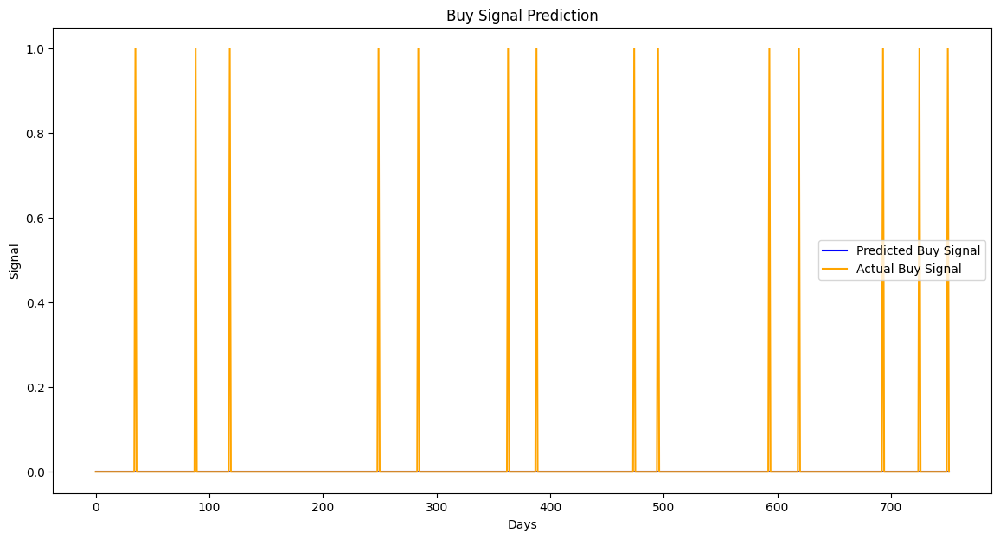

In [ ]:
model_test(model=cnn_model_buy, X_test=X_test,y_test=y_test,label='Buy')

### LSTM

In [ ]:
lstm_buy, lstm_buy_hist = lstm_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.005,epochs=20, batch_size=30,min_lr=0.005,lr_patience=1,es_patience=100,feature_len=len(features))

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_12 (LSTM)                  │ (None, 26, 32)         │         5,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_13 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,065 (144.79 KB)

 Trainable params: 37,065 (144.79 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
75/81 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9712 - loss: 0.1822
Epoch 1: val_loss improved from inf to 0.09198, saving model to lstm_c.0.091980.keras
81/81 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.9717 - loss: 0.1775 - val_accuracy: 0.9817 - val_loss: 0.0920 - learning_rate: 0.0050
Epoch 2/20
75/81 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9780 - loss: 0.1057
Epoch 2: val_loss improved from 0.09198 to 0.07508, saving model to lstm_c.0.075075.keras
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.9779 - loss: 0.1054 - val_accuracy: 0.9817 - val_loss: 0.0751 - learning_rate: 0.0050
Epoch 3/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9743 - loss: 0.1040
Epoch 3: val_loss improved from 0.07508 to 0.06824, saving model to lstm_c.0.068242.keras
81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.9743 - loss: 0.1038 - val_accuracy: 0.9817 - val_loss: 0.0682 - learning_rate: 0.0050
Epoch 4/20
80/81 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.

 1/24 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 1.0000 - loss: 2.3946e-04

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9837 - loss: 0.1353   
Test Accuracy: 0.98
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


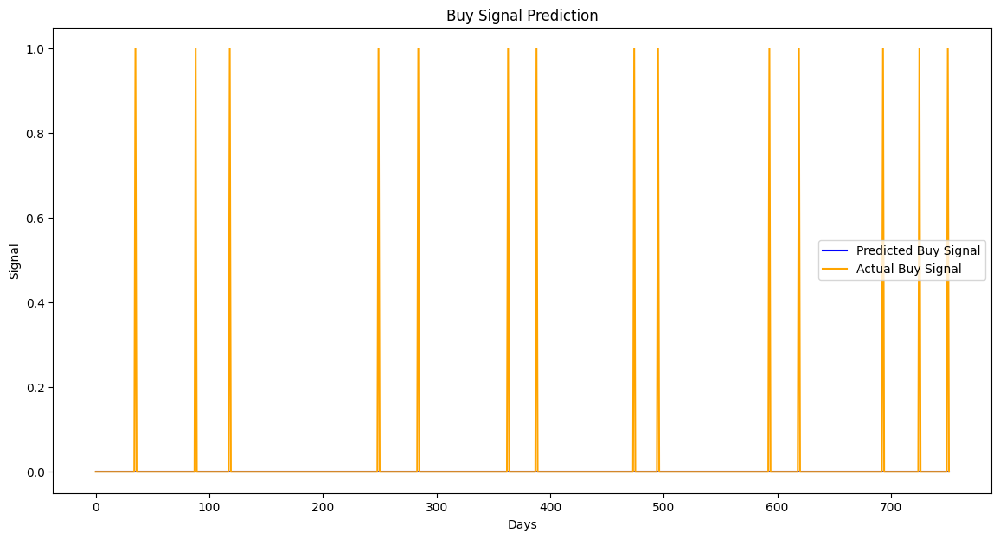

In [ ]:
model_test(model=lstm_buy, X_test=X_test,y_test=y_test,label='Buy')

## Task 3.2

In [ ]:
features = ['Open', 'High', 'Low', 'Close','SMA','EMA_12','EMA_26','MACD','RSI','MACD_H','ATR']
window_size = 30

In [ ]:
data, X_data, y_data, X_train, X_val, X_test, y_train, y_val, y_test, X_train_norm, X_val_norm, X_test_norm, y_train_norm, y_val_norm, y_test_norm, X_train_norm_t, X_val_norm_t, X_test_norm_t, y_train_norm_t, y_val_norm_t, y_test_norm_t, feature_choice_index = data_preparation_ta(
    data_path='./data-vn-20230228/stock-historical-data/HPG-VNINDEX-History.csv',
    features=features,
    feature_choice='Close',
    window_size=window_size,
    test_size=0.20,
    buy=False
)

<class 'pandas.core.frame.DataFrame'>
Index: 3809 entries, 0 to 3808
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Open         3809 non-null   float64
 1   High         3809 non-null   float64
 2   Low          3809 non-null   float64
 3   Close        3809 non-null   float64
 4   Volume       3809 non-null   int64  
 5   TradingDate  3809 non-null   object 
dtypes: float64(4), int64(1), object(1)
memory usage: 208.3+ KB
Calculating labels
Shape of training set:  (2400, 30, 11)
Shape of validation set:  (600, 30, 11)
Shape of test set:  (750, 30, 11)


### 1D CNN

In [ ]:
cnn_model_sell, cnn_model_sell_history = cnn_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.005,epochs=50, batch_size=512,min_lr=0.005,lr_patience=2,es_patience=50,feature_len=len(features))

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_21 (Conv1D)              │ (None, 30, 64)         │         2,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_21 (MaxPooling1D) │ (None, 15, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_22 (Conv1D)              │ (None, 15, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_22 (MaxPooling1D) │ (None, 7, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_23 (Conv1D)              │ (None, 7, 64)          │        24,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_23 (MaxPooling1D) │ (None, 3, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 100)            │        19,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 70,921 (277.04 KB)

 Trainable params: 70,921 (277.04 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.9778 - loss: 0.3587
Epoch 1: val_loss improved from inf to 0.10940, saving model to 1dcnn_c.01-0.109404.keras
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step - accuracy: 0.9782 - loss: 0.3400 - val_accuracy: 0.9800 - val_loss: 0.1094 - learning_rate: 0.0050
Epoch 2/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - accuracy: 0.9844 - loss: 0.0847
Epoch 2: val_loss improved from 0.10940 to 0.09522, saving model to 1dcnn_c.02-0.095222.keras
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.9812 - loss: 0.0962 - val_accuracy: 0.9800 - val_loss: 0.0952 - learning_rate: 0.0050
Epoch 3/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - accuracy: 0.9766 - loss: 0.1079
Epoch 3: val_loss did not improve from 0.09522
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.9798 - loss: 0.0958 - val_accuracy: 0.9800 - val_loss: 0.0977 - learning_rate: 0.0050
Epoch 4/50
1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.9824 - loss: 0.0948
Epoch 4: val_loss did n

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9913 - loss: 1465.7272  


Test Accuracy: 0.99
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


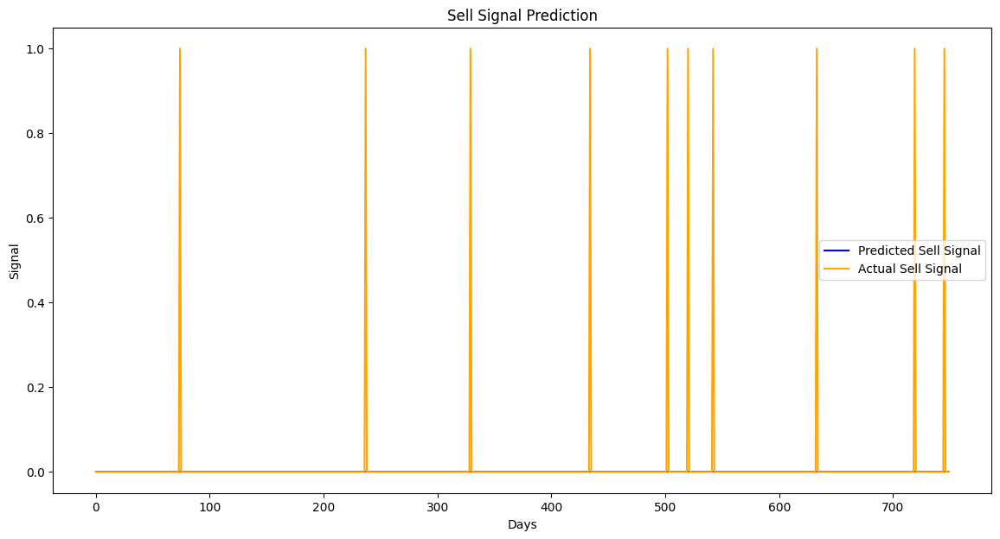

In [ ]:
model_test(model=cnn_model_sell, X_test=X_test,y_test=y_test,label='Sell')

### LSTM

In [ ]:
lstm_sell, lstm_sell_hist = lstm_c_model(X_train_norm_t, y_train_norm_t, X_val_norm_t, y_val_norm_t, window_size=window_size, n_dense=1,monitor="val_loss",learning_rate=0.005,epochs=20, batch_size=30,min_lr=0.005,lr_patience=1,es_patience=100,feature_len=len(features))

c:\Users\patata\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_14 (LSTM)                  │ (None, 30, 32)         │         5,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_15 (LSTM)                  │ (None, 64)             │        24,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 100)            │         6,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │           101 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,065 (144.79 KB)

 Trainable params: 37,065 (144.79 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
79/80 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9816 - loss: 0.1569
Epoch 1: val_loss improved from inf to 0.10610, saving model to lstm_c.0.106095.keras
80/80 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.9816 - loss: 0.1559 - val_accuracy: 0.9800 - val_loss: 0.1061 - learning_rate: 0.0050
Epoch 2/20
76/80 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9792 - loss: 0.1073
Epoch 2: val_loss improved from 0.10610 to 0.09409, saving model to lstm_c.0.094089.keras
80/80 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.9793 - loss: 0.1070 - val_accuracy: 0.9800 - val_loss: 0.0941 - learning_rate: 0.0050
Epoch 3/20
78/80 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9759 - loss: 0.1078
Epoch 3: val_loss improved from 0.09409 to 0.08705, saving model to lstm_c.0.087054.keras
80/80 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.9760 - loss: 0.1071 - val_accuracy: 0.9800 - val_loss: 0.0871 - learning_rate: 0.0050
Epoch 4/20
78/80 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9913 - loss: 0.2119
Test Accuracy: 0.99
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


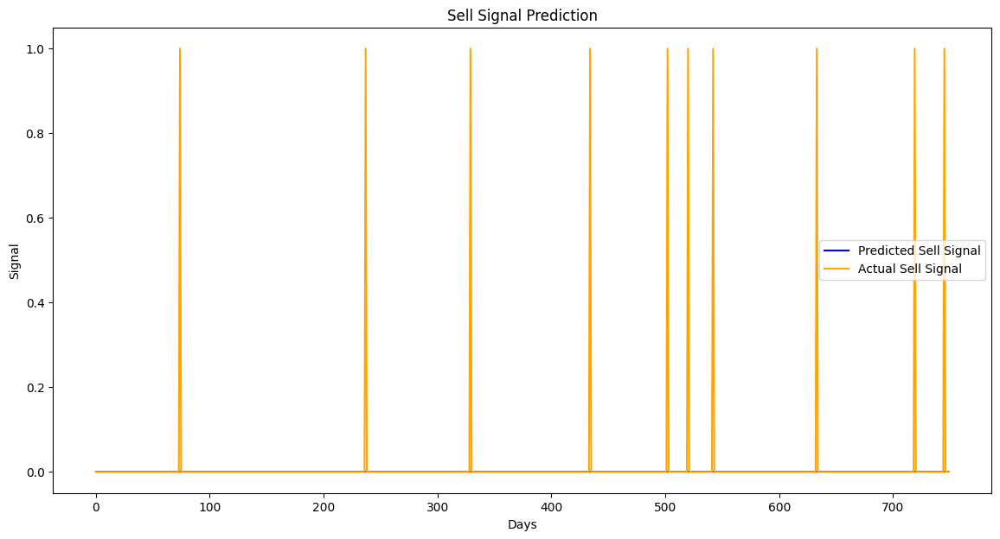

In [ ]:
model_test(model=lstm_sell, X_test=X_test,y_test=y_test,label='Sell')

# Task 4

In [ ]:
overview_data = pd.read_csv('./data-vn-20230228/ticker-overview.csv',index_col=0)
tickers = overview_data['ticker'].dropna().sort_values(ascending=True).reset_index(drop=True)
overview_data.head()

,exchange,shortName,industryID,industryIDv2,industry,industryEn,establishedYear,noEmployees,noShareholders,foreignPercent,...,deltaInMonth,deltaInYear,outstandingShare,issueShare,companyType,ticker,status,code,message,traceId
0,UPCOM,Đầu tư Phát triển Máy Việt Nam,211.0,3353.0,Ô tô và phụ tùng,Automobiles & Parts,NaN,352.0,105.0,0.000,...,-0.098,NaN,20.5,20.5,CT,VVS,NaN,NaN,NaN,NaN
1,UPCOM,Xây dựng Công trình Tân Cảng,181.0,2357.0,Xây dựng và Vật liệu,Construction & Materials,NaN,110.0,0.0,0.000,...,-0.082,NaN,9.0,0.0,CT,XDC,NaN,NaN,NaN,NaN
2,UPCOM,Gang Thép Hà Nội,159.0,1757.0,Tài nguyên Cơ bản,Basic Resources,2013.0,0.0,109.0,0.003,...,0.064,-0.370,15.7,15.7,CT,HSV,NaN,NaN,NaN,NaN
3,UPCOM,Than Cao Sơn - TKV,160.0,1771.0,Tài nguyên Cơ bản,Basic Resources,2020.0,3473.0,5157.0,0.039,...,0.093,0.457,42.8,42.8,CT,CST,NaN,NaN,NaN,NaN
4,UPCOM,BV Land,339.0,8637.0,Bất động sản,Real Estate,2008.0,46.0,175.0,0.000,...,-0.236,-0.433,57.3,57.3,CT,BVL,NaN,NaN,NaN,NaN


In [ ]:
# Configure logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s', datefmt='%d-%b-%y %H:%M:%S',filename='financial_ratio_analyzer.log', filemode='w')

class FinancialRatioAnalyzer:
    def __init__(self):
        """
        Financial Ratio Analysis and Scoring System
        """
        self.financial_metrics = [
            'priceToEarning', 
            'roe', 
            'roa', 
            'earningPerShare', 
            'debtOnEquity'
        ]
        self.scaler = MinMaxScaler()
        self.logger = logging.getLogger(__name__)

    def analyze_financial_ratios(self, financial_data: pd.DataFrame, price_history: Dict[str, pd.DataFrame]) -> pd.DataFrame:
        """
        Comprehensive financial ratio analysis and scoring
        """
        df = self._preprocess_financial_data(financial_data)
        if df.empty:
            return pd.DataFrame()  # Early exit if no data

        stock_summary = self._calculate_stock_summary(df)
        stock_summary[['priceToEarning', 'debtOnEquity']] *= -1  # Invert metrics

        valid_stocks = self.filter_abnormal_prices(price_history)
        df = df[df['ticker'].isin(valid_stocks)]
        trends_df = self.calculate_trend(df, self.financial_metrics, 'year')
        trend_columns = []
        # Merge each trend column back into stock_summary
        for metric in self.financial_metrics:
            if f'{metric}_trend' in trends_df.columns:
                stock_summary = stock_summary.merge(trends_df[['ticker', f'{metric}_trend']], on='ticker', how='left')
                trend_columns.append(f'{metric}_trend')
        stock_summary['cumulative_score'] = stock_summary[trend_columns].mean(axis=1)
        return stock_summary

    def _preprocess_financial_data(self, df: pd.DataFrame) -> pd.DataFrame:
        if 'ticker' not in df.columns:
            self.logger.warning("Tickefr column not found in financial data.")
            return pd.DataFrame()

        for metric in self.financial_metrics:
            lower_bound = df[metric].quantile(0.01)
            upper_bound = df[metric].quantile(0.99)
            df.loc[:,metric] = df[metric].clip(lower=lower_bound, upper=upper_bound)
        df.loc[:, self.financial_metrics] = df[self.financial_metrics].apply(lambda x: x.fillna(x.median()), axis=1)
        return df

    def calculate_trend(self, df: pd.DataFrame, metrics: list, time_col: str = 'year') -> pd.DataFrame:
        """
        Calculate trend for given metrics using Linear Regression
        """
        def calculate_single_trend(group, metric):
            if len(group) > 1:
                x = group[time_col].values.reshape(-1, 1)
                y = group[metric].values.reshape(-1, 1)
                model = LinearRegression()
                model.fit(x, y)
                return model.coef_[0][0]  # Return the slope (trend)
            return 0  # Return 0 if not enough data

        trend_data = pd.DataFrame({'ticker': df['ticker'].unique()})

        for metric in metrics:
            # Calculate trends for each metric
            trend_series = df.groupby('ticker').apply(lambda group: calculate_single_trend(group, metric), include_groups=False)
            trend_series = trend_series.reset_index(name=f'{metric}_trend')  # Ensure correct naming and structure
            
            # Merge the trend series into the trend_data DataFrame
            trend_data = trend_data.merge(trend_series, on='ticker', how='left')
        
        return trend_data

    def filter_abnormal_prices(self, price_data: Dict[str, pd.DataFrame], min_variation: float = 0.01, max_coef_variation: float = 3.0) -> List[str]:
        combined_prices = pd.concat([df.assign(ticker=ticker) for ticker, df in price_data.items()])
        stats = combined_prices.groupby('ticker')['Close'].agg(['mean', 'std'])
        stats['coef_variation'] = stats['std'] / stats['mean'].replace(0, pd.NA)

        valid_stocks = stats[(stats['std'] > min_variation) & (stats['coef_variation'] < max_coef_variation)].index.tolist()
        return valid_stocks

    def _calculate_stock_summary(self, df: pd.DataFrame) -> pd.DataFrame:
        return df.groupby('ticker')[self.financial_metrics].mean().reset_index()

class DataLoader:
    @staticmethod
    def load_data(path: str, min_data_amount: int = 4) -> pd.DataFrame:
        logger = logging.getLogger(__name__)
        logger.info(f"Starting data loading from {path}")

        files = [f for f in os.listdir(path) if f.endswith('.csv')]
        tdf = []

        for file in files:
            file_path = os.path.join(path, file)
            if 'Upcom' in file:
                continue
            
            df = pd.read_csv(file_path, index_col=0)
            if df.shape[0] < min_data_amount:
                logger.warning(f"Skipping {file} due to insufficient data ({df.shape[0]} data points)")
                continue
            
            if 'cashYear' in df.columns:
                df.sort_values(by='cashYear', ascending=False, inplace=True)
            
            df.fillna(df.median(numeric_only=True), inplace=True)
            tdf.append(df)
        
        mainDataFrame = pd.concat(tdf, ignore_index=True)
        logger.info(f"Successfully loaded data. Total records: {len(mainDataFrame)}")
        return mainDataFrame

class DividendAnalyzer:
    def __init__(self, dividend_path: str):
        self.dividend_path = dividend_path
        self.logger = logging.getLogger(__name__)

    def load_dividend_data(self, price_tickers: list, min_data_points: int = 1) -> Dict[str, pd.DataFrame]:
        dividend_data = {}
        tickers = []
        for file in os.listdir(self.dividend_path):
            if file.endswith('.csv'):
                try:
                    if file[:3] not in price_tickers and price_tickers is not None:
                        continue
                    stock_ticker = file[:3]
                    tickers.append(stock_ticker)
                    df = pd.read_csv(os.path.join(self.dividend_path, file), index_col=0)
                    df['exerciseDate'] = pd.to_datetime(df['exerciseDate'], format='%d/%m/%y')

                    if len(df) < min_data_points:
                        self.logger.warning(f"Skipping {stock_ticker} - insufficient dividend data ({len(df)} data points)")
                        continue
                        
                    dividend_data[stock_ticker] = df
                
                except Exception as e:
                    self.logger.error(f"Error processing dividend file {file}: {e}")
        return dividend_data, tickers

    def analyze_dividend_trend(self, dividend_df: pd.DataFrame) -> Dict:
        try:
            dividend_df = dividend_df.sort_values('cashYear')
            dividend_metrics = {
                'avg_dividend': dividend_df['cashDividendPercentage'].mean(),
                'dividend_growth_rate': self._calculate_dividend_growth_rate(dividend_df),
                'dividend_consistency': self._calculate_dividend_consistency(dividend_df),
                'recent_dividend': dividend_df['cashDividendPercentage'].iloc[-1]
            }
            dividend_metrics['dividend_score'] = self._compute_dividend_score(dividend_metrics)
            return dividend_metrics
        
        except Exception as e:
            self.logger.error(f"Dividend trend analysis error: {e}")
            return {}

    def _calculate_dividend_growth_rate(self, df: pd.DataFrame) -> float:
        if len(df) < 2:
            return 0

        # Check for NaN values
        if df['cashDividendPercentage'].isna().any() or df['cashYear'].isna().any():
            return 0

        first_dividend = df['cashDividendPercentage'].iloc[0]
        last_dividend = df['cashDividendPercentage'].iloc[-1]
        years = df['cashYear'].iloc[-1] - df['cashYear'].iloc[0]

        if pd.isna(first_dividend) or pd.isna(last_dividend) or first_dividend == 0:
            return 0
        if years < 0:
            return 0
        elif years == 0:
            years = 1

        try:
            growth_rate = (last_dividend / first_dividend) ** (1 / years) - 1
            return growth_rate * 100
        except Exception:
            return 0

    def _calculate_dividend_consistency(self, df: pd.DataFrame) -> float:
        unique_years = df['cashYear'].nunique()
        total_years = df['cashYear'].max() - df['cashYear'].min() + 1
        consistency = (unique_years / total_years) * 100
        return consistency

    def _compute_dividend_score(self, dividend_metrics: Dict) -> float:
        components = {
            'avg_dividend': dividend_metrics['avg_dividend'],
            'growth_rate': dividend_metrics['dividend_growth_rate'],
            'consistency': dividend_metrics['dividend_consistency']
        }
        dividend_score = (
            0.4 * components['avg_dividend'] +
            0.3 * components['growth_rate'] +
            0.3 * components['consistency']
        )
        return dividend_score

class PortfolioRiskManager:
    def __init__(self, risk_threshold: float = 70):
        self.risk_threshold = risk_threshold
        self.logger = logging.getLogger(__name__)

    def analyze_stock_risk(self, price_data: pd.DataFrame) -> Dict:
        if price_data is None or len(price_data) < 120:
            return {'risk_score': float('inf')}

        try:
            returns = price_data['Close'].pct_change().dropna()
            risk_metrics = {
                'volatility': np.std(returns) * 100,
                'max_drawdown': self._calculate_max_drawdown(price_data['Close']),
                'sharpe_ratio': self._calculate_sharpe_ratio(returns),
                'skewness': returns.skew(),
                'kurtosis': returns.kurtosis()
            }
            risk_metrics['risk_score'] = self._compute_risk_score(risk_metrics)
            return risk_metrics
        
        except Exception as e:
            self.logger.error(f"Risk calculation error: {e}")
            return {'risk_score': float('inf')}

    def _calculate_max_drawdown(self, prices: pd.Series) -> float:
        cumulated_returns = (1 + prices.pct_change()).cumprod()
        peak = cumulated_returns.cummax()
        drawdown = (cumulated_returns - peak) / peak
        return drawdown.min() * 100

    def _calculate_sharpe_ratio(self, returns: pd.Series) -> float:
        if returns.std() == 0:
            return 0
        return (returns.mean() / returns.std()) * np.sqrt(252)

    def _compute_risk_score(self, risk_metrics: Dict) -> float:
        return (
            0.4 * risk_metrics['volatility'] +
            0.3 * risk_metrics['max_drawdown'] +
            0.2 * risk_metrics['sharpe_ratio'] +
            0.1 * (risk_metrics['skewness'] + risk_metrics['kurtosis'])
        )

class PortfolioOptimizer:
    def __init__(self, financial_data_path: str, dividend_data_path: str, stock_price_path: str, min_stock_price_points: int = 120, min_dividend_points: int = 1, risk_threshold: float = 70):
        self.financial_data = DataLoader.load_data(financial_data_path)
        self.dividend_analyzer = DividendAnalyzer(dividend_data_path)
        self.stock_price_data, self.price_tickers = self._load_and_filter_stock_prices(stock_price_path, min_stock_price_points)
        self.dividend_data, self.dividend_tickers = self.dividend_analyzer.load_dividend_data(self.price_tickers, min_data_points=min_dividend_points)
        self.risk_manager = PortfolioRiskManager(risk_threshold)
        self.financial_ratio_analyzer = FinancialRatioAnalyzer()
        # join the self.dividend_tickers and self.tickers to get the common tickers
        self.tickers = list(set(self.dividend_tickers) & set(self.price_tickers))

    def _load_and_filter_stock_prices(self, path: str, min_points: int) -> Dict[str, pd.DataFrame]:
        stock_prices = {}
        tickers = []
        for file in os.listdir(path):
            if file.endswith('.csv') and 'Upcom' not in file:
                try:
                    stock_ticker = file[:3]
                    tickers.append(stock_ticker)
                    df = pd.read_csv(os.path.join(path, file), index_col=0)
                    if len(df) >= min_points:
                        stock_prices[stock_ticker] = df
                except Exception as e:
                    logging.error(f"Error processing stock price file {file}: {e}")
        return stock_prices, tickers

    def optimize_portfolio(self, portfolio_size: int = 20) -> pd.DataFrame:
        selected_stocks = []
        for ticker, price_data in self.stock_price_data.items():
            if ticker in self.tickers:
                risk_metrics = self.risk_manager.analyze_stock_risk(price_data)
                if risk_metrics['risk_score'] <= self.risk_manager.risk_threshold:
                    dividend_metrics = self.dividend_analyzer.analyze_dividend_trend(self.dividend_data[ticker])
                    if self.financial_data[self.financial_data['ticker'] == ticker].shape[0] == 0:
                        continue
                    financial_ratios = self.financial_ratio_analyzer.analyze_financial_ratios(
                        self.financial_data[self.financial_data['ticker'] == ticker],
                        self.stock_price_data
                    )
                    
                    combined_metrics = {
                        'ticker': ticker,
                        'risk_score': risk_metrics['risk_score'],
                        'dividend_score': dividend_metrics['dividend_score'],
                        # 'avg_dividend': dividend_metrics['avg_dividend'],
                        # 'dividend_growth_rate': dividend_metrics['dividend_growth_rate'],
                        # 'recent_dividend': dividend_metrics['recent_dividend'],
                        'financial_score': financial_ratios['cumulative_score'][0]
                    }
                    selected_stocks.append(combined_metrics)

        selected_df = pd.DataFrame(selected_stocks)
        optimized_portfolio = selected_df.sort_values(by=['risk_score', 'dividend_score', 'financial_score'], ascending=[True, False, False]).head(portfolio_size)
        return optimized_portfolio

def main():
    financial_ratios_path = './data-vn-20230228/financial-ratio'
    dividend_path = './data-vn-20230228/dividend-history'
    price_history_path = './data-vn-20230228/stock-historical-data'

    optimizer = PortfolioOptimizer(financial_ratios_path, dividend_path, price_history_path)
    optimized_portfolio = optimizer.optimize_portfolio(portfolio_size=20).reset_index(drop=True)

    display(optimized_portfolio)

if __name__ == "__main__":
    main()

KeyboardInterrupt: 